# Impact on translation elongation rate at A-site by Synergetic effect of P- and E-site amino acids

## A, P- and E-site analysis at amino acid level

###### Point of action
1. Cooperativity effect calculated for E and P-site effect on A-site
2. 7 ribo-seq data used for thsis analysis
3. Normalised ribsome density calculated for each gene
4. Only 75% coverage gene selected for analysis
5. Statistically significance calculate for each triplet at E-, P- and A-site by permutation test
6. Speed define by delta1
7. Cooperativity effect calculated through delta1, delta2, and delta3
8. Corrected p-value calculated for each triplet by Benjamini Hochberg correction method to control false discovery
9. Only top 70% triplets selected based on instances of each triplet.
10. The robustness of each triplet defines by the three filter criteria. For each triplet, a minimum of one dataset should be statistically significant (check corrected p-value). All seven dataset delta1 directions should be in the same direction. Any four datasets should show the same cooperativity effect.
11. analysis of calculated data
12. RiBO-seq data correlation at codon label
13. Create bar plot to show E-site effect (Average of delta1 medium)
14. A, P and E site matrix (Any single site fix)
15. Compare A, P & A, P and E site, and present how E site play import role in regulating the speed of translation
16. Speed change (A and P site fix and E site change), triplet selected only from Robust file (Total 588 robust triplet)
17. Plotting the normalized ribosome density distributions between two triplets (triplet pair example show how mutated at E-site change the translation elongation rate)
18. Identify E-site and P-site effect triplets from robust triplets
19. Plotting the normalized ribosome density distributions between E-site and P-site selected triplets
20. Switching the P and E site amino acid position resulting get opposite speed changes. We have selected the triplet pairs from robust triplet for this analysis. Plotting the normalized ribosome density distributions between selected triplets.
21. Mutating at the E- and P-site amino acid is predicted to alter the translation elongation rate at the A-site. Compare all 8000 amino acid triplet with each other in complete proteome and calculate odds, p-value, and percentage difference
22. Plotting the normalized ribosome density distributions between E-site and P-site selected triplets. Best triplet pair selected based on best odds value of each amino acid at A-site. In total, between 20 triplet pairs, normalized ribosome density distributions were plotted. 
23. Signatures of evolutionary selection for fast and slow translating amino acid triplet
24. Function definitions for the Linker vs Domain analysis. Demonstrates that slow pairs are enriched in linker regions with respect to domain regions
25. Compare AP and APE site, and present how E site play import role in regulating the speed of translation
26. The combined average effect of a molecular factor on translation elongation rate at the A, P and E-site
27. Find out predicted mutant triplet pair significance. We show that mutational experiments are consistent with amino acid identified influencing translation elongation rates


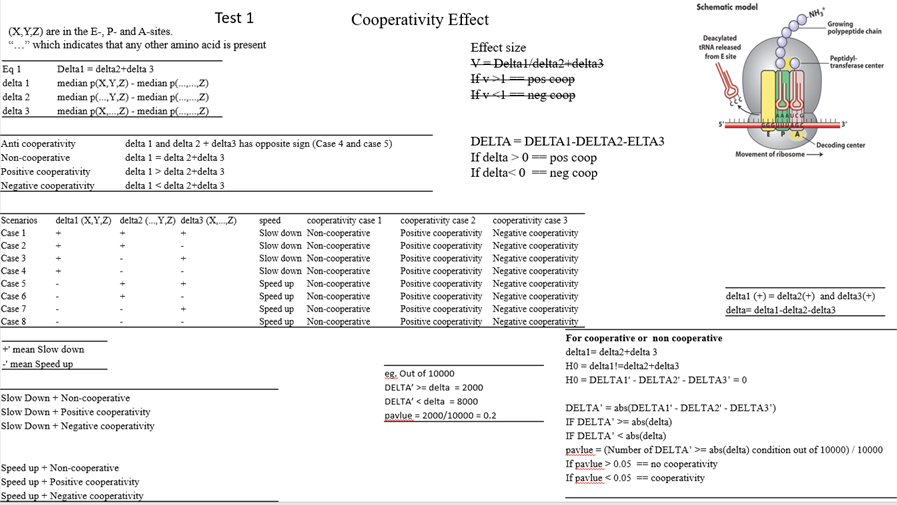

#### Approach
1. 75% coverage per gene (1 reads per codon)
2. Run permutation test and calculate p value


#### Correct p value calculation
1. Select top pair base of number of instance. 
2. Calculate correct p value (bonferroni test)


#### Merging all dataset into one 
1. Look for all dataset p value. If only minimum one dataset is less, then 0.05. Then move second step.
2. Check delta1 direction. 5 dataset delta1 direction should be in same direction (Pool dataset delta1 direction should be in same direction with other 5 dataset)
3. Check Cooperativity effects. 5 dataset delta1 direction should be in same direction 
4. If all filter are satisfying, then consider as Robust.
5. Otherwise consider as Non-robust. 


# This code has 3 step. 
### Step 1: In First step use raw Asite profile file and generate matrix with A-SITE P-SITE and E-SITE with normalised ribosome density after that calculated the p-value with permuatation test for ever triplets. 
### Step 2: After calculating permutataion test for every triplets for all datasets. In this step merge all dataset and find out robust triplets
### Step 3: Analysis

In [3]:
path= '/gpfs/group/epo2/default/nks5512/find_cooperativity_and_no_cooperativity/A_P_Site_matrix_Amino_acid_level_find_cooperativity_and_no_cooperativity_with_75%_coverage/'

dataset = ['Jan','Williams','Young','Weinberg','Nissley1','Nissley2','Pool']

#Intronic gene list
Intronic_gene_list = 'data/intronic_genes.p'

#Overlap gene list
Overlap_gene_list = 'data/overlap_genes.p'

# convert gene nucleotide to codon for every gene
codon_type_dic = 'data/codon_type_dict.p'

# 358 gene list to see robustness in data, This 358 gene data will be use to generate final amino acid metrix and tRNA matrix
Genelist_Williams_data = 'data/Genelist_Williams_data.tab'

# Threshold value for data (eg. Threshold value 4 for 6 data)
threshold_value = 4

#gene coverage thrushold
coverage_value = 75

print('\n Done')


 Done


In [4]:
from __future__ import division
import numpy as np
import math
import os
import pickle
print('Imported numpy, math, os and cPickle')
from optparse import OptionParser
print('Imported optionparser, plotter and misc')
import matplotlib.backends.backend_pdf as pdf
from scipy import stats
import pandas as pd
import seaborn as sns
import matplotlib
import matplotlib.pyplot as plt
import matplotlib as mpl
from matplotlib.table import Table
import sys
import statsmodels.sandbox.stats.multicomp as mc
import operator as op
from matplotlib.ticker import FormatStrFormatter
from time import localtime, strftime
import itertools
from matplotlib import rcParams
import shutil
import matplotlib as mpl
mpl.rc('figure', max_open_warning = 0)
import statistics
import math
import random
import timeit
import multiprocessing
from multiprocessing import Pool
import subprocess
from collections import Counter
import glob
from mpl_toolkits.axes_grid.inset_locator import inset_axes


CODON_TYPES = ['UUU', 'UUC', 'UUA', 'UUG', 'CUU', 'CUC', 'CUA', 'CUG', 'AUU', 'AUC', 'AUA', 'AUG', 'GUU', 'GUC', 'GUA',
               'GUG', 'UCU', 'UCC', 'UCA', 'UCG', 'CCU', 'CCC', 'CCA', 'CCG', 'ACU', 'ACC', 'ACA', 'ACG', 'GCU', 'GCC',
               'GCA', 'GCG', 'UAU', 'UAC', 'CAU', 'CAC', 'CAA', 'CAG', 'AAU', 'AAC', 'AAA', 'AAG', 'GAU', 'GAC', 'GAA',
               'GAG', 'UGU', 'UGC', 'UGG', 'CGU', 'CGC', 'CGA', 'CGG', 'AGU', 'AGC', 'AGA', 'AGG', 'GGU', 'GGC', 'GGA',
               'GGG', 'UAA', 'UAG', 'UGA']

genetic_code = {'UUU': 'F', 'UCU': 'S', 'UAU': 'Y', 'UGU': 'C', 'UUC': 'F', 'UCC': 'S', 'UAC': 'Y', 'UGC': 'C',
                'UUA': 'L', 'UCA': 'S', 'UAA': '*', 'UGA': '*', 'UUG': 'L', 'UCG': 'S', 'UAG': '*', 'UGG': 'W',
                'CUU': 'L', 'CCU': 'P', 'CAU': 'H', 'CGU': 'R', 'CUC': 'L', 'CCC': 'P', 'CAC': 'H', 'CGC': 'R',
                'CUA': 'L', 'CCA': 'P', 'CAA': 'Q', 'CGA': 'R', 'CUG': 'L', 'CCG': 'P', 'CAG': 'Q', 'CGG': 'R',
                'AUU': 'I', 'ACU': 'T', 'AAU': 'N', 'AGU': 'S', 'AUC': 'I', 'ACC': 'T', 'AAC': 'N', 'AGC': 'S',
                'AUA': 'I', 'ACA': 'T', 'AAA': 'K', 'AGA': 'R', 'AUG': 'M', 'ACG': 'T', 'AAG': 'K', 'AGG': 'R',
                'GUU': 'V', 'GCU': 'A', 'GAU': 'D', 'GGU': 'G', 'GUC': 'V', 'GCC': 'A', 'GAC': 'D', 'GGC': 'G',
                'GUA': 'V', 'GCA': 'A', 'GAA': 'E', 'GGA': 'G', 'GUG': 'V', 'GCG': 'A', 'GAG': 'E', 'GGG': 'G'}

# In the following dict, synonymous codons for each amino acid are grouped in list such that they are decoded by similar tRNA.
# For example, in amino acid 'A', GCU and GCC codons are decoded by one type of tRNA while GCA and GCG are decoded by another kind of tRNA
synonymous = {'A': [['GCU', 'GCC'], ['GCA', 'GCG']],
              'C': [['UGU', 'UGC']],
              'D': [['GAU', 'GAC']],
              'E': [['GAA'], ['GAG']],
              'F': [['UUU', 'UUC']],
              'G': [['GGU', 'GGC'], ['GGA'], ['GGG']],
              'H': [['CAU', 'CAC']],
              'I': [['AUU', 'AUC'], ['AUA']],
              'K': [['AAG'], ['AAA']],
              'L': [['UUG'], ['UUA'], ['CUC', 'CUU'], ['CUA', 'CUG']],
              'M': [['AUG']],
              'N': [['AAU', 'AAC']],
              'P': [['CCA', 'CCG'], ['CCU', 'CCC']],
              'Q': [['CAA'], ['CAG']],
              'R': [['AGA'], ['CGU', 'CGC'], ['CGG', 'CGA'], ['AGG']],
              'S': [['UCU', 'UCC'], ['AGU', 'AGC'], ['UCA'], ['UCG']],
              'T': [['ACU', 'ACC'], ['ACA'], ['ACG']],
              'V': [['GUU', 'GUC'], ['GUG'], ['GUA']],
              'W': [['UGG']],
              'Y': [['UAU', 'UAC']],
              '*': [['UAA', 'UAG', 'UGA']]
              }

properties = {'A': 'NON-POLAR',
              'C': 'NON-POLAR',
              'D': 'Negative',
              'E': 'Negative',
              'F': 'NON-POLAR',
              'G': 'NON-POLAR',
              'H': 'Positive',
              'I': 'NON-POLAR',
              'K': 'Positive',
              'L': 'NON-POLAR',
              'M': 'NON-POLAR',
              'N': 'POLAR',
              'P': 'NON-POLAR',
              'Q': 'POLAR',
              'R': 'Positive',
              'S': 'POLAR',
              'T': 'POLAR',
              'V': 'NON-POLAR',
              'W': 'NON-POLAR',
              'Y': 'POLAR',
              }

hydropathy = {'A': '1.8',
              'C': '2.5',
              'D': '-3.5',
              'E': '-3.5',
              'F': '2.8',
              'G': '-0.4',
              'H': '-3.2',
              'I': '4.5',
              'K': '-3.9',
              'L': '3.8',
              'M': '1.9',
              'N': '-3.5',
              'P': '-1.6',
              'Q': '-3.5',
              'R': '-4.5',
              'S': '-0.8',
              'T': '-0.7',
              'V': '4.2',
              'W': '-0.9',
              'Y': '-1.3',
              }

weight = {'A': '89.09',
              'C': '121.16',
              'D': '133.10',
              'E': '147.13',
              'F': '165.19',
              'G': '75.07',
              'H': '155.16',
              'I': '131.18',
              'K': '146.19',
              'L': '131.18',
              'M': '149.21',
              'N': '132.21',
              'P': '115.13',
              'Q': '146.15',
              'R': '174.20',
              'S': '105.09',
              'T': '119.12',
              'V': '117.15',
              'W': '204.23',
              'Y': '181.19',
              }

AMINO_ACIDS = ['A', 'R', 'D', 'N', 'C', 'E', 'Q', 'G', 'H', 'I', 'L', 'K', 'M', 'F', 'P', 'S', 'T', 'W', 'Y', 'V', '*']

base_pairing = {'A': {'Wobble': ['GCC', 'GCG'], 'Watson-Crick': ['GCA', 'GCU']}, 'R': {'Wobble': ['CGA', 'CGC'], 'Watson-Crick': ['AGA', 'AGG', 'CGG', 'CGU']},
                'D': {'Wobble': ['GAU'], 'Watson-Crick': ['GAC']},
                'N': {'Wobble': ['AAU'], 'Watson-Crick': ['AAC']}, 'C': {'Wobble': ['UGU'], 'Watson-Crick': ['UGC']}, 'E': {'Wobble': [], 'Watson-Crick': ['GAA', 'GAG']},
                'Q': {'Wobble': [], 'Watson-Crick': ['CAA', 'CAG']}, 'G': {'Wobble': ['GGU'], 'Watson-Crick': ['GGA', 'GGC', 'GGG']},
                'H': {'Wobble': ['CAU'], 'Watson-Crick': ['CAC']},
                'I': {'Wobble': ['AUC'], 'Watson-Crick': ['AUA', 'AUU']}, 'L': {'Wobble': ['CUG', 'CUU'], 'Watson-Crick': ['CUA', 'CUC', 'UUA', 'UUG']},
                'K': {'Wobble': [], 'Watson-Crick': ['AAA', 'AAG']},
                'M': {'Wobble': [], 'Watson-Crick': ['AUG']}, 'F': {'Wobble': ['UUU'], 'Watson-Crick': ['UUC']}, 'P': {'Wobble': ['CCC', 'CCG'], 'Watson-Crick': ['CCA', 'CCU']},
                'S': {'Wobble': ['UCC', 'AGU'], 'Watson-Crick': ['UCA', 'UCG', 'UCU', 'AGC']}, 'T': {'Wobble': ['ACC'], 'Watson-Crick': ['ACA', 'ACU', 'ACG']},
                'W': {'Wobble': [], 'Watson-Crick': ['UGG']}, 'Y': {'Wobble': ['UAU'], 'Watson-Crick': ['UAC']}, 'V': {'Wobble': ['GUC'], 'Watson-Crick': ['GUA', 'GUG', 'GUU']},
                '*': {'Wobble': [], 'Watson-Crick': ['UAA', 'UAG', 'UGA']}}

# Optimal codons selected based on their corresponding tRNA abundance (measured by RNA-Seq in Weinberg et al). Wobble only pairs are measured by 0.64*cognate tRNA concentration.
# Corrected mistake for G. Earlier it was 'G': {'Non-optimal': ['GGC', 'GGG'], 'Optimal': ['GGA', 'GGU']},
optimal_codon_usage = {'A': {'Non-optimal': ['GCC', 'GCG'], 'Optimal': ['GCA', 'GCU']}, 'C': {'Non-optimal': ['UGU'], 'Optimal': ['UGC']}, 'D': {'Non-optimal': ['GAU'], 'Optimal': ['GAC']},
                       'E': {'Non-optimal': ['GAG'], 'Optimal': ['GAA']}, 'F': {'Non-optimal': ['UUU'], 'Optimal': ['UUC']}, 'G': {'Non-optimal': ['GGA', 'GGG'], 'Optimal': ['GGC', 'GGU']},
                       'H': {'Non-optimal': ['CAU'], 'Optimal': ['CAC']}, 'I': {'Non-optimal': ['AUA'], 'Optimal': ['AUC', 'AUU']}, 'K': {'Non-optimal': ['AAA'], 'Optimal': ['AAG']},
                       'L': {'Non-optimal': ['CUA', 'CUC', 'CUG', 'CUU'], 'Optimal': ['UUA', 'UUG']}, 'M': {'Non-optimal': [], 'Optimal': ['AUG']}, 'N': {'Non-optimal': ['AAU'], 'Optimal': ['AAC']},
                       'P': {'Non-optimal': ['CCC', 'CCU'], 'Optimal': ['CCA', 'CCG']}, 'Q': {'Non-optimal': ['CAG'], 'Optimal': ['CAA']},
                       'R': {'Non-optimal': ['AGG', 'CGG', 'CGA', 'CGC'], 'Optimal': ['AGA', 'CGU']}, 'S': {'Non-optimal': ['UCA', 'UCG', 'AGU', 'AGC'], 'Optimal': ['UCC', 'UCU']},
                       'T': {'Non-optimal': ['ACA', 'ACG'], 'Optimal': ['ACC', 'ACU']}, 'V': {'Non-optimal': ['GUA', 'GUG'], 'Optimal': ['GUC', 'GUU']}, 'W': {'Non-optimal': [], 'Optimal': ['UGG']},
                       'Y': {'Non-optimal': ['UAU'], 'Optimal': ['UAC']}}

# Most optimal codon for every amino acid
most_optimal_codon = {'A': 'GCU', 'C': 'UGC', 'D': 'GAC', 'E': 'GAA', 'F': 'UUC', 'G': 'GGC', 'H': 'CAC', 'I': 'AUU', 'K': 'AAG', 'L': 'UUG', 'M': 'AUG', 'N': 'AAC', 'P': 'CCA', 'Q': 'CAA', 'R': 'AGA',
                      'S': 'UCU', 'T': 'ACU', 'V': 'GUU', 'W': 'UGG', 'Y': 'UAC', '*': 'UAA'}

# Optimal and non-optimal codons based on Penchman, Frydman, tAI cutoff of 0.47 as well as used for codon optimality in Jeff Coller's paper.
optimal_dict = {'Optimal': ['GCU', 'GCC', 'GAC', 'GAA', 'UUC', 'GGC', 'AUU', 'AUC', 'AAG', 'UUG', 'AUG', 'AAC', 'CCA', 'CAA', 'AGA', 'UCU', 'UCC', 'ACU', 'ACC', 'GUU', 'GUC', 'UAC'],
                'Non-optimal': ['GCA', 'GCG', 'UGC', 'UGU', 'GAU', 'GAG', 'UUU', 'GGU', 'GGA', 'GGG', 'CAC', 'CAU', 'AUA', 'AAA', 'UUA', 'CUA', 'CUC', 'CUG', 'CUU', 'AAU', 'CCG', 'CCU', 'CCC',
                                'CAG', 'CGU', 'AGG', 'CGC', 'CGG', 'CGA', 'UCA', 'AGC', 'UCG', 'AGU', 'ACA', 'ACG', 'GUG', 'GUA', 'UGG', 'UAU']}

CHROMOSOMES = ['chrI', 'chrII', 'chrIII', 'chrIV', 'chrV', 'chrVI', 'chrVII', 'chrVIII', 'chrIX', 'chrX', 'chrXI', 'chrXII', 'chrXIII', 'chrXIV', 'chrXV', 'chrXVI', 'chrM']

print ('\nDone')



Imported numpy, math, os and cPickle
Imported optionparser, plotter and misc

Done


<ipython-input-4-c6042d8ad2f9>:36: MatplotlibDeprecationWarning: 
The mpl_toolkits.axes_grid module was deprecated in Matplotlib 2.1 and will be removed two minor releases later. Use mpl_toolkits.axes_grid1 and mpl_toolkits.axisartist, which provide the same functionality instead.
  from mpl_toolkits.axes_grid.inset_locator import inset_axes


# STEP 1

In [10]:
# Parse transcriptome file to get a dictionary of codon types for genes.
def parse_sequence(transcript_file, out_loc='/gpfs/group/null/default/nxa176/reference/sacCer3/Reference_files/'):
    codon_type_dict = {}
    with open(transcript_file) as f:
        for lines in f:
            fields = lines.strip().split('\t')
            gene = fields[0]
            if gene.startswith('Q'):
                continue
            start_index = int(fields[1])
            length = int(fields[2])
            cds = list(fields[3])[abs(start_index):abs(start_index) + length]
            # Since we are looking at mRNA, convert any 'T' to 'U'
            codon_list = ['U' if x == 'T' else x for x in cds]
            codon_type_dict[gene] = []
            for x in range(0, len(codon_list), 3):
                codon_type_dict[gene].append(''.join(codon_list[x:x + 3]))

            # Sanitary checks for start and stop codons
            try:
                if codon_type_dict[gene][0] != "AUG":
                    print (gene + " does not have a AUG start codon and the start codon is " + codon_type_dict[gene][0])
            except KeyError:
                print ('KeyError in finding the start codon for gene ', gene, codon_type_dict[gene])
            if codon_type_dict[gene][-1] not in ["UAA", "UAG", "UGA"]:
                print (gene + " does not have UAA/UAG/UGA stop codon and stop codon is " + codon_type_dict[gene][-1])

    pickle.dump(codon_type_dict, open(out_loc + 'codon_type_dict.p', 'wb'))

    return codon_type_dict




# Get the dict containing the codon types of each codon in genes.
    if organism == 'yeast':
        if not os.path.isfile("data/codon_type_dict.p"):
            dict_cdn_types = parse_sequence('C:/Users/Nishant_admin/Desktop/ribosome_profiling_test/e-site_project_published_samples/reference_sacCer3/Transcript_sequence.tab')
        else:
            dict_cdn_types = pickle.load(open('C:/Users/Nishant_admin/Desktop/ribosome_profiling_test/e-site_project_published_samples/reference_sacCer3/codon_type_dict.p', 'rb'))
    elif organism == 'ecoli':
        if not os.path.isfile("/gpfs/group/null/default/nxa176/Asite_project/Code_testing/data_files/ecoli/codon_type_dict.p"):
            dict_cdn_types = parse_sequence('/gpfs/group/null/default/nxa176/Asite_project/Code_testing/data_files/ecoli/ecoli_transcript_sequence.tab',
                                            out_loc='/gpfs/group/null/default/nxa176/Asite_project/Code_testing/data_files/ecoli/')
            print ('Dumped the codon type dict into a pickle')
        else:
            dict_cdn_types = pickle.load(open('/gpfs/group/null/default/nxa176/Asite_project/Code_testing/data_files/ecoli/codon_type_dict.p', 'rb'))
            print ('Parsed codon types from /gpfs/group/null/default/nxa176/Asite_project/Code_testing/data_files/ecoli/codon_type_dict.p')
    else:
        print ('Organism not identified for getting codon types. Current options are only 1) yeast 2)ecoli ')
        print ('Exiting...')
        sys.exit()


        
class StrToBytes:
    def __init__(self, fileobj):
        self.fileobj = fileobj
    def read(self, size):
        return self.fileobj.read(size).encode()
    def readline(self, size=-1):
        return self.fileobj.readline(size).encode()
        
# Parses A-site file for reads per nucleotide.
# Converts reads per nucleotide to reads per codon.
# Filters genes according to the criteria specified in options: genes which have at least 3 reads per codon or/and do not overlap with any other genes or/and do not have introns
def gene_codon_filter_1(asite_file, mul_map_file, mul_map_threshold=1, filter_threshold=0.1, read_threshold=1, strict=True, window=False, relaxed=False):
    # Total reads mapped to a gene
    unique_mapped_reads = {}
    # Total multiple mapped reads mapped to a gene
    mul_mapped_reads = {}
    # Genes with multiple mapped reads to be filtered out from analysis. Default threshold of 1%. Genes with more than 1% multiple mapped reads will be removed.
    mul_map_genes = []

    path1 = path+"A_site_profile_file/gene_codon_filter/"

    try:
        os.makedirs(path1)
    except OSError:
        print("Creation of the directory %s failed")
    else:
        print("Successfully created the directory %s ")

    asite_name = asite_file.split('_')
    file_name = asite_name[-2] + '_' + asite_name[-1]
    file_name = file_name.split('.')
    file_name = file_name[0]
    overlap_genes = pickle.load(StrToBytes(open(path+Overlap_gene_list)))
    intronic_genes = pickle.load(StrToBytes(open(path+Intronic_gene_list)))

    stats_file = open(path1 + 'Summary_stats_' + file_name + '.tab', 'w')

    total_read_count = 0
    dict_len = {}
    codon_dict = {}
    # Parse the A-site file to get the reads for each position of each gene
    # We get the reads info in dict_gene_count and the nucleotide info in nuc_dict
    with open(asite_file) as file_asite_table:
        for lines in file_asite_table:
            line_list = lines.strip().split('\t')
            gene = line_list[0]
            gene_length = int(line_list[1])
            count_list = list(map(int, line_list[2].split(',')))
            list_len = len(count_list)
            # Quality check
            if len(count_list) % 3 != 0:
                print(
                    'QUALITY CHECK NOT MET: Gene ' + gene + ' have a length not a multiple of 3. The length is ' + str(
                        len(count_list)))
            if gene.startswith('Q'):
                continue
            codon_dict[gene] = []
            # Convert the reads per nucleotide to reads per codon
            for i in range(0, list_len, 3):
                codon_dict[gene].append(sum(count_list[i:i + 3]))
            dict_len[gene] = gene_length
            unique_mapped_reads[gene] = sum(count_list)
            total_read_count += sum(count_list)
    print('Parsed the A-site file.')

    # Get the number of mul mapped reads to decide whether to delete the gene or not. If a gene has more than 0.1% of reads multiple mapped, we delete it
    with open(mul_map_file) as f:
        for lines in f:
            line_list = lines.strip().split('\t')
            gene = line_list[0]
            read_count = map(int, line_list[1:])
            mul_mapped_reads[gene] = sum(read_count)

    stats_file.write('Number of genes with A-site profiles: ' + str(len(dict_len)) + '\n')
    stats_file.write('Number of genes containing introns: ' + str(len(intronic_genes)) + '\n')
    stats_file.write('Number of genes containing overlaps: ' + str(len(overlap_genes)) + '\n')
    stats_file.write('Number of genes containing multiple aligned reads: ' + str(len(mul_mapped_reads)) + '\n')
    stats_file.write('Number of reads mapped to the yeast transcriptome: ' + str(total_read_count) + '\n')


    codon_raw_file = open(path1 + "Codon_reads_all_genes_" + file_name + ".tab", 'w')
    if relaxed:
        codon_filtered_file = open(
            path1 + "Codon_reads_filtered_genes_relaxed_" + str((1 - filter_threshold) * 100) + file_name + ".tab", 'w')
    elif strict:
        codon_filtered_file = open(
            path1 + "Codon_reads_filtered_genes_strict_threshold_" + str(read_threshold) + file_name + ".tab", 'w')
    else:
        codon_filtered_file = open(
            path1 + "Codon_reads_filtered_genes_window_median_greater_than_" + str(read_threshold) + file_name + ".tab",
            'w')
    exp_file = open(path1 + "Expression_levels_genes_" + file_name + ".tab", "w")
    exp_file.write('Gene\tLength(codons)\tAverage reads (per codon)\tSum of reads\n')
    codon_raw_file.write('Gene\tLength(codons)\tRaw read profile\n')

    # Count variables to determine the statistics of gene counts in each category
    no_of_genes = 0
    filtered_multistatus = 0
    filtered_1 = 0
    filtered_2 = 0
    filtered_overlap = 0
    filtered_intron = 0

    for gene, gene_len in dict_len.items():
        if gene in mul_mapped_reads:
            try:
                perc_mul_map = float(mul_mapped_reads[gene]) * 100 / float(
                    mul_mapped_reads[gene] + unique_mapped_reads[gene])
            except ZeroDivisionError:
                print('ZeroDivisionError for mul map calculation for gene ' + str(gene))
                print(mul_mapped_reads[gene], unique_mapped_reads[gene])
                continue
            if perc_mul_map > mul_map_threshold:
                mul_map_genes.append(gene)

        # Writing out a file at codon level
        cod_len = len(codon_dict[gene])
        # Sanitary check
        if cod_len != gene_len / 3:
            print('Discrepancy in populating codon dicts. Length of codon dict (' + str(
                cod_len) + ') not equal to one-third of gene length (' + str(gene_len) + ')')

        codon_raw_file.write(gene + '\t' + str(cod_len) + '\t' + ','.join(map(str, codon_dict[gene])) + '\n')
        avg_reads = np.mean(codon_dict[gene])
        sum_reads = np.sum(codon_dict[gene])

        # Select for high coverage genes based on how many positions have non-zero reads
        number_of_zeroes = codon_dict[gene].count(0)

        # By default, the threshold is 0.1 which means we will select genes which have less than 10% positions with zero reads
        if relaxed and number_of_zeroes <= math.ceil(filter_threshold * cod_len):
            if gene not in overlap_genes and gene not in mul_map_genes and gene not in intronic_genes:
                if gene in mul_map_genes:
                    filtered_multistatus += 1
                    continue
                else:
                    no_of_genes += 1

                exp_file.write(gene + '\t' + str(cod_len) + '\t' + str(avg_reads) + '\t' + str(sum_reads) + '\n')
                codon_filtered_file.write(gene + '\t' + str(cod_len) + '\t' + ','.join(map(str, codon_dict[gene])) + '\n')

        # If we apply the strict criteria where every codon position needs to have greater than read_threshold (default=1) reads
        if strict:
            # We remove the first two codons from the analysis since start codon is expected not to contain any reads and the second codon's ribosome density is influenced by initiation
            # now each codon position should contain at least the read_threhsold number of reads for the gene to be included
            if all(v > read_threshold for v in
                   codon_dict[gene][2:]) and gene not in overlap_genes and gene not in intronic_genes:
                if gene in mul_map_genes:
                    filtered_multistatus += 1
                    continue
                else:
                    no_of_genes += 1

                exp_file.write(gene + '\t' + str(cod_len) + '\t' + str(avg_reads) + '\t' + str(sum_reads) + '\n')
                codon_filtered_file.write(gene + '\t' + str(cod_len) + '\t' + ','.join(map(str, codon_dict[gene])) + '\n')

            elif read_threshold >= 1 and all(v > read_threshold - 1 for v in codon_dict[gene][
                                                                             2:]) and gene not in overlap_genes and gene not in intronic_genes and gene not in mul_map_genes:
                filtered_2 += 1
            elif read_threshold >= 2 and all(v > read_threshold - 2 for v in codon_dict[gene][
                                                                             2:]) and gene not in overlap_genes and gene not in intronic_genes and gene not in mul_map_genes:
                filtered_1 += 1
            elif all(v > read_threshold for v in codon_dict[gene][
                                                 2:]) and gene in overlap_genes and gene not in intronic_genes and gene not in mul_map_genes:
                filtered_overlap += 1
            elif all(v > read_threshold for v in
                     codon_dict[gene][2:]) and gene not in overlap_genes and gene in intronic_genes:
                filtered_intron += 1

        if window:
            # Excluding first 15 codons and last 5 codons
            read_list = codon_dict[gene][15:-5]
            if not read_list:
                continue
            window_medians = []
            for i in range(0, len(read_list), 5):
                # window_medians.append(np.median(read_list[i:i+5]))
                window_medians.append(np.sum(read_list[i:i + 5]))
            # if window_medians and all(v > read_threshold for v in window_medians):
            if np.median(window_medians) > read_threshold:
                if gene in mul_map_genes:
                    filtered_multistatus += 1
                    continue
                else:
                    no_of_genes += 1
                codon_filtered_file.write(gene + '\t' + str(cod_len) + '\t' + ','.join(map(str, codon_dict[gene])) + '\n')

    codon_filtered_file.close()

    if relaxed:
        print(
            "No. of genes which have which have greater than " + str(filter_threshold * 100) + "% of positions > 0: " + str(
                no_of_genes))
        stats_file.write(
            "No. of genes which have which have greater than " + str(filter_threshold * 100) + "% of positions > 0: " + str(
                no_of_genes) + '\n')
    if strict:
        print("No. of genes with atleast " + str(read_threshold) + " reads in each codon position is: " + str(no_of_genes))
        stats_file.write(
            "No. of genes with greater than " + str(read_threshold) + " reads in each codon: " + str(no_of_genes) + '\n')
        stats_file.write(
            "No. of genes missed out earlier with greater than 1 reads in each codon: " + str(filtered_1) + '\n')
        stats_file.write(
            "No. of genes missed out earlier with greater than 0 reads in each codon: " + str(filtered_2) + '\n')
        stats_file.write("No. of genes missed out earlier with greater than " + str(
            read_threshold) + " reads in each codon but overlapping genes: " + str(filtered_overlap) + '\n')
        stats_file.write("No. of genes missed out earlier with greater than " + str(
            read_threshold) + " reads in each codon but intronic genes: " + str(filtered_intron) + '\n')
        stats_file.write("No. of genes missed out earlier with greater than " + str(
            read_threshold) + " reads in each codon but contains multiple mapped reads: " + str(
            filtered_multistatus) + '\n')
    if window:
        print("No. of genes with atleast " + str(
            read_threshold) + " median reads in each 5 codon nonoverlapping window: " + str(no_of_genes))
    return codon_raw_file.name


# Convert the reads per codon of the filtered genes to translation times of codons
def reads_to_translation_times(codon_file, filename, genelist=''):
    translation_times = {}
    path1 = path+"A_site_profile_file/translation_time/"

    try:
        os.makedirs(path1)
    except OSError:
        print("Creation of the directory %s failed")
    else:
        print("Successfully created the directory %s ")


    time_file = open(path1+filename+"Translation_times_profiles.tab", 'w')
    #  If the translation times is to be calculated using instances from a constant set of genes, that list will be parsed here.
    # Make sure the times_dict passed here contain info for all genes and not just for filtered genes.
    list_of_genes = []
    if genelist:
        with open(genelist) as f:
            for lines in f:
                list_of_genes.append(lines.strip())
    # Parse the codon file to get the reads for each codon position of each gene
    # We get the reads info in dict_gene_count and the nucleotide info in nuc_dict
    with open(codon_file) as f:
        next(f)
        for lines in f:
            line_list = lines.strip().split('\t')
            gene = line_list[0]
            cov = coverage(line_list[2])
            if cov < coverage_value:
                continue
            gene = line_list[0]
            if genelist and gene not in list_of_genes:                
                continue
            count_list = list(map(int, line_list[2].split(',')))
            no_of_codons = len(count_list)
            synthesis_time = no_of_codons * 200
            # We remove the first two codons from the analysis since start codon is expected not to contain any reads and the second codon's ribosome density is influenced by initiation
            summed_reads = sum(count_list)
            if summed_reads == 0:
                continue
            ttime = [(float(reads) / float(summed_reads)) * synthesis_time for reads in count_list]
            translation_times[gene] = ttime
            time_file.write(gene + '\t' + str(len(ttime)) + '\t' + ','.join(map(str, ttime)) + '\n')

    time_file.close()
    trans_time_file_name = (path1+filename+"Translation_timesss.p")
    pickle.dump(translation_times, open(path1+filename+"Translation_timesss.p", "wb"))

    return translation_times, trans_time_file_name

def coverage(reads):
    reads = reads.split(",")
    c = 0 #Variable to store coverage across gene
    for read in reads:
        if float(read)>0:
            c+=1 #Add to collection
    c = (float(c/len(reads)))*100
    return c

print ('\nDone')



Done


In [11]:
#Translation time file create

input_folder = path+'A_site_profile_file/'
gene_list = Genelist_Williams_data
files = os.listdir(input_folder)
asite_profile = []
mapped_read_count = []
summary = []
for file in files:
    if 'A-site' in file:
        if 'pool' in file:
            pass
        else:
            asite_profile += [file]
    elif '20_35' in file:
        mapped_read_count += [file]
    elif 'Summary' in file:
        summary += [file]
    else:
        pass
count = 0
for loop in asite_profile:
    filename = asite_profile[count]
    filename = filename.split('.')
    filename = filename[0]
    filter_file = gene_codon_filter_1(input_folder + asite_profile[count], input_folder + mapped_read_count[count],
                                      mul_map_threshold=0.1, read_threshold=0, strict=False,
                                      filter_threshold=0.5, relaxed=True, window=False)
    count += 1
    translation_times, trans_time_file_name = reads_to_translation_times(filter_file, filename, genelist='')

print ('\nDone')

Creation of the directory %s failed
data/overlap_genes.p
Parsed the A-site file.
ZeroDivisionError for mul map calculation for gene YDL185C-A
0 0
ZeroDivisionError for mul map calculation for gene YKL223W
0 0
ZeroDivisionError for mul map calculation for gene YAL064W-B
0 0
ZeroDivisionError for mul map calculation for gene YLR161W
0 0
ZeroDivisionError for mul map calculation for gene YLR154C-H
0 0
ZeroDivisionError for mul map calculation for gene YLR157W-D
0 0
ZeroDivisionError for mul map calculation for gene YOR394C-A
0 0
ZeroDivisionError for mul map calculation for gene YLR156W
0 0
ZeroDivisionError for mul map calculation for gene YLR159W
0 0
No. of genes which have which have greater than 50.0% of positions > 0: 4071
Creation of the directory %s failed
Creation of the directory %s failed
data/overlap_genes.p
Parsed the A-site file.
ZeroDivisionError for mul map calculation for gene YDL185C-A
0 0
ZeroDivisionError for mul map calculation for gene YKL225W
0 0
ZeroDivisionError fo

## pool data

In [5]:
 # Parse transcriptome file to get a dictionary of codon types for genes.
def parse_sequence(transcript_file, out_loc='/gpfs/group/null/default/nxa176/reference/sacCer3/Reference_files/'):
    codon_type_dict = {}
    with open(transcript_file) as f:
        for lines in f:
            fields = lines.strip().split('\t')
            gene = fields[0]
            if gene.startswith('Q'):
                continue
            start_index = int(fields[1])
            length = int(fields[2])
            cds = list(fields[3])[abs(start_index):abs(start_index) + length]
            # Since we are looking at mRNA, convert any 'T' to 'U'
            codon_list = ['U' if x == 'T' else x for x in cds]
            codon_type_dict[gene] = []
            for x in range(0, len(codon_list), 3):
                codon_type_dict[gene].append(''.join(codon_list[x:x + 3]))

            # Sanitary checks for start and stop codons
            try:
                if codon_type_dict[gene][0] != "AUG":
                    print (gene + " does not have a AUG start codon and the start codon is " + codon_type_dict[gene][0])
            except KeyError:
                print ('KeyError in finding the start codon for gene ', gene, codon_type_dict[gene])
            if codon_type_dict[gene][-1] not in ["UAA", "UAG", "UGA"]:
                print (gene + " does not have UAA/UAG/UGA stop codon and stop codon is " + codon_type_dict[gene][-1])

    pickle.dump(codon_type_dict, open(out_loc + 'codon_type_dict.p', 'wb'))

    return codon_type_dict




# Get the dict containing the codon types of each codon in genes.
    if organism == 'yeast':
        if not os.path.isfile("C:/Users/Nishant_admin/Desktop/ribosome_profiling_test/e-site_project_published_samples/reference_sacCer3/codon_type_dict.p"):
            dict_cdn_types = parse_sequence('C:/Users/Nishant_admin/Desktop/ribosome_profiling_test/e-site_project_published_samples/reference_sacCer3/Transcript_sequence.tab')
        else:
            dict_cdn_types = pickle.load(open('C:/Users/Nishant_admin/Desktop/ribosome_profiling_test/e-site_project_published_samples/reference_sacCer3/codon_type_dict.p', 'rb'))
    elif organism == 'ecoli':
        if not os.path.isfile("/gpfs/group/null/default/nxa176/Asite_project/Code_testing/data_files/ecoli/codon_type_dict.p"):
            dict_cdn_types = parse_sequence('/gpfs/group/null/default/nxa176/Asite_project/Code_testing/data_files/ecoli/ecoli_transcript_sequence.tab',
                                            out_loc='/gpfs/group/null/default/nxa176/Asite_project/Code_testing/data_files/ecoli/')
            print ('Dumped the codon type dict into a pickle')
        else:
            dict_cdn_types = pickle.load(open('/gpfs/group/null/default/nxa176/Asite_project/Code_testing/data_files/ecoli/codon_type_dict.p', 'rb'))
            print ('Parsed codon types from /gpfs/group/null/default/nxa176/Asite_project/Code_testing/data_files/ecoli/codon_type_dict.p')
    else:
        print ('Organism not identified for getting codon types. Current options are only 1) yeast 2)ecoli ')
        print ('Exiting...')
        sys.exit()


         

    
class StrToBytes:
    def __init__(self, fileobj):
        self.fileobj = fileobj
    def read(self, size):
        return self.fileobj.read(size).encode()
    def readline(self, size=-1):
        return self.fileobj.readline(size).encode()
        
# Parses A-site file for reads per nucleotide.
# Converts reads per nucleotide to reads per codon.
# Filters genes according to the criteria specified in options: genes which have at least 3 reads per codon or/and do not overlap with any other genes or/and do not have introns
def gene_codon_filter_1(asite_file, mul_map_file, mul_map_threshold=1, filter_threshold=0.1, read_threshold=1, strict=True, window=False, relaxed=False):
    # Total reads mapped to a gene
    unique_mapped_reads = {}
    # Total multiple mapped reads mapped to a gene
    mul_mapped_reads = {}
    # Genes with multiple mapped reads to be filtered out from analysis. Default threshold of 1%. Genes with more than 1% multiple mapped reads will be removed.
    mul_map_genes = []

    path1 = path+"A_site_profile_file/A-site_profile_pool_data/gene_codon_filter_pool/"

    try:
        os.makedirs(path1)
    except OSError:
        print("Creation of the directory %s failed")
    else:
        print("Successfully created the directory %s ")
    asite_name = asite_file.split('_')
    file_name = asite_name[-2] + '_' + asite_name[-1]
    file_name = file_name.split('.')
    file_name = file_name[0]
    overlap_genes = pickle.load(StrToBytes(open(path+Overlap_gene_list)))
    intronic_genes = pickle.load(StrToBytes(open(path+Intronic_gene_list)))

    stats_file = open(path1 + 'Summary_stats_' + file_name + '.tab', 'w')

    total_read_count = 0
    dict_len = {}
    codon_dict = {}
    # Parse the A-site file to get the reads for each position of each gene
    # We get the reads info in dict_gene_count and the nucleotide info in nuc_dict
    with open(asite_file) as file_asite_table:
        for lines in file_asite_table:
            line_list = lines.strip().split('\t')
            gene = line_list[0]
            gene_length = int(line_list[1])
            count_list = list(map(int, line_list[2].split(',')))
            list_len = len(count_list)
            if len(count_list) % 3 != 0:
                print(
                    'QUALITY CHECK NOT MET: Gene ' + gene + ' have a length not a multiple of 3. The length is ' + str(
                        len(count_list)))
            if gene.startswith('Q'):
                continue
            codon_dict[gene] = []
            # Convert the reads per nucleotide to reads per codon
            for i in range(0, list_len, 3):
                codon_dict[gene].append(sum(count_list[i:i + 3]))
            dict_len[gene] = gene_length
            unique_mapped_reads[gene] = sum(count_list)
            total_read_count += sum(count_list)
    print('Parsed the A-site file.')

    # Get the number of mul mapped reads to decide whether to delete the gene or not. If a gene has more than 0.1% of reads multiple mapped, we delete it
    with open(mul_map_file) as f:
        for lines in f:
            line_list = lines.strip().split('\t')
            gene = line_list[0]
            read_count = map(int, line_list[1:])
            mul_mapped_reads[gene] = sum(read_count)

    stats_file.write('Number of genes with A-site profiles: ' + str(len(dict_len)) + '\n')
    stats_file.write('Number of genes containing introns: ' + str(len(intronic_genes)) + '\n')
    stats_file.write('Number of genes containing overlaps: ' + str(len(overlap_genes)) + '\n')
    stats_file.write('Number of genes containing multiple aligned reads: ' + str(len(mul_mapped_reads)) + '\n')
    stats_file.write('Number of reads mapped to the yeast transcriptome: ' + str(total_read_count) + '\n')


    codon_raw_file = open(path1 + "Codon_reads_all_genes_" + file_name + ".tab", 'w')
    if relaxed:
        codon_filtered_file = open(
            path1 + "Codon_reads_filtered_genes_relaxed_" + str((1 - filter_threshold) * 100) + file_name + ".tab", 'w')
    elif strict:
        codon_filtered_file = open(
            path1 + "Codon_reads_filtered_genes_strict_threshold_" + str(read_threshold) + file_name + ".tab", 'w')
    else:
        codon_filtered_file = open(
            path1 + "Codon_reads_filtered_genes_window_median_greater_than_" + str(read_threshold) + file_name + ".tab",
            'w')
    exp_file = open(path1 + "Expression_levels_genes_" + file_name + ".tab", "w")
    exp_file.write('Gene\tLength(codons)\tAverage reads (per codon)\tSum of reads\n')
    codon_raw_file.write('Gene\tLength(codons)\tRaw read profile\n')

    # Count variables to determine the statistics of gene counts in each category
    no_of_genes = 0
    filtered_multistatus = 0
    filtered_1 = 0
    filtered_2 = 0
    filtered_overlap = 0
    filtered_intron = 0

    for gene, gene_len in dict_len.items():
        if gene in mul_mapped_reads:
            try:
                perc_mul_map = float(mul_mapped_reads[gene]) * 100 / float(
                    mul_mapped_reads[gene] + unique_mapped_reads[gene])
            except ZeroDivisionError:
                print('ZeroDivisionError for mul map calculation for gene ' + str(gene))
                print(mul_mapped_reads[gene], unique_mapped_reads[gene])
                continue
            if perc_mul_map > mul_map_threshold:
                mul_map_genes.append(gene)

        # Writing out a file at codon level
        cod_len = len(codon_dict[gene])
        # Sanitary check
        if cod_len != gene_len / 3:
            print('Discrepancy in populating codon dicts. Length of codon dict (' + str(
                cod_len) + ') not equal to one-third of gene length (' + str(gene_len) + ')')

        codon_raw_file.write(gene + '\t' + str(cod_len) + '\t' + ','.join(map(str, codon_dict[gene])) + '\n')
        avg_reads = np.mean(codon_dict[gene])
        sum_reads = np.sum(codon_dict[gene])

        # Select for high coverage genes based on how many positions have non-zero reads
        number_of_zeroes = codon_dict[gene].count(0)

        # By default, the threshold is 0.1 which means we will select genes which have less than 10% positions with zero reads
        if relaxed and number_of_zeroes <= math.ceil(filter_threshold * cod_len):
            if gene not in overlap_genes and gene not in mul_map_genes and gene not in intronic_genes:
                if gene in mul_map_genes:
                    filtered_multistatus += 1
                    continue
                else:
                    no_of_genes += 1

                exp_file.write(gene + '\t' + str(cod_len) + '\t' + str(avg_reads) + '\t' + str(sum_reads) + '\n')
                codon_filtered_file.write(gene + '\t' + str(cod_len) + '\t' + ','.join(map(str, codon_dict[gene])) + '\n')

        # If we apply the strict criteria where every codon position needs to have greater than read_threshold (default=1) reads
        if strict:
            # We remove the first two codons from the analysis since start codon is expected not to contain any reads and the second codon's ribosome density is influenced by initiation
            # now each codon position should contain at least the read_threhsold number of reads for the gene to be included
            if all(v > read_threshold for v in
                   codon_dict[gene][2:]) and gene not in overlap_genes and gene not in intronic_genes:
                if gene in mul_map_genes:
                    filtered_multistatus += 1
                    continue
                else:
                    no_of_genes += 1

                exp_file.write(gene + '\t' + str(cod_len) + '\t' + str(avg_reads) + '\t' + str(sum_reads) + '\n')
                codon_filtered_file.write(gene + '\t' + str(cod_len) + '\t' + ','.join(map(str, codon_dict[gene])) + '\n')

            elif read_threshold >= 1 and all(v > read_threshold - 1 for v in codon_dict[gene][
                                                                             2:]) and gene not in overlap_genes and gene not in intronic_genes and gene not in mul_map_genes:
                filtered_2 += 1
            elif read_threshold >= 2 and all(v > read_threshold - 2 for v in codon_dict[gene][
                                                                             2:]) and gene not in overlap_genes and gene not in intronic_genes and gene not in mul_map_genes:
                filtered_1 += 1
            elif all(v > read_threshold for v in codon_dict[gene][
                                                 2:]) and gene in overlap_genes and gene not in intronic_genes and gene not in mul_map_genes:
                filtered_overlap += 1
            elif all(v > read_threshold for v in
                     codon_dict[gene][2:]) and gene not in overlap_genes and gene in intronic_genes:
                filtered_intron += 1

        if window:
            # Excluding first 15 codons and last 5 codons
            read_list = codon_dict[gene][15:-5]
            if not read_list:
                continue
            window_medians = []
            for i in range(0, len(read_list), 5):
                # window_medians.append(np.median(read_list[i:i+5]))
                window_medians.append(np.sum(read_list[i:i + 5]))
            # if window_medians and all(v > read_threshold for v in window_medians):
            if np.median(window_medians) > read_threshold:
                if gene in mul_map_genes:
                    filtered_multistatus += 1
                    continue
                else:
                    no_of_genes += 1
                codon_filtered_file.write(gene + '\t' + str(cod_len) + '\t' + ','.join(map(str, codon_dict[gene])) + '\n')

    codon_filtered_file.close()

    if relaxed:
        print(
            "No. of genes which have which have greater than " + str(filter_threshold * 100) + "% of positions > 0: " + str(
                no_of_genes))
        stats_file.write(
            "No. of genes which have which have greater than " + str(filter_threshold * 100) + "% of positions > 0: " + str(
                no_of_genes) + '\n')
    if strict:
        print("No. of genes with atleast " + str(read_threshold) + " reads in each codon position is: " + str(no_of_genes))
        stats_file.write(
            "No. of genes with greater than " + str(read_threshold) + " reads in each codon: " + str(no_of_genes) + '\n')
        stats_file.write(
            "No. of genes missed out earlier with greater than 1 reads in each codon: " + str(filtered_1) + '\n')
        stats_file.write(
            "No. of genes missed out earlier with greater than 0 reads in each codon: " + str(filtered_2) + '\n')
        stats_file.write("No. of genes missed out earlier with greater than " + str(
            read_threshold) + " reads in each codon but overlapping genes: " + str(filtered_overlap) + '\n')
        stats_file.write("No. of genes missed out earlier with greater than " + str(
            read_threshold) + " reads in each codon but intronic genes: " + str(filtered_intron) + '\n')
        stats_file.write("No. of genes missed out earlier with greater than " + str(
            read_threshold) + " reads in each codon but contains multiple mapped reads: " + str(
            filtered_multistatus) + '\n')
    if window:
        print("No. of genes with atleast " + str(
            read_threshold) + " median reads in each 5 codon nonoverlapping window: " + str(no_of_genes))
    return codon_raw_file.name


# Convert the reads per codon of the filtered genes to translation times of codons
def reads_to_translation_times(codon_file, filename, genelist=''):
    translation_times = {}
    path1 = path+"A_site_profile_file/translation_time/"

    try:
        os.makedirs(path1)
    except OSError:
        print("Creation of the directory %s failed")
    else:
        print("Successfully created the directory %s ")


    time_file = open(path1+filename+"Translation_times_profiles.tab", 'w')
    #  If the translation times is to be calculated using instances from a constant set of genes, that list will be parsed here.
    # Make sure the times_dict passed here contain info for all genes and not just for filtered genes.
    list_of_genes = []
    if genelist:
        with open(genelist) as f:
            for lines in f:
                list_of_genes.append(lines.strip())
    # Parse the codon file to get the reads for each codon position of each gene
    # We get the reads info in dict_gene_count and the nucleotide info in nuc_dict
    with open(codon_file) as f:
        next(f)
        for lines in f:
            line_list = lines.strip().split('\t')
            gene = line_list[0]
            cov = coverage(line_list[2])
            if cov < coverage_value:
                continue
            gene = line_list[0]
            if genelist and gene not in list_of_genes:                
                continue
            count_list = list(map(int, line_list[2].split(',')))
            no_of_codons = len(count_list)
            synthesis_time = no_of_codons * 200
            # We remove the first two codons from the analysis since start codon is expected not to contain any reads and the second codon's ribosome density is influenced by initiation
            summed_reads = sum(count_list)
            if summed_reads == 0:
                continue
            ttime = [(float(reads) / float(summed_reads)) * synthesis_time for reads in count_list]
            translation_times[gene] = ttime
            time_file.write(gene + '\t' + str(len(ttime)) + '\t' + ','.join(map(str, ttime)) + '\n')

    time_file.close()
    trans_time_file_name = (path1+filename+"Translation_timesss.p")
    pickle.dump(translation_times, open(path1+filename+"Translation_timesss.p", "wb"))

    return translation_times, trans_time_file_name

def coverage(reads):
    reads = reads.split(",")
    c = 0 #Variable to store coverage across gene
    for read in reads:
        if float(read)>0:
            c+=1 #Add to collection
    c = (float(c/len(reads)))*100
    return c


def merge_files_1(file_folder, filename, file_list):
    d = {}
    codon_length_dict={}

    path1 = 'gene_codon_filter_pool'
    try:
        os.mkdir(path1)
    except OSError:
        print("Creation of the directory %s failed")
    else:
        print("Successfully created the directory %s ")
    for file in os.listdir(file_folder):
        if 'Codon_reads_filtered_genes' in file:
            with open(file_folder+file, 'r') as f:
                for line in f:
                    (key, codon_length, coverage) = line.split()
                    split_coverage = list(map(int, coverage.split(',')))

                    codon_length_dict[key]=codon_length

                    #Check that lengths are consistent
                    if key not in codon_length_dict:
                        codon_length_dict[key] = codon_length
                    elif codon_length_dict[key] != codon_length:
                        print('error:'+key)

                    if key not in d:
                        d[key] = np.array(split_coverage)
                    else:
                        d[key] = d[key] + np.array(split_coverage)

    outf = open(file_folder+filename+'Combined_codon-profiles.tab', 'w')
    for key in d:
        outf.write(key+'\t'+codon_length_dict[key]+'\t'+','.join(map(str,d[key]))+'\n')
    outf.close()
    return outf.name

print ('\nDone')



Done


In [ ]:
#Translation time file create

input_folder = path+'A_site_profile_file/A-site_profile_pool_data/'
print(path)
gene_list = Genelist_Williams_data
filename = 'Pool'
files = os.listdir(input_folder)
print(files)
outpath = input_folder+'gene_codon_filter_pool/'
asite_profile = []
mapped_read_count = []
summary = []
for file in files:
    if 'A-site' in file:
        asite_profile += [file]
    elif '20_35' in file:
        mapped_read_count += [file]
    elif 'Summary' in file:
        summary += [file]
    else:
        pass

count = 0
file_list = []
for loop in asite_profile:
    filename = asite_profile[count]
    filename = filename.split('.')
    filename = filename[0]
    filter_file = gene_codon_filter_1(input_folder + asite_profile[count], input_folder + mapped_read_count[count],
                                      mul_map_threshold=0.1, read_threshold=0, strict=False,
                                      filter_threshold=0.5, relaxed=True, window=False)
    file_list += [filter_file]
    print(file_list)
    count += 1
filename = 'A-site_profiles_Pool_'
print('combining all files')
combined_codon_profile = merge_files_1(outpath, filename, file_list)
print(combined_codon_profile)
translation_times, trans_time_file_name = reads_to_translation_times(combined_codon_profile, filename, genelist='')

print ('\nDone')

In [13]:
#ASITE_esite MATRIX FOR tRNA
def esite_asite_matrix_tRNA_level(times_dict, codon_type_dict, filename, time=True):
    dict_amino_acids = {}
    dict_aa_class_esite = {}
    tRNA_list = []

    path1 = path+"A_site_profile_file/esite_asite_matrix_tRNA/"

    try:
        os.makedirs(path1)
    except OSError:
        print("Creation of the directory %s failed")
    else:
        print("Successfully created the directory %s ")

    for aa in AMINO_ACIDS:
        for idx, val in enumerate(synonymous[aa]):
            dict_amino_acids[aa + '-t' + str(idx + 1)] = []
            dict_aa_class_esite[aa + '-t' + str(idx + 1)] = {}
            if aa + '-t' + str(idx + 1) not in tRNA_list:
                tRNA_list.append(aa + '-t' + str(idx + 1))
            for esite_aa in AMINO_ACIDS:
                if esite_aa == '*':
                    continue
                for idx2, val2 in enumerate(synonymous[esite_aa]):
                    dict_aa_class_esite[aa + '-t' + str(idx + 1)][esite_aa + '-t' + str(idx2 + 1)] = []
    # We will store e-site aa for each gene and codon position in esite_aa_dict
    esite_aa_dict = {}
    asite_aa_dict = {}
    log_file = open(path1+filename+'asite_esite_trna.log', 'w')
    # Get all the aa info by translation codon_type_dict codons to corresponding amino acids
    for gene, dict_time in times_dict.items():
        esite_aa_dict[gene] = {}
        asite_aa_dict[gene] = {}
        for codon, trans_time in enumerate(dict_time):
            # Ignoring the first two codons
            if codon in [0, 1]:
                continue
            # Get the e-site aa for that codon
            try:
                esite_codon = codon_type_dict[gene][codon - 2]
            except KeyError:
                print ('KeyError in codon type dict for gene ' + gene + ' at codon ' + str(codon))
            esite_aa = genetic_code[esite_codon]
            # Get the A-site aa for that codon
            try:
                asite_codon = codon_type_dict[gene][codon]
            except KeyError:
                print ('KeyError in codon type dict for gene ' + gene + ' at codon ' + str(codon + 1))
            asite_aa = genetic_code[asite_codon]
            key1, key2 = '', ''
            for idx, val in enumerate(synonymous[asite_aa]):
                if asite_codon in val:
                    key1 = asite_aa + '-t' + str(idx + 1)
            for idx2, val2 in enumerate(synonymous[esite_aa]):
                if esite_codon in val2:
                    key2 = esite_aa + '-t' + str(idx2 + 1)
            # dict_amino_acids will have trans time for each amino acid
            if time:
                dict_amino_acids[key1].append(float(trans_time))
            else:
                dict_amino_acids[key1].append(float(trans_time) / 200)
            # dict_aa_class_esite will have a dict of e-site and t-times for all a-site aa. This is a dictionary initialized before for all combo of aa
            # dict_aa_class_esite[Asite_AA][e-site_AA] = [trans_time, gene, codon number, e-site codon type, A-site codon type]
            if time:
                dict_aa_class_esite[key1][key2].append((float(trans_time), gene, codon, codon_type_dict[gene][codon - 2], codon_type_dict[gene][codon]))
            else:
                dict_aa_class_esite[key1][key2].append((float(trans_time) / 200, gene, codon, codon_type_dict[gene][codon - 2], codon_type_dict[gene][codon]))

    # Initializing a dict for medians for each a-site aa
    dict_median_aa = {}

    # Initializing a dict for metrics to store for each pair of a-site and e-site
    dict_aa_esite_perc_change = {}
    dict_aa_esite_prop_change = {}
    dict_aa_esite_global_median = {}
    dict_aa_esite_pval = {}
    dict_aa_esite_sample_size = {}
    
    #added for yang
    dict_aa_esite_median = {}
    dict_aa_esite_median_not = {}

    # Initializing the inner dict for each a-site aa as key
    for trna in tRNA_list:
        dict_aa_esite_perc_change[trna] = {}
        dict_aa_esite_prop_change[trna] = {}
        dict_aa_esite_global_median[trna] = {}
        dict_aa_esite_pval[trna] = {}
        dict_aa_esite_sample_size[trna] = {}
        dict_aa_esite_median[trna] = {}
        dict_aa_esite_median_not[trna] = {}

    global_trans_list = []

    # Calculating the median value of trans times for A-site aa irrespective of the chemical identity of e-site aa
    for trna, trans_list in dict_amino_acids.items():
        dict_median_aa[trna] = np.median(trans_list)
        global_trans_list += trans_list
        '''
        If we want to get a confidence interval for medians
        dict_bs_medians_aa = {}
        aa_sample = misc.get_bootstrap_ensemble(trans_list, bootstrap_runs=100000)
        bootstrap_medians = np.median(aa_sample, axis=1)  # all the medians
        dict_bs_medians_aa[aa] = bootstrap_medians
        '''
    # Global median of all the trans times irrespective of chemical identity of A-site and e-site
    # global_median = np.median(global_trans_list)

    # For each amino acid in A-site,
    for aa_trna, dict_esite in dict_aa_class_esite.items():
        # for all combinations of aa in e-site and their list of trans time
        for esite_trna, trans_list in dict_esite.items():
            times_list = []
            # the times_list will contain only float values of translation times. trans_list contain many other values like gene name, codon number, codon type etc
            for ttime in trans_list:
                times_list.append(ttime[0])
            # Create the list of trans time for all other amino acids in the e-site excluding the one being compared
            alt_times_list = []
            for alt_aa, list_trans in dict_esite.items():
                if alt_aa != esite_trna:
                    for ttime in list_trans:
                        alt_times_list.append(ttime[0])
                else:
                    continue
            log_file.write('A-site tRNA ' + aa_trna + '\n')
            log_file.write('e-site tRNA ' + esite_trna + '\n')
            log_file.write('Length of trans_list' + str(len(times_list)) + '\n')
            if len(times_list) >= 5:
                u, p = stats.mannwhitneyu(times_list, alt_times_list)
                log_file.write('Mann Whitney U test is:\n')
                log_file.write(str(u) + '\t' + str(p) + '\n')
                
                perc_change = ((np.median(times_list) - np.median(alt_times_list)) / np.median(alt_times_list)) * 100
                dict_aa_esite_median[aa_trna][esite_trna] = np.median(times_list)
                dict_aa_esite_median_not[aa_trna][esite_trna] = np.median(alt_times_list)
                global_perc_change = ((np.median(times_list) - np.median(alt_times_list)) / ((np.median(times_list) + np.median(alt_times_list)) / 2)) * 100
                prop_change = (np.median(times_list) / dict_median_aa[aa_trna]) * 100
                dict_aa_esite_perc_change[aa_trna][esite_trna] = perc_change
                dict_aa_esite_prop_change[aa_trna][esite_trna] = prop_change
                dict_aa_esite_global_median[aa_trna][esite_trna] = global_perc_change
                dict_aa_esite_pval[aa_trna][esite_trna] = p
                dict_aa_esite_sample_size[aa_trna][esite_trna] = [len(times_list), len(alt_times_list)]
            else:
                dict_aa_esite_perc_change[aa_trna][esite_trna] = 0  # 'Sample_less_than_5'
                dict_aa_esite_prop_change[aa_trna][esite_trna] = 0
                dict_aa_esite_global_median[aa_trna][esite_trna] = 0
                dict_aa_esite_pval[aa_trna][esite_trna] = 1  # 'Sample_less_than_5'
                dict_aa_esite_sample_size[aa_trna][esite_trna] = [len(times_list), len(alt_times_list)]
                dict_aa_esite_median[aa_trna][esite_trna] = 0
                dict_aa_esite_median_not[aa_trna][esite_trna] = 0

    times_file = open(path1+filename+"Asite_esite_times_coordinates_tRNA_level.tab", "w")
    times_file.write("Asite_tRNA\tesite_tRNA\tTranslation_time_Asite_codon\tGene\tAsite_codon_number\tesite_codon\tPsite_codon\tAsite_codon\n")
    for aa, dict_esite in dict_aa_class_esite.items():
        for esite, trans_list in dict_esite.items():
            for codon in sorted(trans_list, reverse=True):
                times_file.write(aa + '\t' + esite + '\t' + str(codon[0]) + '\t' + str(codon[1]) + '\t' + str(codon[2]) + '\t' + str(codon[3]) + '\t' + codon[4] + '\n')
    times_file.close()

    outf = open(path1+filename+'Asite_esite_matrix_tRNA_level.tab', 'w')

    '''
    FDR BH correction at each e-site aa level
    for aa, data in dict_aa_esite_perc_change.items():
        list_of_pval = []
        # it1, it2 = itertools.tee(data, n=2)
        for p_site in data:
            print p_site
            list_of_pval.append(dict_aa_esite_pval[aa][p_site])
        hyp_test, pval_adj, alpsidac, alpbonf = mc.multipletests(list_of_pval, method='fdr_bh')
        i = 0
        for p_site, perc_change in data.items():
            outf.write(aa+'\t'+p_site+'\t'+str(perc_change)+'%\t'+str(dict_aa_esite_pval[aa][p_site]) + '\t' +
                       str(pval_adj[i]) + '\n')
            i += 1
    '''

    # Benjamini-Hochberg correction. We get all the p-values and pool them together in a list and adjust it
    list_of_pval = []
    for aa, data in sorted(dict_aa_esite_perc_change.items()):
        for p_site in sorted(data):
            if dict_aa_esite_pval[aa][p_site] == 2:
                continue
            else:
                list_of_pval.append(dict_aa_esite_pval[aa][p_site])
    hyp_test, pval_adj, alpsidac, alpbonf = mc.multipletests(list_of_pval, method='fdr_bh')

    dict_aa_esite_pval_adj = {}
    # Very naive way of extracting back the the adjusted p-values into corresponding cells
    i = 0
    for aa, data in sorted(dict_aa_esite_perc_change.items()):
        dict_aa_esite_pval_adj[aa] = {}
        for p_site, perc_change in sorted(data.items()):
            if dict_aa_esite_pval[aa][p_site] == 2:
                dict_aa_esite_pval_adj[aa][p_site] = 1
            else:
                dict_aa_esite_pval_adj[aa][p_site] = pval_adj[i]
                i += 1
            outf.write(aa + '\t' + p_site + '\t' + str(perc_change) + '%\t' + str(dict_aa_esite_pval[aa][p_site]) + '\t' + str(dict_aa_esite_pval_adj[aa][p_site]) + '\t' + str(dict_aa_esite_sample_size[aa][p_site][0]) + '\t' + str(dict_aa_esite_sample_size[aa][p_site][1]) + '\t' + str(dict_aa_esite_median[aa][p_site])  + '\t' + str(dict_aa_esite_median_not[aa][p_site])  + '\n')

    return dict_aa_esite_perc_change, dict_aa_esite_prop_change, dict_aa_esite_global_median, dict_aa_esite_pval_adj, dict_aa_class_esite



#ASITE_esite MATRIX FOR AMINO ACID
def esite_asite_matrix(times_dict, codon_type_dict, filename, time=True, do_perc_change=True, genelist=''):
    # If the Matrix is to be calculated using instances from a constant set of genes, that list will be parsed here.
    # Make sure the times_dict passed here contain info for all genes and not just for filtered genes.
    list_of_genes = []

    path1 = path+"A_site_profile_file/esite_asite_matrix_for_amino_acid/"

    try:
        os.makedirs(path1)
    except OSError:
        print("Creation of the directory %s failed")
    else:
        print("Successfully created the directory %s ")
    if genelist:
        with open(genelist) as f:
            for lines in f:
                list_of_genes.append(lines.strip())
        print ('\nRunning matrix analysis for set of ' + str(len(list_of_genes)) + ' genes specified in file ' + str(genelist))

    dict_amino_acids = {}
    dict_aa_class_esite = {}

    for aa in AMINO_ACIDS:
        #print(aa)
        dict_amino_acids[aa] = []
        dict_aa_class_esite[aa] = {}
        for psite_aa in AMINO_ACIDS:
            if psite_aa == '*':
                continue
            dict_aa_class_esite[aa][psite_aa] = {}
            for esite_aa in AMINO_ACIDS:
                # Stop codon cannot be in e-site
                if esite_aa == '*':
                    continue
                dict_aa_class_esite[aa][psite_aa][esite_aa] = []
    # We will store e-site aa for each gene and codon position in esite_aa_dict
    esite_aa_dict = {}
    asite_aa_dict = {}
    log_file = open(path1+filename+'_asite_esite.log', 'w')

    # Get all the aa info by translating codon_type_dict codons to corresponding amino acids
    for gene, dict_time in times_dict.items():
        if list_of_genes and gene not in list_of_genes:
            continue
        esite_aa_dict[gene] = {}
        asite_aa_dict[gene] = {}
        for codon, trans_time in enumerate(dict_time):
            try:
                if codon in [0, 1]:
                    continue
                psite_aa = genetic_code[codon_type_dict[gene][codon - 1]]
                esite_aa = genetic_code[codon_type_dict[gene][codon - 2]]
                asite_aa = genetic_code[codon_type_dict[gene][codon]]
                # dict_amino_acids will have trans time for each amino acid
                # Ignore instances which have zero reads. This will most likely happen when we are using instances from constant set of genes which may not have necessarily met the filtering criteria.
                if trans_time > 0:
                    # Time based on translation time calculation. Otherwise normalized ribosome density will be used.
                    if time:
                        dict_amino_acids[asite_aa].append(float(trans_time))
                    else:
                        dict_amino_acids[asite_aa].append(float(trans_time) / 200)
                    # dict_aa_class_esite will have a dict of e-site and t-times for all a-site aa. This is a dictionary initialized before for all combo of aa
                    if time:
                        #print(dv)
                        dict_aa_class_esite[asite_aa][psite_aa][esite_aa].append((float(trans_time), gene, codon + 1, codon_type_dict[gene][codon - 2], codon_type_dict[gene][codon - 1], codon_type_dict[gene][codon]))
                    else:
                        #print('h') # loop going only in this loop
                        dict_aa_class_esite[asite_aa][psite_aa][esite_aa].append((float(trans_time) / 200, gene, codon + 1, codon_type_dict[gene][codon - 2], codon_type_dict[gene][codon - 1], codon_type_dict[gene][codon]))
                        
            except KeyError:
                print (gene, codon)
    
    times_file = open(path1+filename+"Asite_esite_times_coordinates.tab", "w")
    times_file.write("Asite\tesite\tTranslation_time_Asite_codon\tGene\tAsite_codon_number\tesite_codon\tPsite_codon\tAsite_codon\n")
    for aa, dict_esite in dict_aa_class_esite.items():
        for esite, trans_list in dict_esite.items():
            for codon in sorted(trans_list, reverse=True):
                times_file.write(aa + '\t' + psite + '\t' + esite + '\t' + str(codon[0]) + '\t' + str(codon[1]) + '\t' + str(codon[2]) + '\t' + str(codon[3]) + '\t' + codon[4] + '\t' + codon[5] + '\n')
    times_file.close()
 
    return dict_aa_esite_effect_size, dict_aa_esite_pval_adj, dict_aa_class_esite



'''
The following two set of functions are for measuring the robustness of the amino acid pairs across a pair of datasets
'''




def esite_psite_asite_matrix(times_dict, codon_type_dict, filename, time=True, do_perc_change=True, genelist=''):
    # If the Matrix is to be calculated using instances from a constant set of genes, that list will be parsed here.
    # Make sure the times_dict passed here contain info for all genes and not just for filtered genes.
    list_of_genes = []

    path1 = path+"A_site_profile_file/esite_asite_matrix_for_amino_acid/"

    try:
        os.makedirs(path1)
    except OSError:
        print("Creation of the directory %s failed")
    else:
        print("Successfully created the directory %s ")
    if genelist:
        with open(genelist) as f:
            for lines in f:
                list_of_genes.append(lines.strip())
        print ('\nRunning matrix analysis for set of ' + str(len(list_of_genes)) + ' genes specified in file ' + str(genelist))

    dict_amino_acids = {}
    dict_aa_class_esite = {}

    for aa in AMINO_ACIDS:
        dict_amino_acids[aa] = []
        dict_aa_class_esite[aa] = {}
        for psite_aa in AMINO_ACIDS:
            # Stop codon cannot be in e-site
            if psite_aa == '*':
                continue
            dict_aa_class_esite[aa][psite_aa] = {}
            for esite_aa in AMINO_ACIDS:
                # Stop codon cannot be in e-site
                if esite_aa == '*':
                    continue
                dict_aa_class_esite[aa][psite_aa][esite_aa] = []
    # We will store e-site aa for each gene and codon position in esite_aa_dict
    esite_aa_dict = {}
    asite_aa_dict = {}
    log_file = open(path1+filename+'_asite_esite.log', 'w')

    # Get all the aa info by translating codon_type_dict codons to corresponding amino acids
    for gene, dict_time in times_dict.items():
        if list_of_genes and gene not in list_of_genes:
            continue
        esite_aa_dict[gene] = {}
        asite_aa_dict[gene] = {}
        for codon, trans_time in enumerate(dict_time):
            try:
                if codon in [0, 1]:
                    continue
                psite_aa = genetic_code[codon_type_dict[gene][codon - 1]]
                esite_aa = genetic_code[codon_type_dict[gene][codon - 2]]
                asite_aa = genetic_code[codon_type_dict[gene][codon]]
                # dict_amino_acids will have trans time for each amino acid
                # Ignore instances which have zero reads. This will most likely happen when we are using instances from constant set of genes which may not have necessarily met the filtering criteria.
                if trans_time > 0:
                    # Time based on translation time calculation. Otherwise normalized ribosome density will be used.
                    if time:
                        dict_amino_acids[asite_aa].append(float(trans_time))
                    else:
                        dict_amino_acids[asite_aa].append(float(trans_time) / 200)
                    # dict_aa_class_esite will have a dict of e-site and t-times for all a-site aa. This is a dictionary initialized before for all combo of aa
                    if time:
                        dict_aa_class_esite[asite_aa][psite_aa][esite_aa].append((float(trans_time), gene, codon + 1, codon_type_dict[gene][codon - 2], codon_type_dict[gene][codon - 1], codon_type_dict[gene][codon]))
                    else:
                        #print('h') # loop going only in this loop
                        dict_aa_class_esite[asite_aa][psite_aa][esite_aa].append((float(trans_time) / 200, gene, codon + 1, codon_type_dict[gene][codon - 2], codon_type_dict[gene][codon - 1], codon_type_dict[gene][codon]))
                        
            except KeyError:
                print (gene, codon)
    times_file = open(path1+filename+"Asite_psite_esite_times_coordinates.tab", "w")
    times_file.write("Asite\tpsite\tesite\tTranslation_time_Asite_codon\tGene\tAsite_codon_number\tesite_codon\tPsite_codon\tAsite_codon\n")
    for aa, dict_psite in dict_aa_class_esite.items():
        for psite, dict_esite in dict_psite.items():
            for esite, trans_list in dict_esite.items():
                for codon in sorted(trans_list, reverse=True):
                    times_file.write(aa + '\t' + psite + '\t' + esite + '\t' + str(codon[0]) + '\t' + str(codon[1]) + '\t' + str(codon[2]) + '\t' + str(codon[3]) + '\t' + codon[4]+ '\t' + codon[5] + '\n')
    times_file.close()

    return


print('/nDone')

/nDone


In [14]:
#A-site and e-site matrix file create
input1 = path+'A_site_profile_file/translation_time/'
print(input1)
files = os.listdir(input1)
print(files)

translation_time = []
for file in files:
    if 'Translation_timesss' in file:
        translation_time += [file]
    else:
        pass

count = 0

for tm_file in translation_time:
    filename = translation_time[count]
    filename = filename.split('.')
    filename = filename[0]
    count+=1
    print ('Loading translation times from pickle dicts')
    trans_time_dict = pickle.load(open(input1+tm_file, 'rb'))
    # Get the dict containing the codon types of each codon in genes.
    dict_cdn_types = pickle.load(StrToBytes(open(path+codon_type_dic)))
    print ('Got the codon dict as well as translation times')
    print ('\nStarting the Asite esite matrix analysis at tRNA level')

    gene_list = ''
    #ASITE_esite MATRIX FOR tRNA
    esite_asite_matrix_tRNA_level(trans_time_dict, dict_cdn_types, filename, time=False)
    #print(fbfb)
    #ASITE_esite MATRIX FOR AMINO ACID
    esite_psite_asite_matrix(trans_time_dict, dict_cdn_types, filename, time=False)
print ('\nDone')


/gpfs/group/epo2/default/nks5512/find_cooperativity_and_no_cooperativity/A_P_Site_matrix_Amino_acid_level_find_cooperativity_and_no_cooperativity_with_75%_coverage/A_site_profile_file/translation_time/
['A-site_profile_Nissley2_dataTranslation_timesss.p', 'A-site_profiles_Williams_dataTranslation_timesss.p', 'A-site_profile_Nissley2_dataTranslation_times_profiles.tab', 'A-site_profiles_Pool_Translation_times_profiles.tab', 'A-site_profiles_Jan_dataTranslation_times_profiles.tab', 'A-site_profiles_Williams_dataTranslation_times_profiles.tab', 'A-site_profiles_Nissley1_dataTranslation_times_profiles.tab', 'A-site_profiles_Young_dataTranslation_times_profiles.tab', 'A-site_profiles_Jan_dataTranslation_timesss.p', 'A-site_profiles_Weinberg_dataTranslation_timesss.p', 'A-site_profiles_Pool_Translation_timesss.p', 'A-site_profiles_Nissley1_dataTranslation_timesss.p', 'A-site_profiles_Young_dataTranslation_timesss.p', 'A-site_profiles_Weinberg_dataTranslation_times_profiles.tab']
Loading tran

### Convert ribsome density file into dictionary pickel file

In [ ]:
input_path = path+'A_site_profile_file/esite_asite_matrix_for_amino_acid/'
files = os.listdir(input_path)

for file in files:
    if '.tab' in file:# and 'Pool' not in file:
        read_file = pd.read_csv(input_path+file, sep = '\t')
        print(input_path+file, '= Running')
        ribsome_density_dictionary = {}
        d = 0
        new_name = file[:-4]+'.p'
        for asite in AMINO_ACIDS:
            if asite == '*':
                continue
            for psite_aa in AMINO_ACIDS:            
                if psite_aa == '*':
                    continue            
                for esite_aa in AMINO_ACIDS:                
                    if esite_aa == '*':
                        continue
                    d+=1
                    triplet  = asite+psite_aa+esite_aa
                    ribsome_density_dictionary[triplet] = []
                    asite_list = read_file.Asite == asite
                    psite_list = read_file.psite == psite_aa
                    esite_list = read_file.esite == esite_aa
                    Ribosome_density_list = asite_list &  psite_list &  esite_list
                    list1_list = read_file[Ribosome_density_list].Translation_time_Asite_codon.astype(float).values.tolist()
                    ribsome_density_dictionary[triplet].append(list1_list)
                    
                    if d == 4000:
                        print('4000 done')
                        d = 0
        pickle.dump(ribsome_density_dictionary, open(input_path+new_name, 'wb'))
        print(input_path+new_name,' = Done')

### Create pickel file for ribosome density for permutation test and second pickle file contain information of 7 dataset like delta1,delta2,delta3 and length of datafram of A, P and E site

In [ ]:
def coopravity_and_no_cooprativity_effect(file,input,filename,outpath):

    time_file = pd.read_csv(input+file, sep='\t')
    pvalue_list = []    
    count = 0
    LIST_FOR_PERMUTATION = {}
    COOPRATIVITY_LIST = {}
    for asite_aa in AMINO_ACIDS:
        if asite_aa == '*':
            continue
        LIST_FOR_PERMUTATION[asite_aa] = {}
        COOPRATIVITY_LIST[asite_aa] = {}
        for psite_aa in AMINO_ACIDS:
            if psite_aa == '*':
                continue
            LIST_FOR_PERMUTATION[asite_aa][psite_aa] = {}
            COOPRATIVITY_LIST[asite_aa][psite_aa] = {}
            for esite_aa in AMINO_ACIDS:
                if esite_aa == '*':
                    continue
                LIST_FOR_PERMUTATION[asite_aa][psite_aa][esite_aa] = []
                COOPRATIVITY_LIST[asite_aa][psite_aa][esite_aa] = []a_site = time_file.Asite == asite_aa
                p_site = time_file.psite == psite_aa
                alt_p_site = time_file.psite != psite_aa
                e_site = time_file.esite == esite_aa
                alt_e_site = time_file.esite != esite_aa
                a_and_p = a_site & p_site & alt_e_site
                a_and_e = a_site & e_site & alt_p_site
                a_p_and_e = a_site & p_site & e_site
                alt_a_site = a_site & alt_e_site & alt_p_site

               
                # (X,Y,Z) are in the E-, P- and A-sites.
                # (x,..,z) = a_e_pair
                # (..,y,z) = a_p_pair
                # (..,..,z) = a_pair
                # (x,y,z) = a_p_e_pair

                a_p_pair_dataframe = time_file[a_and_p].Translation_time_Asite_codon
                a_e_pair_dataframe = time_file[a_and_e].Translation_time_Asite_codon
                a_pair_dataframe = time_file[alt_a_site].Translation_time_Asite_codon
                a_p_e_pair_dataframe = time_file[a_p_and_e].Translation_time_Asite_codon

                try:
                    a_p_pair = statistics.median(time_file[a_and_p].Translation_time_Asite_codon)
                    a_e_pair = statistics.median(time_file[a_and_e].Translation_time_Asite_codon)
                    a_pair = statistics.median(time_file[a_site].Translation_time_Asite_codon)
                    a_p_e_pair = statistics.median(time_file[a_p_and_e].Translation_time_Asite_codon)
                except statistics.StatisticsError:
                    continue

                    
                # delta1 = median p(X,Y,Z) - median p(...,...,Z)
                # delta2 = median p(...,Y,Z) - median p(...,...,Z)
                # delta3 = median p(X,...,Z) - median p(...,...,Z) 
                
                delta1 = a_p_e_pair- a_pair
                delta2 = a_p_pair- a_pair
                delta3 = a_e_pair- a_pair
                delta4 = delta2+delta3
                
                delta = delta1-delta2-delta3
                
                a_p_pair_list = a_p_pair_dataframe.values.tolist()
                a_p_pair_list_for_permutation = a_p_pair_list

                # (x,..,z) = a_e_pair
                a_e_pair_list = a_e_pair_dataframe.values.tolist()
                a_e_pair_list_for_permutation = a_e_pair_list

                # (..,..,z) = a_pair
                a_pair_list = a_pair_dataframe.values.tolist()
                a_pair_list_for_permutation = a_pair_list

                # (x,y,z) = a_p_e_pair
                a_p_e_pair_list = a_p_e_pair_dataframe.values.tolist()
                a_p_e_pair_list_for_permutation = a_p_e_pair_list
                
                LIST_FOR_PERMUTATION[asite_aa][psite_aa][esite_aa] = (a_p_pair_list_for_permutation,a_e_pair_list_for_permutation,a_pair_list_for_permutation,a_p_e_pair_list_for_permutation,delta)
            
                COOPRATIVITY_LIST[asite_aa][psite_aa][esite_aa] = (delta1,delta2,delta3,len(a_p_pair_dataframe),len(a_e_pair_dataframe),len(a_p_e_pair_dataframe),len(a_pair_dataframe))

    pickle.dump(LIST_FOR_PERMUTATION, open(path+filename+'_LIST_FOR_PERMUTATION_dic.p', 'wb'))
    pickle.dump(COOPRATIVITY_LIST, open(path+filename+'_COOPRATIVITY_LIST.p', 'wb'))
    return


In [ ]:
import multiprocessing 
## Ribosome density file
input1 = path+'A_site_profile_file/esite_asite_matrix_for_amino_acid/'
files = os.listdir(input1)
jobs = []
outpath = path+'A_site_profile_file/cooperativity_and_cooperativity_effect/'

try:
    os.makedirs(outpath)
except OSError:
    print("Creation of the directory %s failed")
else:
    print("Successfully created the directory %s ")

times_coordinates = []
for file in files:
    if 'Asite_psite_esite_times_coordinates' in file:
        times_coordinates += [file]
    else:
        pass

print('times_coordinates',times_coordinates)
count = 0
for file in times_coordinates:
    filename = times_coordinates[count]
    filename = filename.split('_')
    filename = filename[:3]
    filename = '_'.join(filename)
    count+=1
    p = multiprocessing.Process(target=coopravity_and_no_cooprativity_effect, args=(file,input1,filename,outpath))
    jobs.append(p)
    p.start()
    
d = p.is_alive()
count=0
while d == True:
    sys.stdout.write("Running..\n")
    sys.stdout.flush()
    time.sleep(120)
    count+=2
    print('Time=',count,'Minute')
    d = p.is_alive()
    
print('Done')


## For calculating p-value with permutation test used path+'permutation_combination_pvalue_caclulate_new1.py' script. 

### create command line text file for swarn

In [41]:
file_list_swarn = []
for data in dataset:    
    swarn_file = open(path+data+'_command_line_for_swarn.txt','w')
    file_list_swarn.append(data+'_command_line_for_swarn.txt')
    for asite_aa in AMINO_ACIDS:
            if asite_aa == '*':
                continue
            for psite_aa in AMINO_ACIDS:
                if psite_aa == '*':
                    continue
                for esite_aa in AMINO_ACIDS:
                    if esite_aa == '*':
                        continue                    
                    swarn_file = open(path+data+'_command_line_for_swarn.txt','a')
                    swarn_file.write('module load python && python3 '+str(path)+'permutation_combination_pvalue_caclulate_new1.py '+str(data)+' '+str(asite_aa)+' '+str(psite_aa)+' '+str(esite_aa)+'\n')
                
print('Done')

Done


### Define function for PBS file generation and monitor job

In [43]:
import os
import numpy as np
import sys
import subprocess

######################################################################################
def monitor_jobs(jobids):
    
    import time

    status = 'Queued'
    jobids = jobids.split(' ')
    for i in jobids:
        proc = subprocess.Popen('qstat ' + i, shell=True, stdout=subprocess.PIPE)
        output = proc.stdout.read()
        jobstat = output.decode('utf-8')
        jobstat = jobstat.split()[-2]
        if jobstat == 'R':
            status = 'Running'
        elif jobstat == 'Q':
            status = 'Queued'
        elif jobstat == 'C':
            status = 'Completed'
        elif jobstat == 'S':
            status = 'Suspended'
    return status


def create_pbs(path,file_list_swarn,number_processors_per_node,number_of_bundle,walltime,allocation,memory):
    with open(path +"cooperativity_effect.pbs", "w") as pfile:           
        pfile.write('#directives for PBS\n') 
        pfile.write('#!/bin/bash \n')
        pfile.write('#PBS -l walltime=24:00:00 \n')
        pfile.write('#PBS -l nodes=1:ppn=1 \n')
        pfile.write('#PBS -l mem=4gb \n')
        pfile.write('#PBS -j oe\n')
        pfile.write('#PBS -A epo2_f_g_sc_default \n')
        pfile.write('#PBS -m n \n\n')
        pfile.write('cd '+path+' \n\n')
        pfile.write('module load python \n\n')
        pfile.write('echo "...started at $(date)" \n\n')
        
        n = 0
        for file in file_list_swarn:
            if n ==0 or n==1 :
                pfile.write('./swarm -f '+file+' -n '+ number_processors_per_node+' -b '+number_of_bundle+' -l walltime='+walltime+',mem='+memory+' -A '+allocation[0]+'\n')
            if n == 2 or n==3 or n==4: 
                pfile.write('./swarm -f '+file+' -n '+ number_processors_per_node+' -b '+number_of_bundle+' -l walltime='+walltime+',mem='+memory+' -A '+allocation[1]+'\n')
            if n>4:
                pfile.write('./swarm -f '+file+' -n '+ number_processors_per_node+' -b '+number_of_bundle+' -l walltime='+walltime+',mem='+memory+' -A '+allocation[2]+'\n')
            n+=1
        pfile.write('\necho "...ended at $(date)" \n')
        pfile.write('####### ^---- JOB COMMANDS ABOVE ----^  \n')
        
        
    pbs_file_name = path +"cooperativity_effect.pbs"
    return pbs_file_name
               
               

print('\nDone')


Done


In [44]:
number_processors_per_node= '1'
number_of_bundle= '20'
walltime= '48:00:00'
allocation = ['epo2_h_g_bc_default','epo2_f_g_sc_default','epo2_m_g_lc_default'] # hg use 20% jobs
memory = '50gb'
pbs_file_name = create_pbs(path,file_list_swarn,number_processors_per_node,number_of_bundle,walltime,allocation,memory)
print(pbs_file_name)
print('\nDone')

/gpfs/group/epo2/default/nks5512/find_cooperativity_and_no_cooperativity/find_cooperativity_and_no_cooperativity_with_75%_coverage/cooperativity_effect.pbs

Done


In [45]:
proc = subprocess.Popen('qsub '+pbs_file_name, shell=True, stdout=subprocess.PIPE)
output = proc.stdout.read()
print(output)

b'23411186.torque01.util.production.int.aci.ics.psu.edu\n'


### Wait for until complete all jobs

### Delete all PBS output files

In [3]:
import os
input1 = path
files = os.listdir(input1)
for file in files:
    if '.o' in file or '.e' in file:
        os.remove(input1+file)

files = os.listdir()
for file in files:
    if '.pbs' in file:
        print(file)
        os.remove(file)
print('Done')

/gpfs/group/epo2/default/nks5512/find_cooperativity_and_no_cooperativity/find_cooperativity_and_no_cooperativity_with_75%_coverage/
Done


### read result file of permutation test and save into pickel file

In [4]:
Permutation_test_result_dic = {}
for data in dataset:
    Permutation_test_result_dic[data] = {}
    for aa in AMINO_ACIDS:
        Permutation_test_result_dic[data][aa] = {}
        for psite_aa in AMINO_ACIDS:
            if psite_aa == '*':
                continue
            Permutation_test_result_dic[data][aa][psite_aa] = {}
            for esite_aa in AMINO_ACIDS:
                if esite_aa == '*':
                    continue
                Permutation_test_result_dic[data][aa][psite_aa][esite_aa] = []

count = 0
for data in dataset:
    input1 = path+data+'/'
    files = os.listdir(input1)
    for file in files:
        if data in file:
            read_file = open(input1+file,'r')
            for line in read_file:
                line = line.split('\t')
                asite_aa = line[0]
                psite_aa = line[1]
                esite_aa = line[2]
                pvalue = line[3]
                cooperativity_condition = line[4]
                pvalue = float(pvalue)
                non_coop_pvalue = line[5]
                pos_coop_pvalue = line[6]
                neg_coop_pvalue = line[7]
                neg_coop_pvalue = neg_coop_pvalue.strip('\n')
                Permutation_test_result_dic[data][asite_aa][psite_aa][esite_aa].append(pvalue)
                Permutation_test_result_dic[data][asite_aa][psite_aa][esite_aa].append(str(cooperativity_condition))
                Permutation_test_result_dic[data][asite_aa][psite_aa][esite_aa].append(str(non_coop_pvalue))
                Permutation_test_result_dic[data][asite_aa][psite_aa][esite_aa].append(str(pos_coop_pvalue))
                Permutation_test_result_dic[data][asite_aa][psite_aa][esite_aa].append(str(neg_coop_pvalue))
                
pickle.dump(Permutation_test_result_dic, open(path+'Permutation_test_result_dic.p', 'wb'))
#print('dic_name',Permutation_test_result_dic)
print('\nDone')


Done


### Find out how many pair not complete permuation test. if some triplets are not completed then go back at 'Define function for PBS file generation and monitor job' and replace 'file_list_swarn' with 'permuation_not_complete.tax' file 

In [6]:
permuation_not_complete = open(path+'permuation_not_complete.txt', 'w')
loaction = 'module load python && python3 /gpfs/group/epo2/default/nks5512/find_cooperativity_and_no_cooperativity/find_cooperativity_and_no_cooperativity_with_75%_coverage/permutation_combination_pvalue_caclulate_new1.py '
Permutation_test_result_dic = pickle.load(open(path+'Permutation_test_result_dic.p','rb'))
count = 0
for data, data_value  in Permutation_test_result_dic.items():
    for asite, psite in data_value.items():
        if asite == '*':
            continue
        for psite, e_value in psite.items():
            for esite, value in e_value.items():
                value_count = len(value)
                if value_count !=5:
                    permuation_not_complete.write(loaction+data+' '+asite+' '+psite+' '+esite+'\n')
                    count+=1
print(count)
print('\nDone')

75

Done


#### Read all ribosome density pickel file and calculate absolute value of delta, delta1, delta2, delta3 and cooprative condition and save in single pickel file

In [3]:
cooprative_effect_result_dic = {}
cooprative_condition = ''

for data in dataset:
    print(data)
    cooprative_effect_result_dic[data] = {}
    PERMUTATION_LIST_load = pickle.load(open(path+'A-site_profiles_'+data+'_LIST_FOR_PERMUTATION_dic.p','rb'))
    for aa in AMINO_ACIDS:
        cooprative_effect_result_dic[data][aa] = {}
        if aa == '*':
            continue
        for psite_aa in AMINO_ACIDS:
            if psite_aa == '*':
                continue
            cooprative_effect_result_dic[data][aa][psite_aa] = {}
            for esite_aa in AMINO_ACIDS:
                if esite_aa == '*':
                    continue
                
                try:  
                    cooprative_effect_result_dic[data][aa][psite_aa][esite_aa] = []
                    triplets = aa+psite_aa+esite_aa
                    coop_list = []
                    a_p_pair_list_for_permutation = PERMUTATION_LIST_load[aa][psite_aa][esite_aa][0]
                    a_e_pair_list_for_permutation = PERMUTATION_LIST_load[aa][psite_aa][esite_aa][1]
                    a_pair_list_for_permutation = PERMUTATION_LIST_load[aa][psite_aa][esite_aa][2]
                    a_p_e_pair_list_for_permutation = PERMUTATION_LIST_load[aa][psite_aa][esite_aa][3]                    
                    delta1 = statistics.median(a_p_e_pair_list_for_permutation) - statistics.median(a_pair_list_for_permutation)
                    delta2 = statistics.median(a_p_pair_list_for_permutation) - statistics.median(a_pair_list_for_permutation)
                    delta3 = statistics.median(a_e_pair_list_for_permutation) - statistics.median(a_pair_list_for_permutation)
                    delta4 = delta2+delta3
                    v = abs(delta1)/abs(delta4)
                    if v > 1:
                        cooprative_condition = 'Positive Cooperativity'
                    if v < 1:
                        cooprative_condition = 'Negative Cooperativity'
                        
                    cooprative_effect_result_dic[data][aa][psite_aa][esite_aa].append(v)
                    cooprative_effect_result_dic[data][aa][psite_aa][esite_aa].append(cooprative_condition)
                    cooprative_effect_result_dic[data][aa][psite_aa][esite_aa].append(delta1)
                    cooprative_effect_result_dic[data][aa][psite_aa][esite_aa].append(delta2)
                    cooprative_effect_result_dic[data][aa][psite_aa][esite_aa].append(delta3)
                except IndexError:
                    continue

pickle.dump(cooprative_effect_result_dic, open(path+'cooprative_effect_result_dic_abs.p', 'wb'))

Pool
DLK
delta1 =  -0.09669037900363775
delta2 =  -0.10651809547078828
delta3 =  -0.09448793605623296
-0.20100603152702123
0.48103222708836807
Negative Cooperativity
Done1


SystemExit: 

/opt/aci/sw/python/3.6.3_anaconda-5.0.1/lib/python3.6/site-packages/IPython/core/interactiveshell.py:2870: UserWarning: To exit: use 'exit', 'quit', or Ctrl-D.
  warn("To exit: use 'exit', 'quit', or Ctrl-D.", stacklevel=1)


# STEP 2

#### Read both result pickel file and cooperativity effect file

In [5]:
Permutation_test_result_dic = pickle.load(open(path+'Permutation_test_result_dic.p','rb'))

In [6]:
cooprative_effect_result_dic = pickle.load(open(path+'cooprative_effect_result_dic_abs.p','rb'))

#### All COOPRATIVITY_LIST pickel file marge into one dictionary file

In [7]:
cooprative_test_result_dic = {}
for data in dataset:
    cooprative_test_result_dic[data] = {}
    for aa in AMINO_ACIDS:
        cooprative_test_result_dic[data][aa] = {}
        for psite_aa in AMINO_ACIDS:
            if psite_aa == '*':
                continue
            cooprative_test_result_dic[data][aa][psite_aa] = {}
            for esite_aa in AMINO_ACIDS:
                if esite_aa == '*':
                    continue
                cooprative_test_result_dic[data][aa][psite_aa][esite_aa] = []


input = path
files = os.listdir(input)
for file in files:
    if 'COOPRATIVITY_LIST' in file:
        for data in dataset:
            if data in file:
                #print(file)
                file_name =pickle.load(open(path+file, 'rb'))
                for asite,asite_value in file_name.items():
                    if '*' in asite:
                        continue
                    for psite,psite_value in asite_value.items():
                        if '*' in psite:
                            continue
                        for esite,esite_value in psite_value.items():
                            if '*' in esite:
                                continue
                            cooprative_test_result_dic[data][asite][psite][esite].append(esite_value)
print('\nDone')


Done


In [8]:
cooprative_and_no_cooprative_effect_with_pvalue = []
pvalue_list = []
input_path = path+'A_site_profile_file/cooperativity_and_cooperativity_effect/'
for data_name,data_value in cooprative_test_result_dic.items():
    pvalue_list = []
    cooprative_and_no_cooprative_effect_with_pvalue = []
    for asite,asite_value in data_value.items():
        for psite,psite_value in asite_value.items():
            for esite,esite_value in psite_value.items():
                try:
                    cooprative_result = cooprative_test_result_dic[data_name][asite][psite][esite]
                    PVALUE1 = Permutation_test_result_dic[data_name][asite][psite][esite]
                    delta1 = cooprative_result[0][0]
                    delta2 = cooprative_result[0][1]
                    delta3 = cooprative_result[0][2]
                    AP_LEN = cooprative_result[0][3]
                    AE_LEN = cooprative_result[0][4]
                    APE_LEN = cooprative_result[0][5]
                    A_LEN = cooprative_result[0][6]
                    Pvalue = PVALUE1[2]
                    non_coop_pvalue = PVALUE1[2]
                    pos_coop_pvalue = PVALUE1[3]
                    neg_coop_pvalue = PVALUE1[4]
                    delta4 = delta2+delta3
                    abs_delta1 = abs(delta1)
                    abs_delta4 = abs(delta4)

                    if abs_delta1 == abs_delta4:                        
                        if delta1 > 0:
                            cooperetivity_condition = 'Slow_Down_Non_cooperative'
                            cooperativity_effect_pvalue = 'Non-cooperative'
                        elif delta1 < 0:
                            cooperetivity_condition = 'Speed_up_Non_cooperative'
                            cooperativity_effect_pvalue = 'Non-cooperative'
                    elif abs_delta1 > abs_delta4:
                        if delta1 > 0:
                            cooperetivity_condition = 'Slow_Down_Positive_cooperativity'
                            cooperativity_effect_pvalue = 'Positive_cooperativity'
                        elif delta1 < 0:
                            cooperetivity_condition = 'Speed_up_Positive_cooperativity'
                            cooperativity_effect_pvalue = 'Positive_cooperativity'

                    elif abs_delta1 < abs(delta4):
                        if delta1 > 0:
                            cooperetivity_condition = 'Slow_Down_Negative_cooperativity'
                            cooperativity_effect_pvalue = 'Negative_cooperativity'
                        elif delta1 < 0:
                            cooperetivity_condition = 'Speed_up_Negative_cooperativity'
                            cooperativity_effect_pvalue = 'Negative_cooperativity'

                    if float(Pvalue) < 0.05:
                        perm_cooperative_effect = cooperativity_effect_pvalue
                    else:
                        perm_cooperative_effect = 'Non_cooperative'     
                    cooprative_and_no_cooprative_effect_with_pvalue.append(str(asite)+'\t'+str(psite)+'\t'+str(esite)+'\t'+str(delta1)+'\t'+str(delta2)+'\t'+str(delta3)+'\t'+str(cooperetivity_condition)+'\t'+str(Pvalue)
                                                                  +'\t'+perm_cooperative_effect+'\t'+str(non_coop_pvalue)+'\t'+str(pos_coop_pvalue)+'\t'+
                                                                           str(neg_coop_pvalue)+'\t'+str(AP_LEN)+'\t'+str(AE_LEN)+'\t'+str(APE_LEN)+'\t'+str(A_LEN)+'\n')
                    pvalue_list.append(float(Pvalue))
                except IndexError:
                    pass
                 
    

    cooprative_and_no_cooprative_effect_all = open(input_path+data_name+'cooprative_and_no_cooprative_effect_without_correct_pvalue.tab','w')
    cooprative_and_no_cooprative_effect_all.write('Asite\tPsite\tEsite\tdelta1\tdelta2\tdelta3\tcooperetivity_condition\tpvalue\tpvalue_cooperative_effect_condition\tNon-cooperative_pavlue\tPositive_cooperativity_pvalue\tNegative_cooperativity\tN(A-P pair)\tN(A-E pair)\tN(A-P-E pair)\t(Alt A-P-E pair)\n')
    
    n=0
    for coop_result in cooprative_and_no_cooprative_effect_with_pvalue:
        coop_result = coop_result.strip('\n')
        cooprative_and_no_cooprative_effect_all = open(input_path+data_name+'cooprative_and_no_cooprative_effect_without_correct_pvalue.tab','a')
        cooprative_and_no_cooprative_effect_all.write(coop_result+'\n')
        n+=1

print('Done')

Done


#### Calculate the corrected p-value at selected triplets

In [9]:
#top pair select base on instatnces of ribosome denisty of each triplet. 
top_pair = 70

In [10]:
input = path+'/A_site_profile_file/cooperativity_and_cooperativity_effect/'
files = os.listdir(input)

for file in files:
    if 'without_correct_pvalue' in file:
        file_read = pd.read_csv(input+file,sep='\t')
        file_read.sort_values('N(A-P-E pair)', axis=0,ascending=False, inplace=True)
        file_length = len(file_read)
        top_25 = (top_pair*file_length)/100
        file_read = file_read.head(n=int(top_25))
        pvalue_list = file_read['pvalue']
        hyp_test, pval_adj, alpsidac, alpbonf = mc.multipletests(pvalue_list, method='fdr_bh')# bonferroni  or # `fdr_bh` : Benjamini/Hochberg  (non-negative)
        hyp_test, pval_adj1, alpsidac, alpbonf = mc.multipletests(pvalue_list, method='bonferroni')
        file_read['Benjamini/Hochberg_pavlue'] = pval_adj
        file_read['bonferroni_pavlue'] = pval_adj1

        file = file.split('_')
        file = file[:4]
        file = '_'.join(file)
        file_read.to_csv (input+file+'_with_correct_pvalue.tab',sep='\t', index = False, header=True)
print('Done')

Done


In [11]:
## Filter criteria for define robustness of triplet
threshold_value = 1  # Minimum number of dataset have significant p-value
delta_direction_threshold = 7 # Minimum number of dataset have same direction of delta1 value
cooperativity_effect_direction_threshold = 4 # Minimum number of dataset have same direction of cooperativity effect
total_dataset = 7 # Total dataset

# Merge all dataset file into one

In [12]:
def parse_psite_matrix_info_amino_acid(matrix_file):
    dict_pairs = {}
    dict_perc_change = {}
    dict_pval = {}
    cooperativity_dic = {}
    count = 0
    with open(matrix_file,'r') as f:
        for lines in f:
            count+=1
            if count == 1:
                continue
            fields = lines.strip().split('\t')
            aa_pair = fields[0] + fields[1] + fields[2]
            perc = float(fields[3].split('%')[0])
            adj_p_val = float(fields[16])  # 16 for Benjamini/Hochberg and 17 for bonferroni and 7 for main pavlue
            samp_size = int(fields[15])
            compared_size = int(fields[14])
            cooperativity_effect = fields[6]#.split('_')[2:4]
            dict_pairs[aa_pair] = [perc, adj_p_val, samp_size, compared_size]
            cooperativity_dic[aa_pair] = cooperativity_effect
            if fields[0] not in dict_perc_change:
                dict_perc_change[fields[0]] = {}
                dict_pval[fields[0]] = {}
            dict_perc_change[fields[0]][fields[1]] = perc
            dict_pval[fields[0]][fields[1]] = adj_p_val
    return dict_pairs, dict_perc_change, dict_pval, cooperativity_dic


def measure_robustness_of_pairs_amino_acid(dict_of_pairs, cooperativity_dic, datsets, threshold=4, control_factor='', compare_uncontrolled=''):
    pair_stats = {}
    path1 = path+"A_site_profile_file/robust_amino_acid_matrix"
    path2 = path+"A_site_profile_file/robust_amino_acid_matrix/"
    try:
        os.makedirs(path1)
    except OSError:
        print("Creation of the directory %s failed")
    else:
        print("Successfully created the directory %s ")
    # Populating a dict with all the statistics
    for data_set in datsets:
        for pair in dict_of_pairs[data_set]:
            if pair not in pair_stats:
                pair_stats[pair] = {'perc': [], 'adj_pval': [], 'samp_size': [], 'other_size': [], 'cooperativity_dic': [], 'Speed': []}
                
            cooperative_effect_speed = cooperativity_dic[data_set][pair].split('_')[2:4]
            cooperative_effect_speed ='_'.join(cooperative_effect_speed)
            
            cooperative_speed = cooperativity_dic[data_set][pair].split('_')[:2]
            cooperative_speed ='_'.join(cooperative_speed)
            pair_stats[pair]['perc'].append(dict_of_pairs[data_set][pair][0])
            pair_stats[pair]['adj_pval'].append(dict_of_pairs[data_set][pair][1])
            pair_stats[pair]['samp_size'].append(dict_of_pairs[data_set][pair][2])
            pair_stats[pair]['other_size'].append(dict_of_pairs[data_set][pair][3])
            pair_stats[pair]['cooperativity_dic'].append(cooperative_effect_speed)
            pair_stats[pair]['Speed'].append(cooperative_speed)
    if control_factor:
        outfile = open(path2+'Merged_pair_statistics_' + control_factor + '.tab', 'w')
    else:
        outfile = open(path2+'Merged_pairs_statistics.tab', 'w')
    for pair in pair_stats:
        outfile.write(pair + '\t' + '\t'.join(map(str, pair_stats[pair]['perc'])) + '\t' + '\t'.join(
            map(str, pair_stats[pair]['adj_pval']))
                      + '\t' + '\t'.join(map(str, pair_stats[pair]['samp_size'])) + '\t' + '\t'.join(
            map(str, pair_stats[pair]['other_size'])) + '\n')

    robust_pairs = {'Positive_cooperativity': [], 'Negative_cooperativity': [], 'Mixed': [], 'Non_Robust': []}
    dict_robust_perc = {}
    dict_robust_pval = {}

    
    cooperative_robut_dic = {}
    cooperative_robut_dic1 = {}
    for pair in pair_stats:
        if pair[1] not in dict_robust_perc:
            dict_robust_perc[pair[1]] = {}
            dict_robust_pval[pair[1]] = {}
        percs = pair_stats[pair]['perc']
        if len(percs) != total_dataset:
            continue
        slow_down_delta1=0
        speed_up_delta1 = 0
        for delat1_value in percs:
            if delat1_value >=0:
                slow_down_delta1 +=1
            elif delat1_value <=0:
                speed_up_delta1+=1
        
        if slow_down_delta1 > speed_up_delta1:
            delta1_direction = slow_down_delta1
        elif speed_up_delta1 > slow_down_delta1:
            delta1_direction =speed_up_delta1
            
        pvals = pair_stats[pair]['adj_pval']
        counter = 0
        for pval in pvals:
            if pval <0.05:
                counter += 1
        
        pos_cop = 0
        neg_cop = 0
        anti_cop = 0
        cooperative_type = pair_stats[pair]['cooperativity_dic']
        for coop_type in cooperative_type:
            if coop_type == 'Positive_cooperativity':
                pos_cop+=1
            if coop_type == 'Negative_cooperativity':
                neg_cop+=1
            if coop_type == 'Anti_cooperativity':
                anti_cop+=1
        if (pos_cop >= neg_cop) and (pos_cop >= anti_cop):
            largest = pos_cop
            coop_result = 'Positive_cooperativity'
        elif (neg_cop >= pos_cop) and (neg_cop >= anti_cop):
            largest = neg_cop
            coop_result = 'Negative_cooperativity'
        else:
            largest = anti_cop
            coop_result = 'Anti_cooperativity'
        
        if counter >= threshold:
            #print('gdbv')
            if delta1_direction >= delta_direction_threshold:
                if largest>=cooperativity_effect_direction_threshold:
                    cooperative_robut_dic[pair]=coop_result
                else:
                    cooperative_robut_dic[pair]='Non_Robust'
            else:
                cooperative_robut_dic[pair]='Non_Robust'
        else:
            cooperative_robut_dic[pair]='Non_Robust'
        
        
    if control_factor:
        path_name = path2+'Robust_aminoacid_pairs_' + control_factor + '_pvalue_' + str(threshold) +'_delta1_direction_'+str(delta_direction_threshold)+'_cooperativity_effect_direction_threshold_'+str(cooperativity_effect_direction_threshold)+ '_datasets.tab'
        outf = open(path_name, 'w')
    else:
        path_name = path2+'Robust_aminoacid_pairs_' + str(threshold) + '_datasets.tab'
        outf = open(path_name, 'w')
    outf.write('Asite\tPsite\tEsite\tSpeed\tCooprative_effect\tDelta1_median')
    for data_set in datsets:
        outf.write('\t DELTA1(' + str(data_set) + ')')
    for data_set in datsets:
        outf.write('\t Cooprative effect(' + str(data_set) + ')')
    for data_set in datsets:
        outf.write('\t p-value(' + str(data_set) + ')')
    for data_set in datsets:
        outf.write('\t Speed(' + str(data_set) + ')')
    for data_set in datsets:
        outf.write('\t Cooprative_effect(' + str(data_set) + ')')
        outf.write('\t Cooprative_condition(' + str(data_set) + ')')
        outf.write('\t delta1(' + str(data_set) + ')')
        outf.write('\t delta2(' + str(data_set) + ')')
        outf.write('\t delta3(' + str(data_set) + ')')
    outf.write('\t Asite_properties\t Psite_properties\t Esite_properties')
    outf.write('\t Asite_hydropathy\t Psite_hydropathy\t Esite_hydropathy\t total_hydropathy\t total_hydropathy_ap')
    outf.write('\t Asite_weight\t Psite_weight\t Esite_weight\t total_weight\t total_weight_ap')
    outf.write('\n')
    ad=0
    for pair_type in cooperative_robut_dic:
        outf = open(path_name, 'a')
        DELTA1_LIST = pair_stats[pair_type]['perc']
        delta1_median = statistics.median(DELTA1_LIST)
        if delta1_median < 0:
            triplet_org_speed = 'Speed_up'
        if delta1_median > 0:
            triplet_org_speed = 'Slow_Down'
        coop_effect_list = []
        n = 0
        for data in dataset:
            cooperativity_effect_value = cooprative_effect_result_dic[data][pair_type[0]][pair_type[1]][pair_type[2]][0]
            cooprative_condition_value = cooprative_effect_result_dic[data][pair_type[0]][pair_type[1]][pair_type[2]][1]
            delta1_value = pair_stats[pair_type]['perc'][n]
            delta2_value = cooprative_effect_result_dic[data][pair_type[0]][pair_type[1]][pair_type[2]][3]
            delta3_value = cooprative_effect_result_dic[data][pair_type[0]][pair_type[1]][pair_type[2]][4]
            coop_effect_list.append(cooperativity_effect_value)
            coop_effect_list.append(cooprative_condition_value)
            coop_effect_list.append(delta1_value)
            coop_effect_list.append(delta2_value)
            coop_effect_list.append(delta3_value)
            n+=1
        total_hydropathy = float(hydropathy[pair_type[0]]) +float(hydropathy[pair_type[1]])+float(hydropathy[pair_type[2]])
        total_hydropathy_ap = float(hydropathy[pair_type[1]])+float(hydropathy[pair_type[2]])
        total_weight = float(weight[pair_type[0]]) +float(weight[pair_type[1]])+float(weight[pair_type[2]])
        total_weight_ap = float(weight[pair_type[1]])+float(weight[pair_type[2]])
        outf.write(pair_type[0] + '\t' +pair_type[1]+ '\t' +pair_type[2]+'\t' +
                       triplet_org_speed + '\t' +cooperative_robut_dic[pair_type]+ '\t' +str(delta1_median)+ '\t' + '\t'.join(
                map(str, pair_stats[pair_type]['perc'])) + '\t' +
                       '\t'.join(map(str, pair_stats[pair_type]['cooperativity_dic'])) + '\t' +
                       '\t'.join(map(str, pair_stats[pair_type]['adj_pval'])) + '\t'+ '\t'.join(map(str, pair_stats[pair_type]['Speed']))+
                       '\t'+ '\t'.join(map(str, coop_effect_list)) + '\t'+ str(properties[pair_type[0]])
                       + '\t'+ str(properties[pair_type[1]])+ '\t'+ str(properties[pair_type[2]])+ '\t'+ str(hydropathy[pair_type[0]])
                       + '\t'+ str(hydropathy[pair_type[1]])+ '\t'+ str(hydropathy[pair_type[2]])+ '\t'+str(total_hydropathy)
                       + '\t'+str(total_hydropathy_ap)+ '\t'+ str(weight[pair_type[0]])
                       + '\t'+ str(weight[pair_type[1]])+ '\t'+ str(weight[pair_type[2]])+ '\t'+str(total_weight)
                       + '\t'+str(total_weight_ap)+'\n') 
 
    return

In [13]:
data_len = len(dataset)
input1 = path + 'A_site_profile_file/cooperativity_and_cooperativity_effect/'
files = os.listdir(input1)
amino_aicd_matrix = list(range(data_len))
for file in files:
    if 'with_correct_pvalue' in file:
        file_pos = 0
        for data in dataset:
            if data in file:
                amino_aicd_matrix[file_pos] = file
            else:
                file_pos += 1
                continue

    else:
        pass
count = 0
cooperativity_dic = {}
pair_data = {}
for datset in dataset:
    pair_data[datset], perc_dict, pval_dict, cooperativity_dic[datset]= parse_psite_matrix_info_amino_acid(input1+amino_aicd_matrix[count])
    count+=1
measure_robustness_of_pairs_amino_acid(pair_data, cooperativity_dic, dataset, threshold=threshold_value, control_factor='Not_controlled_for_any_factors_amino_acid_matrix')
print('Done')

Creation of the directory %s failed
Done


### Calculate robust file robust triplet number

In [14]:
delta1_direction_num = delta_direction_threshold
pvalue_num = threshold_value
merge_file=open(path+'A_site_profile_file/robust_amino_acid_matrix/Robust_aminoacid_pairs_Not_controlled_for_any_factors_amino_acid_matrix_pvalue_' + str(pvalue_num) +'_delta1_direction_'+str(delta_direction_threshold)+'_cooperativity_effect_direction_threshold_'+str(cooperativity_effect_direction_threshold)+ '_datasets.tab','r')

count=0
significant_pair = 0
significant_pvalue_pair=0
delta1_direction_pair=0
speed_up_pair = 0
slow_down_pair = 0
for line in merge_file:
    count+=1
    if count == 1:
        continue
    line = line.split('\t')
    if line[4] == 'Non_Robust':
        pass
    else:
        significant_pair+=1
        if line[3] == 'Speed_up':
            speed_up_pair+=1
        if line[3] == 'Slow_Down':
            slow_down_pair+=1
    delta1_list = line[6:13]
    
    slow_down_delta1=0
    speed_up_delta1 = 0
    for delat1_value in delta1_list:
        delat1_value =float(delat1_value)
        if delat1_value >=0:
            slow_down_delta1 +=1
        elif delat1_value <=0:
            speed_up_delta1+=1

    if slow_down_delta1 > speed_up_delta1:
        delta1_direction = slow_down_delta1
    elif speed_up_delta1 > slow_down_delta1:
        delta1_direction =speed_up_delta1
    
    if int(delta1_direction)>=int(delta1_direction_num):
        delta1_direction_pair+=1
        
        
        
    pvalue_list = line[20:27]
    sig_pvalue = 0
    for pvalue in pvalue_list:
        pvalue = float(pvalue)
        if pvalue<0.05:
            sig_pvalue +=1
    if int(sig_pvalue)>=int(pvalue_num):
        significant_pvalue_pair +=1 

print('Total Count = ',str(count-1)+'\n'+'significant triplet = ',str(significant_pair)+'\n'+'significant pvalue triplet = ',str(significant_pvalue_pair)+'\n'+
      'Delta1 direction triplet = ',str(delta1_direction_pair)+'\n'+'Speed up triplet = ',str(speed_up_pair)+'\n'+
      'Slow down triplet = ',str(slow_down_pair)+'\n'+'Ratio = ',str((significant_pair/count)*100))
print('Done')

Total Count =  5198
significant triplet =  588
significant pvalue triplet =  1234
Delta1 direction triplet =  1800
Speed up triplet =  129
Slow down triplet =  459
Ratio =  11.309867282169648
Done


## Filter Robust file and Find E, P and Asite effect with diffrent condition
1. Changing E site effect
2. Changing P site
3. Changing_A site
4. Changing E and P
5. Changing A and P
6. Changing A and E

##### Separate only robust triplet and save into new file

In [82]:
Input_file=open(path+'A_site_profile_file/robust_amino_acid_matrix/Robust_aminoacid_pairs_Not_controlled_for_any_factors_amino_acid_matrix_'+str(pvalue_num)+'_datasets.tab','r')

outpath = (path+'A_site_profile_file/robust_file_filter/')
try:
    os.makedirs(outpath)
except OSError:
    print("Creation of the directory %s failed")
else:
    print("Successfully created the directory %s ")

output_file = open(outpath+'only_robust_pair.tab','w')

for line in Input_file:
    output_file.write(line)
    break

next(Input_file)
for line in Input_file:
    line1 = line.split('\t')
    if line1[4] == 'Non_Robust':
        continue
    output_file.write(line)
print('\nDone')

Creation of the directory %s failed

Done


In [ ]:
def seprate_a_p_and_e_site_effect_triplet(Input_file):
        
    Changing_E_site = open(outpath+'Changing_E_site.tab','w')
    Changing_P_site = open(outpath+'Changing_P_site.tab','w')
    Changing_A_site = open(outpath+'Changing_A_site.tab','w')
    Changing_E_and_P = open(outpath+'Changing_E_and_P.tab','w')
    Changing_A_and_P = open(outpath+'Changing_A_and_P.tab','w')
    Changing_A_and_E = open(outpath+'Changing_A_and_E.tab','w')


    for line in Input_file:
        Changing_E_site.write(line)
        Changing_P_site.write(line)
        Changing_A_site.write(line)
        Changing_E_and_P.write(line)
        Changing_A_and_P.write(line)
        Changing_A_and_E.write(line)
        break

    for line in Input_file:
        Changing_E_site_count = 0
        Changing_P_site_count = 0
        Changing_A_site_count = 0
        Changing_E_and_P_count = 0
        Changing_A_and_P_count = 0
        Changing_A_and_E_count = 0
        line1 = line.split('\t')
        asite = line1[0]
        psite = line1[1]
        esite = line1[2]
        speed = line1[3]

        #if asite in Exclude_aa_list or psite in Exclude_aa_list or esite in Exclude_aa_list:
            #continue

        loop_file = open(outpath+'only_robust_pair.tab','r')
        next(loop_file)
        for loop_line in loop_file:
            loop_line1 = loop_line.split('\t')
            asite_loop = loop_line1[0]
            psite_loop = loop_line1[1]
            esite_loop = loop_line1[2]
            speed_loop = loop_line1[3]

            #Changing_E_site
            if asite+psite == asite_loop+psite_loop and esite != esite_loop and speed == 'Speed_up' and speed_loop == 'Slow_Down':
                #print('loop_line',loop_line)
                #print('line',line)
                if Changing_E_site_count ==0:
                    Changing_E_site.write(line)
                Changing_E_site.write(loop_line)
                Changing_E_site_count+=1


            #Changing_P_site
            if asite+esite == asite_loop+esite_loop and psite != psite_loop and speed == 'Speed_up' and speed_loop == 'Slow_Down':
                if Changing_P_site_count ==0:
                    Changing_P_site.write(line)
                Changing_P_site.write(loop_line)
                Changing_P_site_count+=1

            #Changing_A_site
            if psite+esite == psite_loop+esite_loop and asite != asite_loop and speed == 'Speed_up' and speed_loop == 'Slow_Down':
                if Changing_A_site_count ==0:
                    Changing_A_site.write(line)
                Changing_A_site.write(loop_line)
                Changing_A_site_count+=1

            #Changing_E_and_P
            if psite+esite != psite_loop+esite_loop and asite == asite_loop and speed == 'Speed_up' and speed_loop == 'Slow_Down':
                if Changing_E_and_P_count ==0:
                    Changing_E_and_P.write(line)
                Changing_E_and_P.write(loop_line)
                Changing_E_and_P_count+=1

            #Changing_A_and_P
            if asite+psite != asite_loop+psite_loop and esite == esite_loop and speed == 'Speed_up' and speed_loop == 'Slow_Down':
                if Changing_A_and_P_count ==0:
                    Changing_A_and_P.write(line)
                Changing_A_and_P.write(loop_line)
                Changing_A_and_P_count+=1

            #Changing_A_and_E
            if asite+esite != asite_loop+esite_loop and psite == psite_loop and speed == 'Speed_up' and speed_loop == 'Slow_Down':
                if Changing_A_and_E_count ==0:
                    Changing_A_and_E.write(line)
                Changing_A_and_E.write(loop_line)
                Changing_A_and_E_count+=1




        #sys.exit()
    Input_file.close()
    Changing_E_site.close()
    Changing_P_site.close()
    Changing_A_site.close()
    Changing_E_and_P.close()
    Changing_A_and_P.close()
    Changing_A_and_E.close()
    
    return

def seprate_a_p_and_e_site_effect_triplet_excluding_some_amino_acid(Input_file_exclude_aa, Exclude_aa_list_exclude_aa):
    
    Changing_E_site_exclude_aa = open(outpath+'Changing_E_site_exclude_aa.tab','w')
    Changing_P_site_exclude_aa = open(outpath+'Changing_P_site_exclude_aa.tab','w')
    Changing_A_site_exclude_aa = open(outpath+'Changing_A_site_exclude_aa.tab','w')
    Changing_E_and_P_exclude_aa = open(outpath+'Changing_E_and_P_exclude_aa.tab','w')
    Changing_A_and_P_exclude_aa = open(outpath+'Changing_A_and_P_exclude_aa.tab','w')
    Changing_A_and_E_exclude_aa = open(outpath+'Changing_A_and_E_exclude_aa.tab','w')


    for line in Input_file_exclude_aa:
        Changing_E_site_exclude_aa.write(line)
        Changing_P_site_exclude_aa.write(line)
        Changing_A_site_exclude_aa.write(line)
        Changing_E_and_P_exclude_aa.write(line)
        Changing_A_and_P_exclude_aa.write(line)
        Changing_A_and_E_exclude_aa.write(line)

        break

    for line in Input_file_exclude_aa:
        #print(line)
        Changing_E_site_count_exclude_aa = 0
        Changing_P_site_count_exclude_aa = 0
        Changing_A_site_count_exclude_aa = 0
        Changing_E_and_P_count_exclude_aa = 0
        Changing_A_and_P_count_exclude_aa = 0
        Changing_A_and_E_count_exclude_aa = 0
        line1 = line.split('\t')
        asite = line1[0]
        psite = line1[1]
        esite = line1[2]
        speed = line1[3]

        if asite in Exclude_aa_list_exclude_aa or psite in Exclude_aa_list_exclude_aa or esite in Exclude_aa_list_exclude_aa:
            continue

        loop_file = open(outpath+'only_robust_pair.tab','r')
        next(loop_file)
        for loop_line in loop_file:
            loop_line1 = loop_line.split('\t')
            asite_loop = loop_line1[0]
            psite_loop = loop_line1[1]
            esite_loop = loop_line1[2]
            speed_loop = loop_line1[3]

            if asite_loop in Exclude_aa_list_exclude_aa or psite_loop in Exclude_aa_list_exclude_aa or esite_loop in Exclude_aa_list_exclude_aa:
                continue

            #Changing_E_site
            if asite+psite == asite_loop+psite_loop and esite != esite_loop and speed == 'Speed_up' and speed_loop == 'Slow_Down':
                #print('loop_line',loop_line)
                #print('line',line)
                if Changing_E_site_count_exclude_aa ==0:
                    Changing_E_site_exclude_aa.write(line)
                Changing_E_site_exclude_aa.write(loop_line)
                Changing_E_site_count_exclude_aa+=1


            #Changing_P_site
            if asite+esite == asite_loop+esite_loop and psite != psite_loop and speed == 'Speed_up' and speed_loop == 'Slow_Down':
                if Changing_P_site_count_exclude_aa ==0:
                    Changing_P_site_exclude_aa.write(line)
                Changing_P_site_exclude_aa.write(loop_line)
                Changing_P_site_count_exclude_aa+=1

            #Changing_A_site
            if psite+esite == psite_loop+esite_loop and asite != asite_loop and speed == 'Speed_up' and speed_loop == 'Slow_Down':
                if Changing_A_site_count_exclude_aa ==0:
                    Changing_A_site_exclude_aa.write(line)
                Changing_A_site_exclude_aa.write(loop_line)
                Changing_A_site_count_exclude_aa+=1

            #Changing_E_and_P
            if psite+esite != psite_loop+esite_loop and asite == asite_loop and speed == 'Speed_up' and speed_loop == 'Slow_Down':
                if Changing_E_and_P_count_exclude_aa ==0:
                    Changing_E_and_P_exclude_aa.write(line)
                Changing_E_and_P_exclude_aa.write(loop_line)
                Changing_E_and_P_count_exclude_aa+=1

            #Changing_A_and_P
            if asite+psite != asite_loop+psite_loop and esite == esite_loop and speed == 'Speed_up' and speed_loop == 'Slow_Down':
                if Changing_A_and_P_count_exclude_aa ==0:
                    Changing_A_and_P_exclude_aa.write(line)
                Changing_A_and_P_exclude_aa.write(loop_line)
                Changing_A_and_P_count_exclude_aa+=1

            #Changing_A_and_E
            if asite+esite != asite_loop+esite_loop and psite == psite_loop and speed == 'Speed_up' and speed_loop == 'Slow_Down':
                if Changing_A_and_E_count_exclude_aa ==0:
                    Changing_A_and_E_exclude_aa.write(line)
                Changing_A_and_E_exclude_aa.write(loop_line)
                Changing_A_and_E_count_exclude_aa+=1

    
    return

In [76]:
Input_file = open(outpath+'only_robust_pair.tab','r')
seprate_a_p_and_e_site_effect_triplet(Input_file)
print('\n Done')


 Done


#### EXCLUDE GLYCINE, HISTIDINE, LYSINE PROLINE AND ARGININE 

In [78]:
Input_file_exclude_aa = open(outpath+'only_robust_pair.tab','r')
Exclude_aa_list_exclude_aa = ['G','H','K', 'P','R',]
seprate_a_p_and_e_site_effect_triplet_excluding_some_amino_acid(Input_file_exclude_aa, Exclude_aa_list_exclude_aa)
print('\n Done')


 Done


# Step 3 - Analysis

### RiBO-seq data correlation at codon label

In [4]:
a_site_prfile_file = path+'A_site_profile_file/gene_codon_filter/'
pool_asite_file = glob.glob(path+'A_site_profile_file/A-site_profile_pool_data/gene_codon_filter_pool/A-site_profiles_Pool_Combined_codon-profiles.tab')
list_of_files = glob.glob(a_site_prfile_file+'Codon_reads_all*.tab')
list_of_files = list_of_files+pool_asite_file

###### Create one dictionary

In [5]:
asite_profile_read_dictionary = {}
for data in dataset:
    for file in list_of_files:
        if data in file:
            asite_profile_read_dictionary[data] = {}
            file_read = open(file, 'r')
            for line in file_read:
                line1 = line.split('\t')
                gene_name = line1[0]
                read_density = line1[2]
                asite_profile_read_dictionary[data][gene_name] = []
                read_density=read_density.strip('\n')
                asite_profile_read_dictionary[data][gene_name] = read_density

###### All file save in one excel file

In [6]:
cds_file = open(path+'data/CDS_info.tab','r')
file_save_in_tab_file = open(path+'A_site_profile_file/all_A-site_profile_read_density_in_one_file.tab', 'w')
file_save_in_tab_file.write('Jan\tWilliams\tYoung\tWeinberg\tNissley1\tNissley2\tPool\n')
for line in cds_file:
    line = line.split('\t')
    gene_name = line[0]
    gene_length = int(int(line[3])/3)
    d = 0
    for data in dataset:
        if gene_name in asite_profile_read_dictionary[data]:
            d +=1
    if d !=7:
        continue
    for loop_run in range(gene_length):
        density_list = []
        for data in dataset:
            try:
                read_density = asite_profile_read_dictionary[data][gene_name]
            except KeyError:
                continue
            
            read_density = read_density.split(',')
            density_list.append(len(read_density))
            if data == 'Pool':
                file_save_in_tab_file.write(str(read_density[loop_run]))
            else:
                file_save_in_tab_file.write(str(read_density[loop_run])+'\t')
        
        result = all(element == density_list[0] for element in density_list)
        if (result):
            pass
        else:
            print(gene_name)
            print("All Elements are not equal")
        file_save_in_tab_file.write('\n')

###### Create correlation figure

               Jan  Williams     Young  Weinberg  Nissley1  Nissley2      Pool
Jan       1.000000  0.960481  0.150172  0.755477  0.885723  0.876354  0.887288
Williams  0.960481  1.000000  0.164732  0.727927  0.881628  0.863063  0.867586
Young     0.150172  0.164732  1.000000  0.132903  0.159830  0.157766  0.169399
Weinberg  0.755477  0.727927  0.132903  1.000000  0.765739  0.792561  0.798353
Nissley1  0.885723  0.881628  0.159830  0.765739  1.000000  0.973936  0.923301
Nissley2  0.876354  0.863063  0.157766  0.792561  0.973936  1.000000  0.929332
Pool      0.887288  0.867586  0.169399  0.798353  0.923301  0.929332  1.000000


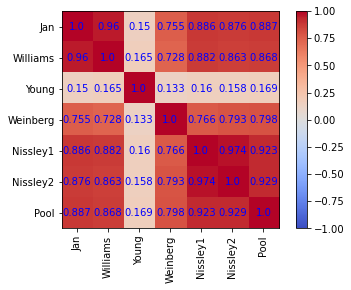

In [7]:
out_path = path+'A_site_profile_file/matrix_file/'
data = pd.read_csv(path+'A_site_profile_file/all_A-site_profile_read_density_in_one_file.tab', sep='\t')
data = data.dropna()
corr = data.corr()
npcorr = np.array(corr)
npcorr = np.round(npcorr, 3)
print(corr)
fig = plt.figure()
ax = fig.add_subplot(111)
cax = ax.imshow(corr, vmin=-1, vmax=1,cmap ='coolwarm') #['coolwarm','PiYG','PRGn','BrBG','PuOr','RdGy','RdBu','RdYlBu', 'RdYlGn', 'Spectral', 'coolwarm', 'bwr', 'seismic']
for i in range(len(dataset)):
    for j in range(len(npcorr)):
        text = ax.text(j, i, npcorr[i, j],
                       ha="center", va="center", color="b")
fig.colorbar(cax)
ticks = np.arange(0,len(data.columns),1)
ax.set_xticks(ticks)
plt.xticks(rotation=90)
ax.set_yticks(ticks)
ax.set_xticklabels(data.columns)
ax.set_yticklabels(data.columns)
fig.savefig(out_path+'correlation_between_all_seven_dataset_at_codon_label.png',  dpi=600, bbox_inches = 'tight')
plt.show()

### Create bar plot to show E-site effect (Average of delta1 medium)

In [85]:
def list_create_for_plot(Input_path, AA_SITE = ''):
    Input_file = pd.read_csv(Input_path,sep='\t')
    aa_list = []
    delta1_average = []
    delta1_sum = []
    for aa in AMINO_ACIDS:
        if aa == '*':
            continue
        if AA_SITE == 'Esite':
            esite = Input_file.Esite == aa
        if AA_SITE == 'Psite':
            esite = Input_file.Psite == aa
        esite_delta1_dataframe = Input_file[esite].Delta1_median    
        esite_delta1_dataframe_list = esite_delta1_dataframe.values.tolist()
        if len(esite_delta1_dataframe_list) == 0:
            continue

        avg = sum(esite_delta1_dataframe_list)/len(esite_delta1_dataframe_list)
        aa_list.append(aa)
        delta1_average.append(avg)
        delta1_sum.append(sum(esite_delta1_dataframe_list))
    return aa_list, delta1_average, delta1_sum

def plot_create(aa_list, delta1_list, subtitle):
    fig = plt.figure(figsize=(2,1), dpi=300, frameon = 'True')
    ax = fig.add_axes([0,0,1,1])
    ax.tick_params(axis='both', which='major', labelsize=4)
    ax.tick_params(axis='both', which='minor', labelsize=4)
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    ax.bar(aa_list,delta1_list)
    fig.suptitle(subtitle, fontsize=4,y=1.08)
    ax.set_xlabel('Amino acid', fontsize=4)
    ax.set_ylabel('Average', fontsize=4)
    plt.show()
    
    return
print('Done')

Done


### Esite site amino acid frequency

In [86]:
# Include Non robust triplet
Input_path = (path+'A_site_profile_file/robust_amino_acid_matrix/Robust_aminoacid_pairs_Not_controlled_for_any_factors_amino_acid_matrix_pvalue_1_delta1_direction_7_cooperativity_effect_direction_threshold_4_datasets.tab')

# Esite
with_non_robust_aa_list, with_non_robust_delta1_average, with_non_robust_delta1_sum = list_create_for_plot(Input_path, AA_SITE = 'Esite')
print('Done')

Done


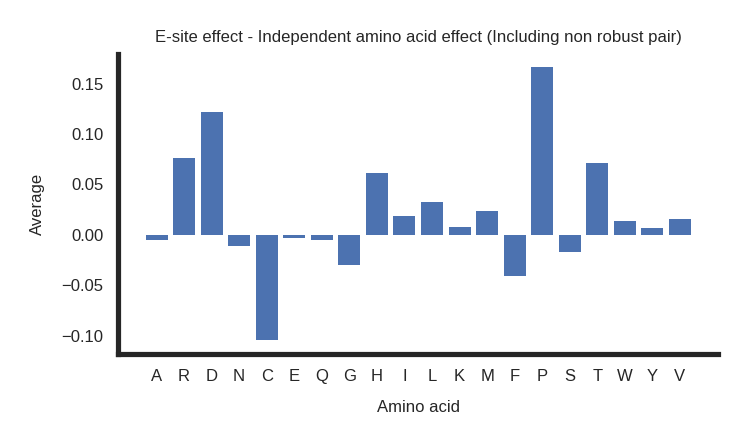

In [87]:
# Average of delta1  (Average = sum of delta1/ number of delta1)
plot_create(with_non_robust_aa_list,with_non_robust_delta1_average, subtitle = 'E-site effect - Independent amino acid effect (Including non robust pair)')

In [88]:
# Excluding Non robust triplet
Input_path = (path+'A_site_profile_file/robust_file_filter/only_robust_pair.tab')
remove_non_robust_aa_list, remove_non_robust_delta1_average, remove_non_robust_delta1_sum = list_create_for_plot(Input_path, AA_SITE = 'Esite')
print('Done')

Done


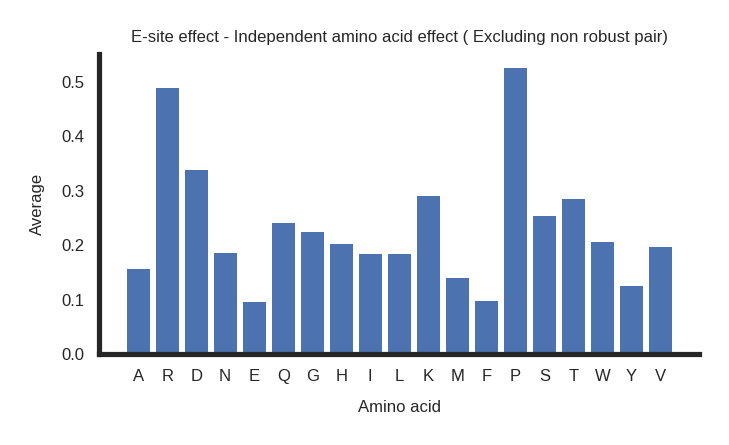

In [89]:
# Average of delta1
plot_create(remove_non_robust_aa_list,remove_non_robust_delta1_average, subtitle = 'E-site effect - Independent amino acid effect ( Excluding non robust pair)')

### Psite site amino acid frequency

In [90]:
# Including Non robust triplet
Input_path = (path+'A_site_profile_file/robust_amino_acid_matrix/Robust_aminoacid_pairs_Not_controlled_for_any_factors_amino_acid_matrix_pvalue_1_delta1_direction_7_cooperativity_effect_direction_threshold_4_datasets.tab')
# Psite
with_non_robust_aa_list, with_non_robust_delta1_average, with_non_robust_delta1_sum = list_create_for_plot(Input_path, AA_SITE = 'Psite')
print('Done')

Done


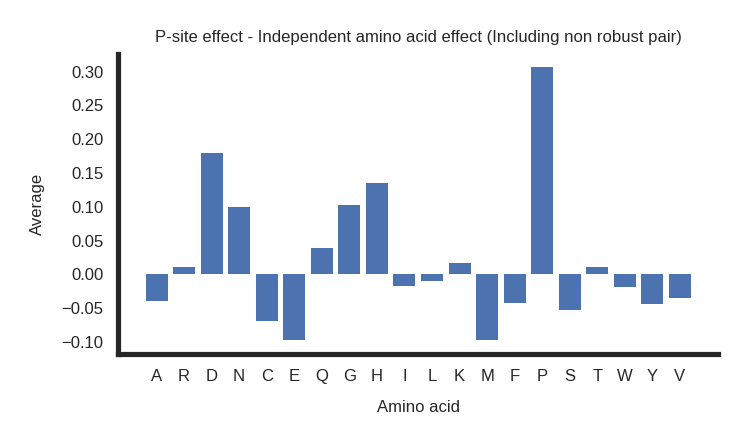

In [91]:
# Average of delta1
plot_create(with_non_robust_aa_list,with_non_robust_delta1_average, subtitle = 'P-site effect - Independent amino acid effect (Including non robust pair)')

In [92]:
# Excluding Non robust triplet
Input_path = (path+'A_site_profile_file/robust_file_filter/only_robust_pair.tab')
remove_non_robust_aa_list, remove_non_robust_delta1_average, remove_non_robust_delta1_sum = list_create_for_plot(Input_path, AA_SITE = 'Psite')
print('Done')

Done


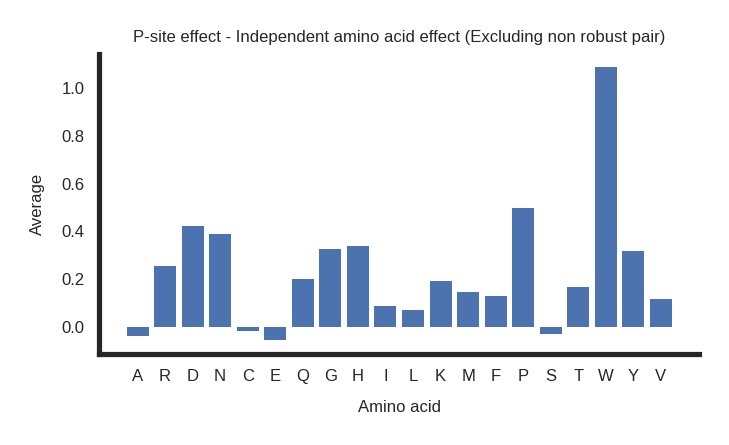

In [93]:
# Average of delta1
plot_create(remove_non_robust_aa_list,remove_non_robust_delta1_average, subtitle = 'P-site effect - Independent amino acid effect (Excluding non robust pair)')

### A, P and E site matrix (Any single site fix)

In [23]:
def file_create(Input_path, out_path, fix_site = ''):
    
    Input_file = pd.read_csv(Input_path,sep='\t')
    
    outpath = out_path+fix_site+'/'
    try:
        os.makedirs(outpath)
    except OSError:
        print("Creation of the directory %s failed")
    else:
        print("Successfully created the directory %s ")

    for aa in AMINO_ACIDS:
        if aa == '*':
            continue
        
        if fix_site == 'E-site':
            esite = Input_file.Esite == aa        
            Input_file[esite].to_csv(outpath+'matrix_file_'+aa+'_'+fix_site+'.tab',index = False, sep ='\t')
            
        if fix_site == 'P-site':
            psite = Input_file.Psite == aa        
            Input_file[psite].to_csv(outpath+'matrix_file_'+aa+'_'+fix_site+'.tab',index = False, sep ='\t')
            
        if fix_site == 'A-site':
            asite = Input_file.Asite == aa        
            Input_file[asite].to_csv(outpath+'matrix_file_'+aa+'_'+fix_site+'.tab',index = False, sep ='\t')

    files = os.listdir(outpath)

    file_list = []
    data_dic = {}
    for file in files:
        if 'file_change' in file:
            continue
        read_file = open(outpath+file,'r')
        next(read_file)
        file_list.append(outpath+file)
        write_read_file = open(outpath+'file_change_'+file,'w')
        write_read_file.write('Pair(psite_asite)\tPair_type\tAvg(delta1)\n')
        for line in read_file:
            split_line = line.split('\t')
            if split_line[4] == 'Non_Robust':
                pair_type = 'Not Robust'
            if split_line[4] != 'Non_Robust':
                pair_type = split_line[3]
            write_read_file = open(outpath+'file_change_'+file,'a')
            
            if fix_site == 'E-site':
                write_read_file.write(split_line[1]+split_line[0]+'\t'+pair_type+'\t'+split_line[5]+'\n')
            
            if fix_site == 'P-site':
                write_read_file.write(split_line[2]+split_line[0]+'\t'+pair_type+'\t'+split_line[5]+'\n')
            
            if fix_site == 'A-site':
                write_read_file.write(split_line[2]+split_line[1]+'\t'+pair_type+'\t'+split_line[5]+'\n')
            
    for old_file in file_list:
        os.remove(old_file) 
    
    return outpath




# color assign for figure
def assign_color(val):
    if val == 10000:
        color = 'gray'
    elif val < -3:
        color = 'blue'
    elif val < -2:
        color = 'green'
    elif val < -1:
        color = 'mediumseagreen'     # darkcyan
    elif val < 0:
        color = 'lightgreen'   # cyan
    elif val > 4:
        # color = 'red'
        color = 'maroon'
    elif val > 3:
        # color = 'darkorange'  red
        color = 'red'
    elif val > 2:
        color = 'tomato'   #darkorange
    elif val > 1:
        color = 'orange'
    elif val > 0:
        color = 'gold'   # yellow
    elif np.isnan(val):
        color = 'silver'
    
    return matplotlib.colors.ColorConverter().to_rgb(color)



#matrix figure geneate
def matrix_fig(input_file, fix_site, ax='', ylabel=True, table = True ):
    # read data for AA matrix
    f = open(input_file )
    lines = f.readlines()
    f.close()
    data_1 = [lines[i].strip().split('\t')[0:3] for i in range(1,len(lines))]
    for i in range(len(data_1)):
        data_1[i][-1] = float(data_1[i][-1])

    #print(data_1)
    title_name = ''
    for aa in AMINO_ACIDS:
        if aa+'_'+fix_site in input_file:
            title_name = aa+' at '+fix_site
        else:
            continue
    
    xlabel_detail = ''
    ylabel_detail = ''
    if fix_site == 'E-site':
        xlabel_detail = 'P-site Amino Acid'
        ylabel_detail = 'A-site Amino Acid'
    
    if fix_site == 'P-site':
        xlabel_detail = 'E-site Amino Acid'
        ylabel_detail = 'A-site Amino Acid'
    
    if fix_site == 'A-site':
        xlabel_detail = 'E-site Amino Acid'
        ylabel_detail = 'P-site Amino Acid'
        
    
    
    #print(data_1)
    # control parameters for figure appearance
    axis_label_fontsize = 18
    legend_fontsize = 14
    pannel_label_fontsize = 20
    ticklabel_fontsize = 12
    spine_linewidth = 2
    tick_width = 2
    tick_length = 4

    matplotlib.rcParams['figure.dpi']= 600

    plt.setp(ax.spines.values(), visible=False)
    ax.tick_params(left=False, labelleft=True, labelbottom=True, bottom=False, direction='out', length=4, width=1)
    ax.grid(False)
    PA_label = ['A','C','D','E','F','G','H','I','K','L','M','N','P','Q','R','S','T','V','W','Y']
    AA_label = ['Y','W','V','T','S','R','Q','P','N','M','L','K','I','H','G','F','E','D','C','A']
    data = np.zeros((len(AA_label), len(PA_label), 3))
    for i in range(len(AA_label)):
        for j in range(len(PA_label)):
            label = PA_label[j]+AA_label[i]
            if len(data_1) ==0 :
                data[i,j,:] = assign_color(10000)
            for k in range(len(data_1)):
                if data_1[k][0] == label:
                    if data_1[k][1] == 'Not Robust':
                        data[i,j,:] = assign_color(np.nan)
                    else:
                        data[i,j,:] = assign_color(data_1[k][2])
                    break
                else:
                    data[i,j,:] = assign_color(10000)

    ax.imshow(data, extent=[-0.5, data.shape[1]-0.5, data.shape[0]-0.46, -0.46])
    ax.set_xticks(np.arange(data.shape[1]))
    ax.set_yticks(np.arange(data.shape[0]))
    ax.set_xticklabels(PA_label, fontsize=ticklabel_fontsize, fontweight='normal')
    ax.set_yticklabels(AA_label, fontsize=ticklabel_fontsize, fontweight='normal')
    for edge, spine in ax.spines.items():
        spine.set_color('k')
        spine.set_linewidth(spine_linewidth-1)
    ax.set_xticks(np.arange(data.shape[1]+1)-.5, minor=True)
    ax.set_yticks(np.arange(data.shape[0]+1)-.5, minor=True)
    ax.grid(which="minor", color="k", linestyle='-', linewidth=spine_linewidth-1)
    ax.tick_params(which="minor", bottom=False, left=False)
    ax.set_xlabel(xlabel_detail, fontsize=axis_label_fontsize)
    if ylabel:  
        ax.set_ylabel(ylabel_detail, fontsize=axis_label_fontsize)
    ax.xaxis.set_tick_params(width=tick_width-1, length=tick_length)
    ax.yaxis.set_tick_params(width=tick_width-1, length=tick_length)
    ax.set_anchor('W')
    ax.set_title(title_name)
    
    # legend 
    cell_text = [['', '', ' < -3'],
                 ['', '', ' < -2'],
                 ['', '', ' < -1'],
                 ['', '', ' < 0'],
                 ['', '', ' > 0'],
                 ['', '', ' > 1'],
                 ['', '', ' > 2'],
                 ['', '', ' > 3'],
                 ['', '', ' > 4'],
                 ['', '', 'Not significant'],
                 ['', '', 'No data']]
    cell_color = [['w', 'blue', 'w'],
                  ['w', 'green', 'w'],
                  ['w', 'mediumseagreen', 'w'],
                  ['w', 'lightgreen', 'w'],
                  ['w', 'gold', 'w'],
                  ['w', 'orange', 'w'],
                  ['w', 'tomato', 'w'],
                  ['w', 'red', 'w'],
                  ['w', 'maroon', 'w'],
                  ['w', 'silver', 'w'],
                  ['w', 'gray', 'w']]
    
    if table:
        handle = ax.table(cellText=cell_text, cellColours=cell_color, cellLoc='left',
                          loc='right', colWidths=[0.05, 0.1, 0.5])
        for i in range(len(cell_text)):
            for j in range(len(cell_text[0])):
                handle[i,j].visible_edges = ''
        for i in range(len(cell_text)):
            handle[i,1].visible_edges = 'BRTL'
        handle.set_fontsize(legend_fontsize)
        handle.scale(0.85, 2)

    return ax


def A_P_E_site_matrix_create(Input_path, out_path, fix_site = ''):
    file_path = file_create(Input_path, out_path, fix_site = fix_site)
    fig = plt.figure(figsize=(20, 30))#, dpi=300)
    counter = 1
    input_file = file_path
    files = os.listdir(input_file)
    for file in files:
        if 'file_change' not in file:
            continue
        ax = fig.add_subplot(5, 4, counter)

        if counter in [1, 5, 9, 13, 17]:
            ylabel = True
        else:
            ylabel = False
        if counter in [4, 8, 12, 16, 20]:
            table = True
        else:
            table = False

        ax = matrix_fig(input_file+file, fix_site, ax=ax, ylabel=ylabel, table = table)
        ax.tick_params(width=1, length=4, axis='both', which='major', labelsize=9, pad=2)
        counter += 1
    fig.savefig(out_path+'A_P_E_site_matrix_'+fix_site+'_fix.png',  dpi=600)
    plt.show()

    
def csv_file_read_and_save(Input_file, outpath, fix_site_name= ''):
    first_row = 0
    print(outpath)
    outpath_file = outpath+'result_file_'+fix_site_name+'_fix.tab'
    for aa in AMINO_ACIDS:
        if aa == '*':
            continue
    
        if fix_site_name == 'E-site':
            fix_site = Input_file.Esite == aa
        if fix_site_name == 'P-site':
            fix_site = Input_file.Psite == aa
        if fix_site_name == 'A-site':
            fix_site = Input_file.Asite == aa

        robust_pair = Input_file.Cooprative_effect != 'Non_Robust'

        fixsite_robust_pair = fix_site & robust_pair
        count = 0
        for site_aa in AMINO_ACIDS:
            
            if fix_site_name == 'E-site':
                alt_site = Input_file.Psite == site_aa
            if fix_site_name == 'P-site':
                alt_site = Input_file.Esite == site_aa
            if fix_site_name == 'A-site':
                alt_site = Input_file.Esite == site_aa
                
            esite_p_site_fix = fixsite_robust_pair & alt_site
            delta1_dataframe = Input_file[esite_p_site_fix].Delta1_median
            delta1_list = delta1_dataframe.values.tolist()
            count = 0
            if len(delta1_list) == 0:
                continue
            if all(delta1_value < 0 for delta1_value in delta1_list):
                for fix_site_aa in AMINO_ACIDS:
                    if aa == fix_site_aa:
                        continue
                    
                    if fix_site_name == 'E-site':
                        alt_fix_site = Input_file.Esite == fix_site_aa
                    if fix_site_name == 'P-site':
                        alt_fix_site = Input_file.Psite == fix_site_aa
                    if fix_site_name == 'A-site':
                        alt_fix_site = Input_file.Asite == fix_site_aa
                    alt_esite_fix_psite = alt_fix_site & alt_site & robust_pair
                    alt_delta1_dataframe = Input_file[alt_esite_fix_psite].Delta1_median
                    alt_delta1_list = alt_delta1_dataframe.values.tolist()
                    if all(delta1_value1 > 0 for delta1_value1 in alt_delta1_list):

                        if count == 0:
                            if first_row == 0:
                                outfile = open(outpath_file, 'w')
                                Input_file[esite_p_site_fix].to_csv(outfile, mode='w', header=True, index = False, sep ='\t')
                                outfile.close() 
                                first_row+=1
                            else:
                                outfile = open(outpath_file, 'a')
                                Input_file[esite_p_site_fix].to_csv(outfile, header=False,index = False, sep ='\t')
                                outfile.close()
                            count+=1
                        data_length = len(Input_file[alt_esite_fix_psite])
                        if data_length == 0:
                            continue
                        outfile = open(outpath_file, 'a')
                        Input_file[alt_esite_fix_psite].to_csv(outfile, header=False, index = False, sep ='\t')
                        outfile.close() 
    return

### To find out result with site complete change the speed
### eg,. Asite fix but Psite amino acid (eg. G showing speed up) and Esite amino acid (G showing Slow down)
def complete_site_change_speed(Input_path, out_path, fix_site = ''):    
    Input_file = pd.read_csv(Input_path,sep='\t')    
    outpath = out_path+'complete_site_change/'
    try:
        os.makedirs(outpath)
    except OSError:
        print("Creation of the directory %s failed")
    else:
        print("Successfully created the directory %s ")
    
    if fix_site == 'E-site':
        csv_file_read_and_save(Input_file, outpath, fix_site_name= fix_site)       

    if fix_site == 'P-site':
        csv_file_read_and_save(Input_file, outpath, fix_site_name= fix_site)

    if fix_site == 'A-site':
        csv_file_read_and_save(Input_file, outpath, fix_site_name= fix_site)        
    
    return


# READ FILE AND SEPERATE OUT RESULT WITH WHEN ONE SITE ARE FIX AND ONE SITE COMPLETE ROW CHANGE SPEED
def file_create1(path, outpath, site_name):
    files = os.listdir(path)
    outpath1 = path+site_name+'/'
    
    try:
        os.makedirs(outpath1)
    except OSError:
        print("Creation of the directory %s failed")
    else:
        print("Successfully created the directory %s ")
    
    
    for file in files:
        if site_name in file:
            if '.tab' in file:
                Input_file = pd.read_csv(path+file, sep='\t').drop_duplicates(keep='first') #usecols=['Asite', 'Psite','Esite','Speed']
                if site_name == 'E-site':
                    for aa in AMINO_ACIDS:
                        if aa == '*':
                            continue
                        psite = Input_file.Psite == aa
                        Input_file[psite].to_csv(outpath1+'matrix_file_'+aa+'_'+site_name+'.tab',index = False, sep ='\t', columns=['Asite', 'Psite','Esite','Speed','Delta1_median'])
                if site_name == 'P-site':
                    for aa in AMINO_ACIDS:
                        if aa == '*':
                            continue
                        psite = Input_file.Esite == aa
                        Input_file[psite].to_csv(outpath1+'matrix_file_'+aa+'_'+site_name+'.tab',index = False, sep ='\t', columns=['Asite', 'Psite','Esite','Speed','Delta1_median'])
                if site_name == 'A-site':
                    for aa in AMINO_ACIDS:
                        if aa == '*':
                            continue
                        psite = Input_file.Esite == aa
                        Input_file[psite].to_csv(outpath1+'matrix_file_'+aa+'_'+site_name+'.tab',index = False, sep ='\t', columns=['Asite', 'Psite','Esite','Speed','Delta1_median'])

    return



def file_dic(result_file_path, site):
    Input_file = pd.read_csv(result_file_path,sep='\t')
    file_pair_dic = {}
    
    if site == 'E-site':        
        for Psite_aa in AMINO_ACIDS:
            file_pair_dic[Psite_aa] = {}
            for Esite_aa in AMINO_ACIDS:
                file_pair_dic[Psite_aa][Esite_aa] = []                
        
        for Psite_aa in AMINO_ACIDS:
            for Esite_aa in AMINO_ACIDS:
                all_psite_pair = Input_file.Psite == Psite_aa
                esite_psite_pair = Input_file.Esite == Esite_aa
                only_non_robust_pair = Input_file.Cooprative_effect == 'Non_Robust'                
                ESITE_PSITE_PAIR = all_psite_pair & esite_psite_pair & only_non_robust_pair
                file_pair_dic[Psite_aa][Esite_aa].append(Input_file[ESITE_PSITE_PAIR].values.tolist())      
        
        
    if site == 'P-site':
        for Esite_aa in AMINO_ACIDS:
            file_pair_dic[Esite_aa] = {}
            for Psite_aa in AMINO_ACIDS:
                file_pair_dic[Esite_aa][Psite_aa] = []                
        
        for Esite_aa in AMINO_ACIDS:
            for Psite_aa in AMINO_ACIDS:
                all_esite_pair = Input_file.Esite == Esite_aa
                psite_esite_pair = Input_file.Psite == Psite_aa
                only_non_robust_pair = Input_file.Cooprative_effect == 'Non_Robust'                
                ESITE_PSITE_PAIR = all_esite_pair & psite_esite_pair & only_non_robust_pair
                file_pair_dic[Esite_aa][Psite_aa].append(Input_file[ESITE_PSITE_PAIR].values.tolist())
        
    if site == 'A-site':
        
        for Esite_aa in AMINO_ACIDS:
            file_pair_dic[Esite_aa] = {}
            for Asite_aa in AMINO_ACIDS:
                file_pair_dic[Esite_aa][Asite_aa] = []                
        
        for Esite_aa in AMINO_ACIDS:
            for Asite_aa in AMINO_ACIDS:
                all_esite_pair = Input_file.Esite == Esite_aa
                esite_asite_pair = Input_file.Asite == Asite_aa
                only_non_robust_pair = Input_file.Cooprative_effect == 'Non_Robust'                
                ESITE_ASITE_PAIR = all_esite_pair & esite_asite_pair & only_non_robust_pair
                file_pair_dic[Esite_aa][Asite_aa].append(Input_file[ESITE_ASITE_PAIR].values.tolist())
    
    
    return file_pair_dic


def unique(list1):     
    # insert the list to the set
    list_set = set(list1)
    # convert the set to the list
    unique_list = (list(list_set))
    
    return unique_list

def add_non_robust_pair(input_path, site, file_pair_dic):
    
    file_dic_path = input_path+site+'/'
    files = os.listdir(file_dic_path)    
    
    file_list = []
    for file in files:
        if 'new' in file:
            continue
        file_read = open(input_path+site+'/'+file, 'r')
        file_list.append(input_path+site+'/'+file)
        new_file = open(input_path+site+'/new_'+file, 'w')
        new_file.write('Asite\tPsite\tEsite\tSpeed\tDelta1_median\n')
        pair_list = []
        next(file_read)
        for line in file_read:
            new_file = open(input_path+site+'/new_'+file, 'a')
            line1 = line.split('\t')
            if site == 'E-site':
                Esite_pair = line1[2]
                Psite_pair = line1[1]
                pair_list.append(Psite_pair+Esite_pair)
            if site == 'P-site':
                Esite_pair = line1[2]
                Psite_pair = line1[1]
                pair_list.append(Esite_pair+Psite_pair)
                
            if site == 'A-site':
                Esite_pair = line1[2]
                Asite_pair = line1[0]
                pair_list.append(Esite_pair+Asite_pair)
            new_file.write(line)
        unique_pair_list = unique(pair_list)
        for aa_pair in unique_pair_list:
            new_file = open(input_path+site+'/new_'+file, 'a')
            all_pair_list = file_pair_dic[aa_pair[0]][aa_pair[1]]
            for pair_detail in all_pair_list[0]:
                new_file.write(pair_detail[0]+'\t'+pair_detail[1]+'\t'+pair_detail[2]+'\t'+pair_detail[4]+'\t'+str(pair_detail[5])+'\n')

    for old_file in file_list:
        os.remove(old_file) 
    
    return


#matrix figure geneate
def matrix_fig1(input_file, fix_site, ax='', ylabel=True, table = True ):
    # read data for AA matrix
       
    xlabel_detail = ''
    ylabel_detail = ''
    if fix_site == 'E-site':
        xlabel_detail = 'E-site Amino Acid'
        ylabel_detail = 'A-site Amino Acid'
    
    if fix_site == 'P-site':
        xlabel_detail = 'P-site Amino Acid'
        ylabel_detail = 'A-site Amino Acid'
    
    if fix_site == 'A-site':
        xlabel_detail = 'A-site Amino Acid'
        ylabel_detail = 'P-site Amino Acid'
        
    # control parameters for figure appearance
    axis_label_fontsize = 18
    legend_fontsize = 14
    pannel_label_fontsize = 20
    ticklabel_fontsize = 12
    spine_linewidth = 2
    tick_width = 2
    tick_length = 4
    matplotlib.rcParams['figure.dpi']= 600
    
    if fix_site == 'E-site':
        f = open(input_file )
        lines = f.readlines()
        f.close()
        data_2 = []
        Psite_lable_list = []
        Esite_lable_list = []
        for i in range(1,len(lines)):
            data_1 = lines[i].strip().split('\t')[0:5]
            Psite_lable_list.append(data_1[1])
            Esite_lable_list.append(data_1[2])
            data_pair = data_1[2]+data_1[0]
            data_2.append([data_pair]+[data_1[3]]+[float(data_1[4])])


        Psite_lable = unique(Psite_lable_list)
        Esite_lable = unique(Esite_lable_list)

        title_name = Psite_lable[0] +' at Psite'

        plt.setp(ax.spines.values(), visible=False)
        ax.tick_params(left=False, labelleft=True, labelbottom=True, bottom=False, direction='out', length=4, width=1)
        ax.grid(False)    
        AA_label = ['Y','W','V','T','S','R','Q','P','N','M','L','K','I','H','G','F','E','D','C','A']
        PA_label = Psite_lable
        EA_label = Esite_lable
        data = np.zeros((len(AA_label), len(Esite_lable), 3))
        for i in range(len(AA_label)):
            for j in range(len(EA_label)):
                label = Esite_lable[j]+AA_label[i]
                if len(data_2) ==0 :
                    data[i,j,:] = assign_color(10000)
                for k in range(len(data_2)):
                    if data_2[k][0] == label:
                        if data_2[k][1] == 'Non_Robust':
                            data[i,j,:] = assign_color(np.nan)
                        else:
                            data[i,j,:] = assign_color(data_2[k][2])
                        break
                    else:
                        data[i,j,:] = assign_color(10000)
                        
        ax.set_xticklabels(Esite_lable, fontsize=ticklabel_fontsize, fontweight='normal') 
        ax.set_yticklabels(AA_label, fontsize=ticklabel_fontsize, fontweight='normal')
                    
    if fix_site == 'P-site':
        f = open(input_file )
        lines = f.readlines()
        f.close()
        data_2 = []
        Psite_lable_list = []
        Esite_lable_list = []
        for i in range(1,len(lines)):
            data_1 = lines[i].strip().split('\t')[0:5]
            Psite_lable_list.append(data_1[1])
            Esite_lable_list.append(data_1[2])
            data_pair = data_1[1]+data_1[0]
            data_2.append([data_pair]+[data_1[3]]+[float(data_1[4])])

        Psite_lable = unique(Psite_lable_list)
        Esite_lable = unique(Esite_lable_list)
        title_name = Esite_lable[0] +' at Esite'

        plt.setp(ax.spines.values(), visible=False)
        ax.tick_params(left=False, labelleft=True, labelbottom=True, bottom=False, direction='out', length=4, width=1)
        ax.grid(False)    
        AA_label = ['Y','W','V','T','S','R','Q','P','N','M','L','K','I','H','G','F','E','D','C','A']
        PA_label = Psite_lable
        EA_label = Esite_lable
        data = np.zeros((len(AA_label), len(Psite_lable), 3))
        for i in range(len(AA_label)):
            for j in range(len(PA_label)):
                label = Psite_lable[j]+AA_label[i]
                if len(data_2) ==0 :
                    data[i,j,:] = assign_color(10000)
                for k in range(len(data_2)):
                    if data_2[k][0] == label:
                        if data_2[k][1] == 'Non_Robust':
                            data[i,j,:] = assign_color(np.nan)
                        else:
                            data[i,j,:] = assign_color(data_2[k][2])
                        break
                    else:
                        data[i,j,:] = assign_color(10000)
                        
        ax.set_xticklabels(Psite_lable, fontsize=ticklabel_fontsize, fontweight='normal') 
        ax.set_yticklabels(AA_label, fontsize=ticklabel_fontsize, fontweight='normal')
        
        
    if fix_site == 'A-site':   
        f = open(input_file )
        lines = f.readlines()
        f.close()
        data_2 = []
        Psite_lable_list = []
        Asite_lable_list = []
        Esite_lable_list = []
        for i in range(1,len(lines)):
            data_1 = lines[i].strip().split('\t')[0:5]
            Asite_lable_list.append(data_1[0])
            Psite_lable_list.append(data_1[1])
            Esite_lable_list.append(data_1[2])
            data_pair = data_1[0]+data_1[1]
            data_2.append([data_pair]+[data_1[3]]+[float(data_1[4])])

        Asite_lable = unique(Asite_lable_list)
        Esite_lable = unique(Esite_lable_list)
        

        title_name = Esite_lable[0] +' at Esite'

        plt.setp(ax.spines.values(), visible=False)
        ax.tick_params(left=False, labelleft=True, labelbottom=True, bottom=False, direction='out', length=4, width=1)
        ax.grid(False)    
        AA_label = Asite_lable
        PA_label = ['Y','W','V','T','S','R','Q','P','N','M','L','K','I','H','G','F','E','D','C','A']
        EA_label = Esite_lable
        data = np.zeros((len(PA_label), len(Asite_lable), 3))
        for i in range(len(PA_label)):
            for j in range(len(Asite_lable)):
                label = Asite_lable[j]+PA_label[i]
                if len(data_2) ==0 :
                    data[i,j,:] = assign_color(10000)
                for k in range(len(data_2)):
                    if data_2[k][0] == label:
                        if data_2[k][1] == 'Non_Robust':
                            data[i,j,:] = assign_color(np.nan)
                        else:
                            data[i,j,:] = assign_color(data_2[k][2])
                        break
                    else:
                        data[i,j,:] = assign_color(10000)
                        
        ax.set_xticklabels(AA_label, fontsize=ticklabel_fontsize, fontweight='normal') 
        ax.set_yticklabels(PA_label, fontsize=ticklabel_fontsize, fontweight='normal')

    ax.imshow(data, extent=[-0.5, data.shape[1]-0.5, data.shape[0]-0.46, -0.46])
    ax.set_xticks(np.arange(data.shape[1]))
    ax.set_yticks(np.arange(data.shape[0]))
    
    for edge, spine in ax.spines.items():
        spine.set_color('k')
        spine.set_linewidth(spine_linewidth-1)
    ax.set_xticks(np.arange(data.shape[1]+1)-.5, minor=True)
    ax.set_yticks(np.arange(data.shape[0]+1)-.5, minor=True)
    ax.grid(which="minor", color="k", linestyle='-', linewidth=spine_linewidth-1)
    ax.tick_params(which="minor", bottom=False, left=False)
    ax.set_xlabel(xlabel_detail, fontsize=axis_label_fontsize)
    if ylabel:  
        ax.set_ylabel(ylabel_detail, fontsize=axis_label_fontsize)
    ax.xaxis.set_tick_params(width=tick_width-1, length=tick_length)
    ax.yaxis.set_tick_params(width=tick_width-1, length=tick_length)
    ax.set_anchor('W')
    ax.set_title(title_name)
    
    # legend 
    cell_text = [['', '', ' < -3'],
                 ['', '', ' < -2'],
                 ['', '', ' < -1'],
                 ['', '', ' < 0'],
                 ['', '', ' > 0'],
                 ['', '', ' > 1'],
                 ['', '', ' > 2'],
                 ['', '', ' > 3'],
                 ['', '', ' > 4'],
                 ['', '', 'Not significant'],
                 ['', '', 'No data']]
    cell_color = [['w', 'blue', 'w'],
                  ['w', 'green', 'w'],
                  ['w', 'mediumseagreen', 'w'],
                  ['w', 'lightgreen', 'w'],
                  ['w', 'gold', 'w'],
                  ['w', 'orange', 'w'],
                  ['w', 'tomato', 'w'],
                  ['w', 'red', 'w'],
                  ['w', 'maroon', 'w'],
                  ['w', 'silver', 'w'],
                  ['w', 'gray', 'w']]
    
    if table:
        handle = ax.table(cellText=cell_text, cellColours=cell_color, cellLoc='left',
                          loc='right', colWidths=[0.05, 0.1, 0.5])
        for i in range(len(cell_text)):
            for j in range(len(cell_text[0])):
                handle[i,j].visible_edges = ''
        for i in range(len(cell_text)):
            handle[i,1].visible_edges = 'BRTL'
        handle.set_fontsize(legend_fontsize)
        handle.scale(0.85, 2)
    return ax


def check_data_availability(input_file_name):
    length = 0
    file_read = open(input_file_name, 'r')    
    for line in file_read:
        length+=1
    
    return length

def A_P_E_site_matrix_create1(outpath, out_path, fix_site = ''):
    fig = plt.figure(figsize=(20, 30))#, dpi=300)
    counter = 1
    files = os.listdir(outpath)
    
    total_file = 0
    for file in files:
        length = check_data_availability(outpath+file)
        if length <2:
            continue
        total_file+=1
    
    for file in files:
        length = check_data_availability(outpath+file)
        if length <2:
            print(file)
            continue
        
        ax = fig.add_subplot(5, 4, counter)

        if counter in [1, 5, 9, 13, 17]:
            ylabel = True
        else:
            ylabel = False
        if counter in [20, total_file]: #[4, 8, 12, 16, 20, total_file]:
            table = True
        else:
            table = False

        ax = matrix_fig1(outpath+file, fix_site, ax=ax, ylabel=ylabel, table = table)
        ax.tick_params(width=1, length=4, axis='both', which='major', labelsize=9, pad=2)
        counter += 1
    fig.savefig(out_path+'A_P_E_site_matrix_speed_change_column_pick_'+fix_site+'.png',  dpi=600)
    plt.show()

    return 

print ('\nDone')


Done


#### Robust restricted Filter file used 
1. Threshold_value = 1
2. Delta_direction_threshold = 7
3. Cooperativity_effect_direction_threshold = 4
4. Total_dataset = 7

### A and P site matrix (Esite fix)

Creation of the directory %s failed


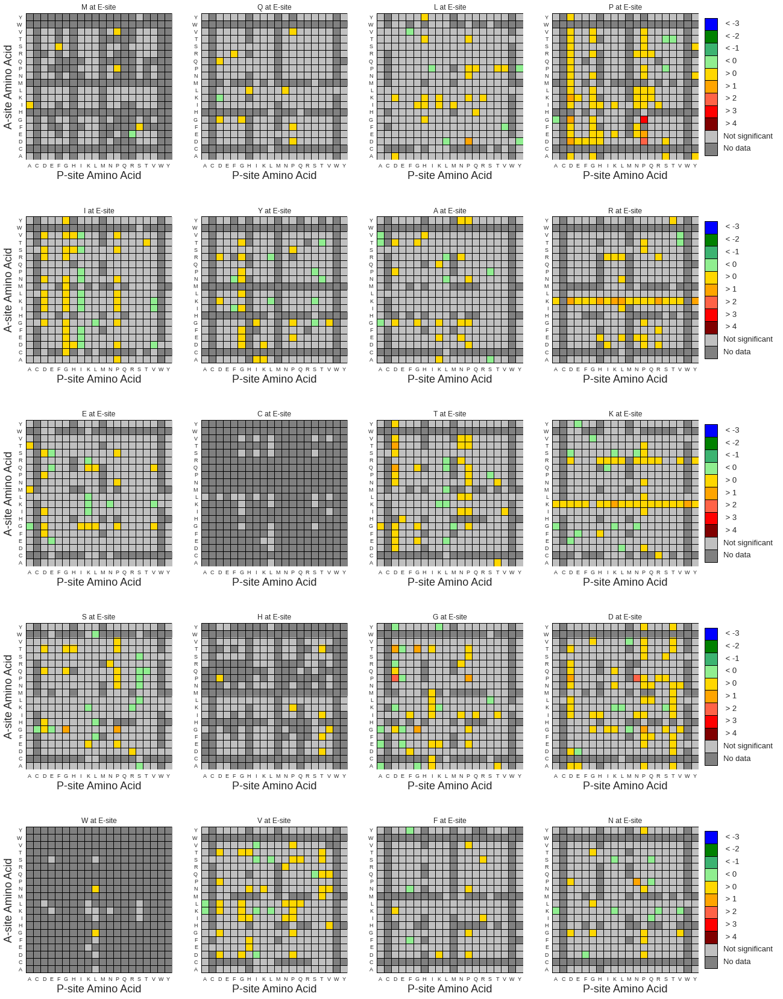

In [24]:
Input_path= path+'A_site_profile_file/robust_amino_acid_matrix/Robust_aminoacid_pairs_Not_controlled_for_any_factors_amino_acid_matrix_pvalue_1_delta1_direction_7_cooperativity_effect_direction_threshold_4_datasets.tab'
#result_file_path = path+'A_site_profile_file/robust_amino_acid_matrix/Robust_aminoacid_pairs_Not_controlled_for_any_factors_amino_acid_matrix_1_datasets.tab'
File_path = path+'A_site_profile_file/matrix_file/complete_site_change/'
out_path = path+'A_site_profile_file/matrix_file/'

A_P_E_site_matrix_create(Input_path, out_path, fix_site = 'E-site')

### Find out result with complete row change speed

In [25]:
complete_site_change_speed(Input_path, out_path, fix_site = 'E-site')
file_create1(File_path , out_path, 'E-site')
file_pair_dic = file_dic(Input_path, 'E-site')
add_non_robust_pair(File_path, 'E-site', file_pair_dic)

print('WHEN P-site IS FIX')
outpath = File_path+'E-site/'
A_P_E_site_matrix_create1(outpath, out_path, fix_site = 'E-site')
print('Done')

Creation of the directory %s failed
/gpfs/group/epo2/default/nks5512/find_cooperativity_and_no_cooperativity/A_P_Site_matrix_Amino_acid_level_find_cooperativity_and_no_cooperativity_with_75%_coverage/A_site_profile_file/matrix_file/complete_site_change/
Creation of the directory %s failed
WHEN P-site IS FIX
new_matrix_file_P_E-site.tab
new_matrix_file_D_E-site.tab
new_matrix_file_W_E-site.tab
new_matrix_file_H_E-site.tab


Done


### A and E site matrix (Psite fix)

In [26]:
A_P_E_site_matrix_create(Input_path, out_path, fix_site = 'P-site')

Creation of the directory %s failed


### Find out result with complete row change speed

In [27]:
complete_site_change_speed(Input_path, out_path, fix_site = 'P-site')
file_create1(File_path , out_path, 'P-site')
file_pair_dic = file_dic(Input_path, 'P-site')
add_non_robust_pair(File_path, 'P-site', file_pair_dic)

print('WHEN E-site IS FIX')
outpath = File_path+'P-site/'
A_P_E_site_matrix_create1(outpath, out_path, fix_site = 'P-site')
print('Done')

Creation of the directory %s failed
/gpfs/group/epo2/default/nks5512/find_cooperativity_and_no_cooperativity/A_P_Site_matrix_Amino_acid_level_find_cooperativity_and_no_cooperativity_with_75%_coverage/A_site_profile_file/matrix_file/complete_site_change/
Creation of the directory %s failed
WHEN E-site IS FIX
new_matrix_file_Q_P-site.tab
new_matrix_file_R_P-site.tab
new_matrix_file_C_P-site.tab
new_matrix_file_W_P-site.tab
new_matrix_file_H_P-site.tab


Done


### P and E site matrix (Asite fix)

In [28]:
A_P_E_site_matrix_create(Input_path, out_path, fix_site = 'A-site')

Creation of the directory %s failed


In [29]:
complete_site_change_speed(Input_path, out_path, fix_site = 'A-site')
file_create1(File_path , out_path, 'A-site')
file_pair_dic = file_dic(Input_path, 'A-site')
add_non_robust_pair(File_path, 'A-site', file_pair_dic)

print('WHEN E-site IS FIX')
outpath = File_path+'A-site/'
A_P_E_site_matrix_create1(outpath, out_path, fix_site = 'A-site')
print('Done')

Creation of the directory %s failed
/gpfs/group/epo2/default/nks5512/find_cooperativity_and_no_cooperativity/A_P_Site_matrix_Amino_acid_level_find_cooperativity_and_no_cooperativity_with_75%_coverage/A_site_profile_file/matrix_file/complete_site_change/
Creation of the directory %s failed
WHEN E-site IS FIX
new_matrix_file_Y_A-site.tab
new_matrix_file_A_A-site.tab
new_matrix_file_W_A-site.tab
new_matrix_file_H_A-site.tab
new_matrix_file_V_A-site.tab
new_matrix_file_D_A-site.tab
new_matrix_file_P_A-site.tab
new_matrix_file_C_A-site.tab


Done


## Compare A, P & A, P and E site, and present how E site play import role in regulating the speed of translation

In [29]:
def dictionary_create(ap_file,ape_file):
    # create AP file dictionary 
    ap_file_read = open(ap_file, 'r')
    next(ap_file_read)
    ap_dic = {rows.split('\t')[0][1]+rows.split('\t')[0][0]:rows.split('\t')[2] for rows in ap_file_read}
    
    # create APE file dictionary 
    ape_file_read = open(ape_file, 'r')
    next(ape_file_read)
    ape_dic = {rows.split('\t')[0]+rows.split('\t')[1]+rows.split('\t')[2]:rows.split('\t')[82] for rows in ape_file_read}
    
    return ap_dic, ape_dic

def plot_create(ap_dic, ape_dic, ap_pair, axs = '', ylabel = True):
    
    ap_name = ap_pair
    ap_pecetage_list = [float(ap_dic[ap_pair])]
    
    ape_name_fast = []
    ape_pecetage_list_fast = []
    ape_name_slow = []
    ape_pecetage_list_slow = []
    pos = 0
    for aa in AMINO_ACIDS:
        if aa == '*':
            continue
        if ap_pair+aa in ape_dic:
            if float(ape_dic[ap_pair+aa])>0:                
                ape_name_slow.append('**'+aa)
                ape_pecetage_list_slow.append(float(ape_dic[ap_pair+aa]))
            else:
                if pos == 0:
                    ape_name_fast.append(ap_pair+aa)
                    pos+=1
                else:
                    ape_name_fast.append('**'+aa)
                ape_pecetage_list_fast.append(float(ape_dic[ap_pair+aa]))
    combined_list = ap_pecetage_list+ape_pecetage_list_slow+ape_pecetage_list_fast
    
    axs.tick_params(left=True, labelleft=True, labelbottom=True, bottom=False, direction='out', length=4, width=1, labelsize=1)    
    axs.spines['right'].set_visible(False)
    axs.spines['top'].set_visible(False)
    #axs.set_xlabel('A , P and E site Triplets compare with A and P site pair', fontsize=4)
    axs.set_xlabel('A , P and E site Triplets v/s A and P site pair', fontsize=4)
    plt.xticks(rotation=45)
    if ylabel:  
        axs.set_ylabel('Percentage Change', fontsize=4)
    axs.set_ylim(min(combined_list)-4, max(combined_list)+4)
    axs.plot(ap_name, ap_pecetage_list, '*', label=str('Fast Triplet'))
    axs.plot(ape_name_fast, ape_pecetage_list_fast, 'v', label='Fast Triplet')
    axs.plot(ape_name_slow, ape_pecetage_list_slow, '^', label='Fast Triplet')
    data_list = ap_pecetage_list+ape_pecetage_list_fast+ape_pecetage_list_slow
    plt.axhline(y=0, color='r', linestyle=':')
    return axs


print('Done')

Done


Total Plot = 5


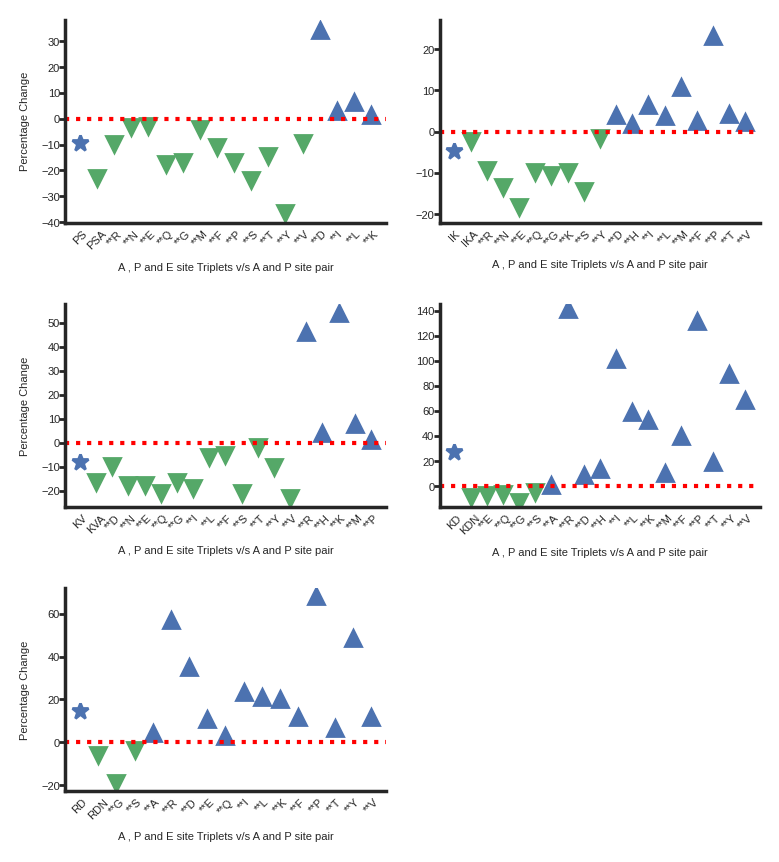

In [32]:
# A and P site robust file read
ap_file = path+'A_site_profile_file/A_and_p_site_file_at_75%_coverage_with_dataset/Robust_aminoacid_pairs_Not_controlled_for_any_factors_amino_acid_matrix_4_datasets.tab'
# A, P and E site robust file read
ape_file = path+'A_site_profile_file/robust_amino_acid_matrix/robust_file_with_percentage_change/Robust_aminoacid_pairs_Not_controlled_for_any_factors_amino_acid_matrix_pvalue_1_delta1_direction_7_cooperativity_effect_direction_threshold_4_datasets_with_percentage_change.tab'
out_path = path+'A_site_profile_file/matrix_file/'
ap_dic, ape_dic = dictionary_create(ap_file,ape_file)
pair_list = ['PS', 'IK', 'KV', 'KD', 'RD']
data_length = len(pair_list)
fig = plt.figure(figsize=(4,7), dpi=200)
counter = 1
total_plot = 0

for pair in pair_list:
    axs = fig.add_subplot(data_length, 2, counter)
    
    if counter % 2 != 0:
        ylabel = True
    else:
        ylabel = False
    
    axs = plot_create(ap_dic, ape_dic, pair, axs = axs, ylabel = ylabel)
    axs.tick_params(width=1, length=2, axis='both', which='major', labelsize=4, pad=0)
    plt.tight_layout()
    total_plot+=1
    counter+=1

print('Total Plot =', total_plot)
fig.savefig(out_path+'A_P_and_E_site_triplets_vs_A_and_P_site pair.jpg', dpi=600)
plt.show()

## Speed change (A and P site fix and E site change), Triplet selected only from Robust file (Total 588 robust triplet)

###### https://stackoverflow.com/questions/24963711/matplotlib-setting-both-major-and-minor-ticks-forces-same-x-and-y-scale

In [255]:
def esite_change_analysis(input_path):
    Input_file = open(input_path,'r')
    next(Input_file)
    
    ape_dic = {}
    for asite_aa in AMINO_ACIDS:
        for psite_aa in AMINO_ACIDS:
            ap_site= asite_aa+psite_aa
            ape_dic[ap_site] = {}
            for esite_aa in AMINO_ACIDS:
                ape_dic[ap_site]['Speed_up'] =[]
                ape_dic[ap_site]['Slow_Down'] =[]
    for line in Input_file:
        line1 = line.split('\t')
        Asite = line1[0]
        Psite = line1[1]
        Esite = line1[2]
        Speed = line1[3]
        Delta1 = line1[5]
        A_P_site = Asite+Psite
        A_P_E_site = Asite+Psite+Esite
        if line1[3] == 'Speed_up':
            ape_dic[A_P_site][Speed].append(A_P_E_site)
            #print(ape_dic[A_P_site][Speed])
            ape_dic[A_P_site][Speed].append(Delta1)
        if line1[3] == 'Slow_Down':
            ape_dic[A_P_site][Speed].append(A_P_E_site)
            ape_dic[A_P_site][Speed].append(Delta1)

    return ape_dic

def plot_create(ape_dic_key, key, axs = '', ylabel = True):
    speed_up_triplet_list = []
    speed_up_delat1_list = []
    Slow_down_triplet_list = []
    Slow_down_delat1_list= []
    count = 0
    for values in ape_dic_key['Speed_up']:
        if count % 2 == 0:
            speed_up_triplet_list.append(values)
        if count % 2 != 0:
            speed_up_delat1_list.append(values)
        count+=1
        
    count = 0
    for values in ape_dic_key['Slow_Down']:
        if count % 2 == 0:
            Slow_down_triplet_list.append(values)
        if count % 2 != 0:
            Slow_down_delat1_list.append(values)
        count+=1
    speed_up_data_float = []
    Slow_down_data_float = []
    for data_value in speed_up_delat1_list:
        speed_up_data_float.append(float(data_value))
    
    for data_value in Slow_down_delat1_list:
        Slow_down_data_float.append(float(data_value))
    names = speed_up_triplet_list+Slow_down_triplet_list
    axs.tick_params(left=True, labelleft=True, labelbottom=True, bottom=False, direction='out', length=4, width=1, labelsize=2)
    #axs.tick_params(left=True, labelleft=True, labelbottom=True, bottom=False, direction='out', length=2, width=1, labelsize=1)
    axs.spines['right'].set_visible(False)
    axs.spines['top'].set_visible(False)
    axs.set_xlabel('Triplets', fontsize=5)
    plt.xticks(rotation=45)
    if ylabel:  
        axs.set_ylabel('Delta1 range', fontsize=5)
    axs.set_ylim(min(speed_up_data_float)-0.5, max(Slow_down_data_float)+0.5)
    #axs.plot(speed_up_triplet_list, speed_up_data_float, '.', linewidth=5)
    axs.scatter(speed_up_triplet_list, speed_up_data_float, s=1)#, '.')
    #axs.plot(Slow_down_triplet_list, Slow_down_data_float, '.')
    axs.scatter(Slow_down_triplet_list, Slow_down_data_float, s=1)
    plt.axhline(y=0, color='r', linestyle='-', linewidth=0.5)    

    return axs


print('Done')

Done


SystemExit: 

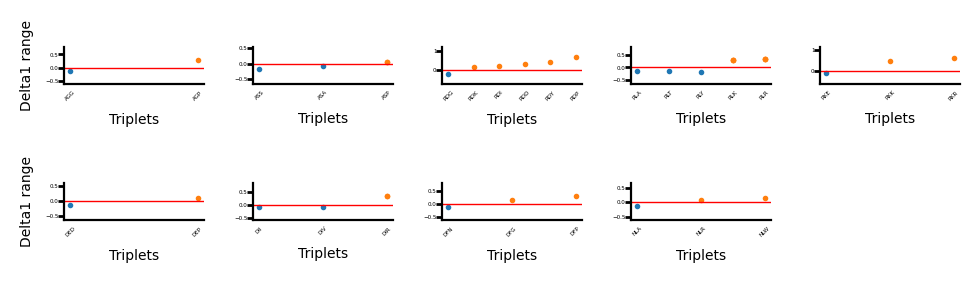

In [262]:
input_path = path+'A_site_profile_file/robust_file_filter/Changing_E_site.tab'
out_path = path+'A_site_profile_file/matrix_file/'
ape_dic = esite_change_analysis(input_path)
data_length = len(ape_dic)
fig = plt.figure(figsize=(5, 300), dpi=200)#, dpi=200)
counter = 1

total_plot = 0
counter = 1
for key, value in ape_dic.items():
    if len(ape_dic[key]['Speed_up']) == 0:
        continue   
    
    axs = fig.add_subplot(data_length, 5, counter)
    
    #if counter % 4 != 0:
    if counter % 6 == 0 or counter == 1:
        ylabel = True
    else:
        ylabel = False
    
    axs = plot_create(ape_dic[key], key, axs = axs, ylabel = ylabel)
    axs.tick_params(width=1, length=2, axis='both', which='major', labelsize=2, pad=0)
    plt.tight_layout()
    total_plot+=1
    counter+=1
    if counter == 10:
        sys.exit()
print('Total Plot =', total_plot)
fig.savefig(out_path+'E_site_effect_triplets.png', dpi=200, bbox_inches = 'tight')
plt.show()


## Plotting the normalized ribosome density distributions between two triplets (triplet pair example show how mutated at E-site change the translation elongation rate)

In [30]:
# Calculate oddds between two triplet
def odds_speed_change_aa(densities_list1, densities_list2):
    list_diff = []
    for density1 in densities_list1:
        for density2 in densities_list2:
            diff = density2-density1
            list_diff.append(diff)
    median_diff = np.median(densities_list2) - np.median(densities_list1)
    # If the median of second list is higher, then  Density_list1 is fast and Density_list2 is slow and hence we calculate the odds of slowdown upon mutation from 1-->2
    if median_diff > 0:
        try:
            odds = float(sum(i > 0 for i in list_diff))/float(sum(i < 0 for i in list_diff))
        except ZeroDivisionError:
            odds = -1
    # If the median of second list is lower, then  Density_list1 is slow and Density_list2 is fast and hence we calculate the odds of speedup upon mutation from 1-->2
    else:
        try:
            odds = float(sum(i < 0 for i in list_diff))/float(sum(i > 0 for i in list_diff))
        except ZeroDivisionError:
            odds = -1

    return odds


# Plotting the normalized ribosome density distributions for two pairs of amino acids
def plot_trans_distribution(ax, pval, perc_change, list1_list, list2_list, lable_name1, lable_name2, xlabel='', ylabel=''):
    palette_colors = [(0.2980392156862745, 0.4470588235294118, 0.6901960784313725), (0.3333333333333333, 0.6588235294117647, 0.40784313725490196)]
    plt.style.use('seaborn-white')
    sns.set_palette(palette_colors)
    
    pair_rdensity_list = list1_list
    
    control_pair_rdensity_list =list2_list

    odds_value1 = odds_speed_change_aa(list1_list, list2_list)
    #print('odds_value1', odds_value1)
    N = max(max(set(pair_rdensity_list)), max(set(sorted(control_pair_rdensity_list)[:-10])))
    skew = stats.skew(np.asarray(pair_rdensity_list))
    skew_control = stats.skew(np.asarray(control_pair_rdensity_list))
    binsize = np.arange(0, N + 1, 0.25)  
    ax = sns.distplot(pair_rdensity_list, ax=ax, kde=True, norm_hist=True, bins=binsize, hist_kws=dict(edgecolor="black", linewidth=1))
    ax = sns.distplot(control_pair_rdensity_list, ax=ax, kde=True, norm_hist=True, bins=binsize, hist_kws=dict(edgecolor="black", linewidth=1))
    ax.set_xlim(-0.8, 7)
    ax.legend(fontsize=16, loc='upper right')
    ax.tick_params(direction='out', axis='both', width=1, length=4, which='major', labelsize=16, pad=2)
    
    if xlabel:
        ax.set_xlabel('Normalized Ribosome Density', fontsize=12)
    else:
        ax.xaxis.label.set_visible(False)
    if ylabel:
        ax.set_ylabel('Density', fontsize=12)
    else:
        ax.yaxis.label.set_visible(False)
        
    ax.text(x=0.49 * ax.get_xlim()[1], y=0.31 * ax.get_ylim()[1], s='Skew      ' + str(round(skew, 1)) + '              ' + str(round(skew_control, 1)), fontsize=14)
    ax.text(x=0.49 * ax.get_xlim()[1], y=0.21 * ax.get_ylim()[1], s='% change = ' + str(round(perc_change, 1)) + '%', fontsize=14)
    ax.text(x=0.49 * ax.get_xlim()[1], y=0.15 * ax.get_ylim()[1], s='P-value = ' + str(pval), fontsize=14)
    
       
    pair_rdensity_list_annot = [lable_name1 for x in range(0, len(pair_rdensity_list))]
    control_pair_rdensity_list_annot = [lable_name2 for x in range(0, len(control_pair_rdensity_list))]

    
    merged_list = list(pair_rdensity_list) + list(control_pair_rdensity_list)
    merged_annot = pair_rdensity_list_annot + control_pair_rdensity_list_annot
    
    df = pd.DataFrame({'Norm_ribo_density': pd.Series(merged_list), 'Ltype': pd.Series(merged_annot)})
    
    inset_axes2 = inset_axes(ax,
                             width="100%",  # width = 30% of parent_bbox
                             height="100%",  # height : 1 inch
                             loc="upper left", borderpad=1, bbox_to_anchor=(0.57, 1-0.57, 0.35, 0.45), bbox_transform=ax.transAxes) #(0.57, 1-0.54, 0.35, 0.45)
    inset_axes2 = sns.boxplot(y='Norm_ribo_density', x='Ltype',  data=df, ax=inset_axes2)  # orient='h',
    inset_axes2.set_ylim(top=6)
    inset_axes2.set_xticklabels([lable_name1+'\n$n$=' + str(len(pair_rdensity_list)), lable_name2+'\n$n$=' + str(len(control_pair_rdensity_list))], fontsize=14)
    inset_axes2.yaxis.label.set_visible(False)
    inset_axes2.xaxis.label.set_visible(False)
    inset_axes2.xaxis.tick_top()    
    
    return ax

def list_calculate(input_file, ax, Asite, Psite, Esite, alt_Esite, alt_Psite, xlabel='', ylabel=''):
    Input_file = pd.read_csv(input_file,sep='\t')
    
    if Asite == 'ALL':
        Asite1 = Input_file.Asite != '*'
        
    else:
        Asite1 = Input_file.Asite == Asite
    psite1 = Input_file.psite == Psite
    esite1 = Input_file.esite == Esite
    if alt_Psite == '':
        alt_esite1 = Input_file.esite == alt_Esite    
        list1 = psite1 &  esite1 &  Asite1
        list2 = psite1 &  alt_esite1 &  Asite1
    
    if alt_Esite == '':
        alt_psite1 = Input_file.psite == alt_Psite
        #print(Input_file[alt_psite1])
        list1 = psite1 &  esite1 &  Asite1
        list2 = alt_psite1 &  esite1 &  Asite1
    
    list1_dataframe = Input_file[list1].Translation_time_Asite_codon
    list1_list = list1_dataframe.values.tolist()
    
    list2_dataframe = Input_file[list2].Translation_time_Asite_codon
    list2_list = list2_dataframe.values.tolist()
    
    u, p = stats.mannwhitneyu(list2_list, list1_list)
    perc_change = ((np.median(list2_list) - np.median(list1_list)) / np.median(list1_list)) * 100
    
    
    if p > 0.01:
        pval = round(p, 4)
    else:
        pval = '%.1E' % p
    if alt_Psite == '':
        lable_name1 = '{'+ Esite + '-' + Psite + '-' + Asite + '}'
        lable_name2 = '{' + alt_Esite + '-' + Psite + '-' + Asite + '}'
        ax = plot_trans_distribution(ax, pval, perc_change, list1_list, list2_list, lable_name1, lable_name2, xlabel=xlabel, ylabel=ylabel)
    if alt_Esite == '':
        lable_name1 = '{'+ Esite + '-' + Psite + '-' + Asite + '}'
        lable_name2 = '{' + Esite + '-' + alt_Psite + '-' + Asite + '}'
        ax = plot_trans_distribution(ax, pval, perc_change, list1_list, list2_list, lable_name1, lable_name2, xlabel=xlabel, ylabel=ylabel)
    
    return ax

print('Done')

Done


No handles with labels found to put in legend.


odds_value1 10.276365159851393


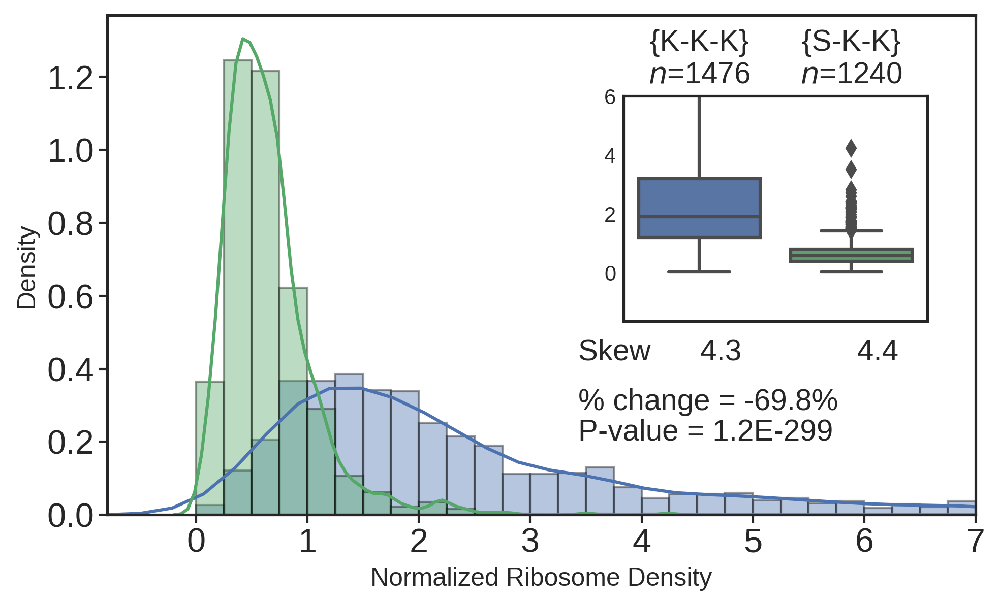

In [8]:
Input_file_path_E_site = open(path+'A_site_profile_file/matrix_file/distribution_of_normalized_ribosome_densities/E-site_triplet_all.tab')
Input_file_path = path+'A_site_profile_file/esite_asite_matrix_for_amino_acid/A-site_profiles_Pool_Translation_timesssAsite_psite_esite_times_coordinates.tab' # pool dataset file
next(Input_file_path_E_site)
out_path = path+'A_site_profile_file/matrix_file/distribution_of_normalized_ribosome_densities/'


# Generating Fig. S1b below for the column 'D' of matrix for the Williams dataset shown above
fig = plt.figure(figsize=(5 * 5, 20), dpi=300)
palette_colors = [(0.2980392156862745, 0.4470588235294118, 0.6901960784313725), (0.3333333333333333, 0.6588235294117647, 0.40784313725490196)]

sns.set_palette(palette_colors)
subplot_counter = 1

    
#line1 = line.strip("\n").split('\t')
#print(line1)
A_site = 'K'
P_site =  'K'
E_site =  'K'
alt_E_site =  'S'
#sys.exit()
ax = plt.subplot(4, 3, subplot_counter)
if subplot_counter in [1]:
    ylabel = True
else:
    ylabel = False
if subplot_counter in [1]:
    xlabel = True
else:
    xlabel = False

ax = list_calculate(Input_file_path, ax, Asite = A_site, Psite = P_site, Esite = E_site, alt_Esite = alt_E_site, alt_Psite = '', xlabel=xlabel, ylabel=ylabel)
subplot_counter += 1
fig.savefig(out_path+'E-site_speed_change_column_KKK_to_SKK.png', dpi=600, bbox_inches = 'tight')
plt.show()


## Identify E-site and P-site effect triplets from robust triplets

In [31]:
# Calculate oddds between two triplet
def odds_speed_change_aa(densities_list1, densities_list2):
    list_diff = []
    for density1 in densities_list1:
        for density2 in densities_list2:
            diff = density2-density1
            list_diff.append(diff)
    median_diff = np.median(densities_list2) - np.median(densities_list1)
    # If the median of second list is higher, then  Density_list1 is fast and Density_list2 is slow and hence we calculate the odds of slowdown upon mutation from 1-->2
    if median_diff > 0:
        try:
            odds = float(sum(i > 0 for i in list_diff))/float(sum(i < 0 for i in list_diff))
        except ZeroDivisionError:
            odds = -1
    # If the median of second list is lower, then  Density_list1 is slow and Density_list2 is fast and hence we calculate the odds of speedup upon mutation from 1-->2
    else:
        try:
            odds = float(sum(i < 0 for i in list_diff))/float(sum(i > 0 for i in list_diff))
        except ZeroDivisionError:
            odds = -1

    return odds

def list_calculate(input_file, Asite, Psite, Esite, alt_Esite, alt_Psite):
    Input_file = pd.read_csv(input_file,sep='\t')
    
    if Asite == 'ALL':
        Asite1 = Input_file.Asite != '*'
        
    else:
        Asite1 = Input_file.Asite == Asite
    psite1 = Input_file.psite == Psite
    esite1 = Input_file.esite == Esite
    if alt_Psite == '':
        alt_esite1 = Input_file.esite == alt_Esite    
        list1 = psite1 &  esite1 &  Asite1
        list2 = psite1 &  alt_esite1 &  Asite1
    
    if alt_Esite == '':
        alt_psite1 = Input_file.psite == alt_Psite
        #print(Input_file[alt_psite1])
        list1 = psite1 &  esite1 &  Asite1
        list2 = alt_psite1 &  esite1 &  Asite1
    
    list1_dataframe = Input_file[list1].Translation_time_Asite_codon
    list1_list = list1_dataframe.values.tolist()
    
    list2_dataframe = Input_file[list2].Translation_time_Asite_codon
    list2_list = list2_dataframe.values.tolist()
    
    u, p = stats.mannwhitneyu(list2_list, list1_list)
    perc_change = ((np.median(list2_list) - np.median(list1_list)) / np.median(list1_list)) * 100
    
    #print(perc_change)
    if p > 0.01:
        pval = round(p, 4)
    else:
        pval = '%.1E' % p
    #print(p)    
    
    odds = odds_speed_change_aa(list1_list, list2_list)
    #print(odds)
    return perc_change, p, odds

def robust_triplet_list(ape_file):
    triplet_list = []
    ape_file = open(ape_file)
    next(ape_file)
    for line in ape_file:
        line1 = line.split('\t')
        triplet_list.append(line1[0]+line1[1]+line1[2])
    #print(len(triplet_list))
    
    return triplet_list

# Calculate Eand P-site effect triplet
def e_p_site_effect(ape_file, Input_file_path, site_effect = ''):
    triplet_list = robust_triplet_list(ape_file)
    ape_file = pd.read_csv(ape_file, sep='\t')
    slow_triplet_list = []
    fast_triplet_list = []
    slow_effect_list = {}
    fast_effect_list = {}
    for aa, aa_psite, aa_esite in triplet_list:
        triplet = aa+aa_psite+aa_esite
        #esite_effect_list[triplet] = []
        if site_effect == 'E-site':
            ape_file_data = ape_file[(ape_file.Asite == aa) & (ape_file.Psite == aa_psite) & (ape_file.Esite == aa_esite)]# & (ape_file.Cooprative_effect != 'Non_Robust')]#[column]
            if 'Non_Robust' in ape_file_data['Cooprative_effect'].values.tolist():
                continue
            if not ape_file_data['Cooprative_effect'].values.tolist():
                continue
            if 'Slow_Down' in ape_file_data['Speed'].values.tolist():
                slow_effect_list[triplet] = []
                if aa+aa_psite in slow_triplet_list:
                    continue
                slow_triplet_list.append(aa+aa_psite)
            if 'Speed_up' in ape_file_data['Speed'].values.tolist():
                fast_effect_list[triplet] = []
                if aa+aa_psite in fast_triplet_list:
                    continue
                fast_triplet_list.append(aa+aa_psite)
            for alt_aa_esite in AMINO_ACIDS:
                if '*' in aa_esite:
                    continue
                alt_triplet = aa+aa_psite+alt_aa_esite
                alt_ape_file_data = ape_file[(ape_file.Asite == aa) & (ape_file.Psite == aa_psite) & (ape_file.Esite == alt_aa_esite)]
                if 'Non_Robust' in alt_ape_file_data['Cooprative_effect'].values.tolist():
                    continue
                if not alt_ape_file_data['Cooprative_effect'].values.tolist():
                    continue
                if ape_file_data['Speed'].values.tolist() != alt_ape_file_data['Speed'].values.tolist():
                    if 'Slow_Down' in ape_file_data['Speed'].values.tolist():
                        slow_effect_list[triplet].append(alt_triplet)
                    if 'Speed_up' in ape_file_data['Speed'].values.tolist():
                        fast_effect_list[triplet].append(alt_triplet)
        if site_effect == 'P-site':
            ape_file_data = ape_file[(ape_file.Asite == aa) & (ape_file.Psite == aa_psite) & (ape_file.Esite == aa_esite)]# & (ape_file.Cooprative_effect != 'Non_Robust')]#[column]
            if 'Non_Robust' in ape_file_data['Cooprative_effect'].values.tolist():
                continue
            if not ape_file_data['Cooprative_effect'].values.tolist():
                continue
            if 'Slow_Down' in ape_file_data['Speed'].values.tolist():
                slow_effect_list[triplet] = []
                if aa+aa_esite in slow_triplet_list:
                    continue
                slow_triplet_list.append(aa+aa_esite)
            if 'Speed_up' in ape_file_data['Speed'].values.tolist():
                fast_effect_list[triplet] = []
                if aa+aa_esite in fast_triplet_list:
                    continue
                fast_triplet_list.append(aa+aa_esite)
            for alt_aa_psite in AMINO_ACIDS:
                if '*' in aa_psite:
                    continue
                alt_triplet = aa+alt_aa_psite+aa_esite
                alt_ape_file_data = ape_file[(ape_file.Asite == aa) & (ape_file.Psite == alt_aa_psite) & (ape_file.Esite == aa_esite)]
                if 'Non_Robust' in alt_ape_file_data['Cooprative_effect'].values.tolist():
                    continue
                if not alt_ape_file_data['Cooprative_effect'].values.tolist():
                    continue
                if ape_file_data['Speed'].values.tolist() != alt_ape_file_data['Speed'].values.tolist():
                    if 'Slow_Down' in ape_file_data['Speed'].values.tolist():
                        slow_effect_list[triplet].append(alt_triplet)
                    if 'Speed_up' in ape_file_data['Speed'].values.tolist():
                        fast_effect_list[triplet].append(alt_triplet)

    empty_keys = [k for k,v in slow_effect_list.items() if not v]
    for k in empty_keys:
        del slow_effect_list[k]
    empty_keys = [k for k,v in fast_effect_list.items() if not v]
    for k in empty_keys:
        del fast_effect_list[k]
    
    if site_effect == 'E-site':
        esite_effect_file = open(path+'A_site_profile_file/matrix_file/distribution_of_normalized_ribosome_densities/new_esite_effect_triplet_list.tab', 'w')
        esite_effect_file.write('Asite\tPsite\tEsite (Fast)\tEsite Alternative (Slow)\tPercentage_change\tPvalue\todds\n')
        for key, value in fast_effect_list.items():
            for kval in value:
                prc_chng, pval, odds = list_calculate(Input_file_path, Asite = key[0], Psite = key[1], Esite = key[2], alt_Esite = kval[2], alt_Psite = '')
                esite_effect_file.write(key[0]+'\t'+key[1]+'\t'+key[2]+'\t'+kval[2]+'\t'+str(prc_chng)+'\t'+str(pval)+'\t'+str(odds)+'\n')
        esite_effect_file.close()
        esite_effect_file = pd.read_csv(path+'A_site_profile_file/matrix_file/distribution_of_normalized_ribosome_densities/new_esite_effect_triplet_list.tab', sep='\t')
        new_best_file = path+'A_site_profile_file/matrix_file/distribution_of_normalized_ribosome_densities/new_best_esite_effect_triplet_list.tab'
        count = 0
        for aa in AMINO_ACIDS:
            aa_list = esite_effect_file.Asite == aa
            sorted_aa_list = esite_effect_file[aa_list].sort_values(by=['odds'], ascending=False)
            if count == 0:
                sorted_aa_list.head(1).to_csv(new_best_file, sep ='\t', mode = 'w', header=True, index=False)
            else:
                sorted_aa_list.head(1).to_csv(new_best_file, sep ='\t', mode = 'a', header=False, index=False)
            count+=1
                
    if site_effect == 'P-site':
        psite_effect_file = open(path+'A_site_profile_file/matrix_file/distribution_of_normalized_ribosome_densities/new_psite_effect_triplet_list.tab', 'w')
        psite_effect_file.write('Asite\tPsite (Fast)\tPsite Alternative (Slow)\tEsite\tPercentage_change\tPvalue\todds\n')
        Input_file_path = path+'A_site_profile_file/esite_asite_matrix_for_amino_acid/A-site_profiles_Pool_Translation_timesssAsite_psite_esite_times_coordinates.tab'

        for key, value in fast_effect_list.items():
            for kval in value:
                prc_chng, pval, odds = list_calculate(Input_file_path, Asite = key[0], Psite = key[1], Esite = key[2], alt_Esite = '', alt_Psite = kval[1])
                psite_effect_file.write(key[0]+'\t'+key[1]+'\t'+kval[1]+'\t'+key[2]+'\t'+str(prc_chng)+'\t'+str(pval)+'\t'+str(odds)+'\n')
        psite_effect_file.close()
        psite_effect_file = pd.read_csv(path+'A_site_profile_file/matrix_file/distribution_of_normalized_ribosome_densities/new_psite_effect_triplet_list.tab', sep='\t')
        new_best_file = path+'A_site_profile_file/matrix_file/distribution_of_normalized_ribosome_densities/new_best_psite_effect_triplet_list.tab'
        count = 0
        for aa in AMINO_ACIDS:
            aa_list = psite_effect_file.Asite == aa
            sorted_aa_list = psite_effect_file[aa_list].sort_values(by=['odds'], ascending=False)
            if count == 0:
                sorted_aa_list.head(1).to_csv(new_best_file, sep ='\t', mode = 'w', header=True, index=False)
            else:
                sorted_aa_list.head(1).to_csv(new_best_file, sep ='\t', mode = 'a', header=False, index=False)
            count+=1
    
    return
print('Done')

Done


In [32]:
ape_file = path+'A_site_profile_file/robust_amino_acid_matrix/robust_file_with_percentage_change/Robust_aminoacid_pairs_Not_controlled_for_any_factors_amino_acid_matrix_pvalue_1_delta1_direction_7_cooperativity_effect_direction_threshold_4_datasets_with_percentage_change.tab'
Input_file_path = path+'A_site_profile_file/esite_asite_matrix_for_amino_acid/A-site_profiles_Pool_Translation_timesssAsite_psite_esite_times_coordinates.tab'
e_p_site_effect(ape_file, Input_file_path, site_effect = 'P-site')
print('Done P-site calculation')
e_p_site_effect(ape_file, Input_file_path, site_effect = 'E-site')
print('Done E-site calculation')

Done P-site calculation
Done E-site calculation


## Plotting the normalized ribosome density distributions between Esite and Psite selected triplets
#### We found a total of 151 triplet pair with P-site effect and 88 triplet pairs with E-site effect
#### Here we have slected the best odds triplet pair for each amino acid at A-site from P-site and E-site effect triplets and plotting the normalized ribosome density distributions between them

In [33]:
# Calculate oddds between two triplet
def odds_speed_change_aa(densities_list1, densities_list2):
    list_diff = []
    for density1 in densities_list1:
        for density2 in densities_list2:
            diff = density2-density1
            list_diff.append(diff)
    median_diff = np.median(densities_list2) - np.median(densities_list1)
    # If the median of second list is higher, then  Density_list1 is fast and Density_list2 is slow and hence we calculate the odds of slowdown upon mutation from 1-->2
    if median_diff > 0:
        try:
            odds = float(sum(i > 0 for i in list_diff))/float(sum(i < 0 for i in list_diff))
        except ZeroDivisionError:
            odds = -1
    # If the median of second list is lower, then  Density_list1 is slow and Density_list2 is fast and hence we calculate the odds of speedup upon mutation from 1-->2
    else:
        try:
            odds = float(sum(i < 0 for i in list_diff))/float(sum(i > 0 for i in list_diff))
        except ZeroDivisionError:
            odds = -1

    return odds


# Plotting the normalized ribosome density distributions for two pairs of amino acids
def plot_trans_distribution(ax, pval, perc_change, list1_list, list2_list, lable_name1, lable_name2, xlabel='', ylabel=''):
    palette_colors = [(0.2980392156862745, 0.4470588235294118, 0.6901960784313725), (0.3333333333333333, 0.6588235294117647, 0.40784313725490196)]
    plt.style.use('seaborn-white')
    sns.set_palette(palette_colors)
    
    pair_rdensity_list = list1_list
    
    control_pair_rdensity_list =list2_list

    odds_value = odds_speed_change_aa(list1_list, list2_list)
    N = max(max(set(pair_rdensity_list)), max(set(sorted(control_pair_rdensity_list)[:-10])))
    skew = stats.skew(np.asarray(pair_rdensity_list))
    skew_control = stats.skew(np.asarray(control_pair_rdensity_list))
    binsize = np.arange(0, N + 1, 0.25)  
    ax = sns.distplot(pair_rdensity_list, ax=ax, kde=True, norm_hist=True, bins=binsize, hist_kws=dict(edgecolor="black", linewidth=1))
    ax = sns.distplot(control_pair_rdensity_list, ax=ax, kde=True, norm_hist=True, bins=binsize, hist_kws=dict(edgecolor="black", linewidth=1))
    ax.set_xlim(-0.8, 7)
    ax.legend(fontsize=16, loc='upper right')
    ax.tick_params(direction='out', axis='both', width=1, length=4, which='major', labelsize=16, pad=2)
    
    if xlabel:
        ax.set_xlabel('Normalized Ribosome Density', fontsize=12)
    else:
        ax.xaxis.label.set_visible(False)
    if ylabel:
        ax.set_ylabel('Density', fontsize=12)
    else:
        ax.yaxis.label.set_visible(False)
        
    ax.text(x=0.49 * ax.get_xlim()[1], y=0.31 * ax.get_ylim()[1], s='Skew     ' + str(round(skew, 1)) + '             ' + str(round(skew_control, 1)), fontsize=14)
    ax.text(x=0.60 * ax.get_xlim()[1], y=0.25 * ax.get_ylim()[1], s='% change = ' + str(round(perc_change, 1)) + '%', fontsize=14)
    ax.text(x=0.60 * ax.get_xlim()[1], y=0.18 * ax.get_ylim()[1], s='P-value = ' + str(pval), fontsize=14)
    ax.text(x=0.60 * ax.get_xlim()[1], y=0.11 * ax.get_ylim()[1], s='Odds = ' + str(round(odds_value, 2)), fontsize=14)
    
       
    pair_rdensity_list_annot = [lable_name1 for x in range(0, len(pair_rdensity_list))]
    control_pair_rdensity_list_annot = [lable_name2 for x in range(0, len(control_pair_rdensity_list))]

    
    merged_list = list(pair_rdensity_list) + list(control_pair_rdensity_list)
    merged_annot = pair_rdensity_list_annot + control_pair_rdensity_list_annot
    
    df = pd.DataFrame({'Norm_ribo_density': pd.Series(merged_list), 'Ltype': pd.Series(merged_annot)})
    
    inset_axes2 = inset_axes(ax,
                             width="100%",  # width = 30% of parent_bbox
                             height="100%",  # height : 1 inch
                             loc="upper left", borderpad=1, bbox_to_anchor=(0.57, 1-0.57, 0.35, 0.45), bbox_transform=ax.transAxes) #(0.57, 1-0.54, 0.35, 0.45)
    inset_axes2 = sns.boxplot(y='Norm_ribo_density', x='Ltype',  data=df, ax=inset_axes2)  # orient='h',
    inset_axes2.set_ylim(top=6)
    inset_axes2.set_xticklabels([lable_name1+'\n$n$=' + str(len(pair_rdensity_list)), lable_name2+'\n$n$=' + str(len(control_pair_rdensity_list))], fontsize=14)
    inset_axes2.yaxis.label.set_visible(False)
    inset_axes2.xaxis.label.set_visible(False)
    inset_axes2.xaxis.tick_top()    
    
    return ax

def list_calculate(input_file, ax, Asite, Psite, Esite, alt_Esite, alt_Psite, xlabel='', ylabel=''):
    Input_file = pd.read_csv(input_file,sep='\t')
    
    if Asite == 'ALL':
        Asite1 = Input_file.Asite != '*'
        
    else:
        Asite1 = Input_file.Asite == Asite
    psite1 = Input_file.psite == Psite
    esite1 = Input_file.esite == Esite
    if alt_Psite == '':
        alt_esite1 = Input_file.esite == alt_Esite    
        list1 = psite1 &  esite1 &  Asite1
        list2 = psite1 &  alt_esite1 &  Asite1
    
    if alt_Esite == '':
        alt_psite1 = Input_file.psite == alt_Psite
        #print(Input_file[alt_psite1])
        list1 = psite1 &  esite1 &  Asite1
        list2 = alt_psite1 &  esite1 &  Asite1
    
    list1_dataframe = Input_file[list1].Translation_time_Asite_codon
    list1_list = list1_dataframe.values.tolist()
    
    list2_dataframe = Input_file[list2].Translation_time_Asite_codon
    list2_list = list2_dataframe.values.tolist()
    
    u, p = stats.mannwhitneyu(list2_list, list1_list)
    perc_change = ((np.median(list2_list) - np.median(list1_list)) / np.median(list1_list)) * 100
    
    
    if p > 0.01:
        pval = round(p, 4)
    else:
        pval = '%.1E' % p
    if alt_Psite == '':
        lable_name1 = '{'+ Esite + '-' + Psite + '-' + Asite + '}'
        lable_name2 = '{' + alt_Esite + '-' + Psite + '-' + Asite + '}'
        ax = plot_trans_distribution(ax, pval, perc_change, list1_list, list2_list, lable_name1, lable_name2, xlabel=xlabel, ylabel=ylabel)
    if alt_Esite == '':
        lable_name1 = '{'+ Esite + '-' + Psite + '-' + Asite + '}'
        lable_name2 = '{' + Esite + '-' + alt_Psite + '-' + Asite + '}'
        ax = plot_trans_distribution(ax, pval, perc_change, list1_list, list2_list, lable_name1, lable_name2, xlabel=xlabel, ylabel=ylabel)
    
    return ax

print('Done')

Done


###### Esite effect triplets

In [34]:
Input_file_path_E_site = open(path+'A_site_profile_file/matrix_file/distribution_of_normalized_ribosome_densities/new_best_esite_effect_triplet_list.tab')
Input_file_path = path+'A_site_profile_file/esite_asite_matrix_for_amino_acid/A-site_profiles_Pool_Translation_timesssAsite_psite_esite_times_coordinates.tab' # pool dataset file
next(Input_file_path_E_site)
num_lines = sum(1 for line in Input_file_path_E_site)
Input_file_path_E_site.close()
Input_file_path_E_site = open(path+'A_site_profile_file/matrix_file/distribution_of_normalized_ribosome_densities/new_best_esite_effect_triplet_list.tab')
next(Input_file_path_E_site)
out_path = path+'A_site_profile_file/matrix_file/distribution_of_normalized_ribosome_densities/'


# Generating Fig. S1b below for the column 'D' of matrix for the Williams dataset shown above
fig = plt.figure(figsize=(5 * 5, 35))
palette_colors = [(0.2980392156862745, 0.4470588235294118, 0.6901960784313725), (0.3333333333333333, 0.6588235294117647, 0.40784313725490196)]

sns.set_palette(palette_colors)
subplot_counter = 1
for line in sorted(Input_file_path_E_site):
    #print(line)
    line1 = line.strip("\n").split('\t')
    A_site = line1[0]
    P_site =  line1[1]
    E_site =  line1[2]
    alt_E_site =  line1[3]
    
    ax = plt.subplot(7, 3, subplot_counter)
    if subplot_counter in [1, 4, 7, 10, 13]:
        ylabel = True
    else:
        ylabel = False
    if subplot_counter in [num_lines-2, num_lines-1, num_lines]:
        xlabel = True
    else:
        xlabel = False

    ax = list_calculate(Input_file_path, ax, Asite = A_site, Psite = P_site, Esite = E_site, alt_Esite = alt_E_site, alt_Psite = '', xlabel=xlabel, ylabel=ylabel)
    subplot_counter += 1
fig.savefig(out_path+'new_best_E-site_speed_change_column_pick.png', dpi=600, bbox_inches = 'tight')
plt.show()


No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


###### Psite effect triplets

In [35]:
Input_file_path_P_site = open(path+'A_site_profile_file/matrix_file/distribution_of_normalized_ribosome_densities/new_best_psite_effect_triplet_list.tab')
Input_file_path = path+'A_site_profile_file/esite_asite_matrix_for_amino_acid/A-site_profiles_Pool_Translation_timesssAsite_psite_esite_times_coordinates.tab' # pool dataset file
next(Input_file_path_P_site)
num_lines = sum(1 for line in Input_file_path_P_site)
Input_file_path_P_site.close()
Input_file_path_P_site = open(path+'A_site_profile_file/matrix_file/distribution_of_normalized_ribosome_densities/new_best_psite_effect_triplet_list.tab')
next(Input_file_path_P_site)
out_path = path+'A_site_profile_file/matrix_file/distribution_of_normalized_ribosome_densities/'


# Generating Fig. S1b below for the column 'D' of matrix for the Williams dataset shown above
fig = plt.figure(figsize=(5 * 5, 35))
palette_colors = [(0.2980392156862745, 0.4470588235294118, 0.6901960784313725), (0.3333333333333333, 0.6588235294117647, 0.40784313725490196)]

sns.set_palette(palette_colors)
subplot_counter = 1
for line in sorted(Input_file_path_P_site):
    #print(line)
    line1 = line.strip("\n").split('\t')
    A_site = line1[0]
    P_site =  line1[1]
    alt_P_site =  line1[2]
    E_site =  line1[3]
    
    ax = plt.subplot(7, 3, subplot_counter)
    if subplot_counter in [1, 4, 7, 10, 13, 16, 19]:
        ylabel = True
    else:
        ylabel = False
    if subplot_counter in [num_lines-2, num_lines-1, num_lines]:
        xlabel = True
    else:
        xlabel = False

    ax = list_calculate(Input_file_path, ax, Asite = A_site, Psite = P_site, Esite = E_site, alt_Esite = '', alt_Psite = alt_P_site, xlabel=xlabel, ylabel=ylabel)
    subplot_counter += 1
fig.savefig(out_path+'new_best_P-site_speed_change_column_pick.png', dpi=600, bbox_inches = 'tight')
plt.show()

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


## Switching the P and E site amino acid position resulting get opposite speed changes. We have selected the triplet pairs from robust triplet for this analysis. 
#### In total we found total 14 triplet pairs and and plotting the normalized ribosome density distributions between them

In [11]:
# Calculate oddds between two triplet
def odds_speed_change_aa(densities_list1, densities_list2):
    list_diff = []
    for density1 in densities_list1:
        for density2 in densities_list2:
            diff = density2-density1
            list_diff.append(diff)
    median_diff = np.median(densities_list2) - np.median(densities_list1)
    # If the median of second list is higher, then  Density_list1 is fast and Density_list2 is slow and hence we calculate the odds of slowdown upon mutation from 1-->2
    if median_diff > 0:
        try:
            odds = float(sum(i > 0 for i in list_diff))/float(sum(i < 0 for i in list_diff))
        except ZeroDivisionError:
            odds = -1
    # If the median of second list is lower, then  Density_list1 is slow and Density_list2 is fast and hence we calculate the odds of speedup upon mutation from 1-->2
    else:
        try:
            odds = float(sum(i < 0 for i in list_diff))/float(sum(i > 0 for i in list_diff))
        except ZeroDivisionError:
            odds = -1

    return odds

# Calculate percentage change p-value and odds
def list_calculate(input_file, Asite, Psite, Esite):
    Input_file = pd.read_csv(input_file,sep='\t')
    
    # for original triplet
    Asite1 = Input_file.Asite == Asite
    psite1 = Input_file.psite == Psite
    esite1 = Input_file.esite == Esite
    list1 = Asite1 &  psite1 &  esite1
    
    list1_dataframe = Input_file[list1].Translation_time_Asite_codon
    list1_list = list1_dataframe.values.tolist()
    
    # after switching P and E site
    Asite1 = Input_file.Asite == Asite
    psite1 = Input_file.psite == Esite
    esite1 = Input_file.esite == Psite
    list2 = Asite1 &  psite1 &  esite1
       
    list2_dataframe = Input_file[list2].Translation_time_Asite_codon
    list2_list = list2_dataframe.values.tolist()
    
    u, p = stats.mannwhitneyu(list2_list, list1_list)
    perc_change = ((np.median(list2_list) - np.median(list1_list)) / np.median(list1_list)) * 100
    
    #print(perc_change)
    if p > 0.01:
        pval = round(p, 4)
    else:
        pval = '%.1E' % p    
    odds = odds_speed_change_aa(list1_list, list2_list)
    return perc_change, p, odds

# Robust triplet selected
def robust_triplet_list(ape_file):
    triplet_list = []
    triplet_speed_dic = {}
    ape_file = open(ape_file)
    next(ape_file)
    for line in ape_file:
        line1 = line.split('\t')
        if line1[4]== 'Non_Robust':
            continue
        triplet_list.append(line1[0]+line1[1]+line1[2])
        triplet_speed_dic[line1[0]+line1[1]+line1[2]] = []
        triplet_speed_dic[line1[0]+line1[1]+line1[2]].append(line1[3])
    return triplet_list, triplet_speed_dic

# Calculate switching E and P-site effect triplet
def speed_change_occure_by_switching_E_and_P_site_amino_acid(ape_file, Input_file_path, site_effect = ''):
    triplet_list, triplet_speed_dic = robust_triplet_list(ape_file)
    speed_change_triplet = []
    switching_site_triplet = open(path+'A_site_profile_file/matrix_file/distribution_of_normalized_ribosome_densities/triplet_change_speed_by_changing_P_and_E_site_amino_acid.tab', 'w')
    switching_site_triplet.write('Asite\tPsite\tEsite\tPsite_Alternative\tEsite_Alternative\torg_triplet_speed\tmutated_triplet_speed\tPercentage_change\tPvalue\todds\n')
    cal_triplet_list = []
    for triplet in triplet_list:
        org_triplet = triplet[0]+ triplet[1]+triplet[2]
        if triplet_speed_dic[org_triplet][0] != 'Speed_up':
            continue
        alt_triplet = triplet[0]+ triplet[2]+triplet[1]
        if triplet[1] == triplet[2]:
            continue
        if alt_triplet not in triplet_list:
            continue
        if triplet_speed_dic[org_triplet] == triplet_speed_dic[alt_triplet]:
            continue
        if alt_triplet in cal_triplet_list:
            continue
        
        cal_triplet_list.append(org_triplet)
        prc_chng, pval, odds = list_calculate(Input_file_path, Asite = triplet[0], Psite = triplet[1], Esite = triplet[2])#, alt_Esite = kval[2], alt_Psite = '')
        print(org_triplet +'\t'+triplet_speed_dic[org_triplet][0]+'\t'+alt_triplet+'\t'+triplet_speed_dic[alt_triplet][0]+'\t'+str(prc_chng)+'\t'+str(pval)+'\t'+str(odds))
        switching_site_triplet.write(triplet[0]+'\t'+ triplet[1]+'\t'+triplet[2]+'\t'+ triplet[2]+'\t'+triplet[1]+'\t'+triplet_speed_dic[org_triplet][0]+'\t'+triplet_speed_dic[alt_triplet][0]+'\t'+str(prc_chng)+'\t'+str(pval)+'\t'+str(odds)+'\n')
      
    return

In [12]:
ape_file = path+'A_site_profile_file/robust_amino_acid_matrix/robust_file_with_percentage_change/Robust_aminoacid_pairs_Not_controlled_for_any_factors_amino_acid_matrix_pvalue_1_delta1_direction_7_cooperativity_effect_direction_threshold_4_datasets_with_percentage_change.tab'
Input_file_path = path+'A_site_profile_file/esite_asite_matrix_for_amino_acid/A-site_profiles_Pool_Translation_timesssAsite_psite_esite_times_coordinates.tab'

speed_change_occure_by_switching_E_and_P_site_amino_acid(ape_file, Input_file_path)
print('Done')

KKE	Speed_up	KEK	Slow_Down	51.7646751166972	4.2265736287486905e-64	2.551034613907995
KKS	Speed_up	KSK	Slow_Down	68.77933269810505	1.993129848318996e-92	2.9853034209363467
KLD	Speed_up	KDL	Slow_Down	108.3868393499202	4.983998980185476e-119	4.317559909075706
KKN	Speed_up	KNK	Slow_Down	65.19653193481922	6.609503293465276e-58	2.687641022513707
KKT	Speed_up	KTK	Slow_Down	46.07318998048278	4.2600675511982064e-36	2.229502973661852
KKD	Speed_up	KDK	Slow_Down	107.80996208594817	2.9253535859807112e-95	4.726005781587285
GAG	Speed_up	GGA	Slow_Down	93.30129500253948	4.0172149966040326e-23	2.2496972384737406
TSP	Speed_up	TPS	Slow_Down	119.61095541957354	1.226178474471954e-72	4.068867262844117
KRS	Speed_up	KSR	Slow_Down	60.18794568018685	6.529726959476665e-29	2.141614886678888
GAK	Speed_up	GKA	Slow_Down	60.740129158389486	6.970442809653413e-22	2.497332317073171
TTP	Speed_up	TPT	Slow_Down	94.44919088411322	2.1064989654735765e-39	3.0952278912293485
PSP	Speed_up	PPS	Slow_Down	159.95238734818633	3.307828

## Plotting the normalized ribosome density distributions between selected triplet

In [13]:
# Calculate oddds between two triplet
def odds_speed_change_aa(densities_list1, densities_list2):
    list_diff = []
    for density1 in densities_list1:
        for density2 in densities_list2:
            diff = density2-density1
            list_diff.append(diff)
    median_diff = np.median(densities_list2) - np.median(densities_list1)
    # If the median of second list is higher, then  Density_list1 is fast and Density_list2 is slow and hence we calculate the odds of slowdown upon mutation from 1-->2
    if median_diff > 0:
        try:
            odds = float(sum(i > 0 for i in list_diff))/float(sum(i < 0 for i in list_diff))
        except ZeroDivisionError:
            odds = -1
    # If the median of second list is lower, then  Density_list1 is slow and Density_list2 is fast and hence we calculate the odds of speedup upon mutation from 1-->2
    else:
        try:
            odds = float(sum(i < 0 for i in list_diff))/float(sum(i > 0 for i in list_diff))
        except ZeroDivisionError:
            odds = -1

    return odds


# Plotting the normalized ribosome density distributions for two pairs of amino acids
def plot_trans_distribution(ax, pval, perc_change, list1_list, list2_list, lable_name1, lable_name2, xlabel='', ylabel=''):
    palette_colors = [(0.2980392156862745, 0.4470588235294118, 0.6901960784313725), (0.3333333333333333, 0.6588235294117647, 0.40784313725490196)]
    plt.style.use('seaborn-white')
    sns.set_palette(palette_colors)
    
    pair_rdensity_list = list1_list
    
    control_pair_rdensity_list =list2_list

    odds_value = odds_speed_change_aa(list1_list, list2_list)
    #print('odds_value1', odds_value1)
    N = max(max(set(pair_rdensity_list)), max(set(sorted(control_pair_rdensity_list)[:-10])))
    skew = stats.skew(np.asarray(pair_rdensity_list))
    skew_control = stats.skew(np.asarray(control_pair_rdensity_list))
    binsize = np.arange(0, N + 1, 0.25)  
    ax = sns.distplot(pair_rdensity_list, ax=ax, kde=True, norm_hist=True, bins=binsize, hist_kws=dict(edgecolor="black", linewidth=1))
    ax = sns.distplot(control_pair_rdensity_list, ax=ax, kde=True, norm_hist=True, bins=binsize, hist_kws=dict(edgecolor="black", linewidth=1))
    ax.set_xlim(-0.8, 7)
    ax.legend(fontsize=16, loc='upper right')
    ax.tick_params(direction='out', axis='both', width=1, length=4, which='major', labelsize=16, pad=2)
    
    if xlabel:
        ax.set_xlabel('Normalized Ribosome Density', fontsize=12)
    else:
        ax.xaxis.label.set_visible(False)
    if ylabel:
        ax.set_ylabel('Density', fontsize=12)
    else:
        ax.yaxis.label.set_visible(False)
        
    ax.text(x=0.49 * ax.get_xlim()[1], y=0.31 * ax.get_ylim()[1], s='Skew     ' + str(round(skew, 1)) + '             ' + str(round(skew_control, 1)), fontsize=14)
    ax.text(x=0.60 * ax.get_xlim()[1], y=0.25 * ax.get_ylim()[1], s='% change = ' + str(round(perc_change, 1)) + '%', fontsize=14)
    ax.text(x=0.60 * ax.get_xlim()[1], y=0.18 * ax.get_ylim()[1], s='P-value = ' + str(pval), fontsize=14)
    ax.text(x=0.60 * ax.get_xlim()[1], y=0.11 * ax.get_ylim()[1], s='Odds = ' + str(round(odds_value, 2)), fontsize=14)
    
       
    pair_rdensity_list_annot = [lable_name1 for x in range(0, len(pair_rdensity_list))]
    control_pair_rdensity_list_annot = [lable_name2 for x in range(0, len(control_pair_rdensity_list))]

    
    merged_list = list(pair_rdensity_list) + list(control_pair_rdensity_list)
    merged_annot = pair_rdensity_list_annot + control_pair_rdensity_list_annot
    
    df = pd.DataFrame({'Norm_ribo_density': pd.Series(merged_list), 'Ltype': pd.Series(merged_annot)})
    
    inset_axes2 = inset_axes(ax,
                             width="100%",  # width = 30% of parent_bbox
                             height="100%",  # height : 1 inch
                             loc="upper left", borderpad=1, bbox_to_anchor=(0.57, 1-0.57, 0.35, 0.45), bbox_transform=ax.transAxes) #(0.57, 1-0.54, 0.35, 0.45)
    inset_axes2 = sns.boxplot(y='Norm_ribo_density', x='Ltype',  data=df, ax=inset_axes2)  # orient='h',
    inset_axes2.set_ylim(top=6)
    inset_axes2.set_xticklabels([lable_name1+'\n$n$=' + str(len(pair_rdensity_list)), lable_name2+'\n$n$=' + str(len(control_pair_rdensity_list))], fontsize=14)
    inset_axes2.yaxis.label.set_visible(False)
    inset_axes2.xaxis.label.set_visible(False)
    inset_axes2.xaxis.tick_top()    
    
    return ax

def list_calculate(input_file, ax, Asite, Psite, Esite, alt_Esite, alt_Psite, xlabel='', ylabel=''):
    Input_file = pd.read_csv(input_file,sep='\t')
    
    Asite1 = Input_file.Asite == Asite
    psite1 = Input_file.psite == Psite
    esite1 = Input_file.esite == Esite
    list1 = psite1 &  esite1 &  Asite1
    list1_dataframe = Input_file[list1].Translation_time_Asite_codon
    list1_list = list1_dataframe.values.tolist()
    
    Asite1 = Input_file.Asite == Asite
    psite1 = Input_file.psite == alt_Psite
    esite1 = Input_file.esite == alt_Esite
    list2 = psite1 &  esite1 &  Asite1
    list2_dataframe = Input_file[list2].Translation_time_Asite_codon
    list2_list = list2_dataframe.values.tolist()

    u, p = stats.mannwhitneyu(list2_list, list1_list)
    perc_change = ((np.median(list2_list) - np.median(list1_list)) / np.median(list1_list)) * 100
    
    
    if p > 0.01:
        pval = round(p, 4)
    else:
        pval = '%.1E' % p
    lable_name1 = '{'+ Esite + '-' + Psite + '-' + Asite + '}'
    lable_name2 = '{' + alt_Esite + '-' + alt_Psite + '-' + Asite + '}'
    ax = plot_trans_distribution(ax, pval, perc_change, list1_list, list2_list, lable_name1, lable_name2, xlabel=xlabel, ylabel=ylabel)
    
    return ax

print('Done')

Done


No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


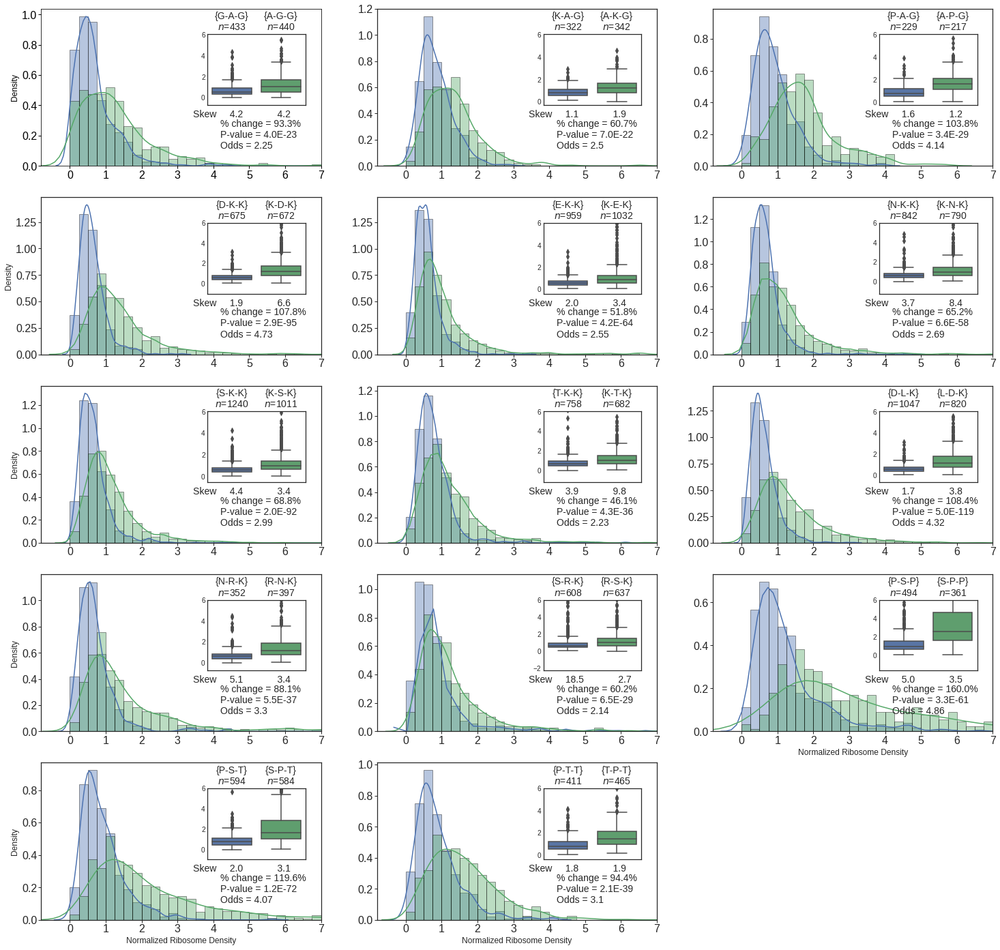

In [14]:
Input_file = open(path+'A_site_profile_file/matrix_file/distribution_of_normalized_ribosome_densities/triplet_change_speed_by_changing_P_and_E_site_amino_acid.tab')
Input_file_path = path+'A_site_profile_file/esite_asite_matrix_for_amino_acid/A-site_profiles_Pool_Translation_timesssAsite_psite_esite_times_coordinates.tab' # pool dataset file
next(Input_file)
num_lines = sum(1 for line in Input_file)
Input_file.close()
Input_file = open(path+'A_site_profile_file/matrix_file/distribution_of_normalized_ribosome_densities/triplet_change_speed_by_changing_P_and_E_site_amino_acid.tab')
next(Input_file)
out_path = path+'A_site_profile_file/matrix_file/distribution_of_normalized_ribosome_densities/'


# Generating Fig. S1b below for the column 'D' of matrix for the Williams dataset shown above
fig = plt.figure(figsize=(5 * 5, 50))
palette_colors = [(0.2980392156862745, 0.4470588235294118, 0.6901960784313725), (0.3333333333333333, 0.6588235294117647, 0.40784313725490196)]

sns.set_palette(palette_colors)
subplot_counter = 1
for line in sorted(Input_file):
    line1 = line.strip("\n").split('\t')
    A_site = line1[0]
    P_site =  line1[1]
    E_site =  line1[2]
    alt_P_site =  line1[3]
    alt_E_site =  line1[4]
    
    ax = plt.subplot(10, 3, subplot_counter)
    if subplot_counter in [1, 4, 7, 10, 13]:
        ylabel = True
    else:
        ylabel = False
    if subplot_counter in [num_lines-2, num_lines-1, num_lines]:
        xlabel = True
    else:
        xlabel = False

    ax = list_calculate(Input_file_path, ax, Asite = A_site, Psite = P_site, Esite = E_site, alt_Esite = alt_E_site, alt_Psite = alt_P_site, xlabel=xlabel, ylabel=ylabel)
    subplot_counter += 1
fig.savefig(out_path+'amino_acid_at_E_and_P_site_change_speed_after_switching_position.png', dpi=600, bbox_inches = 'tight')
plt.show()


## Mutating at the E- and P-site amino acid is predicted to alter the translation elongation rate at the A-site
## Compare all 8000 amino acid triplet with each other in complete proteome and calculate odds, p-value, and percentage difference

1. Compare 8000 triplet with each other. First triplet compare with rest 7999 triplet then remove first triplet and compare second triplet with rest 7998 triple the remove second triplet and so on. 
2. Calculate odds, p-value and percentage diffrance for all combination.

### Calculate Fold enrichment of amino acid triplet relative to random chance and percentage change and plot figure between percentage change & Fold enrichment of amino acid triplet relative to random chance & odds vs Fold enrichment of amino acid triplet relative to random chance
##### Use percentage information for define speed
1. if percentage change > 0 == Slow down
2. if percentage change < 0 == Speed Up

### Calculate percentage change (New method)

##### " = alternative triplet

1.  Percentage Change= Median(p(X,Y,Z))- Median(p("X,Y,Z)) / Median(p(X,Y,Z)) + Median(p("X,Y,Z)) / 2 *100
2.  Percentage Change= Median(p(X,Y,Z)) - Median(p(X,"Y,Z)) / Median(p(X,Y,Z)) + Median(p(X,"Y,Z)) / 2 *100


#### 8000 triplet compare with 8000 triplet one by one and calculate p-value, percentage change and odds without duplicate triplet
#### If we have caluclate for CAA – CAD, so CAD – CAA should not be repeat

#### This process can take longer time between 3 to 10 hours depend on sever 

In [39]:
## Create total triplet list
def Total_triplets():
    pair_list = []
    for aa in AMINO_ACIDS:
        if aa == '*':
            continue
        for psite_aa in AMINO_ACIDS:            
            if psite_aa == '*':
                continue            
            for esite_aa in AMINO_ACIDS:                
                if esite_aa == '*':
                    continue
                pair_list.append(aa+psite_aa+esite_aa)

    return pair_list

## Create directory
def directory_create(outpath):
    try:
        os.makedirs(outpath)
    except OSError:
        print("Creation of the directory %s failed")
    else:
        print("Successfully created the directory %s ")
        
    return


## Ceate comabination of triplet wothout duplicate 
def combination_dic(out_path, compare_triplets_list):    
    triplet_compare_dic = {}
    triplet_compare_result_dic = {}
    compare_triplets_list1 = compare_triplets_list
    triplet_list = []
    
    for triplet in compare_triplets_list:
        triplet_list.append(triplet)
        triplet_compare_dic[triplet] = []
        triplet_compare_result_dic[triplet] = {}
        for triplet1 in compare_triplets_list1:
            if triplet == triplet1:
                continue
            triplet_compare_dic[triplet].append(triplet1)
            triplet_compare_result_dic[triplet][triplet1] = []
        compare_triplets_list1 = compare_triplets_list1[1:]
    pickle.dump(triplet_compare_dic, open(out_path + 'triplets_dic.p', 'wb'))
    pickle.dump(triplet_compare_result_dic, open(out_path + 'result_triplets_dic.p', 'wb'))
    
    return triplet_list



# Create command line for swarn
def command_line_for_swarn(out_path):
    file_list_swarn = [] 
    swarn_file = open(out_path+'command_line_for_swarn.txt','w')
    for asite_aa in AMINO_ACIDS:
            if asite_aa == '*':
                continue
            for psite_aa in AMINO_ACIDS:
                if psite_aa == '*':
                    continue
                for esite_aa in AMINO_ACIDS:
                    if esite_aa == '*':
                        continue

                    triplet = asite_aa+psite_aa+esite_aa
                    swarn_file = open(out_path+'command_line_for_swarn.txt','a')
                    swarn_file.write('source /storage/work/n/nks5512/conda_env/setup; python '+str(out_path)+'Compare_8000_triplets_with_8000_triplet_and_calculate_odds_pvalue_and_percentage_change.py '+str(triplet)+'\n')

    return swarn_file.name


def monitor_jobs(jobids):
    
    import time
    status = 'Queued'
    jobids = jobids.split(' ')
    for i in jobids:
        proc = subprocess.Popen('qstat ' + i, shell=True, stdout=subprocess.PIPE)
        output = proc.stdout.read()
        jobstat = output.decode('utf-8')
        jobstat = jobstat.split()[-2]
        if jobstat == 'R':
        status = 'Running'
        elif jobstat == 'Q':
        status = 'Queued'
        elif jobstat == 'C':
        status = 'Completed'
        elif jobstat == 'S':
        status = 'Suspended'

    return status


def create_pbs(out_path,swarn_file, number_processors_per_node,number_of_bundle,walltime,allocation,memory):    
    with open(out_path +"compare_8000_triplets.pbs", "w") as pfile:           
        pfile.write('#directives for PBS\n') 
        pfile.write('#!/bin/bash \n')
        pfile.write('#PBS -l walltime=200:00:00 \n')
        pfile.write('#PBS -l nodes=1:ppn=1 \n')
        pfile.write('#PBS -l mem=10gb \n')
        pfile.write('#PBS -j oe\n')
        pfile.write('#PBS -A epo2_m_g_lc_default \n')
        pfile.write('#PBS -m n \n\n')
        pfile.write('cd '+out_path+' \n\n')
        pfile.write('export PERL5LIB=/gpfs/group/epo2/default/sw/perl_libs/usr/share/perl5/vendor_perl:$PERL5LIB \n\n')
        pfile.write('echo "...started at $(date)" \n\n')        
        pfile.write('./swarm -f '+swarn_file+' -n '+ number_processors_per_node+' -b '+number_of_bundle+' -l walltime='+walltime+',mem='+memory+' -A '+allocation[0]+'\n')            
        pfile.write('\necho "...ended at $(date)" \n')
        pfile.write('####### ^---- JOB COMMANDS ABOVE ----^  \n')       
        
    pbs_file_name = out_path +"compare_8000_triplets.pbs"
    return pbs_file_name
               
               
print('\nDone')


Done


### Used 'path+'A_site_profile_file/matrix_file/Test4_compare_triplets_with_other_triplets/Compare_8000_triplets_with_8000_triplet_and_calculate_odds_pvalue_and_percentage_change.py' script file for analysis

In [ ]:
out_path = path+'A_site_profile_file/matrix_file/Test4_compare_triplets_with_other_triplets/'
Input_file_path = path+'A_site_profile_file/esite_asite_matrix_for_amino_acid/A-site_profiles_Pool_Translation_timesssAsite_psite_esite_times_coordinates.tab' # pool dataset file
input_file_for_significant_triplet = path+'A_site_profile_file/robust_amino_acid_matrix/Robust_aminoacid_pairs_Not_controlled_for_any_factors_amino_acid_matrix_1_datasets_100%.tab'
directory_create(out_path)
compare_triplets_list = Total_triplets()
triplet_list = combination_dic(out_path, compare_triplets_list)
swarn_file = command_line_for_swarn(out_path)
print(swarn_file)
number_processors_per_node= '1'
number_of_bundle= '20' # number of command give in one loop
walltime= '200:00:00' # totall walltime to finish the work
allocation = ['epo2_m_g_lc_default'] # provide server allocation where process will take place
memory = '20gb' # total memory for each bundel
pbs_file_name = create_pbs(out_path, swarn_file, number_processors_per_node,number_of_bundle,walltime,allocation,memory)
print(pbs_file_name)
print('Done')

In [ ]:
proc = subprocess.Popen('qsub '+pbs_file_name, shell=True, stdout=subprocess.PIPE)
output = proc.stdout.read()
print(output)

### Delete server output file

In [ ]:
input1 = path+'A_site_profile_file/matrix_file/Test4_compare_triplets_with_other_triplets/'
print(input1)
files = os.listdir(input1)
for file in files:
    if '.o' in file or '.e' in file:
        os.remove(input1+file)

files = os.listdir()
for file in files:
    if '.pbs' in file:
        print('.pbs',file)
        os.remove(file)
print('Done')

### Read all result file and combined into one file

In [ ]:
out_path = path+'A_site_profile_file/matrix_file/Test4_compare_triplets_with_other_triplets/'
results_file = out_path+'result/'
files = os.listdir(results_file)
result_combined_file = open(out_path+'combined_result_file.tab', 'w')
c = 0
start = timeit.default_timer()
for file in files:
    file_open = open(results_file+file, 'r')
    if c == 0:
        for line in file_open:
            result_combined_file.write(line)
    else:
        next(file_open)
        for line in file_open:
            result_combined_file.write(line)
    c+=1
stop = timeit.default_timer()
total_time = stop-start
print(total_time)
print('Done')

### Calculate corrected P-value (Benjamini/Hochberg method) and add into file

In [ ]:
input = path+'A_site_profile_file/matrix_file/Test4_compare_triplets_with_other_triplets/'
file = input+'combined_result_file.tab'

file_read = pd.read_csv(file,sep='\t')
print(file_read)

pvalue_list = file_read['p_value']
hyp_test, pval_adj, alpsidac, alpbonf = mc.multipletests(pvalue_list, method='fdr_bh')# bonferroni  or # `fdr_bh` : Benjamini/Hochberg  (non-negative)
file_read['Benjamini_pavlue'] = pval_adj

file_read.to_csv (file+'_with_correct_pvalue.tab',sep='\t', index = False, header=True)
print(file_read)

print('Done')

### Find out triplet pair with mutating of E-site or Psite change the speed with great odds number

In [ ]:
def directory_create(out_put_path):
    
    outpath = out_put_path
    try:
        os.makedirs(outpath)
    except OSError:
        print("Creation of the directory %s failed")
    else:
        print("Successfully created the directory %s ")
        
    return

# create all amino acid list
def Total_triplets():
    pair_list = []
    for aa in AMINO_ACIDS:
        if aa == '*':
            continue
        for psite_aa in AMINO_ACIDS:            
            if psite_aa == '*':
                continue            
            for esite_aa in AMINO_ACIDS:                
                if esite_aa == '*':
                    continue
                pair_list.append(aa+psite_aa+esite_aa)

    return pair_list

def find_esite_psite_triplet_base_on_odds(input1, result_combined_file, triplet_list, site):
    #site = 'E'
    d = 0
    if site == 'E':
        all_esite_out_put_file = open(input1+'esite_triplet_with_significant_pvalue_'+str(site)+'_site_with_corrected_pvalue.tab', 'w')
        best_odds_out_put_file = open(input1+'esite_triplet_with_significant_pvalue_with_best_odds_'+str(site)+'_site_with_corrected_pvalue.tab', 'w')
        all_esite_out_put_file.write('Asite\tPsite\tEsite\talt_Asite\talt_Psite\talt_Esite\tpercentage_change_Speed\tdelta1_Speed\talt_delta1_Speed\tsize\talt_size\tp_value\tperc_change\todds\tBenjamini_pavlue\n')
        best_odds_out_put_file.write('Asite\tPsite\tEsite\talt_Asite\talt_Psite\talt_Esite\tpercentage_change_Speed\tdelta1_Speed\talt_delta1_Speed\tsize\talt_size\tp_value\tperc_change\todds\tBenjamini_pavlue\n')
        for aa in triplet_list:
            asite = aa[0]
            psite = aa[1]
            esite = aa[2]
            alt_asite = aa[0]
            alt_psite = aa[1]

            asite_list = result_combined_file.Asite == asite
            psite_list = result_combined_file.Psite == psite
            esite_list = result_combined_file.Esite == esite
            alt_asite_list = result_combined_file.alt_Asite == alt_asite
            alt_psite_list = result_combined_file.alt_Psite == alt_psite
            significant_triplet = result_combined_file.Benjamini_pavlue < 0.05

            esite_triplet_with_significant_pvalue = asite_list & psite_list & esite_list & alt_asite_list & alt_psite_list & significant_triplet
            esite_results = result_combined_file[esite_triplet_with_significant_pvalue].values.tolist()
            all_esite_out_put_file = open(input1+'esite_triplet_with_significant_pvalue_'+str(site)+'_site_with_corrected_pvalue.tab', 'a')
            for line in esite_results:
                for line1 in line:
                    all_esite_out_put_file.write(str(line1)+'\t')
                all_esite_out_put_file.write('\n')
            sort_odds = result_combined_file[esite_triplet_with_significant_pvalue].sort_values(by=['odds'], ascending=False)
            list_length = len(sort_odds)
            start = 0
            end = 1
            for loop_range in range(int(list_length)):
                best_odds = sort_odds[start:end]
                odds_list = odds_list = best_odds.values.tolist()
                speed1_percentage_change = odds_list[0][6]
                speed2_delta1 = odds_list[0][7]
                speed3_alt_delta1 = odds_list[0][8]
                if odds_list[0][6] != odds_list[0][8]:
                    if odds_list[0][7] != odds_list[0][8]:
                        odds_list1 = odds_list
                        break;
                        continue
                    
                start+=1
                end+=1
            if speed1_percentage_change == speed3_alt_delta1:
                continue
            best_odds_list = odds_list1
            best_odds_out_put_file = open(input1+'esite_triplet_with_significant_pvalue_with_best_odds_'+str(site)+'_site_with_corrected_pvalue.tab', 'a')
            for line in best_odds_list:
                for line1 in line:
                    best_odds_out_put_file.write(str(line1)+'\t')
                best_odds_out_put_file.write('\n')
            
    if site == 'P':
        all_esite_out_put_file = open(input1+'esite_triplet_with_significant_pvalue_'+str(site)+'_site_with_corrected_pvalue.tab', 'w')
        best_odds_out_put_file = open(input1+'esite_triplet_with_significant_pvalue_with_best_odds_'+str(site)+'_site_with_corrected_pvalue.tab', 'w')
        all_esite_out_put_file.write('Asite\tPsite\tEsite\talt_Asite\talt_Psite\talt_Esite\tpercentage_change_Speed\tdelta1_Speed\talt_delta1_Speed\tsize\talt_size\tp_value\tperc_change\todds\tBenjamini_pavlue\n')
        best_odds_out_put_file.write('Asite\tPsite\tEsite\talt_Asite\talt_Psite\talt_Esite\tpercentage_change_Speed\tdelta1_Speed\talt_delta1_Speed\tsize\talt_size\tp_value\tperc_change\todds\tBenjamini_pavlue\n')
        for aa in triplet_list:
            asite = aa[0]
            psite = aa[1]
            esite = aa[2]
            alt_asite = aa[0]
            alt_esite = aa[2]

            asite_list = result_combined_file.Asite == asite
            psite_list = result_combined_file.Psite == psite
            esite_list = result_combined_file.Esite == esite
            alt_asite_list = result_combined_file.alt_Asite == alt_asite
            alt_psite_list = result_combined_file.alt_Esite == alt_esite
            significant_triplet = result_combined_file.Benjamini_pavlue < 0.05

            esite_triplet_with_significant_pvalue = asite_list & psite_list & esite_list & alt_asite_list & alt_psite_list & significant_triplet
            esite_results = result_combined_file[esite_triplet_with_significant_pvalue].values.tolist()
            all_esite_out_put_file = open(input1+'esite_triplet_with_significant_pvalue_'+str(site)+'_site_with_corrected_pvalue.tab', 'a')
            for line in esite_results:
                for line1 in line:
                    all_esite_out_put_file.write(str(line1)+'\t')
                all_esite_out_put_file.write('\n')
            sort_odds = result_combined_file[esite_triplet_with_significant_pvalue].sort_values(by=['odds'], ascending=False)
            list_length = len(sort_odds)
            start = 0
            end = 1
            for loop_range in range(int(list_length)):
                best_odds = sort_odds[start:end]
                odds_list = odds_list = best_odds.values.tolist()
                speed1_percentage_change = odds_list[0][6]
                speed2_delta1 = odds_list[0][7]
                speed3_alt_delta1 = odds_list[0][8]
                if odds_list[0][6] != odds_list[0][8]:
                    if odds_list[0][7] != odds_list[0][8]:
                        odds_list1 = odds_list
                        break;
                        continue
                    
                start+=1
                end+=1
            if speed1_percentage_change == speed3_alt_delta1:
                continue
            best_odds_list = odds_list1
            best_odds_out_put_file = open(input1+'esite_triplet_with_significant_pvalue_with_best_odds_'+str(site)+'_site_with_corrected_pvalue.tab', 'a')
            for line in best_odds_list:
                for line1 in line:
                    best_odds_out_put_file.write(str(line1)+'\t')
                best_odds_out_put_file.write('\n')
        
            
    else:
        print('Please enter any site name "E" or "P".')
    return

#### For E-site file

In [ ]:
import multiprocessing 
import timeit
input1 = path+'A_site_profile_file/matrix_file/Test4_compare_triplets_with_other_triplets/Esite_and_psite_triplet_effect/'
directory_create(input1)
result_combined_file = pd.read_csv(input1+'combined_result_file.tab_with_correct_pvalue.tab', sep = '\t')
jobs = []
triplet_list = Total_triplets()
no_of_multiprocess = 1000
total_loop = int(len(triplet_list)/no_of_multiprocess)
ab = 0
start_index = 0
end_index = no_of_multiprocess
for loop_run in range(total_loop):
    triple_index_list = triplet_list[start_index:end_index]
    ## for E-site effect Site = 'E'
    ## for P-site effect Site = 'P'
    site = 'E'
    p = multiprocessing.Process(target=find_esite_psite_triplet_base_on_odds, args=(input1, result_combined_file, triple_index_list, site ))
    jobs.append(p)
    p.start()
    start_index +=no_of_multiprocess
    end_index +=no_of_multiprocess
d = p.is_alive()
count=0
while d == True:
    sys.stdout.write("Running..\n")
    sys.stdout.flush()
    time.sleep(300)
    count+=5
    print('Time=',count,'Minute')
    d = p.is_alive()

    
input1_file = input1+'esite_triplet_with_significant_pvalue_with_best_odds_E_site_with_corrected_pvalue.tab'
file_name_output = input1+'esite_triplet_with_significant_pvalue_with_best_odds_E_site_with_corrected_pvalue.tab'
df = pd.read_csv(input1_file, index_col = False, sep="\t")
df.drop_duplicates(inplace=True)
df.to_csv(file_name_output, index=False, sep="\t")

print('Done')

#### For P-site file

In [ ]:
import multiprocessing 
import timeit
input1 = path+'A_site_profile_file/matrix_file/Test4_compare_triplets_with_other_triplets/Esite_and_psite_triplet_effect/'
result_combined_file = pd.read_csv(input1+'combined_result_file.tab_with_correct_pvalue.tab', sep = '\t')
jobs = []
no_of_multiprocess = 1000
triplet_list = Total_triplets()
total_loop = int(len(triplet_list)/no_of_multiprocess)
ab = 0
start_index = 0
end_index = no_of_multiprocess
for loop_run in range(total_loop):
    triple_index_list = triplet_list[start_index:end_index]
    ## for E-site effect Site = 'E'
    ## for P-site effect Site = 'P'
    site = 'P'
    p = multiprocessing.Process(target=find_esite_psite_triplet_base_on_odds, args=(input1, result_combined_file, triple_index_list, site ))
    jobs.append(p)
    p.start()
    start_index +=no_of_multiprocess
    end_index +=no_of_multiprocess
d = p.is_alive()
count=0
while d == True:
    sys.stdout.write("Running..\n")
    sys.stdout.flush()
    time.sleep(300)
    count+=5
    print('Time=',count,'Minute')
    d = p.is_alive()
    
input1_file = input1+'esite_triplet_with_significant_pvalue_with_best_odds_P_site_with_corrected_pvalue.tab'
file_name_output = input1+'esite_triplet_with_significant_pvalue_with_best_odds_P_site_with_corrected_pvalue.tab'
df = pd.read_csv(input1_file, index_col = False, sep="\t")
df.drop_duplicates(inplace=True)
df.to_csv(file_name_output, index=False, sep="\t")
print('Done')

#### Find out best triplet pair for each amino acid at A-site and plotted the normalized ribosome density distribution

In [276]:
def find_best_triplet_a_site_amino_acid(file_path, out_file_path, site = ''):
    file_read = pd.read_csv(file_path, sep='\t', error_bad_lines=False)
    column_list = file_read.columns
    file_read = pd.read_csv(file_path, sep='\t', usecols=column_list)
    count = 0
    #if site == 'E-site':
    for aa in AMINO_ACIDS:
        if '*' in aa:
            continue
            
        head_no = 1
        filter_file = file_read.Asite == aa
        best_pvalue = file_read.p_value <= 0.05
        alt_delta1_Speed = file_read.alt_delta1_Speed != 'None'
        delta1_Speed = file_read.delta1_Speed != 'None'
        alt_delta1_Speed = file_read.percentage_change_Speed != 'None'
        size = file_read.size > 30
        alt_size = file_read.alt_size > 30
        file_datafram = filter_file & best_pvalue & alt_delta1_Speed & delta1_Speed & alt_delta1_Speed & size & alt_size

        sorted_aa_list = file_read[file_datafram].sort_values(by=['odds'], ascending=False)
        if sorted_aa_list.head(head_no).values.tolist()[0][6] == 'None' or sorted_aa_list.head(head_no).values.tolist()[0][7] == 'None' or sorted_aa_list.head(head_no).values.tolist()[0][8] == 'None':
            head_no += 1
        if sorted_aa_list.head(head_no).values.tolist()[0][9] < 30 or sorted_aa_list.head(head_no).values.tolist()[0][10] < 30:
            head_no += 1
        if count == 0:
            sorted_aa_list.iloc[[head_no]].to_csv(out_file_path, sep ='\t', mode = 'w', header=True, index=False)
        else:
            if head_no == 1:
                sorted_aa_list.head(head_no).to_csv(out_file_path, sep ='\t', mode = 'a', header=False, index=False)
            else:
                sorted_aa_list.iloc[[head_no]].to_csv(out_file_path, sep ='\t', mode = 'a', header=False, index=False)
        count+=1
    
    return

In [278]:
file_path = path+'A_site_profile_file/matrix_file/Test4_compare_triplets_with_other_triplets/Esite_and_psite_triplet_effect/esite_triplet_with_significant_pvalue_with_best_odds_E_site_with_corrected_pvalue.tab'
out_file_path = path+'A_site_profile_file/matrix_file/Test4_compare_triplets_with_other_triplets/Esite_and_psite_triplet_effect/esite_triplet_with_significant_pvalue_with_best_odds_E_site_with_corrected_pvalue1.tab'
find_best_triplet_a_site_amino_acid(file_path, out_file_path, site = 'E-site')


file_path = path+'A_site_profile_file/matrix_file/Test4_compare_triplets_with_other_triplets/Esite_and_psite_triplet_effect/esite_triplet_with_significant_pvalue_with_best_odds_P_site_with_corrected_pvalue.tab'
out_file_path = path+'A_site_profile_file/matrix_file/Test4_compare_triplets_with_other_triplets/Esite_and_psite_triplet_effect/esite_triplet_with_significant_pvalue_with_best_odds_P_site_with_corrected_pvalue1.tab'
find_best_triplet_a_site_amino_acid(file_path, out_file_path, site = 'P-site')

b'Skipping line 4476: expected 15 fields, saw 16\nSkipping line 4477: expected 15 fields, saw 16\nSkipping line 4478: expected 15 fields, saw 16\nSkipping line 4479: expected 15 fields, saw 16\nSkipping line 4480: expected 15 fields, saw 16\nSkipping line 4481: expected 15 fields, saw 16\nSkipping line 4482: expected 15 fields, saw 16\nSkipping line 4483: expected 15 fields, saw 16\nSkipping line 4484: expected 15 fields, saw 16\nSkipping line 4485: expected 15 fields, saw 16\nSkipping line 4486: expected 15 fields, saw 16\nSkipping line 4487: expected 15 fields, saw 16\nSkipping line 4488: expected 15 fields, saw 16\nSkipping line 4489: expected 15 fields, saw 16\nSkipping line 4490: expected 15 fields, saw 16\nSkipping line 4491: expected 15 fields, saw 16\nSkipping line 4492: expected 15 fields, saw 16\nSkipping line 4493: expected 15 fields, saw 16\nSkipping line 4494: expected 15 fields, saw 16\nSkipping line 4495: expected 15 fields, saw 16\nSkipping line 4496: expected 15 fields

#### Plotting the normalized ribosome density distributions between E-site and P-site selected triplets. Best triplet pair selected based on best odds value of each amino acid at A-site. In total, between 20 triplet pairs, normalized ribosome density distributions were plotted. 

In [279]:
# Calculate oddds between two triplet
def odds_speed_change_aa(densities_list1, densities_list2):
    list_diff = []
    for density1 in densities_list1:
        for density2 in densities_list2:
            diff = density2-density1
            list_diff.append(diff)
    median_diff = np.median(densities_list2) - np.median(densities_list1)
    # If the median of second list is higher, then  Density_list1 is fast and Density_list2 is slow and hence we calculate the odds of slowdown upon mutation from 1-->2
    if median_diff > 0:
        try:
            odds = float(sum(i > 0 for i in list_diff))/float(sum(i < 0 for i in list_diff))
        except ZeroDivisionError:
            odds = -1
    # If the median of second list is lower, then  Density_list1 is slow and Density_list2 is fast and hence we calculate the odds of speedup upon mutation from 1-->2
    else:
        try:
            odds = float(sum(i < 0 for i in list_diff))/float(sum(i > 0 for i in list_diff))
        except ZeroDivisionError:
            odds = -1

    return odds


# Plotting the normalized ribosome density distributions for two pairs of amino acids
def plot_trans_distribution(ax, pval, perc_change, list1_list, list2_list, lable_name1, lable_name2, xlabel='', ylabel=''):
    palette_colors = [(0.2980392156862745, 0.4470588235294118, 0.6901960784313725), (0.3333333333333333, 0.6588235294117647, 0.40784313725490196)]
    plt.style.use('seaborn-white')
    sns.set_palette(palette_colors)
    
    pair_rdensity_list = list1_list
    
    control_pair_rdensity_list =list2_list

    odds_value = odds_speed_change_aa(list1_list, list2_list)
    #print('odds_value1', odds_value1)
    N = max(max(set(pair_rdensity_list)), max(set(sorted(control_pair_rdensity_list)[:-10])))
    skew = stats.skew(np.asarray(pair_rdensity_list))
    skew_control = stats.skew(np.asarray(control_pair_rdensity_list))
    binsize = np.arange(0, N + 1, 0.25)  
    ax = sns.distplot(pair_rdensity_list, ax=ax, kde=True, norm_hist=True, bins=binsize, hist_kws=dict(edgecolor="black", linewidth=1))
    ax = sns.distplot(control_pair_rdensity_list, ax=ax, kde=True, norm_hist=True, bins=binsize, hist_kws=dict(edgecolor="black", linewidth=1))
    ax.set_xlim(-0.8, 7)
    ax.legend(fontsize=16, loc='upper right')
    ax.tick_params(direction='out', axis='both', width=1, length=4, which='major', labelsize=16, pad=2)
    
    if xlabel:
        ax.set_xlabel('Normalized Ribosome Density', fontsize=12)
    else:
        ax.xaxis.label.set_visible(False)
    if ylabel:
        ax.set_ylabel('Density', fontsize=12)
    else:
        ax.yaxis.label.set_visible(False)
        
    ax.text(x=0.49 * ax.get_xlim()[1], y=0.31 * ax.get_ylim()[1], s='Skew     ' + str(round(skew, 1)) + '             ' + str(round(skew_control, 1)), fontsize=14)
    ax.text(x=0.60 * ax.get_xlim()[1], y=0.25 * ax.get_ylim()[1], s='% change = ' + str(round(perc_change, 1)) + '%', fontsize=14)
    ax.text(x=0.60 * ax.get_xlim()[1], y=0.18 * ax.get_ylim()[1], s='P-value = ' + str(pval), fontsize=14)
    ax.text(x=0.60 * ax.get_xlim()[1], y=0.11 * ax.get_ylim()[1], s='Odds = ' + str(round(odds_value, 2)), fontsize=14)
    
       
    pair_rdensity_list_annot = [lable_name1 for x in range(0, len(pair_rdensity_list))]
    control_pair_rdensity_list_annot = [lable_name2 for x in range(0, len(control_pair_rdensity_list))]

    
    merged_list = list(pair_rdensity_list) + list(control_pair_rdensity_list)
    merged_annot = pair_rdensity_list_annot + control_pair_rdensity_list_annot
    
    df = pd.DataFrame({'Norm_ribo_density': pd.Series(merged_list), 'Ltype': pd.Series(merged_annot)})
    
    inset_axes2 = inset_axes(ax,
                             width="100%",  # width = 30% of parent_bbox
                             height="100%",  # height : 1 inch
                             loc="upper left", borderpad=1, bbox_to_anchor=(0.57, 1-0.57, 0.35, 0.45), bbox_transform=ax.transAxes) #(0.57, 1-0.54, 0.35, 0.45)
    inset_axes2 = sns.boxplot(y='Norm_ribo_density', x='Ltype',  data=df, ax=inset_axes2)  # orient='h',
    inset_axes2.set_ylim(top=6)
    inset_axes2.set_xticklabels([lable_name1+'\n$n$=' + str(len(pair_rdensity_list)), lable_name2+'\n$n$=' + str(len(control_pair_rdensity_list))], fontsize=14)
    inset_axes2.yaxis.label.set_visible(False)
    inset_axes2.xaxis.label.set_visible(False)
    inset_axes2.xaxis.tick_top()    
    
    return ax

def list_calculate(input_file, ax, Asite, Psite, Esite, alt_Esite, alt_Psite, xlabel='', ylabel=''):
    Input_file = pd.read_csv(input_file,sep='\t')
    
    if Asite == 'ALL':
        Asite1 = Input_file.Asite != '*'
        
    else:
        Asite1 = Input_file.Asite == Asite
    psite1 = Input_file.psite == Psite
    esite1 = Input_file.esite == Esite
    if alt_Psite == '':
        alt_esite1 = Input_file.esite == alt_Esite    
        list1 = psite1 &  esite1 &  Asite1
        list2 = psite1 &  alt_esite1 &  Asite1
    
    if alt_Esite == '':
        alt_psite1 = Input_file.psite == alt_Psite
        #print(Input_file[alt_psite1])
        list1 = psite1 &  esite1 &  Asite1
        list2 = alt_psite1 &  esite1 &  Asite1
    
    list1_dataframe = Input_file[list1].Translation_time_Asite_codon
    list1_list = list1_dataframe.values.tolist()
    
    list2_dataframe = Input_file[list2].Translation_time_Asite_codon
    list2_list = list2_dataframe.values.tolist()
    
    u, p = stats.mannwhitneyu(list2_list, list1_list)
    perc_change = ((np.median(list2_list) - np.median(list1_list)) / np.median(list1_list)) * 100
    
    
    if p > 0.01:
        pval = round(p, 4)
    else:
        pval = '%.1E' % p
    if alt_Psite == '':
        lable_name1 = '{'+ Esite + '-' + Psite + '-' + Asite + '}'
        lable_name2 = '{' + alt_Esite + '-' + Psite + '-' + Asite + '}'
        ax = plot_trans_distribution(ax, pval, perc_change, list1_list, list2_list, lable_name1, lable_name2, xlabel=xlabel, ylabel=ylabel)
    if alt_Esite == '':
        lable_name1 = '{'+ Esite + '-' + Psite + '-' + Asite + '}'
        lable_name2 = '{' + Esite + '-' + alt_Psite + '-' + Asite + '}'
        ax = plot_trans_distribution(ax, pval, perc_change, list1_list, list2_list, lable_name1, lable_name2, xlabel=xlabel, ylabel=ylabel)
    
    return ax

print('Done')

Done


###### E-site effect

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


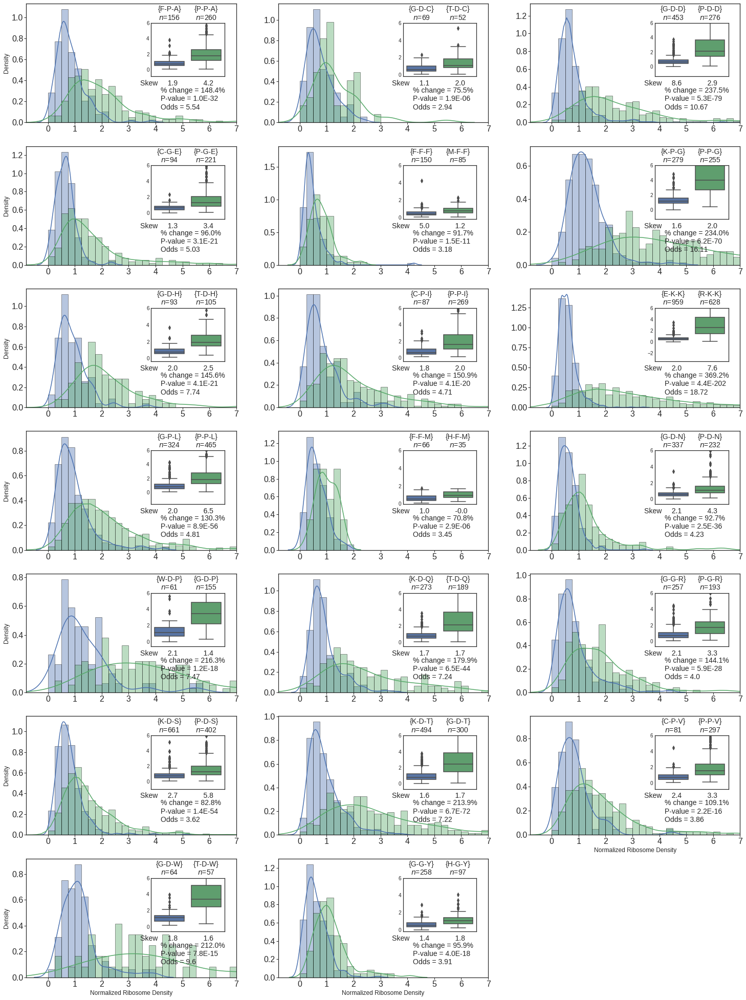

In [259]:
Input_file_path_E_site = open(path+'A_site_profile_file/matrix_file/Test4_compare_triplets_with_other_triplets/Esite_and_psite_triplet_effect/esite_triplet_with_significant_pvalue_with_best_odds_E_site_with_corrected_pvalue1.tab')
Input_file_path = path+'A_site_profile_file/esite_asite_matrix_for_amino_acid/A-site_profiles_Pool_Translation_timesssAsite_psite_esite_times_coordinates.tab' # pool dataset file
next(Input_file_path_E_site)
num_lines = sum(1 for line in Input_file_path_E_site)
Input_file_path_E_site.close()
Input_file_path_E_site = open(path+'A_site_profile_file/matrix_file/Test4_compare_triplets_with_other_triplets/Esite_and_psite_triplet_effect/esite_triplet_with_significant_pvalue_with_best_odds_E_site_with_corrected_pvalue1.tab')
next(Input_file_path_E_site)
out_path = path+'A_site_profile_file/matrix_file/Test4_compare_triplets_with_other_triplets/'


# Generating Fig. S1b below for the column 'D' of matrix for the Williams dataset shown above
fig = plt.figure(figsize=(5 * 5, 35))
palette_colors = [(0.2980392156862745, 0.4470588235294118, 0.6901960784313725), (0.3333333333333333, 0.6588235294117647, 0.40784313725490196)]

sns.set_palette(palette_colors)
subplot_counter = 1
for line in sorted(Input_file_path_E_site):
    #print(line)
    line1 = line.strip("\n").split('\t')
    if line1[7] == 'Speed_up':
        A_site = line1[0]
        P_site =  line1[1]
        E_site =  line1[2]
        alt_E_site =  line1[5]
    else:
        A_site = line1[0]
        P_site =  line1[1]
        E_site =  line1[5]
        alt_E_site =  line1[2]
    #sys.exit()
    
    ax = plt.subplot(7, 3, subplot_counter)
    if subplot_counter in [1, 4, 7, 10, 13, 16, 19]:
        ylabel = True
    else:
        ylabel = False
    if subplot_counter in [num_lines-2, num_lines-1, num_lines]:
        xlabel = True
    else:
        xlabel = False

    ax = list_calculate(Input_file_path, ax, Asite = A_site, Psite = P_site, Esite = E_site, alt_Esite = alt_E_site, alt_Psite = '', xlabel=xlabel, ylabel=ylabel)
    subplot_counter += 1
fig.savefig(out_path+'Best_A_site_triplet_pick_from_E-site_effect_pridicted_triplet_mutation.png', dpi=600, bbox_inches = 'tight')
plt.show()

###### P-site effect

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


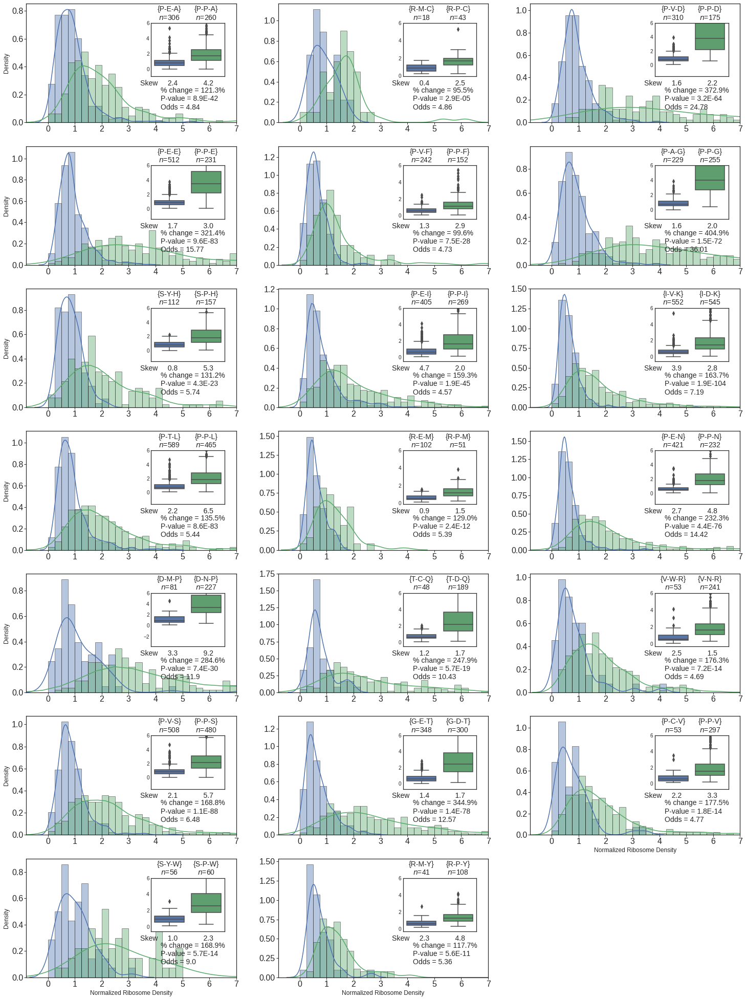

In [280]:
Input_file_path_P_site = open(path+'A_site_profile_file/matrix_file/Test4_compare_triplets_with_other_triplets/Esite_and_psite_triplet_effect/esite_triplet_with_significant_pvalue_with_best_odds_P_site_with_corrected_pvalue1.tab', 'r')
Input_file_path = path+'A_site_profile_file/esite_asite_matrix_for_amino_acid/A-site_profiles_Pool_Translation_timesssAsite_psite_esite_times_coordinates.tab' # pool dataset file
next(Input_file_path_P_site)
num_lines = sum(1 for line in Input_file_path_P_site)
Input_file_path_P_site.close()
Input_file_path_P_site = open(path+'A_site_profile_file/matrix_file/Test4_compare_triplets_with_other_triplets/Esite_and_psite_triplet_effect/esite_triplet_with_significant_pvalue_with_best_odds_P_site_with_corrected_pvalue1.tab', 'r')
next(Input_file_path_P_site)
out_path = path+'A_site_profile_file/matrix_file/Test4_compare_triplets_with_other_triplets/'


# Generating Fig. S1b below for the column 'D' of matrix for the Williams dataset shown above
fig = plt.figure(figsize=(5 * 5, 35))
palette_colors = [(0.2980392156862745, 0.4470588235294118, 0.6901960784313725), (0.3333333333333333, 0.6588235294117647, 0.40784313725490196)]

sns.set_palette(palette_colors)
subplot_counter = 1
for line in sorted(Input_file_path_P_site):
    #print(line)
    line1 = line.strip("\n").split('\t')
    if line1[7] == 'Speed_up':
        A_site = line1[0]
        P_site =  line1[1]
        E_site =  line1[2]
        alt_P_site =  line1[4]
    else:
        A_site = line1[0]
        P_site =  line1[4]
        E_site =  line1[2]
        alt_P_site =  line1[1]
    #sys.exit()
    
    ax = plt.subplot(7, 3, subplot_counter)
    if subplot_counter in [1, 4, 7, 10, 13, 16, 19]:
        ylabel = True
    else:
        ylabel = False
    if subplot_counter in [num_lines-2, num_lines-1, num_lines]:
        xlabel = True
    else:
        xlabel = False

    ax = list_calculate(Input_file_path, ax, Asite = A_site, Psite = P_site, Esite = E_site, alt_Esite = '', alt_Psite = alt_P_site, xlabel=xlabel, ylabel=ylabel)
    subplot_counter += 1
fig.savefig(out_path+'Best_A_site_triplet_pick_from_P-site_effect_pridicted_triplet_mutation.png', dpi=600, bbox_inches = 'tight')
plt.show()

### Add probability ratio in E- and P-site effect file

In [ ]:
def directory_create(out_put_path):
    
    outpath = out_put_path
    try:
        os.makedirs(outpath)
    except OSError:
        print("Creation of the directory %s failed")
    else:
        print("Successfully created the directory %s ")
        
    return


from Bio import SeqIO
def get_proteome_for_enr_dep_analysis(fsa_file):
    combined_seq = ''

    # Load the protein sequences
    for record in SeqIO.parse(fsa_file, "fasta"):
        id_line = record.id
        seq = str(record.seq)
        combined_seq += seq    
    
    perm_prob, perm_count = get_prob_megaseq(combined_seq, True)
    
    dict_ratio_prob = {}
    for aa_asite in AMINO_ACIDS:
        if aa_asite == '*':
            continue
        for aa_psite in AMINO_ACIDS:
            if aa_psite == '*':
                continue
            for aa_esite in AMINO_ACIDS:
                if aa_esite == '*':
                    continue
                aa_pair = aa_psite + aa_asite + aa_esite
                dict_ratio_prob[aa_pair] = perm_prob[aa_pair]/(perm_prob[aa_esite]*perm_prob[aa_psite]*perm_prob[aa_asite])
    
    print("Getting the ratios for total "+str(len(dict_ratio_prob))+ " pairs")
    return dict_ratio_prob

def get_prob_megaseq(megaseq, count_ind_pairs=False):
    dict_count = {}
    # Initialize the pairs as keys for the dict_count
    for aa_asite in AMINO_ACIDS:
        if aa_asite == '*':
            continue
        # If we are also counting the probabilities of finding individual amino acids across the sequence
        if count_ind_pairs:
            dict_count[aa_asite] = 0
        for aa_psite in AMINO_ACIDS:
            if aa_psite == '*':
                continue            
            for aa_esite in AMINO_ACIDS:
                if aa_esite == '*':
                    continue                
                aa_pair = aa_psite + aa_asite + aa_esite
                if aa_pair not in dict_count:
                    dict_count[aa_pair] = 0
    
    total_count = 0
    seq_count = 0
    seq_count += len(megaseq) - 2
    # get all pairs in the protein sequence
    for val in range(0, len(megaseq) - 2):
        pair = megaseq[val] + megaseq[val + 1] +  megaseq[val + 2]
        if '*' in pair or 'X' in pair:
            seq_count -= 1
            continue
        try:
            # Count the pairs
            dict_count[pair] += 1
            total_count += 1
        except KeyError:
            print(' KeyError at pos ' + str(val) + ' for pair ' + pair + ' with megaseq entry ' + str(megaseq[val]))

            
    if total_count != seq_count:
        print(' Total count ' + str(total_count) + ' different from seq count ' + str(seq_count))

    
    if count_ind_pairs:
        for val in range(0, len(megaseq)):
            if megaseq[val] in ['*', 'X']:
                continue
            try:
                dict_count[megaseq[val]] += 1
            except KeyError:
                print('KeyError for dict count for amino acid '+megaseq[val])
    
    
    dict_prob = {}
    # Probability of the pair occuring in the nucleo/cytoplasmic transcriptome
    for pair, count in dict_count.items():
        dict_prob[pair] = float(count) / total_count

    return dict_prob, dict_count



def add_prob_ration_in_file(new_file, file_read, d, dict_ratio_prob):
    
    for line in file_read:
        if d==0:
            print(line)
            line = line.strip('\n')
            d+=1
            new_file.write(line+'\ttriplet_prob_ratio\talt_triplet_prob_ratio\tprobability_ratio\n')
        else:
            line1 = line.split('\t')
            triplet = line1[0]+line1[1]+line1[2]
            alt_triplet = line1[3]+line1[4]+line1[5]
            probability_ratio = dict_ratio_prob[triplet]/dict_ratio_prob[alt_triplet]
            line = line.strip('\n')
            line = line.strip('\t')
            
            new_file.write(line+'\t'+str(dict_ratio_prob[triplet])+'\t'+str(dict_ratio_prob[alt_triplet])+'\t'+str(probability_ratio)+'\n')

    return


def probability_ratio(input1, dict_ratio_prob, output_file):
    files = os.listdir(input1)
    for file in files:
        d = 0
        if 'esite_triplet_with_significant_pvalue' in file:
            print(file)
            file_read = open(input1+file, 'r')
            if '_P_' in file:
                if 'best_odds' in file:
                    new_file = open(output_file+'triplet_with_significant_pvalue_corrected_pvalue_best_odds_with_probability_ratio_P_site.tab', 'w')
                    add_prob_ration_in_file(new_file, file_read, d, dict_ratio_prob)
                else:
                    new_file = open(output_file+'triplet_with_significant_pvalue_corrected_pvalue_with_probability_ratio_P_site.tab', 'w')
                    add_prob_ration_in_file(new_file, file_read, d, dict_ratio_prob)
            if '_E_' in file:
                if 'best_odds' in file:
                    new_file = open(output_file+'triplet_with_significant_pvalue_corrected_pvalue_best_odds_with_probability_ratio_E_site.tab', 'w')
                    add_prob_ration_in_file(new_file, file_read, d, dict_ratio_prob)
                else:
                    new_file = open(output_file+'triplet_with_significant_pvalue_corrected_pvalue_with_probability_ratio_E_site.tab', 'w')
                    add_prob_ration_in_file(new_file, file_read, d, dict_ratio_prob)

    return


In [ ]:
input1 = path+'A_site_profile_file/matrix_file/Test4_compare_triplets_with_other_triplets/Esite_and_psite_triplet_effect/'
output_file = path+'A_site_profile_file/matrix_file/Test4_compare_triplets_with_other_triplets/add_probability_ratio/'
directory_create(output_file)
orf_trans_sequence = path+'data/orf_trans.fasta'
dict_ratio_prob = get_proteome_for_enr_dep_analysis(orf_trans_sequence)
probability_ratio(input1, dict_ratio_prob, output_file)

### Generating plots between fold enrichment for amino acid triplets across the proteome against their % change

In [102]:
from Bio import SeqIO
def get_proteome_for_enr_dep_analysis(fsa_file):
    combined_seq = ''

    # Load the protein sequences
    for record in SeqIO.parse(fsa_file, "fasta"):
        id_line = record.id
        seq = str(record.seq)
        combined_seq += seq    
    
    perm_prob, perm_count = get_prob_megaseq(combined_seq, True)
    
    dict_ratio_prob = {}
    for aa_asite in AMINO_ACIDS:
        if aa_asite == '*':
            continue
        for aa_psite in AMINO_ACIDS:
            if aa_psite == '*':
                continue
            for aa_esite in AMINO_ACIDS:
                if aa_esite == '*':
                    continue
                aa_pair = aa_psite + aa_asite + aa_esite
                dict_ratio_prob[aa_pair] = perm_prob[aa_pair]/(perm_prob[aa_esite]*perm_prob[aa_psite]*perm_prob[aa_asite])
    
    print("Getting the ratios for total "+str(len(dict_ratio_prob))+ " pairs")
    return dict_ratio_prob

def get_prob_megaseq(megaseq, count_ind_pairs=False):
    dict_count = {}
    # Initialize the pairs as keys for the dict_count
    for aa_asite in AMINO_ACIDS:
        if aa_asite == '*':
            continue
        # If we are also counting the probabilities of finding individual amino acids across the sequence
        if count_ind_pairs:
            dict_count[aa_asite] = 0
        for aa_psite in AMINO_ACIDS:
            if aa_psite == '*':
                continue            
            for aa_esite in AMINO_ACIDS:
                if aa_esite == '*':
                    continue                
                aa_pair = aa_psite + aa_asite + aa_esite
                if aa_pair not in dict_count:
                    dict_count[aa_pair] = 0
    
    total_count = 0
    seq_count = 0
    seq_count += len(megaseq) - 2
    # get all pairs in the protein sequence
    for val in range(0, len(megaseq) - 2):
        pair = megaseq[val] + megaseq[val + 1] +  megaseq[val + 2]
        if '*' in pair or 'X' in pair:
            seq_count -= 1
            continue
        try:
            # Count the pairs
            dict_count[pair] += 1
            total_count += 1
        except KeyError:
            print(' KeyError at pos ' + str(val) + ' for triplet ' + pair + ' with megaseq entry ' + str(megaseq[val]))

            
    if total_count != seq_count:
        print(' Total count ' + str(total_count) + ' different from seq count ' + str(seq_count))

    
    if count_ind_pairs:
        for val in range(0, len(megaseq)):
            if megaseq[val] in ['*', 'X']:
                continue
            try:
                dict_count[megaseq[val]] += 1
            except KeyError:
                print('KeyError for dict count for amino acid '+megaseq[val])
    
    
    dict_prob = {}
    # Probability of the pair occuring in the nucleo/cytoplasmic transcriptome
    for pair, count in dict_count.items():
        dict_prob[pair] = float(count) / total_count

    return dict_prob, dict_count


def robust_triplet_dic(file_list, input_file_for_significant_triplet, speed_define, xvalue, yvalue, Read_robust_file = False):
    
    triplet_dic = []    
    for aa_asite in AMINO_ACIDS:
        if aa_asite == '*':
            continue
        for aa_psite in AMINO_ACIDS:
            if aa_psite == '*':
                continue            
            for aa_esite in AMINO_ACIDS:
                if aa_esite == '*':
                    continue                
                aa_pair = aa_psite + aa_asite + aa_esite
                triplet_dic.append(aa_pair)
    
    robust_pair = []
    robust_pair_list = []
    file_read = open(input_file_for_significant_triplet,'r')
    next(file_read)
    for line in file_read:
        line1 = line.split('\t')
        asite = line1[0]
        psite = line1[1]
        esite = line1[2]
        aa_pair = asite +psite + esite
        cooperativity = line1[4]
        if cooperativity != 'Non_Robust':
            robust_pair_list.append(aa_pair)
    fast_dic = []
    slow_dic = []
    percentage_change = {}
    perce_pair = []
    robust_pairs = {'Fast': [], 'Slow': [], 'Not_Robust': []}
    probibility_ratio_odds = {}
    for file in file_list:
        file_read = open(file,'r')
        next(file_read)
        for line in file_read:            
            line1 = line.strip('\n').split('\t')            
            asite = line1[0]
            psite = line1[1]
            esite = line1[2]
            aa_pair = asite +psite + esite
            if aa_pair in fast_dic or aa_pair in slow_dic:
                prb_ratio_odds1 = line1[xvalue].strip('\n')
                prb_ratio_odds2 = probibility_ratio_odds[aa_pair]
                if float(prb_ratio_odds1) < float(prb_ratio_odds2):
                    continue
            speed = line1[speed_define]
            perc_chng = line1[yvalue]
            prb_ratio_odds = line1[xvalue].strip('\n')
            
            ## 11 == percentage change
            ## 12 == odds
            ## 16 == probability ratio odds
            perce_pair.append(aa_pair)
            percentage_change[aa_pair]=[]
            percentage_change[aa_pair].append(perc_chng)
            probibility_ratio_odds[aa_pair]= float(prb_ratio_odds)
            if Read_robust_file:
                if aa_pair in robust_pair_list:                
                    if speed == 'Speed_up':
                        fast_dic.append(aa_pair)
                    if speed == 'Slow_Down':
                        slow_dic.append(aa_pair)
            else:
                if speed == 'Speed_up':
                    fast_dic.append(aa_pair)
                if speed == 'Slow_Down':
                    slow_dic.append(aa_pair)
    for triplet in triplet_dic:
        if triplet in fast_dic:
            robust_pairs['Fast'].append(triplet)
        if triplet in slow_dic:
            robust_pairs['Slow'].append(triplet)
        else:
            robust_pairs['Not_Robust'].append(triplet)
    
    print('Total Fast= ',len(robust_pairs['Fast']))
    print('Total Slow= ',len(robust_pairs['Slow']))
    print('Total Insignificant= ',len(robust_pairs['Not_Robust']))
    return robust_pairs, percentage_change, probibility_ratio_odds



def robust_triplet_dic_for_robust_file(input_file_for_significant_triplet, dict_ratio_prob, speed_define, yvalue, Read_robust_file = False):
    
    triplet_dic = []    
    for aa_asite in AMINO_ACIDS:
        if aa_asite == '*':
            continue
        for aa_psite in AMINO_ACIDS:
            if aa_psite == '*':
                continue            
            for aa_esite in AMINO_ACIDS:
                if aa_esite == '*':
                    continue                
                aa_pair = aa_psite + aa_asite + aa_esite
                triplet_dic.append(aa_pair)
        
    robust_pair = []
    robust_pair_list = []
    file_read = open(input_file_for_significant_triplet,'r')
    next(file_read)
    fast_dic = []
    slow_dic = []
    percentage_change = {}
    perce_pair = []
    robust_pairs = {'Fast': [], 'Slow': [], 'Not_Robust': []}
    probibility_ratio_odds = {}
    for line in file_read:
        line1 = line.split('\t')
        asite = line1[0]
        psite = line1[1]
        esite = line1[2]
        aa_pair = asite +psite + esite
        cooperativity = line1[4]
        speed = line1[speed_define]
        perc_chng = line1[yvalue]
        prb_ratio_odds = dict_ratio_prob[aa_pair]
        ## 11 == percentage change
        ## 12 == odds
        ## 16 == probability ratio odds
        perce_pair.append(aa_pair)
        percentage_change[aa_pair]=[]
        percentage_change[aa_pair].append(perc_chng)
        probibility_ratio_odds[aa_pair]= float(prb_ratio_odds)/2
        if cooperativity != 'Non_Robust':
            robust_pair_list.append(aa_pair)
            if speed == 'Speed_up':
                fast_dic.append(aa_pair)
            if speed == 'Slow_Down':
                slow_dic.append(aa_pair)

    for triplet in triplet_dic:
        if triplet in fast_dic:
            robust_pairs['Fast'].append(triplet)
        if triplet in slow_dic:
            robust_pairs['Slow'].append(triplet)
        else:
            robust_pairs['Not_Robust'].append(triplet)
    return robust_pairs, percentage_change, probibility_ratio_odds



def enr_dep_of_pairs(dict_ratio_prob, dict_sig_pairs, enr_dep_threshold=0.2):
    sorted_dict_ratio_prob = [k for k, v in sorted(dict_ratio_prob.items(), key=lambda item: item[1])]

    enriched_pairs = sorted_dict_ratio_prob[int(len(sorted_dict_ratio_prob)*(1-enr_dep_threshold)):]
    depleted_pairs = sorted_dict_ratio_prob[:int(len(sorted_dict_ratio_prob)*enr_dep_threshold)]
    
    dict_stats = {}
    dict_enr_dep_pairs = {}
    for pair_type in dict_sig_pairs:
        dict_stats[pair_type] = {'enriched': 0, 'depleted': 0}
        dict_enr_dep_pairs[pair_type] = {'enriched': [], 'depleted': []}
        for pair in dict_sig_pairs[pair_type]:
            if pair in enriched_pairs:
                dict_stats[pair_type]['enriched'] += 1
                dict_enr_dep_pairs[pair_type]['enriched'].append(pair)
            elif pair in depleted_pairs:
                dict_stats[pair_type]['depleted'] += 1
                dict_enr_dep_pairs[pair_type]['depleted'].append(pair)

    print('Fast and Enriched = ',dict_stats['Fast']['enriched'])
    print('Slow and Enriched = ',dict_stats['Slow']['enriched'])
    print('Fast and Depleted = ',dict_stats['Fast']['depleted'])
    print('Slow and Depleted = ',dict_stats['Slow']['depleted'])
    odds_ratio, pval = stats.fisher_exact([[dict_stats['Fast']['enriched'], dict_stats['Slow']['enriched']], [dict_stats['Fast']['depleted'], dict_stats['Slow']['depleted']]])
    print("Fisher's exact test - Are Fast triplets enriched and slow triplets depleted across the proteome?")
    
    if pval > 0.01:
        pval = round(pval, 4)
    else:
        pval = '%.1E' % pval
    
    print("Odds ratio: "+str(odds_ratio)+ " p-value = "+str(pval))
    return dict_enr_dep_pairs, odds_ratio, pval


def plot_enr_perc_change(dict_ratio_prob, dict_enr_dep_pairs, robust_pairs_percs, input1, yvalue, out_path, file_name, odds_ratio, pval, title):
    stat_file=open(input1+'Fig4a_data.tab', 'w')
    plot_data = {'fold_enrichment': [], 'percent_change': [], 'category': []}
    print("Running analysis for "+str(len(dict_ratio_prob))+ ' triplets')
    for pair in dict_ratio_prob:
        if pair in dict_ratio_prob and pair in robust_pairs_percs:            
            plot_data['fold_enrichment'].append(float(dict_ratio_prob[pair]))
            plot_data['percent_change'].append(float(robust_pairs_percs[pair][0]))

            if pair in dict_enr_dep_pairs['Fast']['enriched']+dict_enr_dep_pairs['Fast']['depleted']:
                plot_data['category'].append('Fast Pairs')
                stat_file.write(pair+'\t'+str(dict_ratio_prob[pair])+'\t'+str(robust_pairs_percs[pair])+'\tFast Pairs\n')
            elif pair in dict_enr_dep_pairs['Slow']['enriched']+dict_enr_dep_pairs['Slow']['depleted']:
                plot_data['category'].append('Slow Pairs')
                stat_file.write(pair+'\t'+str(dict_ratio_prob[pair])+'\t'+str(robust_pairs_percs[pair])+'\tSlow Pairs\n')
            else:
                plot_data['category'].append('Insignificant Pairs')
                stat_file.write(pair+'\t'+str(dict_ratio_prob[pair])+'\t'+str(robust_pairs_percs[pair])+'\tInsignificant Pairs\n')
    fig, ax1 = plt.subplots()
    plt.style.use('seaborn-white')
    palette_colors = ['gray', 'blue', 'red']
    print('Insignificant triplets = ',plot_data['category'].count('Insignificant Pairs'))
    print('Fast triplets',plot_data['category'].count('Fast Pairs'))
    print('Slow triplets',plot_data['category'].count('Slow Pairs'))
    ax1 = sns.scatterplot(plot_data['fold_enrichment'], plot_data['percent_change'], hue=plot_data['category'], hue_order=['Insignificant Pairs', 'Fast Pairs', 'Slow Pairs'], ax=ax1, s=10, linewidth=0.5, palette=palette_colors)
    ax1.set_xlabel('Fold enrichment of amino acid triplet relative to\n random chance', fontsize=14)

    
    if yvalue == 12:
        #  % difference in translation rate
        ax1.set_ylabel('% change in median ' + r'$\rho$', fontsize=14)
    if yvalue == 82:
        #  % difference in translation rate
        ax1.set_ylabel('% change in median ' + r'$\rho$', fontsize=14)
    if yvalue == 5:
        #  % difference in translation rate
        ax1.set_ylabel('delta1 median ', fontsize=14)
    if yvalue == 13:
        #  Odds of speed
        ax1.set_ylabel('Odds of speed ', fontsize=14)
    if yvalue == 14:
        #  Significe of triplet
        ax1.set_ylabel('P-value', fontsize=14)
    ax1.tick_params(width=1, length=4, axis='x', which='major', labelsize=9, pad=2, direction='out', bottom=True)
    ax1.tick_params(width=1, length=2, axis='y', which='major', labelsize=9, pad=1, direction='out', left=True)
    if yvalue == 13:
        ax1.axhline(y=1, linestyle='--', color='black')
    else:
        ax1.axhline(y=0, linestyle='--', color='black')
    ax1.set_title(title, fontsize=12)
    ax1.axvline(x=1, linestyle='--', color='black')
    ax1.legend(fontsize=12, loc='upper right')
    ax1.text(x=0.60 * ax1.get_xlim()[1], y=0.9* ax1.get_ylim()[0], s='p = ' + str(pval), fontsize=14)
    ax1.text(x=0.60 * ax1.get_xlim()[1], y=0.7* ax1.get_ylim()[0], s='Odds ratio = ' + str(round(odds_ratio, 2)), fontsize=14)
    ax1.spines['right'].set_visible(False)
    ax1.spines['top'].set_visible(False)
    fig.savefig(out_path+file_name, dpi=600, bbox_inches = 'tight')
    plt.show()

    
def common_triplet_found(robust_pairs_mean_percs_dict, dict_ratio_prob):
    dict_ratio_prob_new = dict_ratio_prob.copy()    
    for dic_list in dict_ratio_prob:
        if dic_list in robust_pairs_mean_percs_dict:
            continue
        else:
            del dict_ratio_prob_new[dic_list]
    return dict_ratio_prob_new

In [96]:
out_path = out_file_path = path+'A_site_profile_file/matrix_file/Test4_compare_triplets_with_other_triplets/'
orf_trans_sequence = path+'data/orf_trans.fasta'
input_file_for_significant_triplet = path+'A_site_profile_file/robust_amino_acid_matrix/Robust_aminoacid_pairs_Not_controlled_for_any_factors_amino_acid_matrix_1_datasets.tab'
input1 = path+'A_site_profile_file/matrix_file/Test4_compare_triplets_with_other_triplets/add_probability_ratio/'
esite_effect_file = input1+'triplet_with_significant_pvalue_corrected_pvalue_best_odds_with_probability_ratio_E_site.tab'
psite_effect_file = input1+'triplet_with_significant_pvalue_corrected_pvalue_best_odds_with_probability_ratio_P_site.tab'

dict_ratio_prob = get_proteome_for_enr_dep_analysis(orf_trans_sequence)

Getting the ratios for total 8000 pairs


### E and P site combined file

Total Fast=  3635
Total Slow=  3341
Total Insignificant=  4659
Fast and Enriched =  861
Slow and Enriched =  542
Fast and Depleted =  663
Slow and Depleted =  730
Fisher's exact test - Are Fast triplets enriched and slow triplets depleted across the proteome?
Odds ratio: 1.749094187774457 p-value = 2.8E-13
Running analysis for 6959 triplets
Insignificant triplets =  4176
Fast triplets 1524
Slow triplets 1259


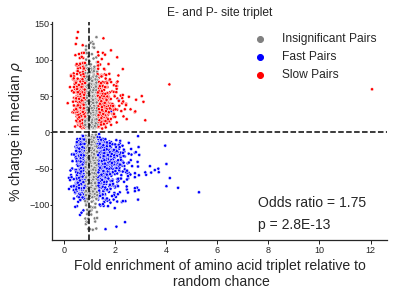

In [103]:
## select graph x axis and y axis and the speed
# Percentage change Speed = 6
# delta1 speed = 7
# percentage change = 12
# odds of speed = 13
# pvalue = 14
# probability ratio = 17

speed_define = 6
xvalue = 17
yvalue = 12

# Get robust file robust triplet information and idenstify robust enriched triplet and robust depleted triplet.
Read_robust_file_robust_triplet = False

file_list = [psite_effect_file, esite_effect_file]
robust_pairs_dict, robust_pairs_mean_percs_dict, probibility_ratio_odds = robust_triplet_dic(file_list, input_file_for_significant_triplet, speed_define, xvalue, yvalue, Read_robust_file = Read_robust_file_robust_triplet)
dict_ratio_prob_new = common_triplet_found(robust_pairs_mean_percs_dict, probibility_ratio_odds)
dict_enr_dep_pairs, odds_ratio, pval = enr_dep_of_pairs(dict_ratio_prob_new, robust_pairs_dict)
file_name = 'E_and_P_site_fold_enrichment_for_amino_acid_pairs_across_the_proteome_against_their_%_change.png'
title = 'E- and P- site triplet'
plot_enr_perc_change(dict_ratio_prob_new, dict_enr_dep_pairs, robust_pairs_mean_percs_dict, input1, yvalue, out_path, file_name, odds_ratio, pval, title)

### E site file

Total Fast=  2452
Total Slow=  2038
Total Insignificant=  5962
Fast and Enriched =  532
Slow and Enriched =  366
Fast and Depleted =  397
Slow and Depleted =  501
Fisher's exact test - Are Fast triplets enriched and slow triplets depleted across the proteome?
Odds ratio: 1.8343312549035802 p-value = 2.3E-10
Running analysis for 4490 triplets
Insignificant triplets =  2694
Fast triplets 929
Slow triplets 867


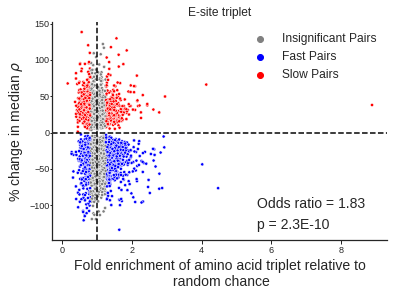

In [104]:
## select graph x axis and y axis and the speed
# Percentage change Speed = 6
# delta1 speed = 7
# percentage change = 12
# odds of speed = 13
# pvalue = 14
# probability ratio = 17

speed_define = 6
xvalue = 17
yvalue = 12

# Get robust file robust triplet information and idenstify robust enriched triplet and robust depleted triplet.
Read_robust_file_robust_triplet = False

file_list = [esite_effect_file]
robust_pairs_dict, robust_pairs_mean_percs_dict, probibility_ratio_odds = robust_triplet_dic(file_list, input_file_for_significant_triplet, speed_define, xvalue, yvalue, Read_robust_file = Read_robust_file_robust_triplet)
dict_ratio_prob_new = common_triplet_found(robust_pairs_mean_percs_dict, probibility_ratio_odds)
dict_enr_dep_pairs, odds_ratio, pval = enr_dep_of_pairs(dict_ratio_prob_new, robust_pairs_dict)
file_name = 'E_site_fold_enrichment_for_amino_acid_pairs_across_the_proteome_against_their_%_change.png'
title = 'E-site triplet'
plot_enr_perc_change(dict_ratio_prob_new, dict_enr_dep_pairs, robust_pairs_mean_percs_dict, input1, yvalue, out_path, file_name, odds_ratio, pval, title)

### P site file

Total Fast=  2806
Total Slow=  2788
Total Insignificant=  5212
Fast and Enriched =  673
Slow and Enriched =  446
Fast and Depleted =  559
Slow and Depleted =  559
Fisher's exact test - Are Fast triplets enriched and slow triplets depleted across the proteome?
Odds ratio: 1.5089686098654709 p-value = 1.5E-06
Running analysis for 5594 triplets
Insignificant triplets =  3357
Fast triplets 1232
Slow triplets 1005


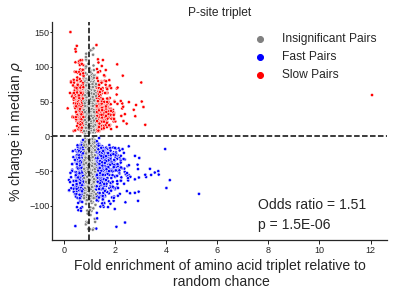

In [105]:
## select graph x axis and y axis and the speed
# Percentage change Speed = 6
# delta1 speed = 7
# percentage change = 12
# odds of speed = 13
# pvalue = 14
# probability ratio = 17

speed_define = 6
xvalue = 17
yvalue = 12

# Get robust file robust triplet information and idenstify robust enriched triplet and robust depleted triplet.
Read_robust_file_robust_triplet = False

file_list = [psite_effect_file]
robust_pairs_dict, robust_pairs_mean_percs_dict, probibility_ratio_odds = robust_triplet_dic(file_list, input_file_for_significant_triplet, speed_define, xvalue, yvalue, Read_robust_file = Read_robust_file_robust_triplet)
dict_ratio_prob_new = common_triplet_found(robust_pairs_mean_percs_dict, probibility_ratio_odds)
dict_enr_dep_pairs, odds_ratio, pval = enr_dep_of_pairs(dict_ratio_prob_new, robust_pairs_dict)
file_name = 'P_site_fold_enrichment_for_amino_acid_pairs_across_the_proteome_against_their_%_change.png'
title = 'P-site triplet'
plot_enr_perc_change(dict_ratio_prob_new, dict_enr_dep_pairs, robust_pairs_mean_percs_dict, input1, yvalue, out_path, file_name, odds_ratio, pval, title)

## Signatures of evolutionary selection for fast and slow translating amino acid triplet

### First calculate the probability ratio of all 8000 triple in complete proteome and and find out 20% Enriched and 20% depleted triplets and selecte how many robust treiples are in eneriche and depleted triplets list. Created graph between percentage change or delta1 and Fold enrichment of amino acid triplet relative to random chance

### Calculate percentage change in robust file for each triplet

In [ ]:
def Average(lst):
    return sum(lst) / len(lst)
  
def str_list(perc_chang_list):
    str_list = []
    
    for flt_vl in perc_chang_list:
        str_list.append(str(flt_vl))
    
    return str_list
    
def percentage_calculate_for_robust_file(Robust_file_Input_path, Ribodensity_file_input_path, output_path):
    ribodensity_file_list = glob.glob(Ribodensity_file_input_path+'*.tab')
    new_ribodensity_file_list = []
    for data in dataset:
        for file in ribodensity_file_list:
            if data in file:
                new_ribodensity_file_list.append(file)
    file_open_list = []
    file_read_Jan = pd.read_csv(new_ribodensity_file_list[0], sep='\t')
    file_read_Williams = pd.read_csv(new_ribodensity_file_list[1], sep='\t')
    file_read_Young = pd.read_csv(new_ribodensity_file_list[2], sep='\t')
    file_read_Weinberg = pd.read_csv(new_ribodensity_file_list[3], sep='\t')
    file_read_Nissley1 = pd.read_csv(new_ribodensity_file_list[4], sep='\t')
    file_read_Nissley2 = pd.read_csv(new_ribodensity_file_list[5], sep='\t')
    file_read_Pool = pd.read_csv(new_ribodensity_file_list[6], sep='\t')
    file_open_list = [file_read_Jan, file_read_Williams,file_read_Young, file_read_Weinberg, file_read_Nissley1, file_read_Nissley2, file_read_Pool]

    try:
        os.mkdir(output_path)
    except FileExistsError:
        pass
    line_number = 0
    file_name = Robust_file_Input_path.split('/')[::-1][0].split('.')[0]
    new_file_write = open(output_path+file_name+'_with_percentage_change.tab','w')
    with open(Robust_file_Input_path,'r') as read_file:
        first_line = read_file.readline()
        first_line = first_line.strip('\n')
        new_file_write.write(first_line+'\tavg_perc_chng\tJan\tWilliams\tYoung\tWeinberg\tNissley1\tNissley2\tPool\n')
        for line in read_file:
            line1 = line.split('\t')
            triplet = line1[0]+line1[1]+line1[2]
            perc_chang_list = []
            line = line.strip('\n')
            new_file_write = open(output_path+file_name+'_with_percentage_change.tab','a')
            new_file_write.write(line+'\t')line_number +=1
            for file_read in file_open_list:                
                asite_list = file_read.Asite == line1[0]
                psite_list = file_read.psite == line1[1]
                esite_list = file_read.esite == line1[2]
                ribosome_density1 = asite_list & psite_list & esite_list
                ribosome_density_list = file_read[ribosome_density1].Translation_time_Asite_codon.values.tolist()
                
                asite_list = file_read.Asite == line1[0]
                psite_list = file_read.psite != line1[1]
                esite_list = file_read.esite != line1[2]
                ribosome_density2 = asite_list & psite_list & esite_list
                alt_ribosome_density_list = file_read[ribosome_density2].Translation_time_Asite_codon.values.tolist()
                
                perc_change = ((np.median(ribosome_density_list) - np.median(alt_ribosome_density_list)) / np.median(alt_ribosome_density_list)) * 100
                perc_chang_list.append(perc_change)
            average = Average(perc_chang_list)
            perc_chang_list.insert(0,average)
            str_perc_chang_list = str_list(perc_chang_list)
            str_perc_chang_list = '\t'.join(str_perc_chang_list)
            new_file_write = open(output_path+file_name+'_with_percentage_change.tab','a')
            new_file_write.write(str_perc_chang_list+'\n')
    
    return

In [ ]:
Robust_file_Input_path = path+'A_site_profile_file/robust_amino_acid_matrix/Robust_aminoacid_pairs_Not_controlled_for_any_factors_amino_acid_matrix_pvalue_1_delta1_direction_7_cooperativity_effect_direction_threshold_4_datasets.tab'
Ribodensity_file_input_path = path+'A_site_profile_file/esite_asite_matrix_for_amino_acid/'
output_path = path+'A_site_profile_file/robust_amino_acid_matrix/robust_file_with_percentage_change/'

percentage_calculate_for_robust_file(Robust_file_Input_path, Ribodensity_file_input_path, output_path)

In [106]:
from Bio import SeqIO
def get_proteome_for_enr_dep_analysis(fsa_file):
    combined_seq = ''

    # Load the protein sequences
    for record in SeqIO.parse(fsa_file, "fasta"):
        id_line = record.id
        seq = str(record.seq)
        combined_seq += seq    
    
    perm_prob, perm_count = get_prob_megaseq(combined_seq, True)
    
    dict_ratio_prob = {}
    for aa_asite in AMINO_ACIDS:
        if aa_asite == '*':
            continue
        for aa_psite in AMINO_ACIDS:
            if aa_psite == '*':
                continue
            for aa_esite in AMINO_ACIDS:
                if aa_esite == '*':
                    continue
                aa_pair = aa_psite + aa_asite + aa_esite
                dict_ratio_prob[aa_pair] = perm_prob[aa_pair]/(perm_prob[aa_esite]*perm_prob[aa_psite]*perm_prob[aa_asite])
    
    print("Getting the ratios for total "+str(len(dict_ratio_prob))+ " pairs")
    return dict_ratio_prob

def get_prob_megaseq(megaseq, count_ind_pairs=False):
    dict_count = {}
    # Initialize the pairs as keys for the dict_count
    for aa_asite in AMINO_ACIDS:
        if aa_asite == '*':
            continue
        # If we are also counting the probabilities of finding individual amino acids across the sequence
        if count_ind_pairs:
            dict_count[aa_asite] = 0
        for aa_psite in AMINO_ACIDS:
            if aa_psite == '*':
                continue            
            for aa_esite in AMINO_ACIDS:
                if aa_esite == '*':
                    continue                
                aa_pair = aa_psite + aa_asite + aa_esite
                if aa_pair not in dict_count:
                    dict_count[aa_pair] = 0
    
    total_count = 0
    seq_count = 0
    seq_count += len(megaseq) - 2
    # get all pairs in the protein sequence
    for val in range(0, len(megaseq) - 2):
        pair = megaseq[val] + megaseq[val + 1] +  megaseq[val + 2]
        if '*' in pair or 'X' in pair:
            seq_count -= 1
            continue
        try:
            # Count the pairs
            dict_count[pair] += 1
            total_count += 1
        except KeyError:
            print(' KeyError at pos ' + str(val) + ' for triplet ' + pair + ' with megaseq entry ' + str(megaseq[val]))

            
    if total_count != seq_count:
        print(' Total count ' + str(total_count) + ' different from seq count ' + str(seq_count))

    
    if count_ind_pairs:
        for val in range(0, len(megaseq)):
            if megaseq[val] in ['*', 'X']:
                continue
            try:
                dict_count[megaseq[val]] += 1
            except KeyError:
                print('KeyError for dict count for amino acid '+megaseq[val])
    
    
    dict_prob = {}
    # Probability of the pair occuring in the nucleo/cytoplasmic transcriptome
    for pair, count in dict_count.items():
        dict_prob[pair] = float(count) / total_count

    return dict_prob, dict_count


def robust_triplet_dic(file_list, input_file_for_significant_triplet, speed_define, xvalue, yvalue, Read_robust_file = False):
    
    triplet_dic = []    
    for aa_asite in AMINO_ACIDS:
        if aa_asite == '*':
            continue
        for aa_psite in AMINO_ACIDS:
            if aa_psite == '*':
                continue            
            for aa_esite in AMINO_ACIDS:
                if aa_esite == '*':
                    continue                
                aa_pair = aa_psite + aa_asite + aa_esite
                triplet_dic.append(aa_pair)
        
    robust_pair = []
    robust_pair_list = []
    file_read = open(input_file_for_significant_triplet,'r')
    next(file_read)
    for line in file_read:
        line1 = line.split('\t')
        asite = line1[0]
        psite = line1[1]
        esite = line1[2]
        aa_pair = asite +psite + esite
        cooperativity = line1[4]
        if cooperativity != 'Non_Robust':
            robust_pair_list.append(aa_pair)
    fast_dic = []
    slow_dic = []
    percentage_change = {}
    perce_pair = []
    robust_pairs = {'Fast': [], 'Slow': [], 'Not_Robust': []}
    probibility_ratio_odds = {}
    for file in file_list:
        file_read = open(file,'r')
        next(file_read)
        for line in file_read:            
            line1 = line.strip('\n').split('\t')            
            asite = line1[0]
            psite = line1[1]
            esite = line1[2]
            aa_pair = asite +psite + esite
            if aa_pair in fast_dic or aa_pair in slow_dic:
                prb_ratio_odds1 = line1[xvalue].strip('\n')
                prb_ratio_odds2 = probibility_ratio_odds[aa_pair]
                if float(prb_ratio_odds1) < float(prb_ratio_odds2):
                    continue
            speed = line1[speed_define]
            perc_chng = line1[yvalue]
            prb_ratio_odds = line1[xvalue].strip('\n')
            ## 11 == percentage change
            ## 12 == odds
            ## 16 == probability ratio odds
            perce_pair.append(aa_pair)
            percentage_change[aa_pair]=[]
            percentage_change[aa_pair].append(perc_chng)
            probibility_ratio_odds[aa_pair]= float(prb_ratio_odds)
            if Read_robust_file:
                if aa_pair in robust_pair_list:                
                    if speed == 'Speed_up':
                        fast_dic.append(aa_pair)
                    if speed == 'Slow_Down':
                        slow_dic.append(aa_pair)
            else:
                if speed == 'Speed_up':
                    fast_dic.append(aa_pair)
                if speed == 'Slow_Down':
                    slow_dic.append(aa_pair)
    for triplet in triplet_dic:
        if triplet in fast_dic:
            robust_pairs['Fast'].append(triplet)
        if triplet in slow_dic:
            robust_pairs['Slow'].append(triplet)
        else:
            robust_pairs['Not_Robust'].append(triplet)
    
    print('Total Fast= ',len(robust_pairs['Fast']))
    print('Total Slow= ',len(robust_pairs['Slow']))
    print('Total Insignificant= ',len(robust_pairs['Not_Robust']))
    return robust_pairs, percentage_change, probibility_ratio_odds



def robust_triplet_dic_for_robust_file(input_file_for_significant_triplet, dict_ratio_prob, speed_define, yvalue, Read_robust_file = False):
    
    triplet_dic = []    
    for aa_asite in AMINO_ACIDS:
        if aa_asite == '*':
            continue
        for aa_psite in AMINO_ACIDS:
            if aa_psite == '*':
                continue            
            for aa_esite in AMINO_ACIDS:
                if aa_esite == '*':
                    continue                
                aa_pair = aa_psite + aa_asite + aa_esite
                triplet_dic.append(aa_pair)
    
    
    
    robust_pair = []
    robust_pair_list = []
    file_read = open(input_file_for_significant_triplet,'r')
    next(file_read)
    fast_dic = []
    slow_dic = []
    percentage_change = {}
    perce_pair = []
    robust_pairs = {'Fast': [], 'Slow': [], 'Not_Robust': []}
    probibility_ratio_odds = {}
    for line in file_read:
        line1 = line.split('\t')
        asite = line1[0]
        psite = line1[1]
        esite = line1[2]
        aa_pair = asite +psite + esite
        cooperativity = line1[4]
        pvalue_list = line1[20:27]
        cooperativity_list = line1[13:20]
        speed = line1[speed_define]
        perc_chng = line1[yvalue]
        prb_ratio_odds = dict_ratio_prob[aa_pair]
        ## 11 == percentage change
        ## 12 == odds
        ## 16 == probability ratio odds
        perce_pair.append(aa_pair)
        percentage_change[aa_pair]=[]
        percentage_change[aa_pair].append(perc_chng)
        probibility_ratio_odds[aa_pair]= float(prb_ratio_odds)
        if cooperativity != 'Non_Robust':
            robust_pair_list.append(aa_pair)
            if speed == 'Speed_up':
                fast_dic.append(aa_pair)
            if speed == 'Slow_Down':
                slow_dic.append(aa_pair)

    for triplet in triplet_dic:
        if triplet in fast_dic:
            robust_pairs['Fast'].append(triplet)
        if triplet in slow_dic:
            robust_pairs['Slow'].append(triplet)
        else:
            robust_pairs['Not_Robust'].append(triplet)
    return robust_pairs, percentage_change, probibility_ratio_odds



def enr_dep_of_pairs(dict_ratio_prob, dict_sig_pairs, enr_dep_threshold=0.2):
    sorted_dict_ratio_prob = [k for k, v in sorted(dict_ratio_prob.items(), key=lambda item: item[1])]

    enriched_pairs = sorted_dict_ratio_prob[int(len(sorted_dict_ratio_prob)*(1-enr_dep_threshold)):]
    depleted_pairs = sorted_dict_ratio_prob[:int(len(sorted_dict_ratio_prob)*enr_dep_threshold)]
    
    dict_stats = {}
    dict_enr_dep_pairs = {}
    for pair_type in dict_sig_pairs:
        dict_stats[pair_type] = {'enriched': 0, 'depleted': 0}
        dict_enr_dep_pairs[pair_type] = {'enriched': [], 'depleted': []}
        for pair in dict_sig_pairs[pair_type]:
            if pair in enriched_pairs:
                dict_stats[pair_type]['enriched'] += 1
                dict_enr_dep_pairs[pair_type]['enriched'].append(pair)
            elif pair in depleted_pairs:
                dict_stats[pair_type]['depleted'] += 1
                dict_enr_dep_pairs[pair_type]['depleted'].append(pair)

    print('Fast and Enriched = ',dict_stats['Fast']['enriched'])
    print('Slow and Enriched = ',dict_stats['Slow']['enriched'])
    print('Fast and Depleted = ',dict_stats['Fast']['depleted'])
    print('Slow and Depleted = ',dict_stats['Slow']['depleted'])
    odds_ratio, pval = stats.fisher_exact([[dict_stats['Fast']['enriched'], dict_stats['Slow']['enriched']], [dict_stats['Fast']['depleted'], dict_stats['Slow']['depleted']]])
    print("Fisher's exact test - Are Fast triplets enriched and slow triplets depleted across the proteome?")
    
    if pval > 0.01:
        pval = round(pval, 4)
    else:
        pval = '%.1E' % pval
    
    print("Odds ratio: "+str(odds_ratio)+ " p-value = "+str(pval))
    return dict_enr_dep_pairs, odds_ratio, pval


def plot_enr_perc_change(dict_ratio_prob, dict_enr_dep_pairs, robust_pairs_percs, input1, yvalue, out_path, file_name, odds_ratio, pval, title):
    stat_file=open(input1+'Fig4a_data.tab', 'w')
    plot_data = {'fold_enrichment': [], 'percent_change': [], 'category': []}
    print("Running analysis for "+str(len(dict_ratio_prob))+ ' triplets')
    for pair in dict_ratio_prob:
        if pair in dict_ratio_prob and pair in robust_pairs_percs:            
            plot_data['fold_enrichment'].append(float(dict_ratio_prob[pair]))
            plot_data['percent_change'].append(float(robust_pairs_percs[pair][0]))

            if pair in dict_enr_dep_pairs['Fast']['enriched']+dict_enr_dep_pairs['Fast']['depleted']:
                plot_data['category'].append('Fast Pairs')
                stat_file.write(pair+'\t'+str(dict_ratio_prob[pair])+'\t'+str(robust_pairs_percs[pair])+'\tFast Pairs\n')
            elif pair in dict_enr_dep_pairs['Slow']['enriched']+dict_enr_dep_pairs['Slow']['depleted']:
                plot_data['category'].append('Slow Pairs')
                stat_file.write(pair+'\t'+str(dict_ratio_prob[pair])+'\t'+str(robust_pairs_percs[pair])+'\tSlow Pairs\n')
            else:
                plot_data['category'].append('Insignificant Pairs')
                stat_file.write(pair+'\t'+str(dict_ratio_prob[pair])+'\t'+str(robust_pairs_percs[pair])+'\tInsignificant Pairs\n')
    
    
    #print(plot_data)
    fig, ax1 = plt.subplots()
    plt.style.use('seaborn-white')
    palette_colors = ['gray', 'blue', 'red']
    print('Insignificant triplets = ',plot_data['category'].count('Insignificant Pairs'))
    print('Fast triplets',plot_data['category'].count('Fast Pairs'))
    print('Slow triplets',plot_data['category'].count('Slow Pairs'))
    ax1 = sns.scatterplot(plot_data['fold_enrichment'], plot_data['percent_change'], hue=plot_data['category'], hue_order=['Insignificant Pairs', 'Fast Pairs', 'Slow Pairs'], ax=ax1, s=10, linewidth=0.5, palette=palette_colors)
    ax1.set_xlabel('Fold enrichment of amino acid triplet relative to\n random chance', fontsize=14)

    
    if yvalue == 12:
        #  % difference in translation rate
        ax1.set_ylabel('% change in median ' + r'$\rho$', fontsize=14)
    if yvalue == 82:
        #  % difference in translation rate
        ax1.set_ylabel('% change in median ' + r'$\rho$', fontsize=14)
    if yvalue == 5:
        #  % difference in translation rate
        ax1.set_ylabel('delta1 median ', fontsize=14)
    if yvalue == 13:
        #  Odds of speed
        ax1.set_ylabel('Odds of speed ', fontsize=14)
    if yvalue == 14:
        #  Significe of triplet
        ax1.set_ylabel('P-value', fontsize=14)
    ax1.tick_params(width=1, length=4, axis='x', which='major', labelsize=9, pad=2, direction='out', bottom=True)
    ax1.tick_params(width=1, length=2, axis='y', which='major', labelsize=9, pad=1, direction='out', left=True)
    if yvalue == 13:
        ax1.axhline(y=1, linestyle='--', color='black')
    else:
        ax1.axhline(y=0, linestyle='--', color='black')
    ax1.set_title(title, fontsize=12)
    ax1.axvline(x=1, linestyle='--', color='black')
    ax1.legend(fontsize=12, loc='upper right')
    ax1.text(x=0.60 * ax1.get_xlim()[1], y=0.9* ax1.get_ylim()[0], s='p = ' + str(pval), fontsize=14)
    ax1.text(x=0.60 * ax1.get_xlim()[1], y=0.5* ax1.get_ylim()[0], s='Odds ratio = ' + str(round(odds_ratio, 2)), fontsize=14)
    ax1.spines['right'].set_visible(False)
    ax1.spines['top'].set_visible(False)
    fig.savefig(out_path+file_name, dpi=600, bbox_inches = 'tight')
    plt.show()

    
def common_triplet_found(robust_pairs_mean_percs_dict, dict_ratio_prob):
    dict_ratio_prob_new = dict_ratio_prob.copy()    
    for dic_list in dict_ratio_prob:
        if dic_list in robust_pairs_mean_percs_dict:
            continue
        else:
            del dict_ratio_prob_new[dic_list]
    return dict_ratio_prob_new

In [107]:
out_path = out_file_path = path+'A_site_profile_file/matrix_file/Test4_compare_triplets_with_other_triplets/'
orf_trans_sequence = path+'data/orf_trans.fasta'
input_file_for_significant_triplet = path+'A_site_profile_file/robust_amino_acid_matrix/Robust_aminoacid_pairs_Not_controlled_for_any_factors_amino_acid_matrix_1_datasets.tab'
input1 = path+'A_site_profile_file/matrix_file/Test4_compare_triplets_with_other_triplets/add_probability_ratio/'
esite_effect_file = input1+'triplet_with_significant_pvalue_corrected_pvalue_best_odds_with_probability_ratio_E_site.tab'
psite_effect_file = input1+'triplet_with_significant_pvalue_corrected_pvalue_best_odds_with_probability_ratio_P_site.tab'

dict_ratio_prob = get_proteome_for_enr_dep_analysis(orf_trans_sequence)

Getting the ratios for total 8000 pairs


##### create fig between percentage change and Fold enrichment of amino acid triplet relative to random chance

In [108]:
orf_trans_sequence = path+'data/orf_trans.fasta'
input_file_for_significant_triplet = path+'A_site_profile_file/robust_amino_acid_matrix/robust_file_with_percentage_change/Robust_aminoacid_pairs_Not_controlled_for_any_factors_amino_acid_matrix_pvalue_1_delta1_direction_7_cooperativity_effect_direction_threshold_4_datasets_with_percentage_change.tab'
input1 = path+'A_site_profile_file/matrix_file/Test4_compare_triplets_with_other_triplets/add_probability_ratio/'

dict_ratio_prob = get_proteome_for_enr_dep_analysis(orf_trans_sequence)

Getting the ratios for total 8000 pairs


Fast and Enriched =  37
Slow and Enriched =  105
Fast and Depleted =  17
Slow and Depleted =  109
Fisher's exact test - Are Fast triplets enriched and slow triplets depleted across the proteome?
Odds ratio: 2.2593837535014005 p-value = 0.0142
Running analysis for 5198 triplets
Insignificant triplets =  4930
Fast triplets 54
Slow triplets 214


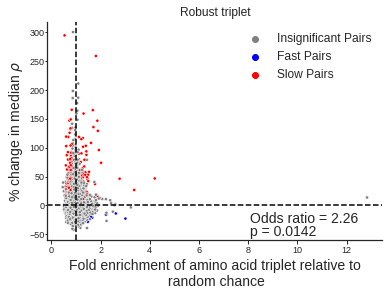

In [109]:
## select graph x axis and y axis and the speed
# Percentage change Speed = 6
# delta1 speed = 7
# percentage change = 12
# pvalue = 14
# probability ratio = 17

speed_define = 3
#xvalue = 17
yvalue = 82

# Get robust file robust triplet information and idenstify robust enriched triplet and robust depleted triplet.
Read_robust_file_robust_triplet = False

robust_pairs_dict, robust_pairs_mean_percs_dict, probibility_ratio_odds = robust_triplet_dic_for_robust_file(input_file_for_significant_triplet, dict_ratio_prob, speed_define, yvalue, Read_robust_file = Read_robust_file_robust_triplet)
#dict_ratio_prob_new = common_triplet_found(robust_pairs_mean_percs_dict, probibility_ratio_odds)
dict_enr_dep_pairs, odds_ratio, pval = enr_dep_of_pairs(probibility_ratio_odds, robust_pairs_dict)
file_name = 'Robust_triplet_fold_enrichment_for_amino_acid_pairs_across_the_proteome_against_their_%_change.png'
title = 'Robust triplet'
plot_enr_perc_change(probibility_ratio_odds, dict_enr_dep_pairs, robust_pairs_mean_percs_dict, input1, yvalue, out_path, file_name, odds_ratio, pval, title)

Fast and Enriched =  37
Slow and Enriched =  105
Fast and Depleted =  17
Slow and Depleted =  109
Fisher's exact test - Are Fast triplets enriched and slow triplets depleted across the proteome?
Odds ratio: 2.2593837535014005 p-value = 0.0142
Running analysis for 5198 triplets
Insignificant triplets =  4930
Fast triplets 54
Slow triplets 214


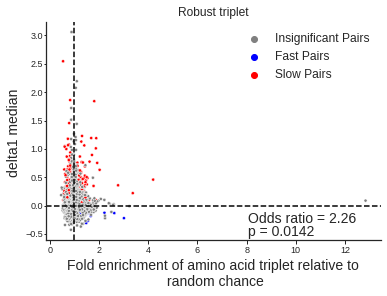

In [110]:
## select graph x axis and y axis and the speed
# Percentage change Speed = 6
# delta1 speed = 7
# percentage change = 12
# pvalue = 14
# probability ratio = 17

speed_define = 3
#xvalue = 17
yvalue = 5 # 82 for percentage change, 5 for delta1 median value

# Get robust file robust triplet information and idenstify robust enriched triplet and robust depleted triplet.
Read_robust_file_robust_triplet = False
robust_pairs_dict, robust_pairs_mean_percs_dict, probibility_ratio_odds = robust_triplet_dic_for_robust_file(input_file_for_significant_triplet, dict_ratio_prob, speed_define, yvalue, Read_robust_file = Read_robust_file_robust_triplet)
dict_enr_dep_pairs, odds_ratio, pval = enr_dep_of_pairs(probibility_ratio_odds, robust_pairs_dict)
file_name = 'Robust_triplet_fold_enrichment_for_amino_acid_pairs_across_the_proteome_against_their_delta1_median.png'
title = 'Robust triplet'
plot_enr_perc_change(probibility_ratio_odds, dict_enr_dep_pairs, robust_pairs_mean_percs_dict, input1, yvalue, out_path, file_name, odds_ratio, pval, title)

### Function definitions for the Linker vs Domain analysis
### Demonstrates that slow pairs are enriched in linker regions with respect to domain regions

In [197]:
def parse_domain_info_no_exit_tunnel_for_domain_start(domain_file, exit_tunnel_gap=30, window=30, only_cyto=True, print_stats=True):
    # NOT CONSIDERING THE EXIT TUNNEL GAP OF 30 RESIDUES AT BOTH THE START AND END OF DOMAIN REGIONS
    df = open(domain_file, 'r')
    # Proteins will be keys and each domain will be key for each protein
    dict_domains = {}
    dict_no_domains = {}
    dict_local = {}
    dict_len = {}
    dict_status = {}
    counter = 0
    dict_protein = {}
    codon_type_dict = {}
    protein = ''
    for lines in df:
        # Get the protein name
        if lines.startswith("##Unibegin"):
            fields = lines.strip().split('\t')
            protein = fields[1]
            dict_domains[protein] = {}
            dict_status[protein] = {}
        if lines.startswith("ND:"):
            fields = lines.strip().split('\t')
            no_domains = int(fields[1])
            dict_no_domains[protein] = no_domains
        if lines.startswith("mRNA:"):
            fields = lines.strip().split('\t')
            mrna_seq = fields[1]
            codon_type_dict[protein] = []
            for i in range(0, len(mrna_seq), 3):
                codon_type_dict[protein].append(mrna_seq[i:i + 3])
        if lines.startswith("TAA:"):
            fields = lines.strip().split('\t')

            aa_seq = fields[1]
            dict_len[protein] = len(aa_seq)
            dict_protein[protein] = aa_seq
            for lx in range(1, dict_len[protein] + 1):
                dict_status[protein][lx] = 'L'
        if lines.startswith('SCL:'):
            fields = lines.strip().split('\t')
            if len(fields) > 1:
                localization = fields[1]
            else:
                localization = 'NA'
            dict_local[protein] = localization
        if lines.startswith('#Dombegin'):
            fields = lines.strip().split('\t')
            counter = int(fields[1])
        if lines.startswith('D' + str(counter) + '_DRC'):
            try:
                fields = lines.strip().split('\t')[1].split('/')
            except IndexError:
                print('IndexError for protein ' + str(protein))
                fields = [0, 0]
            start = int(fields[0])
            stop = int(fields[1])
            dict_domains[protein][counter] = (start, stop)

    # Quality control for correcting the sequence of domains
    for gene in dict_domains:
        for dom in sorted(dict_domains[gene]):
            start, stop = dict_domains[gene][dom]
            if dom + 1 in dict_domains[gene]:
                start_next, stop_next = dict_domains[gene][dom + 1]
                if stop < start_next:
                    continue
                elif start_next < start:
                    dict_domains[gene][dom] = (start_next, stop_next)
                    dict_domains[gene][dom + 1] = (start, stop)

    domain_seq = []
    linker_seq = []
    domain_codons = []
    linker_codons = []
    test_d = []
    test_l = []
    no_proteins = 0
    no_total_doms = 0
    total_dom_aa = 0
    total_linker_aa = 0
    no_total_linkers = 0
    avoid_local = ['Secreted', 'membrane', 'mitochondrion', 'Mitochondrion', 'bud', 'spindle pole', 'Golgi', 'ER', 'vacuole', 'actin', 'peroxisome', 'Peroxisome', 'endosome', 'Endoplasmic']
    for gene, domains in dict_domains.items():
        if only_cyto and any(local in dict_local[gene] for local in avoid_local):
            continue
        no_proteins += 1

        for dom in sorted(domains):
            start, stop = dict_domains[gene][dom]
            # By default, do not include a domain. Include it only if the following linker is include din linker sequence.
            include_domain = False
            # Linker sequence
            if dom != 1:
                # One residue after the end of last domain
                linker_start = dict_domains[gene][dom - 1][1] + 1
                # One residue before the start of current domain
                linker_end = start - 1
                # window -1 would mean whole linker
                if window == -1:
                    linker_range_end = linker_end
                # The case where we are trying to check the enrichment within the 30 residues of exit tunnel as compared to domain
                elif window == -2:
                    linker_range_end = linker_start + 30
                else:
                    linker_range_end = linker_start + exit_tunnel_gap + window
                if linker_range_end <= linker_end:
                    # print 'Writing linker sequence of length '+str(linker_end-linker_start-window)
                    for z in range(linker_start + exit_tunnel_gap, linker_range_end + 1):  # linker_end + 1):
                        # for z in range(stop, stop+window):
                        try:
                            # Quality check
                            if genetic_code[codon_type_dict[gene][z]] != dict_protein[gene][z]:
                                print('Codon/AA mismatch for gene ' + gene + ' at codon ' + str(z + 1))
                                continue
                            linker_seq.append(dict_protein[gene][z])
                            linker_codons.append(codon_type_dict[gene][z])
                            total_linker_aa += 1

                        except IndexError:
                            continue
                    no_total_linkers += 1
                    include_domain = True
                    linker_seq.append('X')
                    linker_codons.append('X')

                if include_domain:
                    start_dom_before_linker, stop_dom_before_linker = dict_domains[gene][dom - 1]
                    for lx in range(start_dom_before_linker, stop_dom_before_linker + 1):
                        dict_status[gene][lx] = 'D'
                    no_total_doms += 1
                    # Adding the domain sequence to domain seq. Not including the first 30 codons which are likely to be inside the exit tunnel. Protein seq is 0-index list. So -1 included
                    for y in range(start_dom_before_linker - 1, stop_dom_before_linker):  # + exit_tunnel_gap):
                        # for y in range(start + window - 1, stop):
                        try:
                            # Quality check
                            if genetic_code[codon_type_dict[gene][y]] != dict_protein[gene][y]:
                                print('Codon/AA mismatch for gene ' + gene + ' at codon ' + str(y + 1))
                                continue
                            domain_seq.append(dict_protein[gene][y])
                            domain_codons.append(codon_type_dict[gene][y])
                            total_dom_aa += 1
                        except IndexError:
                            continue
                    # Adding a X at end of every domain so that aa pairs do not mix up from different domain regions.
                    domain_seq.append('X')
                    domain_codons.append('X')

        include_domain = False
        # IF there are more residues left out after end of last domain
        if dict_domains[gene][dict_no_domains[gene]][1] != dict_len[gene]:
            linker_start = dict_domains[gene][dict_no_domains[gene]][1] + 1
            linker_end = dict_len[gene]
            if window == -1:
                linker_range_end = linker_end
            elif window == -2:
                linker_range_end = linker_start + 30
            else:
                linker_range_end = linker_start + exit_tunnel_gap + window
            if linker_start + exit_tunnel_gap + window < linker_end:
                # print 'Writing linker sequence of length ' + str(linker_end - linker_start - window)
                for z in range(linker_start + exit_tunnel_gap, linker_range_end + 1):  # linker_end + 1):
                    # for z in range(stop, stop+window):
                    try:
                        linker_seq.append(dict_protein[gene][z])
                        linker_codons.append(codon_type_dict[gene][z])
                        total_linker_aa += 1
                    except IndexError:
                        continue
                no_total_linkers += 1
                include_domain = True
                linker_seq.append('X')
                linker_codons.append('X')

            if include_domain:
                start_dom_before_linker, stop_dom_before_linker = dict_domains[gene][dict_no_domains[gene]]
                for lx in range(start_dom_before_linker, stop_dom_before_linker + 1):
                    dict_status[gene][lx] = 'D'
                no_total_doms += 1

                # Adding the domain sequence to domain seq. Not including the first 30 codons which are likely to be inside the exit tunnel. Protein seq is 0-index list. So -1 included
                for y in range(start_dom_before_linker - 1, stop_dom_before_linker):
                    # for y in range(start + window - 1, stop):
                    try:
                        # Quality check
                        if genetic_code[codon_type_dict[gene][y]] != dict_protein[gene][y]:
                            print('Codon/AA mismatch for gene ' + gene + ' at codon ' + str(y + 1))
                            continue
                        domain_seq.append(dict_protein[gene][y])
                        domain_codons.append(codon_type_dict[gene][y])
                        total_dom_aa += 1
                    except IndexError:
                        continue
                # Adding an X at end of every domain so that aa pairs do not mix up from different domain regions.
                domain_seq.append('X')
                domain_codons.append('X')

    d_mega_seq = ''.join(domain_seq)
    l_mega_seq = ''.join(linker_seq)

    if print_stats:
        print("\nLinker Size: "+str(window))
        print("Total proteins analyzed: " + str(no_proteins))
        print("Total number of domains: " + str(no_total_doms))
        print("Total number of linker regions: " + str(no_total_linkers))
        print("Total residues in domains: " + str(total_dom_aa))
        print("Total residues in linkers: " + str(total_linker_aa))
    return d_mega_seq, l_mega_seq, domain_codons, linker_codons

import statsmodels.stats.contingency_tables as contingency

# REGULAR L VS D ENRICHMENT ANALYSIS.
def enr_domain_vs_linker_fishers_test(d_mega_seq, l_mega_seq, sig_pairs):
    dict_pairs = {'domain': [], 'linker': []}

    # d_mega_seq is a concatenated sequence of all domain values and similarly for l_mega_seq
    for idx, val in enumerate(d_mega_seq):
        try:
            pair = val + d_mega_seq[idx + 1] + d_mega_seq[idx + 2]
            # X was added to represent stop codon so that artificial pairs are not formed by last residue of a protein and first residue of the next protein concatenated together
            if 'X' not in pair:
                dict_pairs['domain'].append(pair)
        except IndexError:
            continue

    for idx, val in enumerate(l_mega_seq):
        
        try:
            pair = val + l_mega_seq[idx + 1]+l_mega_seq[idx + 2]
            if 'X' not in pair:
                dict_pairs['linker'].append(pair)
        except IndexError:
            continue

    # Getting the original probabilities of finding Fast/Slow pairs
    dcount_control = 0
    lcount_control = 0
    dcount_sig_pairs = 0
    lcount_sig_pairs = 0

    for pair in sig_pairs:
        dcount_sig_pairs += dict_pairs['domain'].count(pair)
        lcount_sig_pairs += dict_pairs['linker'].count(pair)

    # Control group
    for as_aa in AMINO_ACIDS:
        for ps_aa in AMINO_ACIDS:
            if ps_aa == '*':
                continue
            for es_aa in AMINO_ACIDS:
                if es_aa == '*':
                    continue
                pair = as_aa+ps_aa+es_aa
                if pair not in sig_pairs:
                    dcount_control += dict_pairs['domain'].count(pair)
                    lcount_control += dict_pairs['linker'].count(pair)

    fish_or, fish_pval = stats.fisher_exact([[lcount_sig_pairs, lcount_control], [dcount_sig_pairs, dcount_control]])
    fish_pval_formatted = '{:0.2g}'.format(fish_pval)
    or_low, or_high = contingency.Table2x2(np.asarray([np.asarray([lcount_sig_pairs, lcount_control]), np.asarray([dcount_sig_pairs, dcount_control])])).oddsratio_confint()
    
    return fish_or, fish_pval_formatted, or_low, or_high

def linker_calculate(protein_data_file, robust_pairs):
    plot_data = {'linker_size': [], 'odds_ratio': [], 'high_err': [], 'low_err': [], 'pval': [], 'hue': []}
    for pair_type in ['Slow', 'Fast']:
        for linker_size in [10, 20, 30, 40, 50, 60, 70, 80]:
            dseq, lseq, d_cdns, l_cdns = parse_domain_info_no_exit_tunnel_for_domain_start(protein_data_file, window=linker_size, exit_tunnel_gap=30, print_stats=False)
            fish_or, fish_pval_formatted, or_low, or_high = enr_domain_vs_linker_fishers_test(dseq, lseq, robust_pairs[pair_type])
            
            if linker_size == 30:
                count = l_cdns.count('X')
                print('l_cdns',count)
                count = d_cdns.count('X')
                print('d_cdns',count)
                
                print('fish_or=',fish_or, 'fish_pval_formatted=',fish_pval_formatted, 'or_low=',or_low, 'or_high=',or_high)
            
            plot_data['linker_size'].append(linker_size)
            # Subtracting 1 to make the barplot with reference to 1
            plot_data['odds_ratio'].append(fish_or-1)
            plot_data['high_err'].append(or_high)
            plot_data['low_err'].append(or_low)
            if pair_type == 'Slow':
                plot_data['hue'].append('Slow Pairs')
            elif pair_type == 'Fast':
                plot_data['hue'].append('Fast Pairs')
    return plot_data
            
def do_domain_vs_linker_analysis(plot_data, out_path, file_name):
    fig, ax = plt.subplots()
    plt.style.use('seaborn-white')
    palette_colors = ['orange', 'lightseagreen']
    palette_colors = ['red', 'blue']
    
    lower_list, higher_list = error_upper_and_lower_value_calculate(plot_data['odds_ratio'], plot_data['low_err'], plot_data['high_err'])
    ax = sns.barplot(plot_data['linker_size'], plot_data['odds_ratio'], hue=plot_data['hue'], hue_order=['Slow Pairs', 'Fast Pairs'], alpha = 0.8, ax=ax, palette=palette_colors)
        
    x_list = []
    for patch in ax.patches:
        x_list.append(patch.get_xy()[0]+(patch._width/2))
        
    plt.errorbar(x_list, plot_data['odds_ratio'], yerr=[lower_list, higher_list], 
                 marker='_', mec='GRAY', zorder=10, elinewidth=1, capsize=2, ecolor='GRAY',
                 linestyle="None", markersize=10)# ,  
    
    ax.set_xlabel('Window Size of Linker region', fontsize=14)

    #  % difference in translation rate
    ax.set_ylabel('Odds ratio showing enrichment in L\n versus D region', fontsize=14)
    #  ax.spines['bottom'].set_position(('data', 1))
    ax.tick_params(width=1, length=4, axis='x', which='major', labelsize=9, pad=2, direction='out', bottom=True)
    ax.tick_params(width=1, length=2, axis='y', which='major', labelsize=9, pad=1, direction='out', left=True)
    ax.set_yticks([-0.1, -0.05, 0, 0.05, 0.1, 0.15, 0.2, 0.25, 0.3, 0.35, 0.40, 0.45, 0.50])
    ax.set_yticklabels([0.9, 0.95, 1, 1.05, 1.1, 1.15, 1.2, 1.25, 1.3, 1.35, 1.40, 1.45, 1.50])
    ax.legend(fontsize=12, loc='upper right')
    ax.axhline(y=0, linestyle='-', color='black')
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    fig.savefig(out_path+file_name, dpi=600, bbox_inches = 'tight')
    plt.show()
  
    return

def Robust_pair_dict_create(Robust_file):
    robust_pairs_dict = {'Fast': [], 'Slow': [], 'Not Robust': []}
    file_read = open(Robust_file, 'r')
    next(file_read)
    for line in file_read:
        #print(line)
        line1 = line.split('\t')
        triplet = line1[0]+line1[1]+line1[2]
        if line1[4] == 'Non_Robust':
            robust_pairs_dict['Not Robust'].append(triplet)
        elif line1[3] == 'Speed_up':
            robust_pairs_dict['Fast'].append(triplet)
        elif line1[3] == 'Slow_Down':
            robust_pairs_dict['Slow'].append(triplet)    
    
    return robust_pairs_dict

def error_upper_and_lower_value_calculate(data, lower_error, Higher_error):
    pos = 0
    lower_error_value = []
    Higher_error_value = []
    for data_value in data:
        low_val = lower_error[pos]
        hig_val = Higher_error[pos]
        low_err_val = (1+data_value) - low_val
        lower_error_value.append(low_err_val)
        hig_err_val = hig_val - (data_value+1)
        Higher_error_value.append(hig_err_val)
        pos+=1
    new_lower_error_value = []
    new_Higher_error_value = []
    for val in range(8):        
        new_lower_error_value.append(lower_error_value[val])
        new_lower_error_value.append(lower_error_value[val+8])
        new_Higher_error_value.append(Higher_error_value[val])
        new_Higher_error_value.append(Higher_error_value[val+8])
    return new_lower_error_value, new_Higher_error_value
   

l_cdns 170
d_cdns 170
fish_or= 1.2583288639926544 fish_pval_formatted= 4.4e-08 or_low= 1.160292751725591 or_high= 1.3646482989764608
l_cdns 170
d_cdns 170
fish_or= 1.2096935831367124 fish_pval_formatted= 0.00032 or_low= 1.0918619305188493 or_high= 1.3402414024882747


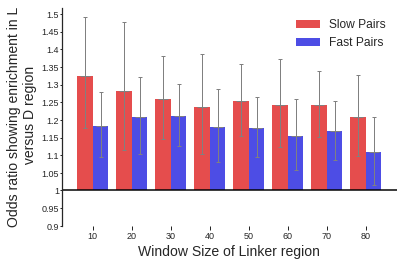

In [198]:
out_path = out_file_path = path+'A_site_profile_file/matrix_file/Test4_compare_triplets_with_other_triplets/'
Protein_domain_file = path+'data/protein_domain_db.dat'
Robust_file = input_file_for_significant_triplet = path+'A_site_profile_file/robust_amino_acid_matrix/Robust_aminoacid_pairs_Not_controlled_for_any_factors_amino_acid_matrix_pvalue_1_delta1_direction_4_cooperativity_effect_direction_threshold_4_datasets.tab'
robust_pairs_dict = Robust_pair_dict_create(Robust_file)
plot_data = linker_calculate(Protein_domain_file, robust_pairs_dict)
file_name = 'Odds_ratio_showing_enrichment_in_L_versus_D_region.png'
do_domain_vs_linker_analysis(plot_data, out_path, file_name)

### Compare AP and APE site, and present how E site play import role in regulating the speed of translation
### A- and P-site data taken from (Ahmed, N., Friedrich, U. A., Sormanni, P., Ciryam, P., Altman, N. S., Bukau, B., ... & O'Brien, E. P. (2020). Pairs of amino acids at the P-and A-sites of the ribosome predictably and causally modulate translation-elongation rates. Journal of Molecular Biology, 432(24), 166696.) 

In [6]:
def dictionary_create(ap_file,ape_file):
    ap_file_read = open(ap_file, 'r')
    next(ap_file_read)
    ap_dic = {rows.split('\t')[0][1]+rows.split('\t')[0][0]:rows.split('\t')[2] for rows in ap_file_read}
    
    ape_file_read = open(ape_file, 'r')
    next(ape_file_read)
    ape_dic = {rows.split('\t')[0]+rows.split('\t')[1]+rows.split('\t')[2]:rows.split('\t')[82] for rows in ape_file_read}
    
    return ap_dic, ape_dic

def plot_create(ap_dic, ape_dic, ap_pair, axs = '', ylabel = True):
    
    ap_name = ap_pair
    ap_pecetage_list = [float(ap_dic[ap_pair])]
    
    ape_name_fast = []
    ape_pecetage_list_fast = []
    ape_name_slow = []
    ape_pecetage_list_slow = []
    pos = 0
    for aa in AMINO_ACIDS:
        if aa == '*':
            continue
        if ap_pair+aa in ape_dic:
            if float(ape_dic[ap_pair+aa])>0:                
                ape_name_slow.append('**'+aa)
                ape_pecetage_list_slow.append(float(ape_dic[ap_pair+aa]))
            else:
                if pos == 0:
                    ape_name_fast.append(ap_pair+aa)
                    pos+=1
                else:
                    ape_name_fast.append('**'+aa)
                ape_pecetage_list_fast.append(float(ape_dic[ap_pair+aa]))
    combined_list = ap_pecetage_list+ape_pecetage_list_slow+ape_pecetage_list_fast
    
    axs.tick_params(left=True, labelleft=True, labelbottom=True, bottom=False, direction='out', length=4, width=1, labelsize=1)    
    axs.spines['right'].set_visible(False)
    axs.spines['top'].set_visible(False)
    axs.set_xlabel('Triplets', fontsize=4)
    plt.xticks(rotation=45)
    if ylabel:  
        axs.set_ylabel('Percentage Change', fontsize=4)
    axs.set_ylim(min(combined_list)-4, max(combined_list)+4)
    axs.plot(ap_name, ap_pecetage_list, '*', label=str('Fast Triplet'))
    axs.plot(ape_name_fast, ape_pecetage_list_fast, 'v', label='Fast Triplet')
    axs.plot(ape_name_slow, ape_pecetage_list_slow, '^', label='Fast Triplet')
    data_list = ap_pecetage_list+ape_pecetage_list_fast+ape_pecetage_list_slow
    plt.axhline(y=0, color='r', linestyle=':')
    return axs


print('Done')

Done


Total Plot = 5


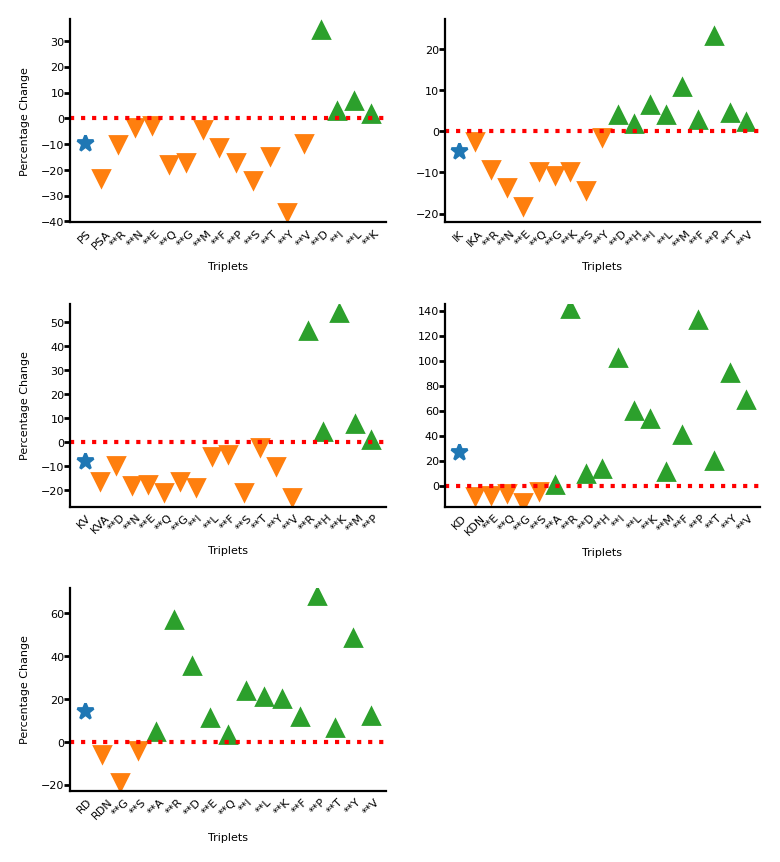

In [7]:
# A and P site robust file read
ap_file = path+'A_site_profile_file/A_and_p_site_file_at_75%_coverage_with_dataset/Robust_aminoacid_pairs_Not_controlled_for_any_factors_amino_acid_matrix_4_datasets.tab'
# A, P and E site robust file read
ape_file = path+'A_site_profile_file/robust_amino_acid_matrix/robust_file_with_percentage_change/Robust_aminoacid_pairs_Not_controlled_for_any_factors_amino_acid_matrix_pvalue_1_delta1_direction_7_cooperativity_effect_direction_threshold_4_datasets_with_percentage_change.tab'

ap_dic, ape_dic = dictionary_create(ap_file,ape_file)
pair_list = ['PS', 'IK', 'KV', 'KD', 'RD']
data_length = len(pair_list)
fig = plt.figure(figsize=(4,7), dpi=200)
counter = 1
total_plot = 0

for pair in pair_list:
    axs = fig.add_subplot(data_length, 2, counter)
    
    if counter % 2 != 0:
        ylabel = True
    else:
        ylabel = False
    
    axs = plot_create(ap_dic, ape_dic, pair, axs = axs, ylabel = ylabel)
    axs.tick_params(width=1, length=2, axis='both', which='major', labelsize=4, pad=0)
    plt.tight_layout()
    total_plot+=1
    counter+=1

print('Total Plot =', total_plot)
plt.show()

## The combined average effect of a molecular factor on translation elongation rate at the A, P and E-site
#### Each amino acid average translational speed calculated from median normalized ribosome density for A-site (median(ρ( ~ , ~ , Z))), P-site (median(ρ( ~ ,Y ,~ ))) and E-site (median(ρ(X, ~, ~))). 

In [178]:
# color assign for figure
def assign_color(val, new_list_range):
    if math.isnan(val):
        color = 'silver'
    if val == 135875:
        color = 'silver'
    elif val < new_list_range[0]:
        color = 'blue'
    elif val < new_list_range[1]:
        color = 'limegreen'
    elif val < 0:
        color = 'honeydew' # 'palegreen' #'lightgreen'
    elif val > 0:
        color = 'mistyrose'
        if val > new_list_range[3]:
            color = 'red'
        if val > new_list_range[4]:
            color = 'darkred'
    
    return matplotlib.colors.ColorConverter().to_rgb(color)

#matrix figure geneate
def matrix_fig(site_effect, new_list_range, ax = ''):
    xlabel_detail = 'Site'
    ylabel_detail = 'Amino Acid'    
    
    # control parameters for figure appearance
    axis_label_fontsize = 5
    legend_fontsize = 14
    pannel_label_fontsize = 20
    ticklabel_fontsize = 12
    spine_linewidth = 1.2
    tick_width = 2
    tick_length = 4

    matplotlib.rcParams['figure.dpi']= 600
    PA_label = ['E_site','P_site','A_site']
    AA_label = ['Y','W','V','T','S','R','Q','P','N','M','L','K','I','H','G','F','E','D','C','A']
    data = np.zeros((len(AA_label), len(PA_label), 3))
    
    for i in range(len(AA_label)):
        for j in range(len(PA_label)):
            label = PA_label[j]+AA_label[i]
            for k in range(59):
                data[i,j,:] = assign_color(site_effect[PA_label[j]][AA_label[i]], new_list_range)

    ax.imshow(data, extent=[-0.5, data.shape[1]-0.5, data.shape[0]-0.46, -0.46])#, aspect='auto')
    ax.set_xticks(np.arange(data.shape[1]))
    ax.set_yticks(np.arange(data.shape[0]))
    ax.set_xticklabels(PA_label, fontsize=ticklabel_fontsize, fontweight='normal')
    ax.set_yticklabels(AA_label, fontsize=ticklabel_fontsize, fontweight='normal')
    for edge, spine in ax.spines.items():
        spine.set_color('k')
    ax.set_xticks(np.arange(data.shape[1]+1)-.5, minor=True)
    ax.set_yticks(np.arange(data.shape[0]+1)-.5, minor=True)
    ax.grid(which="minor", color="k", linestyle='-', linewidth=spine_linewidth-1)
    ax.tick_params(which="minor", bottom=False, left=False)
    ax.set_xlabel(xlabel_detail, fontsize=axis_label_fontsize)
    ax.set_ylabel(ylabel_detail, fontsize=axis_label_fontsize)
    ax.xaxis.set_tick_params(width=tick_width-1, length=tick_length)
    ax.yaxis.set_tick_params(width=tick_width-1, length=tick_length)
    plt.xticks(rotation=45)
    ax.set_anchor('W')
    
    # legend 
    cell_text = [['', '', ' < '+str(round(new_list_range[0], 2))],
                 ['', '', ' < '+str(round(new_list_range[1], 2))],
                 ['', '', ' < 0'],
                 ['', '', ' > 0'],
                 ['', '', ' > '+str(round(new_list_range[3], 2))],
                 ['', '', ' > '+str(round(new_list_range[4], 2))],
                 ['', '', ' == Not_robust']]
    cell_color = [['w', 'blue', 'w'],
                  ['w', 'limegreen', 'w'],
                  ['w', 'honeydew', 'w'],
                  ['w', 'mistyrose', 'w'],
                  ['w', 'red', 'w'],
                  ['w', 'darkred', 'w'],
                 ['w', 'silver', 'w']]


    handle = ax.table(cellText=cell_text, cellColours=cell_color, cellLoc='left',
                      loc='right', colWidths=[0.2, 0.4, 1.2], edges='closed') #colWidths=[0.05, 0.1, 0.5]  colWidths=[0.05, 0.05, 0.2]
    for i in range(len(cell_text)):
        for j in range(len(cell_text[0])):
            handle[i,j].visible_edges = ''
    for i in range(len(cell_text)):
        handle[i,1].visible_edges = 'BRTL'
    handle.set_fontsize(legend_fontsize)
    handle.scale(0.85, 1.5)

    return 



def Map_combined_effect_of_A_P_and_E_site(ape_file, out_path):
    read_csv = pd.read_csv(ape_file, sep = "\t")    
    site_effect = {}
    site_effect['A_site'] = {}
    site_effect['P_site'] = {}
    site_effect['E_site'] = {}
    for aa in AMINO_ACIDS:
        if '*' == aa:
            continue

        if len(read_csv[(read_csv.Asite == aa) & (read_csv.Cooprative_effect != 'Non_Robust')].Delta1_median.values.tolist()) > 10 :
            site_effect['A_site'][aa]=np.median(read_csv[(read_csv.Asite == aa) & (read_csv.Cooprative_effect != 'Non_Robust')].Delta1_median.values.tolist())
        else:
            site_effect['A_site'][aa]=135875
        if len(read_csv[(read_csv.Psite == aa) & (read_csv.Cooprative_effect != 'Non_Robust')].Delta1_median.values.tolist()) > 10:
            site_effect['P_site'][aa]=np.median(read_csv[(read_csv.Psite == aa) & (read_csv.Cooprative_effect != 'Non_Robust')].Delta1_median.values.tolist())
        else:
            site_effect['P_site'][aa]=135875
        if len(read_csv[(read_csv.Esite == aa) & (read_csv.Cooprative_effect != 'Non_Robust')].Delta1_median.values.tolist()) > 10:
            site_effect['E_site'][aa]=np.median(read_csv[(read_csv.Esite == aa) & (read_csv.Cooprative_effect != 'Non_Robust')].Delta1_median.values.tolist())
        else:
            site_effect['E_site'][aa]=135875
       
    new_list_range = list_range(site_effect['A_site'],site_effect['P_site'],site_effect['E_site'])
    fig = plt.figure(figsize=(2, 3), dpi=220)
    ax = fig.add_subplot()
    
    matrix_fig(site_effect, new_list_range, ax=ax)
    ax.tick_params(width=0.5, length=2, axis='both', which='major', labelsize=4, pad=2)
    fig.savefig(out_path+'Heatmap_to_show_Combined_effect_of_A_P_E_site_matrix_at_aa_lable.png')
    return

def list_range(dict1, dict2, dict3):
    new_list = []
    for data in (dict1, dict2, dict3):
        for aa in AMINO_ACIDS:
            if '*' in aa:
                continue
            new_list.append(data[aa])
    Output = sorted(new_list, key = lambda x:float(x))
    neg_list = []
    pos_list = []
    for val in Output:
        if val > 0:
            pos_list.append(val)
        if val < 0:
            neg_list.append(val)
    pos_list_length = len(pos_list)
    pos_val = int(pos_list_length/3)
    neg_list_length = len(neg_list)
    neg_val = int(neg_list_length/3)
    new_pos_list = [pos_list[pos_val], pos_list[pos_val+pos_val]]
    new_neg_list = [neg_list[neg_val], neg_list[neg_val+neg_val]]
    #new_list_range = [Output[0],Output[12], 0, Output[48], Output[59]]
    new_list_range = [new_neg_list[0], new_neg_list[1], 0, 0.20, 0.30]
    new_list_range = [-0.10, -0.05, 0, 0.20, 0.40]
    return new_list_range


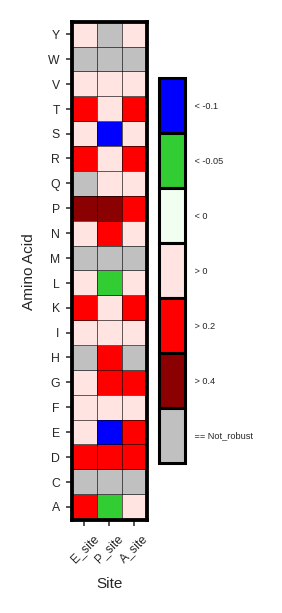

In [179]:
# A, P and E site robust file read
ape_file = path+'A_site_profile_file/robust_amino_acid_matrix/robust_file_with_percentage_change/Robust_aminoacid_pairs_Not_controlled_for_any_factors_amino_acid_matrix_pvalue_1_delta1_direction_7_cooperativity_effect_direction_threshold_4_datasets_with_percentage_change.tab'
out_path = path+'A_site_profile_file/matrix_file/'
Map_combined_effect_of_A_P_and_E_site(ape_file, out_path)

## Find out pridictive mutant triplet pair significance. We show that mutational experiments are consistent with amino acid identified influencing translation elongation rates
#### We have used experimental data to prove our analysis predictive mutational triplet pair. We have used ribo seq data, where 12 non-synonymous mutations into various positions of five non-essential S.cerevisiae genes that are not involved in translation. We compare normalized ribodesity between wild type and mutate strain to show consistency. (GEO : GSE133370)

#### Find out the wild type and mutant type triplet significant, speed in mutant prediction result.

In [7]:
def find_triplet_significance(input_file, site_effect_triplet, out_file_path):
    count = 0
    for triplet in site_effect_triplet:
        asite = triplet[4]
        psite = triplet[2]
        esite = triplet[0]
        alt_asite = triplet[10]
        alt_psite = triplet[8]    
        alt_esite = triplet[6]        
        selected_triplet = input_file[(input_file.Asite == asite) & (input_file.Psite == psite) & (input_file.Esite == esite) & (input_file.alt_Asite == alt_asite) & (input_file.alt_Psite == alt_psite) & (input_file.alt_Esite == alt_esite)]
        if count == 0:
            selected_triplet.to_csv(out_file_path, sep ='\t', mode = 'w', header=True, index=False)
        else:
            selected_triplet.to_csv(out_file_path, sep ='\t', mode = 'a', header=False, index=False)
        count+=1
    return

In [8]:
## Reads mutational pridiction analysis file and find triplet pair (Wild type triplet-mutated triplet)
input_file = pd.read_csv(path+'A_site_profile_file/matrix_file/Test4_compare_triplets_with_other_triplets/combined_result_file.tab', sep='\t')
out_file_path = path+'A_site_profile_file/matrix_file/Test4_compare_triplets_with_other_triplets/psite_experimental_mutatant_triplet.tab'
## Here the first triplet is wild type, and the second is a mutated triplet
psite_effect_triplet = ['A-E-G,A-P-G','L-N-R,L-S-R', 'T-D-G,T-F-G', 'P-G-T,P-S-T', 'E-G-G,E-S-G', 'A-Q-D,A-P-D', 'E-H-K,E-V-K', 'Q-E-E,Q-K-E',
                        'S-G-T,S-S-T', 'W-G-G,W-S-G', 'G-Y-F,G-V-F', 'T-N-A,T-L-A']

find_triplet_significance(input_file, psite_effect_triplet, out_file_path)

out_file_path = path+'A_site_profile_file/matrix_file/Test4_compare_triplets_with_other_triplets/esite_experimental_mutatant_triplet.tab'
esite_effect_triplet = ['E-G-M,P-G-M', 'G-T-E,S-T-E', 'Q-D-V,P-D-V', 'E-E-K,K-E-K', 'H-K-D,V-K-D', 'D-G-Q,F-G-Q', 'G-G-R,S-G-R','N-R-K,S-R-K', 
                        'G-T-D,S-T-D','G-G-F,S-G-F', 'Y-F-N,V-F-N', 'N-A-R,L-A-R']
find_triplet_significance(input_file, esite_effect_triplet, out_file_path)
print('Done')

         Asite Psite Esite alt_Asite alt_Psite alt_Esite  \
0            V     L     P         V         L         S   
1            V     L     P         V         L         T   
2            V     L     P         V         L         W   
3            V     L     P         V         L         Y   
4            V     L     P         V         L         V   
...        ...   ...   ...       ...       ...       ...   
31995995     K     L     Y         V         V         S   
31995996     K     L     Y         V         V         T   
31995997     K     L     Y         V         V         W   
31995998     K     L     Y         V         V         Y   
31995999     K     L     Y         V         V         V   

         percentage_change_Speed delta1_Speed alt_delta1_Speed  size  \
0                      Slow_Down    Slow_Down         Speed_up   507   
1                      Slow_Down    Slow_Down         Speed_up   507   
2                      Slow_Down    Slow_Down         Speed_up 

In [378]:
psite_file_read = pd.read_csv(path+'A_site_profile_file/matrix_file/Test4_compare_triplets_with_other_triplets/psite_experimental_mutatant_triplet.tab', sep='\t')
print(psite_file_read)

   Asite Psite Esite alt_Asite alt_Psite alt_Esite percentage_change_Speed  \
0      G     E     A         G         P         A                Speed_up   
1      R     N     L         R         S         L               Slow_Down   
2      G     D     T         G         F         T               Slow_Down   
3      T     G     P         T         S         P               Slow_Down   
4      G     G     E         G         S         E               Slow_Down   
5      D     Q     A         D         P         A                Speed_up   
6      K     H     E         K         V         E               Slow_Down   
7      E     E     Q         E         K         Q                Speed_up   
8      T     G     S         T         S         S               Slow_Down   
9      G     G     W         G         S         W               Slow_Down   
10     F     Y     G         F         V         G               Slow_Down   
11     A     N     T         A         L         T              

#### Check p-site effect triplet pair (Wild type triplet-mutated triplet) robustness in robust file

In [9]:
def triplet_robs(ape_file):
    triplet_robustness = {}
    for line in ape_file:
        line1 = line.split('\t')
        triplet = line1[0]+line1[1]+line1[2]
        triplet_robustness[triplet] = []
        triplet_robustness[triplet].append(line1[4])
    return triplet_robustness

In [12]:
psite_file_read = open(path+'A_site_profile_file/matrix_file/Test4_compare_triplets_with_other_triplets/psite_experimental_mutatant_triplet.tab', 'r')
ape_file = open(path+'A_site_profile_file/robust_amino_acid_matrix/robust_file_with_percentage_change/Robust_aminoacid_pairs_Not_controlled_for_any_factors_amino_acid_matrix_pvalue_1_delta1_direction_7_cooperativity_effect_direction_threshold_4_datasets_with_percentage_change.tab')
next(ape_file)
next(psite_file_read)
triplet_robustness = triplet_robs(ape_file)
#sys.exit()    

for line in psite_file_read:
    line1 = line.split('\t')
    print(line1)
    org_triplet = line1[0]+line1[1]+line1[2]
    alt_triplet = line1[3]+line1[4]+line1[5]
    try:
        print(triplet_robustness[org_triplet][0])
    except KeyError:
        print("Non_Robust")
    try:
        print(triplet_robustness[alt_triplet][0])
    except KeyError:
        print("Non_Robust")


['G', 'E', 'A', 'G', 'P', 'A', 'Speed_up', 'Speed_up', 'Slow_Down', '272', '217', '2.6546068426426266e-41', '-78.780179564314', '5.7897158633383174\n']
Non_Robust
Negative_cooperativity
['R', 'N', 'L', 'R', 'S', 'L', 'Slow_Down', 'Slow_Down', 'Speed_up', '499', '894', '0.0014562855004563563', '13.108997996637495', '1.2125760085704933\n']
Non_Robust
Non_Robust
['G', 'D', 'T', 'G', 'F', 'T', 'Slow_Down', 'Slow_Down', 'Slow_Down', '301', '288', '5.058541634192296e-16', '38.3011296628246', '2.237647058823529\n']
Positive_cooperativity
Non_Robust
['T', 'G', 'P', 'T', 'S', 'P', 'Slow_Down', 'Slow_Down', 'Speed_up', '260', '594', '1.0160493326342276e-16', '42.77649322926587', '2.091809973774299\n']
Positive_cooperativity
Positive_cooperativity
['G', 'G', 'E', 'G', 'S', 'E', 'Slow_Down', 'Slow_Down', 'Speed_up', '282', '485', '3.463961044026196e-05', '25.696752502252394', '1.4158762121774149\n']
Non_Robust
Non_Robust
['D', 'Q', 'A', 'D', 'P', 'A', 'Speed_up', 'Slow_Down', 'Slow_Down', '248', '

In [ ]:
esite_file_read = out_file_path = pd.read_csv(path+'A_site_profile_file/matrix_file/Test4_compare_triplets_with_other_triplets/esite_experimental_mutatant_triplet.tab', sep='\t')
print(esite_file_read)

### Check E-site effect triplet pair (Wild type triplet-mutated triplet) robustness in robust file

In [13]:
esite_file_read =open(path+'A_site_profile_file/matrix_file/Test4_compare_triplets_with_other_triplets/esite_experimental_mutatant_triplet.tab', 'r')
ape_file = open(path+'A_site_profile_file/robust_amino_acid_matrix/robust_file_with_percentage_change/Robust_aminoacid_pairs_Not_controlled_for_any_factors_amino_acid_matrix_pvalue_1_delta1_direction_7_cooperativity_effect_direction_threshold_4_datasets_with_percentage_change.tab')
next(ape_file)
next(esite_file_read)
triplet_robustness = triplet_robs(ape_file)
#sys.exit()    

for line in esite_file_read:
    line1 = line.split('\t')
    print(line1)
    org_triplet = line1[0]+line1[1]+line1[2]
    alt_triplet = line1[3]+line1[4]+line1[5]
    try:
        print(triplet_robustness[org_triplet][0])
    except KeyError:
        print("Non_Robust")
    try:
        print(triplet_robustness[alt_triplet][0])
    except KeyError:
        print("Non_Robust")


['M', 'G', 'E', 'M', 'G', 'P', 'Speed_up', 'Slow_Down', 'Slow_Down', '114', '112', '0.0761486723153394', '-7.995786658140062', '1.247887323943662\n']
Non_Robust
Non_Robust
['E', 'T', 'G', 'E', 'T', 'S', 'Speed_up', 'Speed_up', 'Slow_Down', '282', '582', '0.0144172510895219', '-6.746671543514353', '1.201722495740713\n']
Non_Robust
Non_Robust
['V', 'D', 'Q', 'V', 'D', 'P', 'Speed_up', 'Speed_up', 'Slow_Down', '273', '296', '6.251766749372755e-17', '-44.61864853919079', '2.3412445730824896\n']
Non_Robust
Positive_cooperativity
['K', 'E', 'E', 'K', 'E', 'K', 'Speed_up', 'Speed_up', 'Slow_Down', '939', '1032', '1.855503515236185e-115', '-63.132241321875505', '3.926932815407613\n']
Non_Robust
Negative_cooperativity
['D', 'K', 'H', 'D', 'K', 'V', 'Speed_up', 'Slow_Down', 'Slow_Down', '156', '521', '0.002756503492484557', '-14.400874218991182', '1.3429329182161491\n']
Non_Robust
Non_Robust
['Q', 'G', 'D', 'Q', 'G', 'F', 'Slow_Down', 'Slow_Down', 'Speed_up', '201', '184', '0.0018309857552836995

### Significant speed change triplet pair (Wild type triplet-mutated triplet) selected for P-site and E-site. Selected only those are showing opposite speed direction (Slow to fast and fast to slow)

In [23]:
def triplet_classification(psite_file_path, site_effect_triplet):
    next(psite_file_path)
    speed_change_triplet = []
    neg_control_triplet = []
    count = 0
    for line in psite_file_path:
        line1 = line.split('\t')
        org_speed = line1[7]
        alt_speed = line1[8]
        if org_speed == alt_speed:
            neg_control_triplet.append(site_effect_triplet[count])
        else:
            speed_change_triplet.append(site_effect_triplet[count])
        count+=1
    print('speed_change_triplet=', speed_change_triplet)
    print('negative_control_triplet',neg_control_triplet)
    return

In [24]:
print('Select P-site effect triplet')
psite_file_path = open(path+'A_site_profile_file/matrix_file/Test4_compare_triplets_with_other_triplets/psite_experimental_mutatant_triplet.tab', 'r')
psite_effect_triplet = ['A-E-G,A-P-G','L-N-R,L-S-R', 'T-D-G,T-F-G', 'P-G-T,P-S-T', 'E-G-G,E-S-G', 'A-Q-D,A-P-D', 'E-H-K,E-V-K', 'Q-E-E,Q-K-E',
                        'S-G-T,S-S-T', 'W-G-G,W-S-G', 'G-Y-F,G-V-F', 'T-N-A,T-L-A']
triplet_classification(psite_file_path, psite_effect_triplet)

print('Select E-site effect triplet')
esite_file_path = open(path+'A_site_profile_file/matrix_file/Test4_compare_triplets_with_other_triplets/esite_experimental_mutatant_triplet.tab', 'r')
esite_effect_triplet = ['E-G-M,P-G-M', 'G-T-E,S-T-E', 'Q-D-V,P-D-V', 'E-E-K,K-E-K', 'H-K-D,V-K-D', 'D-G-Q,F-G-Q', 'G-G-R,S-G-R','N-R-K,S-R-K', 
                        'G-T-D,S-T-D','G-G-F,S-G-F', 'Y-F-N,V-F-N', 'N-A-R,L-A-R']

triplet_classification(esite_file_path, esite_effect_triplet)

Select P-site effect triplet
speed_change_triplet= ['A-E-G,A-P-G', 'L-N-R,L-S-R', 'P-G-T,P-S-T', 'E-G-G,E-S-G', 'E-H-K,E-V-K', 'Q-E-E,Q-K-E', 'S-G-T,S-S-T', 'W-G-G,W-S-G']
negative_control_triplet ['T-D-G,T-F-G', 'A-Q-D,A-P-D', 'G-Y-F,G-V-F', 'T-N-A,T-L-A']
Select E-site effect triplet
speed_change_triplet= ['G-T-E,S-T-E', 'Q-D-V,P-D-V', 'E-E-K,K-E-K', 'D-G-Q,F-G-Q', 'Y-F-N,V-F-N', 'N-A-R,L-A-R']
negative_control_triplet ['E-G-M,P-G-M', 'H-K-D,V-K-D', 'G-G-R,S-G-R', 'N-R-K,S-R-K', 'G-T-D,S-T-D', 'G-G-F,S-G-F']


#### Loading the datasets for the Ribosome profiling samples carried out on mutated strains

In [104]:
# Parses A-site file for reads per nucleotide.
# Converts reads per nucleotide to raw reads per codon. Then normalized read density profiles are obtained by dividing the raw reads at each codon position by average raw reads across the gene.
# Filters genes according to the criteria specified in options: list of genes/genes which have at least 3 reads per codon or/and do not overlap with any other genes or/and do not have introns
def gene_codon_filter(asite_file, mul_map_file, mul_map_threshold=0.1, filter_threshold=0.1, read_threshold=3, dataset='', all_genes=False, genelist=None, strict=True, relaxed=False, print_stats=False):
    # Total unique reads mapped to a gene
    unique_mapped_reads = {}
    # Total multiple mapped reads mapped to a gene
    mul_mapped_reads = {}

    # If the reads mapped to multiple positions constitute > mul_map_threshold of the total reads, then that gene's ribosome profile will not be considered for analysis
    # Genes with multiple mapped reads to be filtered out from analysis. Default threshold of 1%. Genes with more than 1% multiple mapped reads will be removed.
    mul_map_genes = []

    overlap_genes = pickle.load(StrToBytes(open(path+Overlap_gene_list)))
    intronic_genes = pickle.load(StrToBytes(open(path+Intronic_gene_list)))
    
    total_read_count = 0
    dict_len = {}
    codon_dict = {}
    # Parse the A-site file to get the reads for each position of each gene
    # We get the reads info in dict_gene_count and the nucleotide info in nuc_dict
    with open(asite_file) as file_asite_table:
        for lines in file_asite_table:
            line_list = lines.strip().split('\t')
            gene = line_list[0]
            gene_length = int(line_list[1])
            # The list of reads mapped to A-sites along the nt positions of the transcript
            count_list = list(map(int, line_list[2].split(',')))
            # Quality check
            if len(count_list) % 3 != 0:
                print('QUALITY CHECK NOT MET: Gene '+gene+' have a length not a multiple of 3. The length is '+str(len(count_list)))
            if gene.startswith('Q'):
                continue
            codon_dict[gene] = []
            # Convert the reads per nucleotide to reads per codon
            for i in range(0, len(count_list), 3):
                codon_dict[gene].append(sum(count_list[i:i+3]))
            dict_len[gene] = gene_length
            unique_mapped_reads[gene] = sum(count_list)
            total_read_count += sum(count_list)
    print('Parsed the A-site file for '+dataset+ " dataset")

    # Get the number of mul mapped reads to decide whether to delete the gene or not. If a gene has more than 0.1% of reads multiple mapped, we delete it
    with open(mul_map_file) as f:
        for lines in f:
            line_list = lines.strip().split('\t')
            gene = line_list[0]
            read_count = list(map(int, line_list[1:]))
            if sum(read_count) > 0:
                mul_mapped_reads[gene] = sum(read_count)

    if print_stats:
        print("\nGene mapping statistics for "+dataset+" dataset\n")
        print('Number of genes with A-site profiles: ' + str(len(dict_len)))
        print('Number of genes containing introns: ' + str(len(intronic_genes)))
        print('Number of genes containing overlaps: ' + str(len(overlap_genes)))
        print('Number of genes containing multiple aligned reads: ' + str(len(mul_mapped_reads)))
        print('Number of reads mapped to the yeast transcriptome: ' + str(total_read_count))

    # Count variables to determine the statistics of gene counts in each category
    no_of_genes = 0

    # Store the norm ribo density profiles for selected genes in this dict and return this dict
    norm_density_dict = {}

    for gene, gene_len in dict_len.items():
        if gene in mul_mapped_reads:
            try:
                perc_mul_map = float(mul_mapped_reads[gene]) * 100 / float(mul_mapped_reads[gene] + unique_mapped_reads[gene])
            except ZeroDivisionError:
                print('ZeroDivisionError for mul map calculation for gene '+str(gene))
                print(mul_mapped_reads[gene], unique_mapped_reads[gene])
                continue
            if perc_mul_map > mul_map_threshold:
                mul_map_genes.append(gene)

        # Writing out a file at codon level
        cod_len = len(codon_dict[gene])
        # Sanitary check
        if cod_len != gene_len / 3:
            print('Discrepancy in populating codon dicts. Length of codon dict (' + str(cod_len) + ') not equal to one-third of gene length (' + str(gene_len) + ')')

        mean_read_density = np.mean(codon_dict[gene])

        # Select for high coverage genes based on how many positions have non-zero reads
        number_of_zeroes = codon_dict[gene].count(0)
        
        # If this boolean is set to True, get the norm read density profiles for all genes
        if all_genes:
            norm_density_dict[gene] = [raw_density / mean_read_density for raw_density in codon_dict[gene]]
        # If a list of genes is specified, then the norm ribosome density profiles are obtained for these set of genes only
        elif genelist is not None and gene in genelist:
            if mean_read_density > 0.0:
                norm_density_dict[gene] = [raw_density / mean_read_density for raw_density in codon_dict[gene]]

        # In relaxed criteria, we will be selecting genes that have a certain percentage of codon positions with non-zero reads,
        # For example, for a filter threshold of 0.05, we will be selecting genes that have zero reads for less than 5% of positions
        # We are also not considering genes that may have overlapping CDS or genes that contain introns (These constitute < 6% of yeast transcriptome)
        elif relaxed and number_of_zeroes <= math.ceil(filter_threshold * cod_len):
            if gene not in overlap_genes and gene not in mul_map_genes and gene not in intronic_genes:
                no_of_genes += 1
                norm_density_dict[gene] = [raw_density/mean_read_density for raw_density in codon_dict[gene]]

        # If we apply the strict criteria where every codon position needs to have greater than read_threshold (default=1) reads
        elif strict:
            # We remove the first two codons from the analysis since start codon is expected not to contain any reads and the second codon's ribosome density is influenced by initiation
            # now each codon position should contain at least the read_threhsold number of reads for the gene to be included
            if all(v >= read_threshold for v in codon_dict[gene][2:]) and gene not in overlap_genes and gene not in intronic_genes and gene not in mul_map_genes:
                no_of_genes += 1
                norm_density_dict[gene] = [raw_density / mean_read_density for raw_density in codon_dict[gene]]
                
    if all_genes:
        print("Getting the norm ribo density profiles for all " + str(len(dict_len)) + " genes in " + dataset + " dataset")
    elif genelist is not None:
        print("Getting the norm ribo density profiles for a constant set of "+str(len(genelist))+" genes in "+dataset+" dataset")
    elif relaxed:
        print("No. of genes that have non-zero reads at greater than " + str(100-filter_threshold * 100) + "% of positions for "+dataset+" dataset: " + str(no_of_genes))
    elif strict:
        print("No. of genes with atleast " + str(read_threshold) + " reads in each codon position for "+dataset+" dataset is: " + str(no_of_genes))

    return norm_density_dict

class StrToBytes:
    def __init__(self, fileobj):
        self.fileobj = fileobj
    def read(self, size):
        return self.fileobj.read(size).encode()
    def readline(self, size=-1):
        return self.fileobj.readline(size).encode()

In [105]:
phaseI_list_samples = ['YMR_rep1', 'YMR_rep2', 'YKL_rep1', 'YKL_rep2', 'YLR_rep1', 'YLR_rep2', 'YOL_rep1', 'YOL_rep2']
phaseII_list_samples = ['YHR_rep1', 'YHR_rep2', 'YHR_rep3', 'YHR_rep4', 'YOL-A_rep1', 'YOL-A_rep2', 'YOL-A_rep3', 'YOL-A_rep4',
                            'YOL-B_rep1', 'YOL-B_rep2', 'YOL-B_rep3', 'YOL-B_rep4']
path1 = path+'A_site_profile_file/A-site_profile_pool_data_without_mutated_gene_nabeel_file/'
dict_norm_ribo_density = {'PhaseI': {}, 'PhaseII': {}}
for sample in phaseI_list_samples:
    dict_norm_ribo_density['PhaseI'][sample] = gene_codon_filter(path1+sample+'/A-site_profiles.tab', path1+sample+'/Multiple_mapped_gene_read_counts_20_35.tab', dataset=sample, all_genes=True)
for sample in phaseII_list_samples:
    dict_norm_ribo_density['PhaseII'][sample] = gene_codon_filter(path1+sample+'/A-site_profiles.tab', path1+sample+'/Multiple_mapped_gene_read_counts_20_35.tab', dataset=sample, all_genes=True)


Parsed the A-site file for YMR_rep1 dataset


<ipython-input-104-e5737e931ce9>:92: RuntimeWarning: invalid value encountered in double_scalars
  norm_density_dict[gene] = [raw_density / mean_read_density for raw_density in codon_dict[gene]]


Getting the norm ribo density profiles for all 6376 genes in YMR_rep1 dataset
Parsed the A-site file for YMR_rep2 dataset
Getting the norm ribo density profiles for all 6376 genes in YMR_rep2 dataset
Parsed the A-site file for YKL_rep1 dataset
Getting the norm ribo density profiles for all 6376 genes in YKL_rep1 dataset
Parsed the A-site file for YKL_rep2 dataset
Getting the norm ribo density profiles for all 6376 genes in YKL_rep2 dataset
Parsed the A-site file for YLR_rep1 dataset
Getting the norm ribo density profiles for all 6376 genes in YLR_rep1 dataset
Parsed the A-site file for YLR_rep2 dataset
Getting the norm ribo density profiles for all 6376 genes in YLR_rep2 dataset
Parsed the A-site file for YOL_rep1 dataset
Getting the norm ribo density profiles for all 6376 genes in YOL_rep1 dataset
Parsed the A-site file for YOL_rep2 dataset
Getting the norm ribo density profiles for all 6376 genes in YOL_rep2 dataset
Parsed the A-site file for YHR_rep1 dataset
Getting the norm ribo de

#### Function definitions for plotting normalized ribosome densities for the A-sites when the mutated amino acid is in P-site or E-site

In [106]:
def get_mutant_densities(dict_norm_ribo_density, dict_mut_pos, phaseI_list_samples, phaseII_list_samples):
    plot_data = {}
    plot_avg = {}
    for mut in dict_mut_pos:
        plot_data[mut] = {'Type': [], 'Density': []}
        density_list = {'Mutant': [], 'Wild-type': []}
        gene = mut.split(' ')[0]
        if gene == 'YHR179W':
            phase = 'PhaseII'
            phase_samples = phaseII_list_samples
        else:
            phase = 'PhaseI'
            phase_samples = phaseI_list_samples
        for sample in phase_samples:
            density = dict_norm_ribo_density[phase][sample][gene][dict_mut_pos[mut]-1]
            plot_data[mut]['Density'].append(density)
            #print(sample)
            
            if gene[:3] in sample:
                plot_data[mut]['Type'].append('Mutant')
                density_list['Mutant'].append(density)
            else:
                plot_data[mut]['Type'].append('Wild-type')
                density_list['Wild-type'].append(density)
        plot_avg[mut] = {'Type': [], 'Density': []}
        for samp_type in density_list:
            plot_avg[mut]['Type'].append(samp_type)
            plot_avg[mut]['Density'].append(np.mean(density_list[samp_type]))
    
    return plot_data, plot_avg


def subplot_mut_vs_wt(ax, plot_data, plot_avg, title, ytype='Density', xtype='Type', jitter=True, set_xlabel=False, set_ylabel=True, xlabel='',
                      ylabel='Normalized Ribo Density', yticks=None, dec=1, set_ylimits=False, ylim1=0, ylim2=3, 
                     palette_colors=((0.2980392156862745, 0.4470588235294118, 0.6901960784313725), (0.8666666666666667, 0.5176470588235295, 0.3215686274509804))):
    sns.set_palette(palette_colors)
    ax = sns.stripplot(plot_data[xtype], plot_data[ytype], ax=ax, size=10, linewidth=1, jitter=jitter, order=['Wild-type', 'Mutant'])
    if set_ylimits:
        ax.set_ylim(ylim1, ylim2)
    else:
        ax.set_ylim(ax.get_ylim()[0], ax.get_ylim()[1])
    if dec == 1:
        ax.yaxis.set_major_formatter(FormatStrFormatter('%.1f'))
    else:
        ax.yaxis.set_major_formatter(FormatStrFormatter('%.2f'))
#     if colors:
#         ax.set_prop_cycle(color=colors) # ['blue', 'green', 'orange'])

    ax = sns.boxplot(plot_avg[xtype], plot_avg[ytype], width=0.6, linewidth=3, ax=ax, order=['Wild-type', 'Mutant'])
    for i, col in enumerate(palette_colors):
        mybox = ax.artists[i]
        mybox.set_edgecolor(col)
        for j in range(i * 6, i * 6 + 6):
            wline = ax.lines[j]
            wline.set_color(col)
            wline.set_mfc(col)
            wline.set_mec(col)
    ax.set(adjustable='box')
    # ax.set_aspect('equal')
    ax.set_title(title, fontsize=12)
    if set_ylabel:
        ax.set_ylabel(ylabel, fontsize=12)
    else:
        ax.yaxis.label.set_visible(False)
    if set_xlabel:
        ax.set_xlabel(xlabel, fontsize=10)
    else:
        ax.xaxis.label.set_visible(False)
    ax.tick_params(labelsize=14)
    ax.tick_params(width=1, length=4, axis='y', which='major', labelsize=10, pad=2)
    if yticks:
        ax.set_yticks(yticks)
        ax.set_yticklabels(yticks)
    return ax

def plot_mutant_ribo_density_Fig2(plot_data, plot_avg, dict_mutations, out_path, file_name):
    fig = plt.figure(figsize=(5 * 5, 10))
    sns.set()
    
    counter = 1
    for gene_name_pos in dict_mutations:
        title = gene_name_pos.split(' ')
        title_gene = title[0]
        title_pos = title[1].replace('>','-').split('-')
        del title_pos[3:5]
        title_name = title_gene+' ('+title_pos[0]+','+title_pos[1]+','+title_pos[2]+') \u2192 ('+title_pos[3]+','+title_pos[4]+','+title_pos[5]+')'
        ax = plt.subplot(2,5,counter)
        ylimit = max(plot_data[gene_name_pos]['Density'])
        Percentage = float(ylimit)/float(10)
        ax = subplot_mut_vs_wt(ax, plot_data[gene_name_pos], plot_avg[gene_name_pos], title=title_name, set_ylimits=True, ylim2=ylimit+Percentage)
        counter+=1
    fig.savefig(out_path+file_name, dpi=600, bbox_inches = 'tight')
    return

##### P-site effect

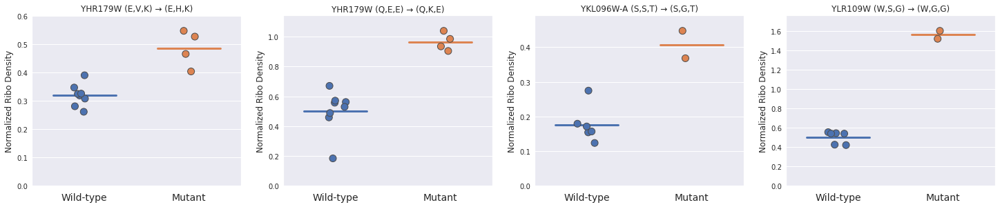

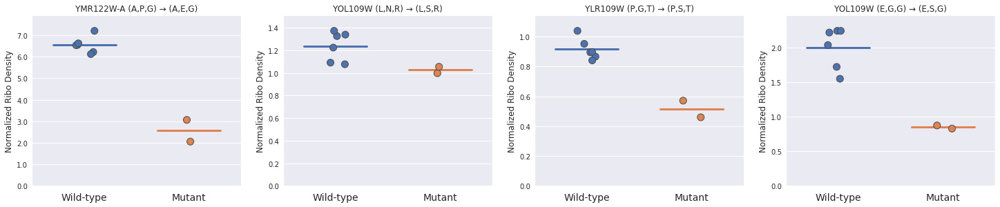

In [92]:
out_path = out_file_path = path+'A_site_profile_file/matrix_file/Test4_compare_triplets_with_other_triplets/'
## P-site effect
#dict_mutations = {'YMR122W-A A-P-G-->A-E-G': 56, 'YOL109W L-N-R-->L-S-R':106, 'YKL096W-A T-D-G-->T-F-G': 32, 'YLR109W P-G-T-->P-S-T': 162, 
#                  'YOL109W E-G-G-->E-S-G': 99, 'YOL109W A-Q-D-->A-P-D':14, 'YHR179W E-V-K-->E-H-K': 339, 'YHR179W Q-E-E-->Q-K-E': 150,
#                  'YKL096W-A S-S-T-->S-G-T': 62, 'YLR109W W-S-G-->W-G-G': 140}
dict_mutations = {'YHR179W E-V-K-->E-H-K': 339, 'YHR179W Q-E-E-->Q-K-E': 151,
                  'YKL096W-A S-S-T-->S-G-T': 62, 'YLR109W W-S-G-->W-G-G': 140}
plot_data, plot_avg = get_mutant_densities(dict_norm_ribo_density, dict_mutations, phaseI_list_samples, phaseII_list_samples)
file_name = 'P-site_effect_wild_type(fast)_vs_experimental_mutated(slow)_triplet.png'
plot_mutant_ribo_density_Fig2(plot_data, plot_avg, dict_mutations, out_path, file_name)
plt.show()

dict_mutations = {'YMR122W-A A-P-G-->A-E-G': 56, 'YOL109W L-N-R-->L-S-R':106, 'YLR109W P-G-T-->P-S-T': 162,'YOL109W E-G-G-->E-S-G': 99}
plot_data, plot_avg = get_mutant_densities(dict_norm_ribo_density, dict_mutations, phaseI_list_samples, phaseII_list_samples)
file_name = 'P-site_effect_wild_type(slow)_vs_experimental_mutated(fast)_triplet.png'
plot_mutant_ribo_density_Fig2(plot_data, plot_avg, dict_mutations, out_path, file_name)
plt.show()


### Running the analysis on negative control mutations

In [90]:
def plot_neg_control_Fig2c(dict_norm_ribo_density, dict_control_mut_pos, phaseI_list_samples, phaseII_list_samples, dict_mutations, out_path, file_name):
    
    plot_data, plot_avg = get_mutant_densities(dict_norm_ribo_density, dict_control_mut_pos, phaseI_list_samples, phaseII_list_samples)
    fig = plt.figure(figsize=(5 * 5, 10))
    sns.set()
    counter = 1
    for gene_name_pos in dict_mutations:
        title = gene_name_pos.split(' ')
        title_gene = title[0]
        title_pos = title[1].replace('>','-').split('-')
        del title_pos[3:5]
        title_name = title_gene+' ('+title_pos[0]+','+title_pos[1]+','+title_pos[2]+') \u2192 ('+title_pos[3]+','+title_pos[4]+','+title_pos[5]+')'
        ax = plt.subplot(2,4,counter)
        ylimit = max(plot_data[gene_name_pos]['Density'])
        Percentage = float(ylimit)/float(10)        
        ax = subplot_mut_vs_wt(ax, plot_data[gene_name_pos], plot_avg[gene_name_pos], title=title_name, dec=2)
        ax.set_ylim(bottom=0.0, top=ylimit+2)        
        counter += 1
    fig.savefig(out_path+file_name, dpi=600, bbox_inches = 'tight')
    plt.show()

##### Negative control P-site triplet

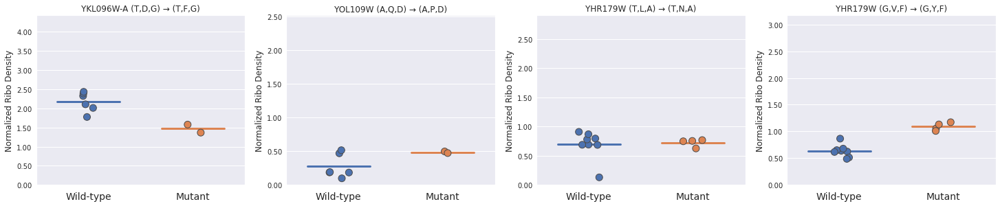

In [23]:
file_name = 'P-site_effect_negative_controle_wild_type_vs_experimental_mutated_triplet.png'
dict_control_mut_pos = {'YKL096W-A T-D-G-->T-F-G': 32, 'YOL109W A-Q-D-->A-P-D':14, 'YHR179W T-L-A-->T-N-A': 129, 'YHR179W G-V-F-->G-Y-F': 251}
plot_neg_control_Fig2c(dict_norm_ribo_density, dict_control_mut_pos, phaseI_list_samples, phaseII_list_samples,dict_control_mut_pos, out_path, file_name)

#### Statistically test the difference between the effect size of change in translation speed between the triplet pair (Wild type triplet-mutated triplet)

In [128]:
# Aim is to statistically test the difference between the effect size of change in translation speed between the mutations for which we predict change in speed to the negative control mutations
def stat_test_mutants_vs_control(plot_data, file_name):
    dict_densities = {}

    for mut in plot_data:
        dict_densities[mut] = {'Mutant': [], 'Wild-type': []}
        for idx, val in enumerate(plot_data[mut]['Type']):
            dict_densities[mut][val].append(plot_data[mut]['Density'][idx])

    list_mut_perc = []
    list_control_perc = []
    for mutation in dict_densities:
        for val in dict_densities[mutation]['Mutant']:
            for ref_val in dict_densities[mutation]['Wild-type']:
                perc_diff = math.fabs(val-ref_val)*100/((val+ref_val)/2)
                if mutation in ['YKL096W-A T-D-G-->T-F-G', 'YOL109W A-Q-D-->A-P-D', 'YHR179W T-L-A-->T-N-A', 'YHR179W G-V-F-->G-Y-F']:
                    list_control_perc.append(perc_diff)
                else:
                    list_mut_perc.append(perc_diff)
    u, p = stats.mannwhitneyu(list_mut_perc, list_control_perc)
    
    if p > 0.01:
        pval = round(p, 4)
    else:
        pval = '%.1E' % p
    print(pval)
    
    print('Mann-Whitney U test')
    print('U = ' + str(u) + ' p-value = ' + str(p))
    print('Mutated data length',len(list_mut_perc), 'Control data length',len(list_control_perc), 'Median of Mutated data',np.median(list_mut_perc), 'Median of Control data',np.median(list_control_perc))

    add_to_axis_label = r' x $10^{%d}$' % (int(str(p).split('e')[1]))
    pval = "{0:.2f}".format(float(str(p).split('e')[0])) + add_to_axis_label

    dict_compare = {'Type':[], 'perc_diff':[]}
    for val in list_mut_perc:
        dict_compare['Type'].append('Mutants with predicted change in rate')
        dict_compare['perc_diff'].append(val)
    for val2 in list_control_perc:
        dict_compare['Type'].append('Negative control mutants')
        dict_compare['perc_diff'].append(val2)

    plt.figure()
    fig = plt.figure(figsize=(5 * 5, 10))
    sns.set()
    ax = plt.subplot(132)
    ax = sns.boxplot(x=dict_compare['Type'], y=dict_compare['perc_diff'], order=['Mutants with predicted change in rate', 'Negative control mutants'], linewidth=1, ax=ax)
    ax.set_ylim(ax.get_ylim()[0], ax.get_ylim()[1] + 30)
    ax.set_prop_cycle(color=['blue', 'green'])
    ax.set(adjustable='box')
    ax.set_ylabel('Percent difference in\n median' + r'$\rho$', fontsize=20)
    ax.xaxis.label.set_visible(False)
    ax.tick_params(labelsize=6.5)
    ax.tick_params(width=1, length=4, axis='y', which='major', labelsize=14, pad=2)
    ax.tick_params(width=1, length=4, axis='x', which='major', labelsize=16, pad=2)

    x1, x2 = 0, 1  # columns of mutant and control
    y, h, col = max(dict_compare['perc_diff']) + 5, 10, 'k'
    plt.plot([x1, x1, x2, x2], [y, y + h, y + h, y], lw=1.5, c=col)
    plt.text((x1 + x2) * .5, y + h + 2, "p = " + str(pval), ha="center", va="bottom", color=col, fontsize=16)
    
    ax.set_xticklabels(['Mutants with predicted\n change in rate', 'Negative control\n mutants'])
    
    for i in [1, 3]:
        ax = plt.subplot(1, 3, i)
        ax.set_axis_off()
    fig.savefig(out_path+file_name, dpi=600, bbox_inches = 'tight')
    plt.show()

9.6E-08
Mann-Whitney U test
U = 3517.0 p-value = 9.606994757779211e-08
136 88 59.93557841358468 29.721893420179903


<Figure size 432x288 with 0 Axes>

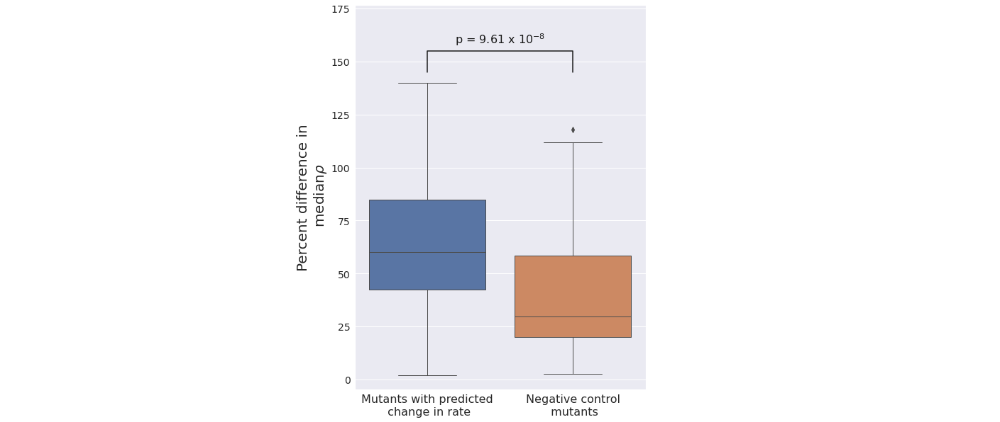

In [129]:
dict_mutations = {'YHR179W E-V-K-->E-H-K': 339, 'YHR179W Q-E-E-->Q-K-E': 151,
                  'YKL096W-A S-S-T-->S-G-T': 62, 'YLR109W W-S-G-->W-G-G': 140, 
                  'YMR122W-A A-P-G-->A-E-G': 56, 'YOL109W L-N-R-->L-S-R':106, 
                  'YLR109W P-G-T-->P-S-T': 162,'YOL109W E-G-G-->E-S-G': 99,
                 'YKL096W-A T-D-G-->T-F-G': 32, 'YOL109W A-Q-D-->A-P-D':14, 
                  'YHR179W T-L-A-->T-N-A': 129, 'YHR179W G-V-F-->G-Y-F': 251}

plot_data, plot_avg = get_mutant_densities(dict_norm_ribo_density, dict_mutations, phaseI_list_samples, phaseII_list_samples)
file_name = 'P-site_stat_test_mutants_vs_control.png'
stat_test_mutants_vs_control(plot_data, file_name)

##### E-site_effect triplet

In [88]:
def get_mutant_densities(dict_norm_ribo_density, dict_mut_pos, phaseI_list_samples, phaseII_list_samples):
    plot_data = {}
    plot_avg = {}
    for mut in dict_mut_pos:
        plot_data[mut] = {'Type': [], 'Density': []}
        density_list = {'Mutant': [], 'Wild-type': []}
        gene = mut.split(' ')[0]
        if gene == 'YHR179W':
            phase = 'PhaseII'
            phase_samples = phaseII_list_samples
        else:
            phase = 'PhaseI'
            phase_samples = phaseI_list_samples
        for sample in phase_samples:
            density = dict_norm_ribo_density[phase][sample][gene][dict_mut_pos[mut]-1]
            plot_data[mut]['Density'].append(density)
            
            if gene[:3] in sample:
                plot_data[mut]['Type'].append('Mutant')
                density_list['Mutant'].append(density)
            else:
                plot_data[mut]['Type'].append('Wild-type')
                density_list['Wild-type'].append(density)
        plot_avg[mut] = {'Type': [], 'Density': []}
        for samp_type in density_list:
            plot_avg[mut]['Type'].append(samp_type)
            plot_avg[mut]['Density'].append(np.mean(density_list[samp_type]))
    
    return plot_data, plot_avg


def subplot_mut_vs_wt(ax, plot_data, plot_avg, title, ytype='Density', xtype='Type', jitter=True, set_xlabel=False, set_ylabel=True, xlabel='',
                      ylabel='Normalized Ribo Density', yticks=None, dec=1, set_ylimits=False, ylim1=0, ylim2=3, 
                     palette_colors=((0.2980392156862745, 0.4470588235294118, 0.6901960784313725), (0.8666666666666667, 0.5176470588235295, 0.3215686274509804))):
    sns.set_palette(palette_colors)
    ax = sns.stripplot(plot_data[xtype], plot_data[ytype], ax=ax, size=10, linewidth=1, jitter=jitter, order=['Wild-type', 'Mutant'])
    if set_ylimits:
        ax.set_ylim(ylim1, ylim2)
    else:
        ax.set_ylim(ax.get_ylim()[0], ax.get_ylim()[1])
    if dec == 1:
        ax.yaxis.set_major_formatter(FormatStrFormatter('%.1f'))
    else:
        ax.yaxis.set_major_formatter(FormatStrFormatter('%.2f'))
#     if colors:
#         ax.set_prop_cycle(color=colors) # ['blue', 'green', 'orange'])

    ax = sns.boxplot(plot_avg[xtype], plot_avg[ytype], width=0.6, linewidth=3, ax=ax, order=['Wild-type', 'Mutant'])
    for i, col in enumerate(palette_colors):
        mybox = ax.artists[i]
        mybox.set_edgecolor(col)
        for j in range(i * 6, i * 6 + 6):
            wline = ax.lines[j]
            wline.set_color(col)
            wline.set_mfc(col)
            wline.set_mec(col)
    ax.set(adjustable='box')
    ax.set_title(title, fontsize=12)
    if set_ylabel:
        ax.set_ylabel(ylabel, fontsize=12)
    else:
        ax.yaxis.label.set_visible(False)
    if set_xlabel:
        ax.set_xlabel(xlabel, fontsize=10)
    else:
        ax.xaxis.label.set_visible(False)
    ax.tick_params(labelsize=14)
    ax.tick_params(width=1, length=4, axis='y', which='major', labelsize=10, pad=2)
    if yticks:
        ax.set_yticks(yticks)
        ax.set_yticklabels(yticks)
    return ax

def plot_mutant_ribo_density_Fig2(plot_data, plot_avg, dict_mutations, out_path, file_name):
    fig = plt.figure(figsize=(5 * 5, 10))
    sns.set()
    
    counter = 1
    for gene_name_pos in dict_mutations:
        title = gene_name_pos.split(' ')
        title_gene = title[0]
        title_pos = title[1].replace('>','-').split('-')
        del title_pos[3:5]
        title_name = title_gene+' ('+title_pos[0]+','+title_pos[1]+','+title_pos[2]+') \u2192 ('+title_pos[3]+','+title_pos[4]+','+title_pos[5]+')'
        ax = plt.subplot(2,4,counter)
        ylimit = max(plot_data[gene_name_pos]['Density'])
        Percentage = float(ylimit)/float(10)
        ax = subplot_mut_vs_wt(ax, plot_data[gene_name_pos], plot_avg[gene_name_pos], title=title_name, set_ylimits=True, ylim2=ylimit+Percentage)
        counter+=1
    fig.savefig(out_path+file_name, dpi=600, bbox_inches = 'tight')
    return

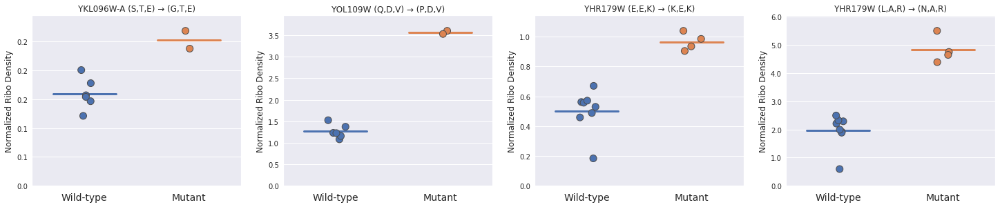

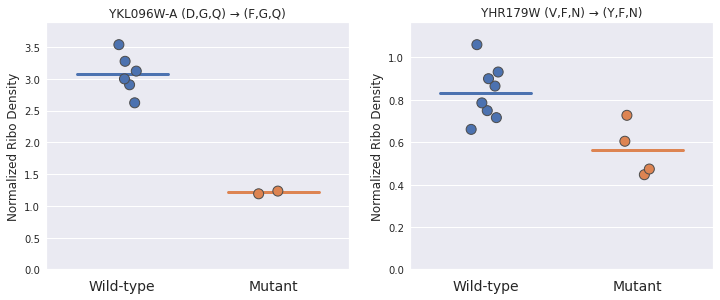

In [89]:
out_path = out_file_path = path+'A_site_profile_file/matrix_file/Test4_compare_triplets_with_other_triplets/'

##E-site_effect
#dict_mutations = {'YMR122W-A P-G-M-->E-G-M': 57, 'YKL096W-A D-G-Q-->F-G-Q': 33,  'YKL096W-A S-T-E-->G-T-E': 63, 'YOL109W Q-D-V-->P-D-V':15,  'YOL109W N-R-K-->S-R-K':107,
#                 'YLR109W G-T-D-->S-T-D': 163, 'YHR179W E-E-K-->K-E-K': 150, 'YHR179W V-K-D-->H-K-D': 339, 'YLR109W S-G-R-->G-G-R': 141,'YOL109W G-G-F-->S-G-F': 100}
#dict_mutations = {'YMR122W-A P-G-M-->E-G-M': 57,   'YKL096W-A S-T-E-->G-T-E': 63, 'YOL109W Q-D-V-->P-D-V':15, 'YHR179W E-E-K-->K-E-K': 150, 'YHR179W V-K-D-->H-K-D': 339,
#                 'YKL096W-A D-G-Q-->F-G-Q': 33, 'YLR109W S-G-R-->G-G-R': 141, 'YOL109W N-R-K-->S-R-K':107, 'YLR109W G-T-D-->S-T-D': 163,'YOL109W G-G-F-->S-G-F': 100}
#dict_mutations = {'YMR122W-A P-G-M-->E-G-M': 57,   'YKL096W-A S-T-E-->G-T-E': 63, 'YOL109W Q-D-V-->P-D-V':15, 
#                 'YHR179W E-E-K-->K-E-K': 150, 'YHR179W V-K-D-->H-K-D': 339,'YKL096W-A D-G-Q-->F-G-Q': 33, 'YLR109W S-G-R-->G-G-R': 141}

dict_mutations = {'YKL096W-A S-T-E-->G-T-E': 63, 'YOL109W Q-D-V-->P-D-V':15, 'YHR179W E-E-K-->K-E-K': 151, 'YHR179W L-A-R-->N-A-R': 130}
plot_data, plot_avg = get_mutant_densities(dict_norm_ribo_density, dict_mutations, phaseI_list_samples, phaseII_list_samples)
file_name = 'E-site_effect_wild_type(fast)_vs_experimental_mutated(slow)_triplet.png'
plot_mutant_ribo_density_Fig2(plot_data, plot_avg, dict_mutations, out_path, file_name)
plt.show()

dict_mutations = {'YKL096W-A D-G-Q-->F-G-Q': 33, 'YHR179W V-F-N-->Y-F-N': 252}
plot_data, plot_avg = get_mutant_densities(dict_norm_ribo_density, dict_mutations, phaseI_list_samples, phaseII_list_samples)
file_name = 'E-site_effect_wild_type(slow)_vs_experimental_mutated(fast)_triplet.png'
plot_mutant_ribo_density_Fig2(plot_data, plot_avg, dict_mutations, out_path, file_name)
plt.show()


##### Negative controle E-site triplet

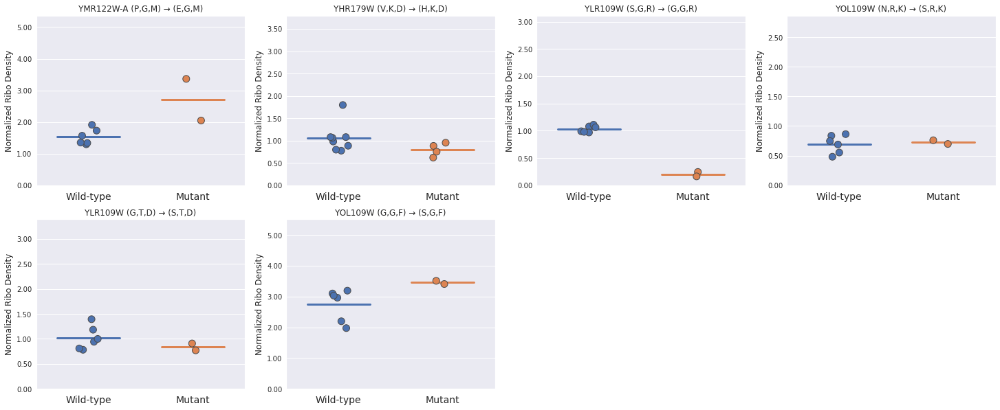

In [91]:
file_name = 'E-site_effect_negative_controle_wild_type_vs_experimental_mutated_triplet.png'
dict_control_mut_pos = {'YMR122W-A P-G-M-->E-G-M': 57, 'YHR179W V-K-D-->H-K-D': 340, 'YLR109W S-G-R-->G-G-R': 141, 'YOL109W N-R-K-->S-R-K':107, 'YLR109W G-T-D-->S-T-D': 163,'YOL109W G-G-F-->S-G-F': 100}
plot_neg_control_Fig2c(dict_norm_ribo_density, dict_control_mut_pos, phaseI_list_samples, phaseII_list_samples,dict_control_mut_pos, out_path, file_name)

#### Statistically test the difference between the effect size of change in translation speed between the triplet pair (Wild type triplet-mutated triplet)

In [130]:
# Aim is to statistically test the difference between the effect size of change in translation speed between the mutations for which we predict change in speed to the negative control mutations
def stat_test_mutants_vs_control(plot_data, file_name):
    dict_densities = {}

    for mut in plot_data:
        dict_densities[mut] = {'Mutant': [], 'Wild-type': []}
        for idx, val in enumerate(plot_data[mut]['Type']):
            dict_densities[mut][val].append(plot_data[mut]['Density'][idx])

    list_mut_perc = []
    list_control_perc = []
    for mutation in dict_densities:
        for val in dict_densities[mutation]['Mutant']:
            for ref_val in dict_densities[mutation]['Wild-type']:
                perc_diff = math.fabs(val-ref_val)*100/((val+ref_val)/2)
                if mutation in ['YMR122W-A P-G-M-->E-G-M', 'YHR179W V-K-D-->H-K-D', 'YLR109W S-G-R-->G-G-R', 'YOL109W N-R-K-->S-R-K', 'YLR109W G-T-D-->S-T-D','YOL109W G-G-F-->S-G-F']:
                    list_control_perc.append(perc_diff)
                else:
                    list_mut_perc.append(perc_diff)
    
    u, p = stats.mannwhitneyu(list_mut_perc, list_control_perc)
    
    if p > 0.01:
        pval = round(p, 4)
    else:
        pval = '%.1E' % p
    print(pval)
    
    print('Mann-Whitney U test')
    print('U = ' + str(u) + ' p-value = ' + str(p))
    print('Mutated data length',len(list_mut_perc), 'Control data length',len(list_control_perc), 'Median of Mutated data',np.median(list_mut_perc), 'Median of Control data',np.median(list_control_perc))

    add_to_axis_label = r' x $10^{%d}$' % (int(str(p).split('e')[1]))
    pval = "{0:.2f}".format(float(str(p).split('e')[0])) + add_to_axis_label

    dict_compare = {'Type':[], 'perc_diff':[]}
    for val in list_mut_perc:
        dict_compare['Type'].append('Mutants with predicted change in rate')
        dict_compare['perc_diff'].append(val)
    for val2 in list_control_perc:
        dict_compare['Type'].append('Negative control mutants')
        dict_compare['perc_diff'].append(val2)

    plt.figure()
    fig = plt.figure(figsize=(5 * 5, 10))
    sns.set()
    ax = plt.subplot(132)
    ax = sns.boxplot(x=dict_compare['Type'], y=dict_compare['perc_diff'], order=['Mutants with predicted change in rate', 'Negative control mutants'], linewidth=1, ax=ax)
    ax.set_ylim(ax.get_ylim()[0], ax.get_ylim()[1] + 30)
    ax.set_prop_cycle(color=['blue', 'green'])
    ax.set(adjustable='box')
    ax.set_ylabel('Percent difference in\n median' + r'$\rho$', fontsize=20)
    ax.xaxis.label.set_visible(False)
    ax.tick_params(labelsize=6.5)
    ax.tick_params(width=1, length=4, axis='y', which='major', labelsize=14, pad=2)
    ax.tick_params(width=1, length=4, axis='x', which='major', labelsize=16, pad=2)

    x1, x2 = 0, 1  # columns of mutant and control
    y, h, col = max(dict_compare['perc_diff']) + 5, 10, 'k'
    plt.plot([x1, x1, x2, x2], [y, y + h, y + h, y], lw=1.5, c=col)
    plt.text((x1 + x2) * .5, y + h + 2, "p = " + str(pval), ha="center", va="bottom", color=col, fontsize=16)
    
    ax.set_xticklabels(['Mutants with predicted\n change in rate', 'Negative control\n mutants'])
    
    for i in [1, 3]:
        ax = plt.subplot(1, 3, i)
        ax.set_axis_off()
    fig.savefig(out_path+file_name, dpi=600, bbox_inches = 'tight')
    plt.show()

1.2E-09
Mann-Whitney U test
U = 3226.0 p-value = 1.2369660490714801e-09
132 92 65.30798890774395 26.038755492438014


<Figure size 432x288 with 0 Axes>

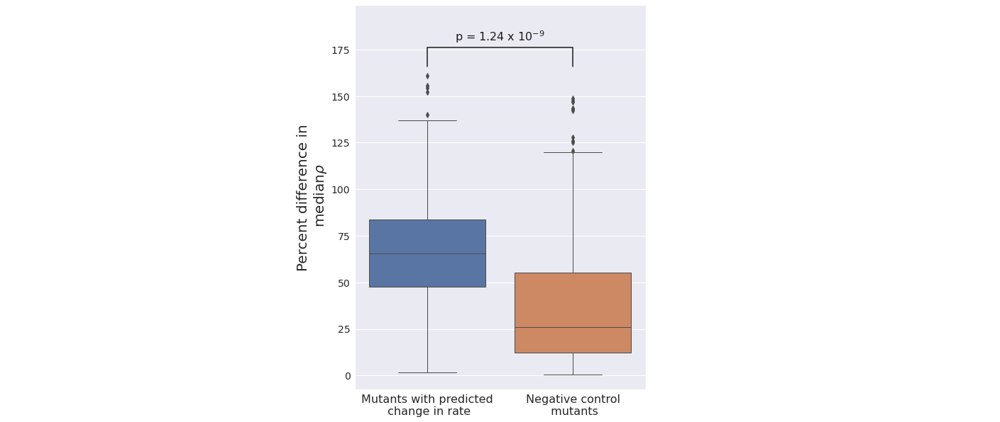

In [131]:
dict_mutations = {'YKL096W-A S-T-E-->G-T-E': 63, 'YOL109W Q-D-V-->P-D-V':15, 'YHR179W E-E-K-->K-E-K': 151, 'YHR179W L-A-R-->N-A-R': 130,
                 'YKL096W-A D-G-Q-->F-G-Q': 33, 'YHR179W V-F-N-->Y-F-N': 252, 'YMR122W-A P-G-M-->E-G-M': 57, 'YHR179W V-K-D-->H-K-D': 340, 
                  'YLR109W S-G-R-->G-G-R': 141, 'YOL109W N-R-K-->S-R-K':107, 'YLR109W G-T-D-->S-T-D': 163,'YOL109W G-G-F-->S-G-F': 100}

plot_data, plot_avg = get_mutant_densities(dict_norm_ribo_density, dict_mutations, phaseI_list_samples, phaseII_list_samples)
file_name = 'E-site_stat_test_mutants_vs_control.png'
stat_test_mutants_vs_control(plot_data, file_name)